# Modelling

## Modules and Packages

In [47]:
from statistics import stdev
from traceback import print_tb
!pip install statsmodels maidenhead cartopy matplotlib numpy statistics seaborn pandas
!pip install haversine
# !pip install geopandas
# !pip install geodatasets
!pip install cartopy


In [48]:
import statsmodels.api as sm
import sys
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import maidenhead as mh
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import seaborn as sns
import statistics
#import statsmodels as sm
import scipy.stats as stats
from haversine import haversine, Unit
import geopandas as gpd
#from shapely.geometry import Point
#from geodatasets import get_path
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter
from matplotlib.colors import LogNorm, Normalize


## GLM

#### Approach

In [74]:
header_df = pd.read_pickle("../Pre-Processed/header_updated.pickle")

# Clean up header data

cols_to_upper = ['CATEGORY-ASSISTED','CATEGORY-POWER']
for col in cols_to_upper:
    header_df[col] = header_df[col].str.upper()
    
# remove rows with QSO_COUNT = 0
header_df = header_df[header_df['QSO_COUNT'] != 0]

In [75]:
# Log transformation

header_df['LOG_QSO_COUNT'] = np.log1p(header_df['QSO_COUNT'])

data_log = header_df['LOG_QSO_COUNT']

In [76]:
print(header_df.head())

  START-OF-LOG   CONTEST CALLSIGN LOCATION CATEGORY-OPERATOR  \
0          3.0  CQ-WW-CW   2E0CVN       DX         SINGLE-OP   
1          3.0  CQ-WW-CW   2E0EBM       DX         SINGLE-OP   
2          3.0  CQ-WW-CW   2E0FFT       DX         SINGLE-OP   
3          3.0  CQ-WW-CW   2E0JID       DX         SINGLE-OP   
4          3.0  CQ-WW-CW   2E0JLZ       DX         SINGLE-OP   

  CATEGORY-ASSISTED CATEGORY-BAND CATEGORY-POWER CATEGORY-MODE  \
0      NON-ASSISTED           ALL            LOW            CW   
1          ASSISTED           ALL            LOW            CW   
2      NON-ASSISTED           ALL            QRP            CW   
3          ASSISTED           40M            LOW            CW   
4          ASSISTED           ALL            LOW            CW   

  CATEGORY-TRANSMITTER CATEGORY-STATION CATEGORY-OVERLAY GRID-LOCATOR  \
0                  ONE            FIXED              NaN       IO80EM   
1                  ONE            FIXED              NaN       JO01FQ   

In [77]:
for col in header_df.columns:
    if header_df[col].dtype == 'object' or header_df[col].dtype.name == 'category':
        print(f"{col}: {header_df[col].nunique()} unique values")

START-OF-LOG: 1 unique values
CONTEST: 1 unique values
CALLSIGN: 7953 unique values
LOCATION: 84 unique values
CATEGORY-OPERATOR: 2 unique values
CATEGORY-ASSISTED: 2 unique values
CATEGORY-BAND: 7 unique values
CATEGORY-POWER: 3 unique values
CATEGORY-MODE: 1 unique values
CATEGORY-TRANSMITTER: 3 unique values
CATEGORY-STATION: 2 unique values
CATEGORY-OVERLAY: 3 unique values
GRID-LOCATOR: 6181 unique values
CLAIMED-SCORE: 6858 unique values
CREATED-BY: 804 unique values
CATEGORY-TIME: 1 unique values


In [78]:
logs = pd.read_pickle("../Pre-Processed/logs.pickle")

# Clean up log data

log_cols_to_upper = ['sent_call', 'rcvd_call']
for col in log_cols_to_upper:
    logs[col] = logs[col].str.upper()

In [79]:
print(logs.head())

   freq  mo        date  time sent_call sent_rst sent_exch rcvd_call rcvd_rst  \
0  7056  CW  2024-11-23  0000    2E0CVN      599        14     HA1AG      599   
1  7054  CW  2024-11-23  0001    2E0CVN      599        14     OM0WR      599   
2  7050  CW  2024-11-23  0002    2E0CVN      599        14     VY2TT      599   
3  7046  CW  2024-11-23  0003    2E0CVN      599        14      S56M      599   
4  7046  CW  2024-11-23  0004    2E0CVN      599        14      DM4X      599   

  rcvd_exch    t  
0        15  NaN  
1        15  NaN  
2        05  NaN  
3        15  NaN  
4        14  NaN  


In [80]:
defective_header = pd.read_pickle("../Pre-Processed/header_updated.pickle")
deafective_headers = defective_header[defective_header['QSO_COUNT'] == 0]
defective_callsigns = deafective_headers['CALLSIGN'].unique()
defective_callsigns

good_callsigns = header_df[~header_df['CALLSIGN'].isin(defective_callsigns)]['CALLSIGN'].unique()

correct_logs = logs[logs['sent_call'].isin(good_callsigns)]

print(correct_logs.head())

print(correct_logs.shape)

   freq  mo        date  time sent_call sent_rst sent_exch rcvd_call rcvd_rst  \
0  7056  CW  2024-11-23  0000    2E0CVN      599        14     HA1AG      599   
1  7054  CW  2024-11-23  0001    2E0CVN      599        14     OM0WR      599   
2  7050  CW  2024-11-23  0002    2E0CVN      599        14     VY2TT      599   
3  7046  CW  2024-11-23  0003    2E0CVN      599        14      S56M      599   
4  7046  CW  2024-11-23  0004    2E0CVN      599        14      DM4X      599   

  rcvd_exch    t  
0        15  NaN  
1        15  NaN  
2        05  NaN  
3        15  NaN  
4        14  NaN  
(5446783, 11)


In [81]:


def freq_to_band(freq_khz):
    """
    Convert frequency in kHz to amateur radio band name.
    
    Parameters:
        freq_khz (float): Frequency in kilohertz.
        
    Returns:
        str: Band name (e.g., '20M', '40M') or 'UNKNOWN' if not matched.
    """
    if 1800 <= freq_khz <= 2000:
        return "160M"
    
    elif 3500 <= freq_khz <= 4000:
        return "80M"
    
    elif 7000 <= freq_khz <= 7300:
        return "40M"
    
    elif 14000 <= freq_khz <= 14350:
        return "20M"
    
    elif 21000 <= freq_khz <= 21450:
        return "15M"
    
    elif 28000 <= freq_khz <= 29700:
        return "10M"
    
    else:
        return "UNKNOWN"


def form_pairs(a, b):
    return tuple(sorted([a, b]))


logs   = correct_logs.copy()

# Convert frequency to float and band

logs['freq'] = logs['freq'].astype(float)  
logs['band']  = logs['freq'].apply(freq_to_band)  

# Form pairs of callsigns for each log entry

logs['pairs'] = logs.apply(lambda row: form_pairs(row['sent_call'], row['rcvd_call']), axis=1)

# Convert date and time to UTC datetime and create 15-minute slices

logs['utc_dt'] = pd.to_datetime(logs['date'] + logs['time'], format='%Y-%m-%d%H%M')
logs['slice']  = logs['utc_dt'].dt.floor('15min')   

# Create a DataFrame with unique pairs and their corresponding band and slice
 
pos = logs[['sent_call', 'rcvd_call','pairs','band','slice']]
pos = pos.drop_duplicates(subset=['pairs', 'band', 'slice'])
pos['Y'] = 1



In [82]:
print(pos.head())
print(pos.shape)

  sent_call rcvd_call            pairs band      slice  Y
0    2E0CVN     HA1AG  (2E0CVN, HA1AG)  40M 2024-11-23  1
1    2E0CVN     OM0WR  (2E0CVN, OM0WR)  40M 2024-11-23  1
2    2E0CVN     VY2TT  (2E0CVN, VY2TT)  40M 2024-11-23  1
3    2E0CVN      S56M   (2E0CVN, S56M)  40M 2024-11-23  1
4    2E0CVN      DM4X   (2E0CVN, DM4X)  40M 2024-11-23  1
(3033771, 6)


In [83]:
print(pos.shape)

(3033771, 6)


In [84]:
print(header_df.head())

  START-OF-LOG   CONTEST CALLSIGN LOCATION CATEGORY-OPERATOR  \
0          3.0  CQ-WW-CW   2E0CVN       DX         SINGLE-OP   
1          3.0  CQ-WW-CW   2E0EBM       DX         SINGLE-OP   
2          3.0  CQ-WW-CW   2E0FFT       DX         SINGLE-OP   
3          3.0  CQ-WW-CW   2E0JID       DX         SINGLE-OP   
4          3.0  CQ-WW-CW   2E0JLZ       DX         SINGLE-OP   

  CATEGORY-ASSISTED CATEGORY-BAND CATEGORY-POWER CATEGORY-MODE  \
0      NON-ASSISTED           ALL            LOW            CW   
1          ASSISTED           ALL            LOW            CW   
2      NON-ASSISTED           ALL            QRP            CW   
3          ASSISTED           40M            LOW            CW   
4          ASSISTED           ALL            LOW            CW   

  CATEGORY-TRANSMITTER CATEGORY-STATION CATEGORY-OVERLAY GRID-LOCATOR  \
0                  ONE            FIXED              NaN       IO80EM   
1                  ONE            FIXED              NaN       JO01FQ   

In [85]:
h = header_df[['CALLSIGN','CATEGORY-POWER','CATEGORY-OPERATOR',
               'CATEGORY-ASSISTED','CATEGORY-TRANSMITTER',
               'GRID-LOCATOR','LOG_QSO_COUNT']]
pos = (pos
       .merge(h, left_on='sent_call', right_on='CALLSIGN', suffixes=('','_TX'))
       .merge(h, left_on='rcvd_call', right_on='CALLSIGN', suffixes=('','_RX')))

print(pos.head())
print(pos.shape)

  sent_call rcvd_call            pairs band      slice  Y CALLSIGN  \
0    2E0CVN     HA1AG  (2E0CVN, HA1AG)  40M 2024-11-23  1   2E0CVN   
1    2E0CVN     OM0WR  (2E0CVN, OM0WR)  40M 2024-11-23  1   2E0CVN   
2    2E0CVN     VY2TT  (2E0CVN, VY2TT)  40M 2024-11-23  1   2E0CVN   
3    2E0CVN      S56M   (2E0CVN, S56M)  40M 2024-11-23  1   2E0CVN   
4    2E0CVN      DM4X   (2E0CVN, DM4X)  40M 2024-11-23  1   2E0CVN   

  CATEGORY-POWER CATEGORY-OPERATOR CATEGORY-ASSISTED CATEGORY-TRANSMITTER  \
0            LOW         SINGLE-OP      NON-ASSISTED                  ONE   
1            LOW         SINGLE-OP      NON-ASSISTED                  ONE   
2            LOW         SINGLE-OP      NON-ASSISTED                  ONE   
3            LOW         SINGLE-OP      NON-ASSISTED                  ONE   
4            LOW         SINGLE-OP      NON-ASSISTED                  ONE   

  GRID-LOCATOR  LOG_QSO_COUNT CALLSIGN_RX CATEGORY-POWER_RX  \
0       IO80EM       7.115582       HA1AG            

In [86]:
print(pos.columns)

Index(['sent_call', 'rcvd_call', 'pairs', 'band', 'slice', 'Y', 'CALLSIGN',
       'CATEGORY-POWER', 'CATEGORY-OPERATOR', 'CATEGORY-ASSISTED',
       'CATEGORY-TRANSMITTER', 'GRID-LOCATOR', 'LOG_QSO_COUNT', 'CALLSIGN_RX',
       'CATEGORY-POWER_RX', 'CATEGORY-OPERATOR_RX', 'CATEGORY-ASSISTED_RX',
       'CATEGORY-TRANSMITTER_RX', 'GRID-LOCATOR_RX', 'LOG_QSO_COUNT_RX'],
      dtype='object')


#### ignore

In [87]:
print(h.shape)

(7953, 7)


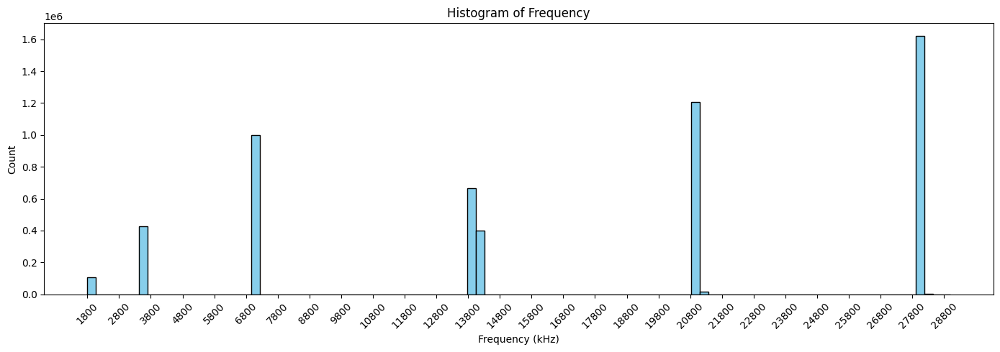

In [88]:
plt.figure(figsize=(14, 5))
plt.hist(logs['freq'].astype(float), bins=100, color='skyblue', edgecolor='black')
plt.xlabel('Frequency (kHz)')
plt.ylabel('Count')
plt.title('Histogram of Frequency')
plt.xticks(np.arange(int(logs['freq'].astype(float).min()), 
                     int(logs['freq'].astype(float).max())+1, 1000), rotation=45)
plt.tight_layout()
plt.show()

In [89]:
logs.columns

Index(['freq', 'mo', 'date', 'time', 'sent_call', 'sent_rst', 'sent_exch',
       'rcvd_call', 'rcvd_rst', 'rcvd_exch', 't', 'band', 'pairs', 'utc_dt',
       'slice'],
      dtype='object')

In [90]:
# Callsigns in correct_logs not found in header_df
missing_sent = pos[~pos['sent_call'].isin(header_df['CALLSIGN'])]
print(f"Missing sender callsigns: {missing_sent.shape[0]} rows")


Missing sender callsigns: 0 rows


In [91]:
missing_rcvd = pos[~pos['rcvd_call'].isin(header_df['CALLSIGN'])]
print(f"Missing receiver callsigns: {missing_rcvd.shape[0]} rows")

print(len(missing_rcvd['rcvd_call'].unique()))

print(62583 - len(missing_rcvd['rcvd_call'].unique()))

Missing receiver callsigns: 0 rows
0
62583


In [92]:
# bands = ['40M']
# for band in bands:
#     df_band = pos[(pos['band'] == band) & (pos['distance'].notnull()) & (pos['midpoint_solar_time'].notnull())]
    
#     time_in_hours = (
#         df_band['midpoint_solar_time'].dt.hour +
#         df_band['midpoint_solar_time'].dt.minute / 60 +
#         df_band['midpoint_solar_time'].dt.second / 3600
#     )

#     x = time_in_hours.values   # Time as float
#     y = df_band['distance'].values
    
#     xy = np.vstack([x, y])
    
#     kde = stats.gaussian_kde(xy)
    
#     grid_x = np.linspace(0, 24, 96)       # Time grid (x-axis)
#     grid_y = np.linspace(0, 20000, 400)   # Distance grid (y-axis)

#     X, Y = np.meshgrid(grid_x, grid_y)

#     grid_points = np.vstack([X.ravel(), Y.ravel()])   # Time first, distance second

#     kde_values = kde(grid_points).reshape(X.shape)
#     plt.figure(figsize=(8,5))
#     plt.contourf(X, Y, kde_values, levels=100, cmap='hot')
#     plt.xlabel('Midpoint Solar Time (hour)')
#     plt.ylabel('Distance (km)')
#     plt.title(f'{band} - KDE of Actual QSOs')
#     plt.colorbar(label='Density of QSOs')
#     plt.show()


    

#### approach continued

In [93]:
print(pos.columns)

Index(['sent_call', 'rcvd_call', 'pairs', 'band', 'slice', 'Y', 'CALLSIGN',
       'CATEGORY-POWER', 'CATEGORY-OPERATOR', 'CATEGORY-ASSISTED',
       'CATEGORY-TRANSMITTER', 'GRID-LOCATOR', 'LOG_QSO_COUNT', 'CALLSIGN_RX',
       'CATEGORY-POWER_RX', 'CATEGORY-OPERATOR_RX', 'CATEGORY-ASSISTED_RX',
       'CATEGORY-TRANSMITTER_RX', 'GRID-LOCATOR_RX', 'LOG_QSO_COUNT_RX'],
      dtype='object')


In [94]:
print(pos['slice'].head(100))

0    2024-11-23 00:00:00
1    2024-11-23 00:00:00
2    2024-11-23 00:00:00
3    2024-11-23 00:00:00
4    2024-11-23 00:00:00
             ...        
95   2024-11-23 01:45:00
96   2024-11-23 01:45:00
97   2024-11-23 01:45:00
98   2024-11-23 02:00:00
99   2024-11-23 02:00:00
Name: slice, Length: 100, dtype: datetime64[ns]


In [95]:
def safe_maidenhead_distance(locator1, locator2):
    """
    Calculate the distance between two Maidenhead locators.
    
    Parameters:
        locator1 (str): First Maidenhead locator.
        locator2 (str): Second Maidenhead locator.
        
    Returns:
        float: Distance in kilometers, or None if either locator is invalid.
    """
    try:
        if pd.isna(locator1) or pd.isna(locator2):
            return np.nan
        coord1 = mh.to_location(locator1, center=True)
        coord2 = mh.to_location(locator2, center=True)
        return haversine(coord1, coord2)
    except Exception:
        return np.nan
    
pos['distance'] = pos.apply(lambda row: safe_maidenhead_distance(row['GRID-LOCATOR'], row['GRID-LOCATOR_RX']), axis=1)

In [96]:
print(pos['distance'].head(100))

0     1704.117260
1     1847.370810
2             NaN
3     1443.187668
4     1190.996015
         ...     
95     400.592802
96     743.354780
97    1641.085486
98    5673.114262
99    6610.910871
Name: distance, Length: 100, dtype: float64


In [97]:
def midpoint_solar_time(utc_timestamp, loc1, loc2):
    """
    Calculate the midpoint solar time between two locations based on their Maidenhead locators.
    
    Parameters:
        utc_timestamp (pd.Timestamp): UTC timestamp of the QSO.
        loc1 (str): Maidenhead locator of the first station.
        loc2 (str): Maidenhead locator of the second station.
        
    Returns:
        pd.Timestamp: local solar time at the midpoint.
        Returns pd.NaT if locators are invalid.
    """
    try:
        coord1 = mh.to_location(loc1, center=True)
        coord2 = mh.to_location(loc2, center=True)
        
        # Calculate midpoint coordinates
        mid_lat = (coord1[0] + coord2[0]) / 2
        mid_lon = (coord1[1] + coord2[1]) / 2
        
        # Convert to datetime
        return utc_timestamp + pd.Timedelta(hours=(mid_lon / 15))
    except Exception as e:
        return pd.NaT

In [98]:
pos['midpoint_solar_time'] = pos.apply(lambda row: midpoint_solar_time(row['slice'], row['GRID-LOCATOR'], row['GRID-LOCATOR_RX']), axis=1)

In [99]:
print(pos.head())
print(pos.shape)

  sent_call rcvd_call            pairs band      slice  Y CALLSIGN  \
0    2E0CVN     HA1AG  (2E0CVN, HA1AG)  40M 2024-11-23  1   2E0CVN   
1    2E0CVN     OM0WR  (2E0CVN, OM0WR)  40M 2024-11-23  1   2E0CVN   
2    2E0CVN     VY2TT  (2E0CVN, VY2TT)  40M 2024-11-23  1   2E0CVN   
3    2E0CVN      S56M   (2E0CVN, S56M)  40M 2024-11-23  1   2E0CVN   
4    2E0CVN      DM4X   (2E0CVN, DM4X)  40M 2024-11-23  1   2E0CVN   

  CATEGORY-POWER CATEGORY-OPERATOR CATEGORY-ASSISTED  ... LOG_QSO_COUNT  \
0            LOW         SINGLE-OP      NON-ASSISTED  ...      7.115582   
1            LOW         SINGLE-OP      NON-ASSISTED  ...      7.115582   
2            LOW         SINGLE-OP      NON-ASSISTED  ...      7.115582   
3            LOW         SINGLE-OP      NON-ASSISTED  ...      7.115582   
4            LOW         SINGLE-OP      NON-ASSISTED  ...      7.115582   

  CALLSIGN_RX  CATEGORY-POWER_RX CATEGORY-OPERATOR_RX CATEGORY-ASSISTED_RX  \
0       HA1AG               HIGH            SINGLE

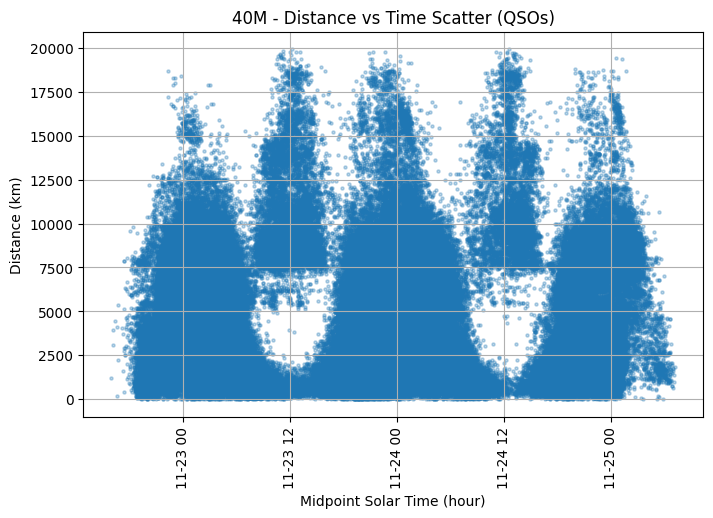

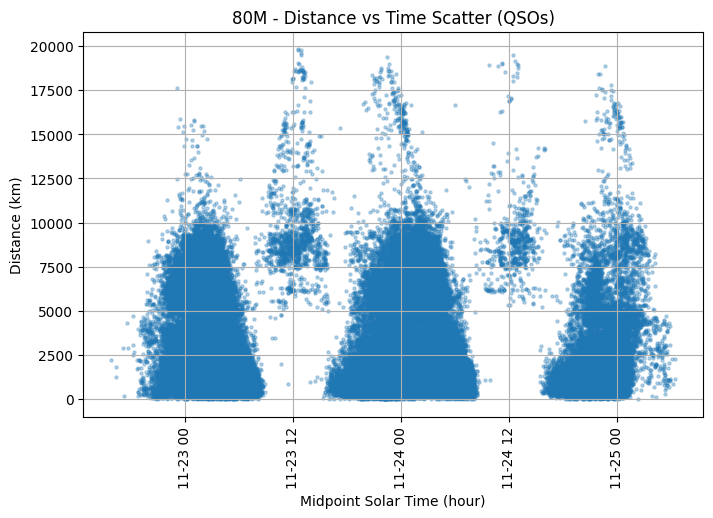

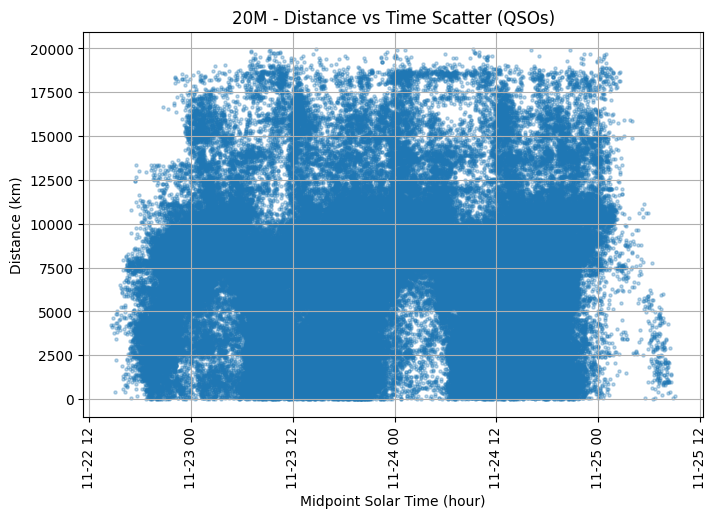

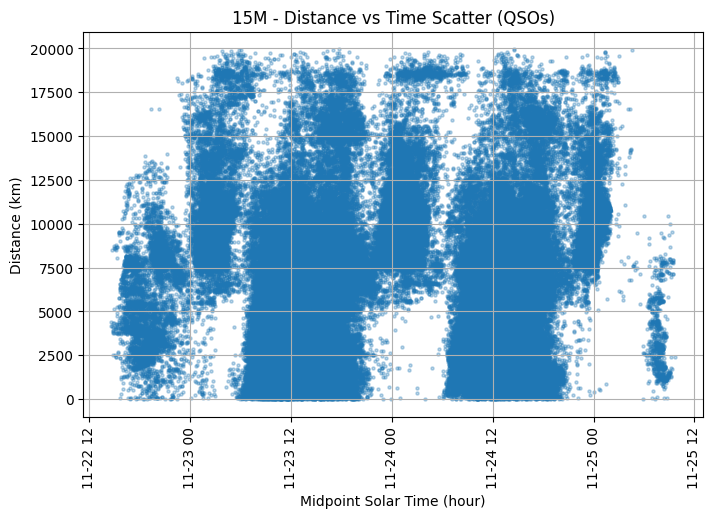

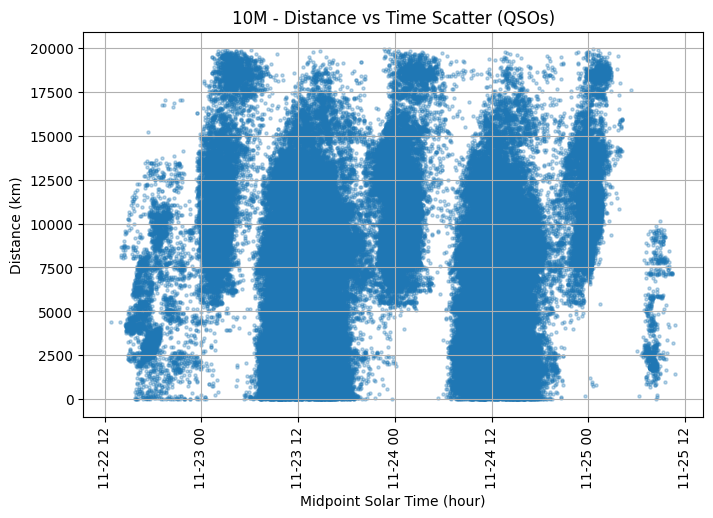

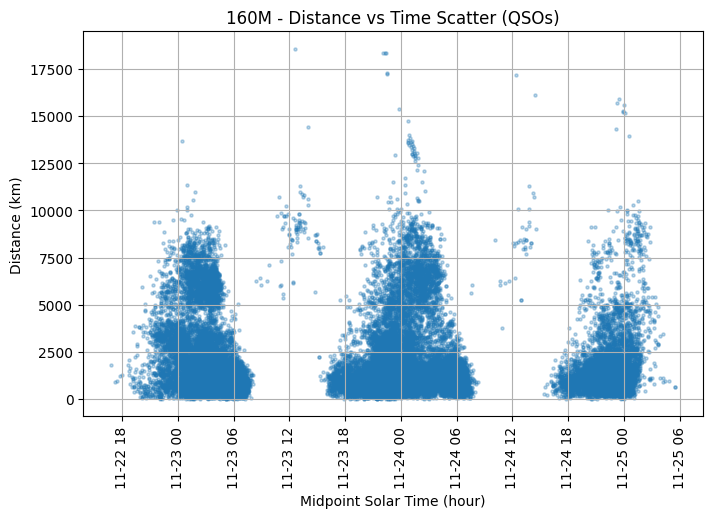

In [100]:
bands = pos['band'].unique()

for band in bands:
    df_band = pos[(pos['band'] == band) & (pos['distance'].notnull()) & (pos['midpoint_solar_time'].notnull())]

    plt.figure(figsize=(8,5))
    plt.scatter(df_band['midpoint_solar_time'], df_band['distance'], alpha=0.3, s=5)
    plt.xticks(rotation=90)
    plt.xlabel('Midpoint Solar Time (hour)')
    plt.ylabel('Distance (km)')
    plt.title(f'{band} - Distance vs Time Scatter (QSOs)')
    plt.grid(True)
    plt.show()

In [101]:
# random sampling 

from random import sample
from xml.etree.ElementInclude import include


bands = pos['band'].unique()

def sample_by_band(df, n_samples = 20000, seed = 42):
    """
    Return a dataframe with up to `n_per_band` rows for every distinct `band`.
    Keeps the sample balanced so each band is equally represented.

    Args:
        df (_type_): _description_
        n_samples (int, optional): _description_. Defaults to 20000.
        seed (int, optional): _description_. Defaults to 42.
    """
    
    rng = np.random.default_rng(seed)
    grouped = df.groupby('band', group_keys=False)
    
    def _sample(group):
        if len(group) > n_samples:
            return group.sample(n=n_samples, random_state=rng)
        else:
            return group
        
    sampled = grouped.apply(_sample)
    return sampled.reset_index(drop=True)

qso_sampled = sample_by_band(pos)

C:\Users\neela\AppData\Local\Temp\ipykernel_24936\2695616116.py:29: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled = grouped.apply(_sample)


In [102]:
print(qso_sampled['slice'].head())

0   2024-11-24 22:00:00
1   2024-11-24 10:00:00
2   2024-11-24 08:15:00
3   2024-11-24 10:45:00
4   2024-11-23 12:30:00
Name: slice, dtype: datetime64[ns]


In [103]:
# Implementing Warped epanechnikov kernel

def circular_distance(t, t_i, period = 24.0):
    dt = np.abs(t - t_i)
    dt = np.minimum(dt, period - dt)  # Ensure circular distance
    return dt

def epan(u):
    mask = np.abs(u) <= 1
    out = np.zeros_like(u, dtype=float)
    out[mask] = 0.75 * (1 - u[mask] ** 2)
    return out

def kde2d_warped_epan(time, dist, grid_t, grid_d, h_t, h_d):
    """
    Perform 2D kernel density estimation with warped Epanechnikov kernel.
    
    Parameters:
        time (np.ndarray): Time data.
        dist (np.ndarray): Distance data.
        grid_t (np.ndarray): Grid for time.
        grid_d (np.ndarray): Grid for distance.
        h_t (float): Bandwidth for time.
        h_d (float): Bandwidth for distance.
        
    Returns:
        density: 2D array of estimated densities.
    """
    n = len(time)
    T,D = np.meshgrid(grid_t, grid_d)
    G = np.zeros_like(T, dtype=float)

    

    for t, d in zip(time, dist):
        Kt = epan(circular_distance(T, t)/ h_t) / h_t
        Kd = epan((D - d) / h_d) / h_d
        G += Kt * Kd # product of the kernels
    G /= n  # Normalize by number of points
    density = G
    
    return density

In [104]:
print(qso_sampled.columns)


Index(['sent_call', 'rcvd_call', 'pairs', 'band', 'slice', 'Y', 'CALLSIGN',
       'CATEGORY-POWER', 'CATEGORY-OPERATOR', 'CATEGORY-ASSISTED',
       'CATEGORY-TRANSMITTER', 'GRID-LOCATOR', 'LOG_QSO_COUNT', 'CALLSIGN_RX',
       'CATEGORY-POWER_RX', 'CATEGORY-OPERATOR_RX', 'CATEGORY-ASSISTED_RX',
       'CATEGORY-TRANSMITTER_RX', 'GRID-LOCATOR_RX', 'LOG_QSO_COUNT_RX',
       'distance', 'midpoint_solar_time'],
      dtype='object')


In [105]:

bands = qso_sampled['band'].unique()
# 1) Precompute solar-hour once
if 'solar_hour' not in qso_sampled:
    qso_sampled['solar_hour'] = (qso_sampled['midpoint_solar_time'].dt.hour
                                 + qso_sampled['midpoint_solar_time'].dt.minute/60
                                 + qso_sampled['midpoint_solar_time'].dt.second/3600)

# 2) Grids and bandwidths (define once)
grid_t = np.linspace(0, 24, 96)          # time grid
grid_d = np.linspace(0, 20000, 400)      # distance grid
h_t, h_d = 0.25, 50.0                    # bandwidths
Δt, Δd = grid_t[1]-grid_t[0], grid_d[1]-grid_d[0]

# 3) Optional: mesh for plotting (reuse)
T, D = np.meshgrid(grid_t, grid_d)

# 4) Cache for KDEs
band_kde = {}


In [106]:
print(qso_sampled['band'].unique())

['10M' '15M' '160M' '20M' '40M' '80M']


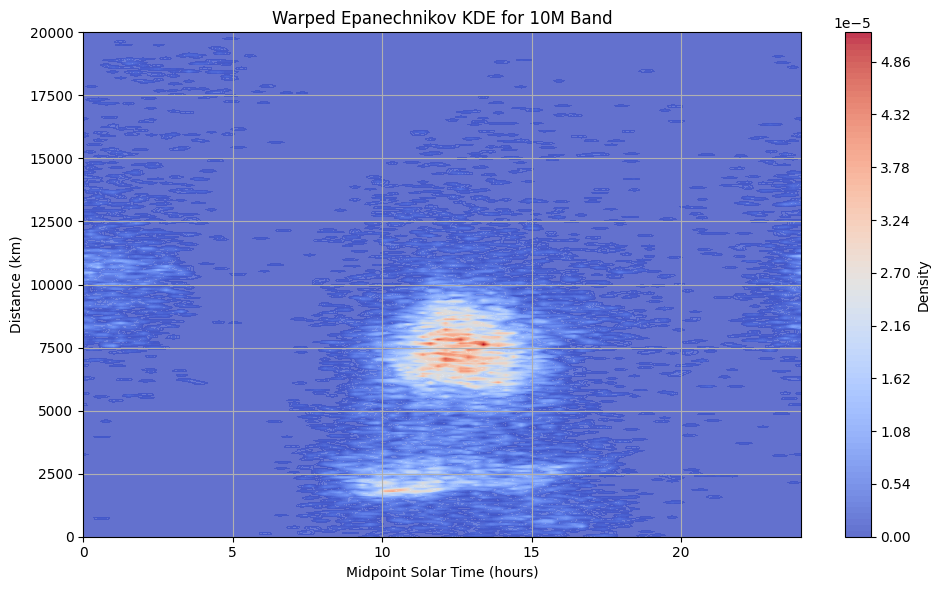

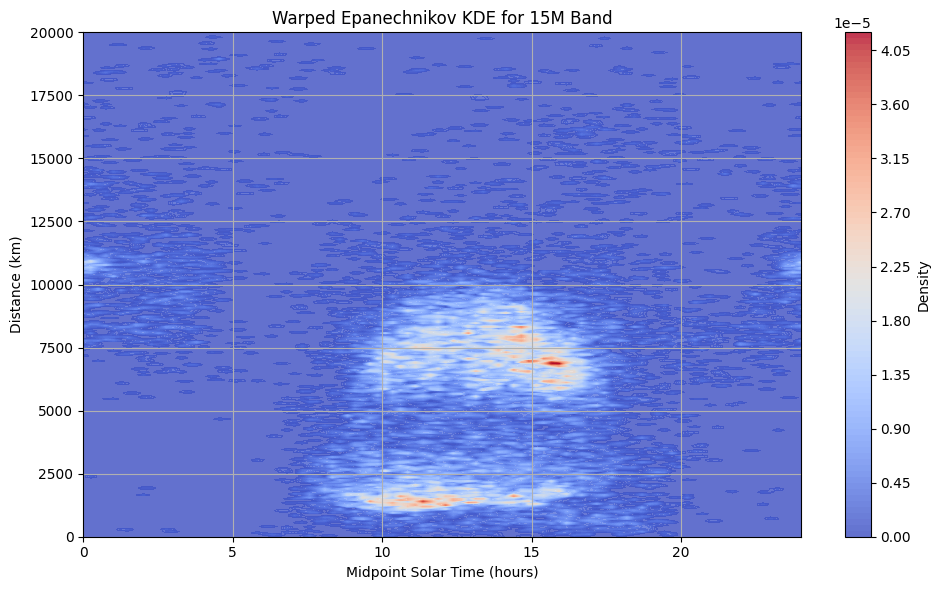

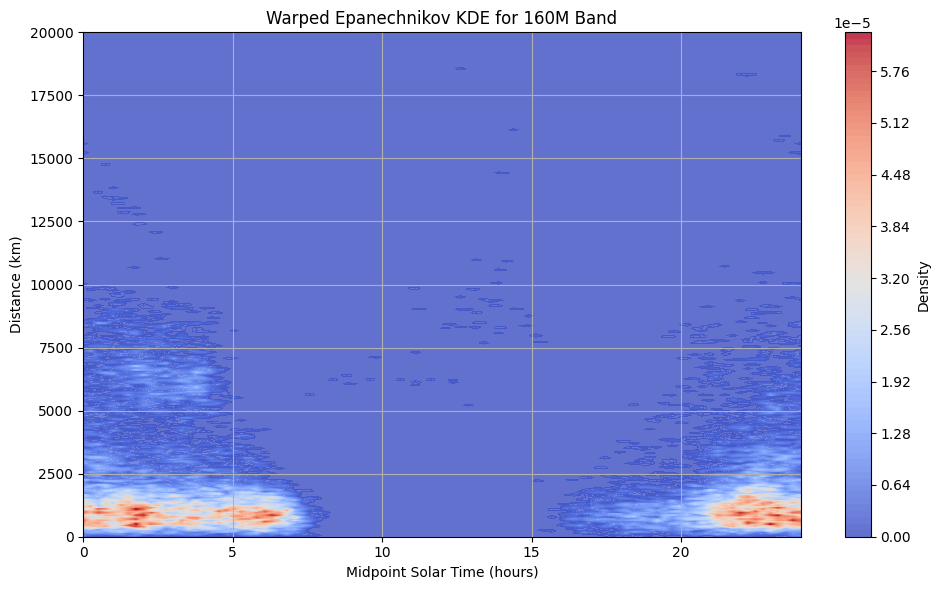

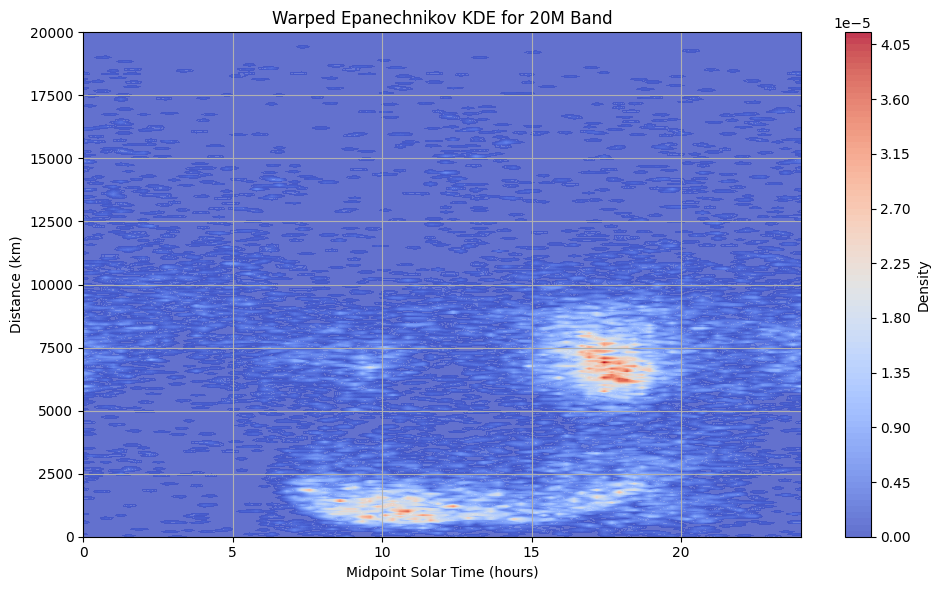

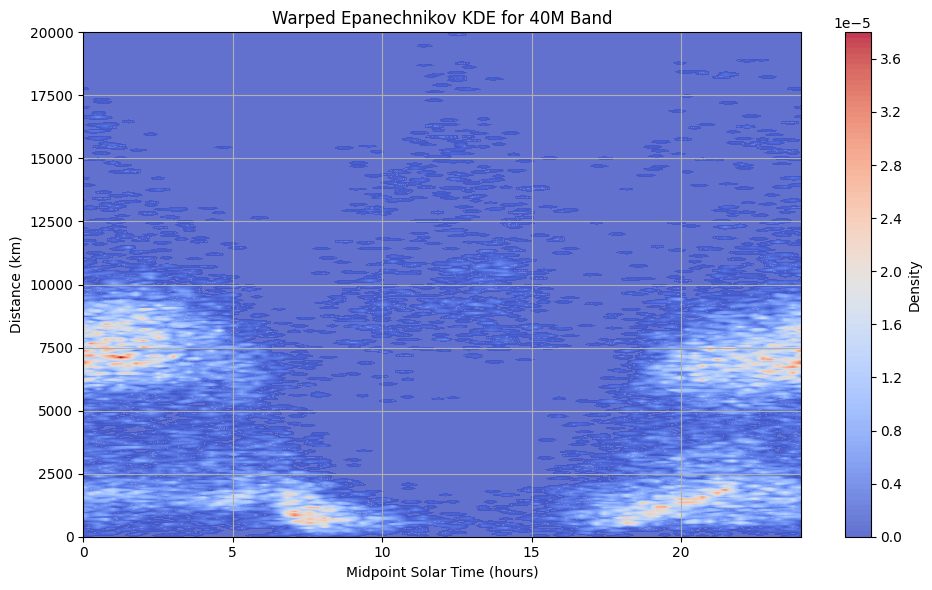

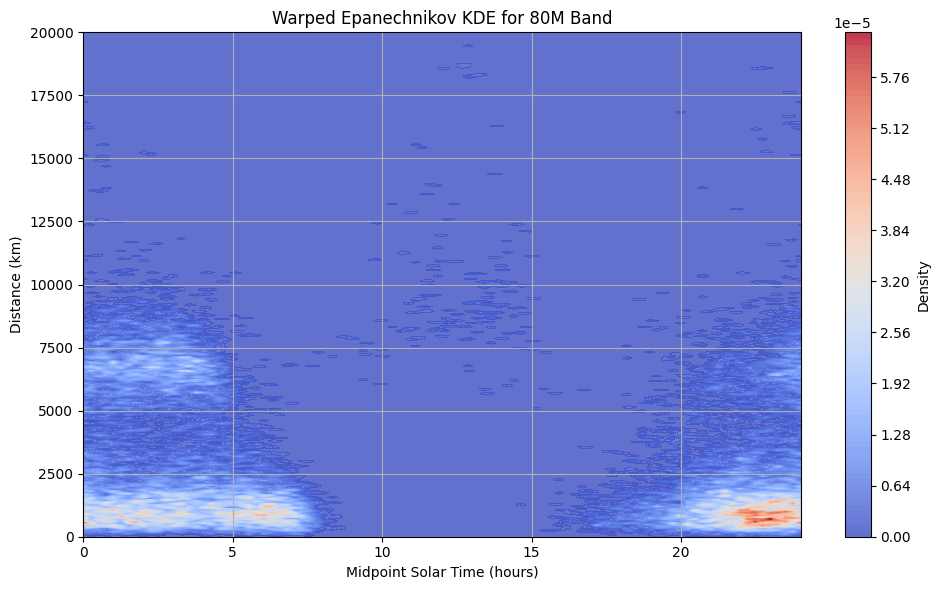

In [107]:


for band in bands:
    df = qso_sampled[qso_sampled['band'] == band]

    time_vec = df['solar_hour'].to_numpy()

    dist_vec = df['distance'].to_numpy()

    grid_t = np.linspace(0, 24, 96)  # 24 hours
    grid_d = np.linspace(0, 20000, 400)  # Distance in km

    h_t = 0.25  # Bandwidth for time
    h_d = 50  # Bandwidth for distance

    density = kde2d_warped_epan(time_vec, dist_vec, grid_t, grid_d, h_t, h_d)
    band_kde[band] = density

    T, D = np.meshgrid(grid_t, grid_d)
    plt.figure(figsize=(10, 6))
    pcm = plt.contourf(T, D, density, levels=100, cmap='coolwarm', alpha=0.8)
    plt.xlabel('Midpoint Solar Time (hours)')
    plt.ylabel('Distance (km)')
    plt.title(f'Warped Epanechnikov KDE for {band} Band')
    plt.colorbar(pcm, label='Density')
    plt.grid(True)
    plt.tight_layout()
    plt.show()


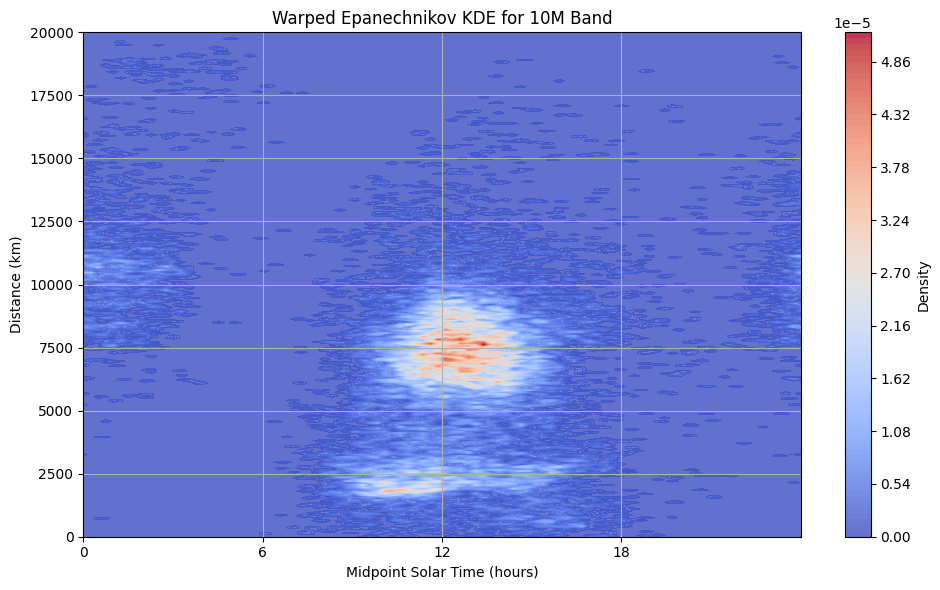

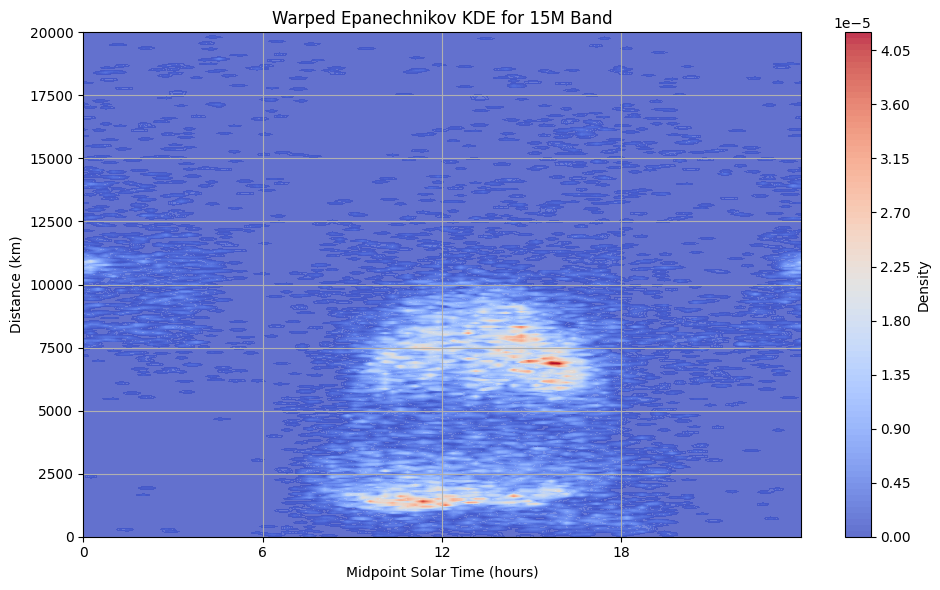

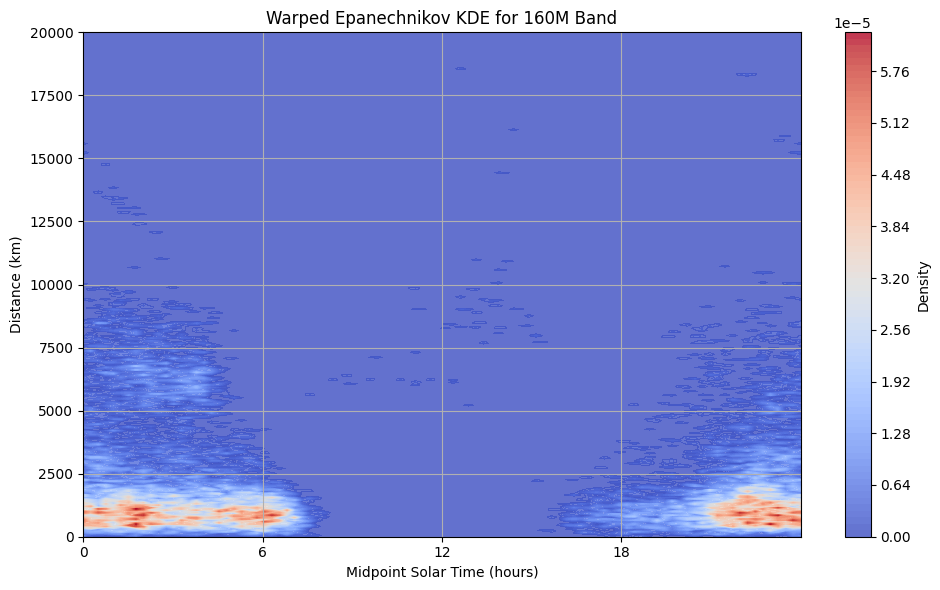

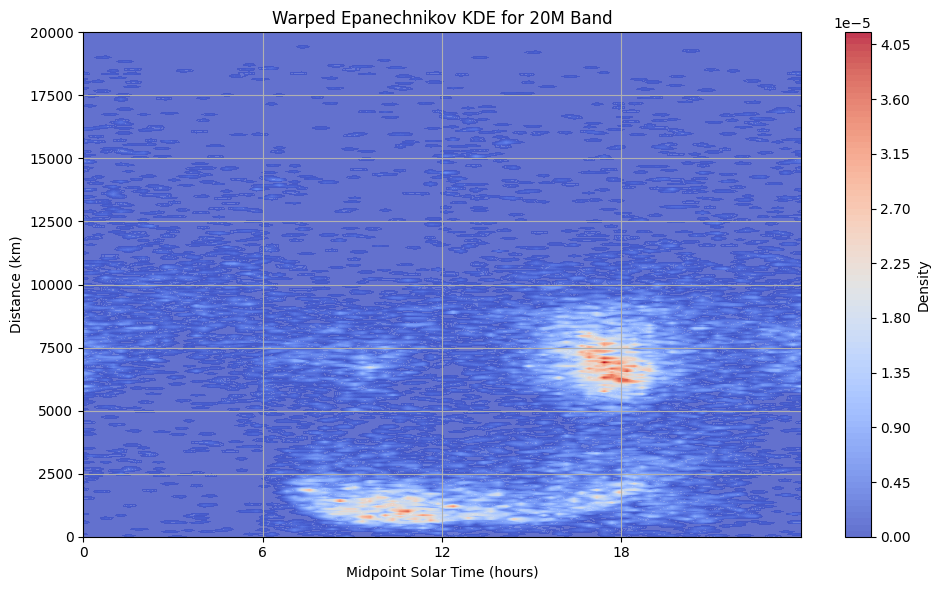

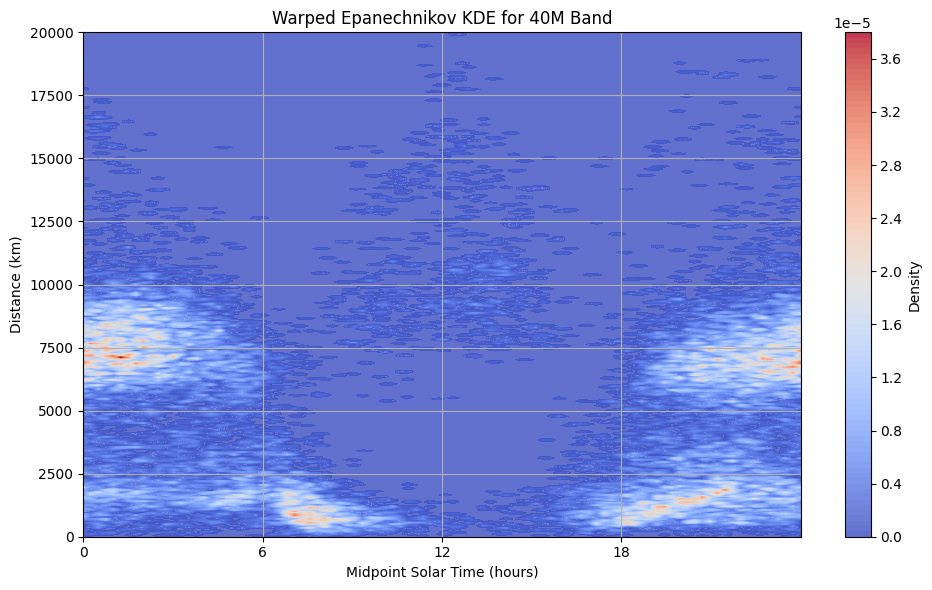

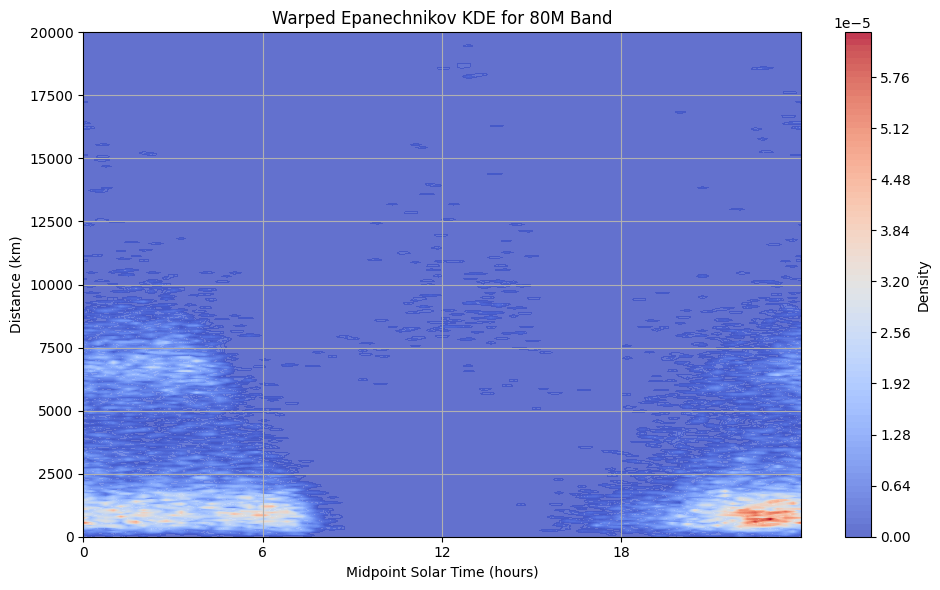

In [108]:
for band in bands:
    df = qso_sampled[qso_sampled['band'] == band]

    time_vec = df['solar_hour'].to_numpy()
    dist_vec = df['distance'].to_numpy()

    grid_t = np.linspace(0, 24, 96)  # 24 hours
    grid_d = np.linspace(0, 20000, 400)  # Distance in km

    h_t = 0.25  # Bandwidth for time
    h_d = 50  # Bandwidth for distance

    density = kde2d_warped_epan(time_vec, dist_vec, grid_t, grid_d, h_t, h_d)
    band_kde[band] = density

    T, D = np.meshgrid(grid_t, grid_d)
    plt.figure(figsize=(10, 6))
    pcm = plt.contourf(T, D, density, levels=100, cmap='coolwarm', alpha=0.8)
    plt.xlabel('Midpoint Solar Time (hours)')
    plt.ylabel('Distance (km)')
    plt.title(f'Warped Epanechnikov KDE for {band} Band')
    plt.colorbar(pcm, label='Density')
    plt.grid(True)
    plt.tight_layout()
    plt.xticks([0, 6, 12, 18])  # Set x-axis ticks to [0, 6, 12, 18]
    plt.show()

In [109]:
from collections import defaultdict

In [110]:
print(qso_sampled.head())
print(qso_sampled.shape)
print(qso_sampled.columns)
print(len(qso_sampled['solar_hour'].unique()))


  sent_call rcvd_call            pairs band               slice  Y CALLSIGN  \
0    7L4MDM      K3QP   (7L4MDM, K3QP)  10M 2024-11-24 22:00:00  1   7L4MDM   
1      IO4N       P3X      (IO4N, P3X)  10M 2024-11-24 10:00:00  1     IO4N   
2    YO4FPF     ZD7VJ  (YO4FPF, ZD7VJ)  10M 2024-11-24 08:15:00  1   YO4FPF   
3     F4FFZ    YO5DAS  (F4FFZ, YO5DAS)  10M 2024-11-24 10:45:00  1    F4FFZ   
4      CQ9A     G0UVX    (CQ9A, G0UVX)  10M 2024-11-23 12:30:00  1     CQ9A   

  CATEGORY-POWER CATEGORY-OPERATOR CATEGORY-ASSISTED  ... CALLSIGN_RX  \
0            LOW         SINGLE-OP          ASSISTED  ...        K3QP   
1           HIGH         SINGLE-OP          ASSISTED  ...         P3X   
2           HIGH         SINGLE-OP          ASSISTED  ...       ZD7VJ   
3            LOW         SINGLE-OP          ASSISTED  ...      YO5DAS   
4           HIGH          MULTI-OP          ASSISTED  ...       G0UVX   

  CATEGORY-POWER_RX  CATEGORY-OPERATOR_RX CATEGORY-ASSISTED_RX  \
0               LOW 

In [111]:
print(qso_sampled['midpoint_solar_time'].head())

0   2024-11-25 00:05:30
1   2024-11-24 11:30:00
2   2024-11-24 09:00:50
3                   NaT
4                   NaT
Name: midpoint_solar_time, dtype: datetime64[ns]


In [112]:

band_prior = (
    pos['band'].value_counts(normalize=True)
    .reindex(bands, fill_value=0)
)

print(band_prior)

band
10M     0.294229
15M     0.225347
160M    0.019538
20M     0.196788
40M     0.184572
80M     0.079527
Name: proportion, dtype: float64


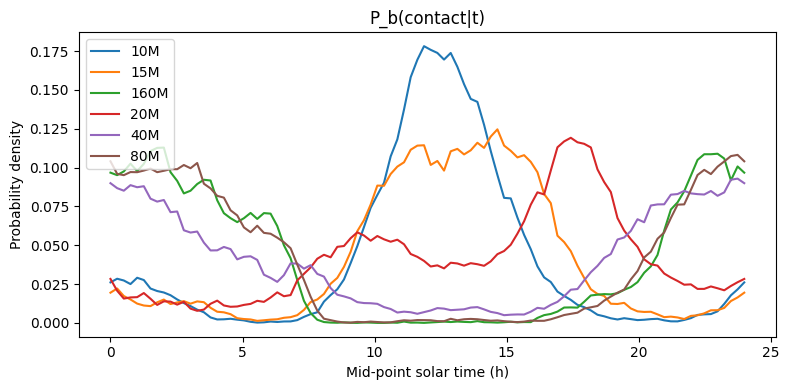

In [113]:
bands = qso_sampled['band'].unique()

Δd = grid_d[1] - grid_d[0]           # 50 km 
Δt = grid_t[1] - grid_t[0]           # 0.25 h (15 min)

prob_time_by_band = {}

for band in bands:
    df = qso_sampled[qso_sampled['band'] == band]

    time_vec = (df['midpoint_solar_time'].dt.hour +
                df['midpoint_solar_time'].dt.minute / 60 +
                df['midpoint_solar_time'].dt.second / 3600).to_numpy()

    dist_vec = df['distance'].to_numpy()

    density = kde2d_warped_epan(time_vec, dist_vec, grid_t, grid_d, h_t, h_d)
    
    p_t = (density.sum(axis=0) * Δd) # Integrate over distance
    p_t /= p_t.sum() * Δt  # Normalize to get probabilities
    
    prob_time_by_band[band] = p_t
    
# Plotting the rate of contact for each band P_b(contact|t)
plt.figure(figsize=(8,4))
for band, p_t in prob_time_by_band.items():
    plt.plot(grid_t, p_t, label=band)
plt.xlabel('Mid-point solar time (h)')
plt.ylabel('Probability density')
plt.title('P_b(contact|t)')
plt.legend()
plt.tight_layout(); plt.show()
  


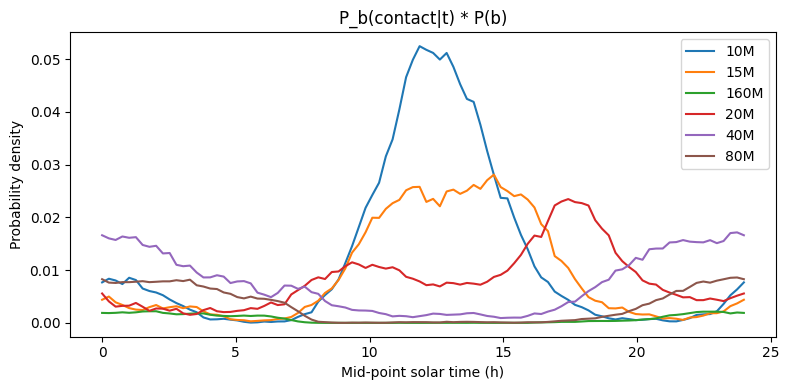

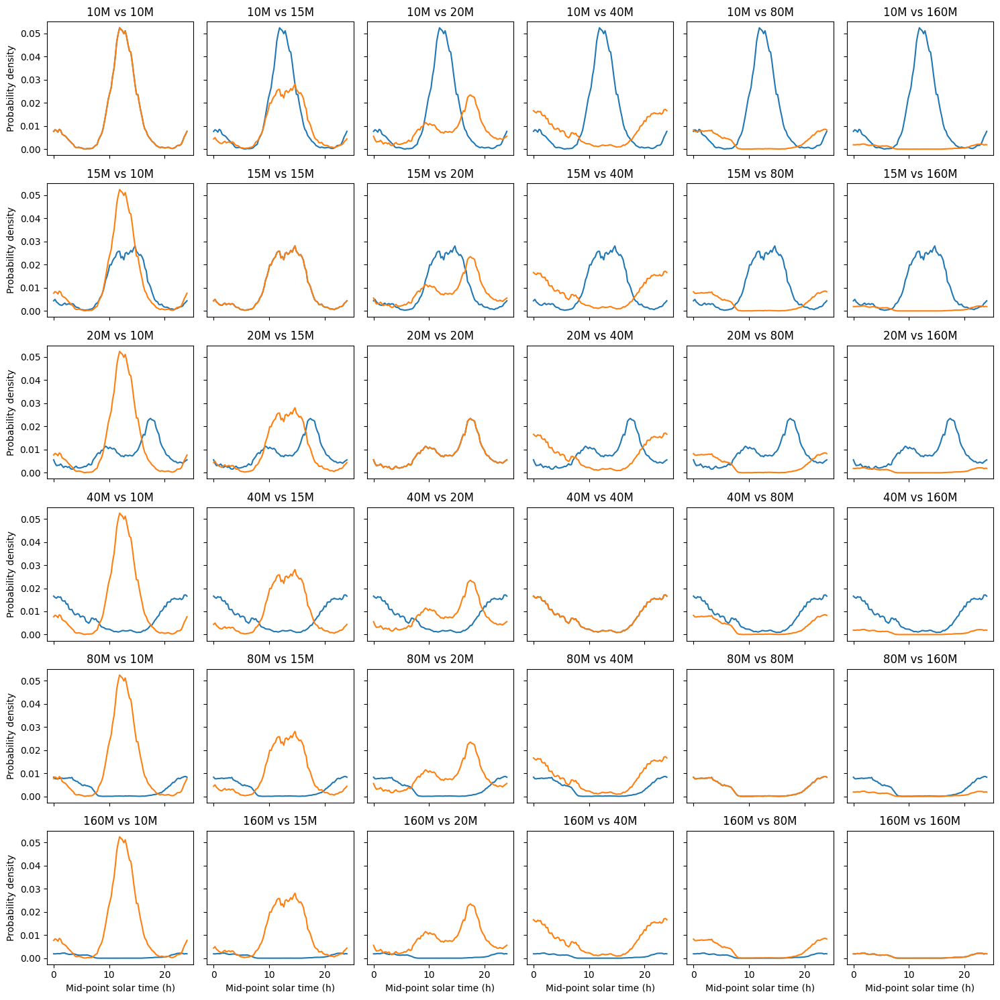

In [114]:
# plot p_b(contact|t) * p(b) (band_prior)
plt.figure(figsize=(8,4))
for band, p_t in prob_time_by_band.items():
    plt.plot(grid_t, p_t * band_prior[band], label=band)
plt.xlabel('Mid-point solar time (h)')
plt.ylabel('Probability density')
plt.title('P_b(contact|t) * P(b)')
plt.legend()
plt.tight_layout(); plt.show()


# plotting on 6 x 6 matrix, both rows and columns are bands, each box is p_b(contact|t) * p(b) (band_prior) for those bands

# Sort bands numerically: 10M, 15M, 20M, 40M, 80M, 160M
band_order = ['10M', '15M', '20M', '40M', '80M', '160M']
sorted_prob_time = {band: prob_time_by_band[band] for band in band_order if band in prob_time_by_band}
sorted_band_prior = band_prior.reindex(band_order)

fig, axes = plt.subplots(nrows=6, ncols=6, figsize=(15, 15), sharex=True, sharey=True)
for i, band1 in enumerate(band_order):
    for j, band2 in enumerate(band_order):
        axes[i, j].plot(grid_t, sorted_prob_time[band1] * sorted_band_prior[band1], label=band1)
        axes[i, j].plot(grid_t, sorted_prob_time[band2] * sorted_band_prior[band2], label=band2)
        axes[i, j].set_title(f'{band1} vs {band2}')
        if i == 5:
            axes[i, j].set_xlabel('Mid-point solar time (h)')
        if j == 0:
            axes[i, j].set_ylabel('Probability density')
plt.tight_layout(); plt.show()

In [121]:
print(pos.columns)  # Display the columns of the pos DataFrame

Index(['sent_call', 'rcvd_call', 'pairs', 'band', 'slice', 'Y', 'CALLSIGN',
       'CATEGORY-POWER', 'CATEGORY-OPERATOR', 'CATEGORY-ASSISTED',
       'CATEGORY-TRANSMITTER', 'GRID-LOCATOR', 'LOG_QSO_COUNT', 'CALLSIGN_RX',
       'CATEGORY-POWER_RX', 'CATEGORY-OPERATOR_RX', 'CATEGORY-ASSISTED_RX',
       'CATEGORY-TRANSMITTER_RX', 'GRID-LOCATOR_RX', 'LOG_QSO_COUNT_RX',
       'distance', 'midpoint_solar_time'],
      dtype='object')


In [122]:
# possible distances pairs based on band - distrbution of distances
# for every contestant pair (if we fix bands) - distance can be calculated, contact probability can be calculated (based on distance) 

band_of_interest = '40M'

pos_40m = pos[pos['band'] == band_of_interest].copy()


#### continue

In [125]:
from itertools import combinations

# Get unique operators and their grid locators using header_df

ops_h = h[['CALLSIGN', 'GRID-LOCATOR']].drop_duplicates().set_index('CALLSIGN')
#ops = pos_40m[['sent_call', 'GRID-LOCATOR']].drop_duplicates().set_index('sent_call')
#ops_rx = pos_40m[['sent_call', 'GRID-LOCATOR_RX']].drop_duplicates().set_index('sent_call')

# Create all possible pairs
all_pairs = list(combinations(ops_h.index, 2))
print(f"Total number of operator pairs: {len(all_pairs)}")


# Sample a subset of pairs (e.g., 5000 pairs)
import numpy as np
np.random.seed(42)
sample_size = min(100000, len(all_pairs))
sampled_pairs = np.random.choice(len(all_pairs), sample_size, replace=False)
sampled_pairs = [all_pairs[i] for i in sampled_pairs]

# Create DataFrame from sampled pairs
operator_pairs_df = pd.DataFrame(sampled_pairs, columns=['op1', 'op2'])

# Merge locators for both operators
operator_pairs_df = operator_pairs_df.merge(ops_h, left_on='op1', right_index=True)
operator_pairs_df = operator_pairs_df.merge(ops_h, left_on='op2', right_index=True, suffixes=('_1', '_2'))

# Vectorized distance calculation
operator_pairs_df['distance'] = operator_pairs_df.apply(
    lambda row: safe_maidenhead_distance(row['GRID-LOCATOR_1'], row['GRID-LOCATOR_2']), axis=1
)

print(operator_pairs_df.head())

Total number of operator pairs: 31621128
      op1     op2 GRID-LOCATOR_1 GRID-LOCATOR_2      distance
0   KE0UI    R9CX         DM78XP         LO97XV   9176.941322
1   DB2WD  LU9GBR         JN39VV         GG02MN  10817.307292
2    KO8Z   RN4SS         EN63UF         LO36XP   8115.947885
3   AF6SA    GW5P         CM98LQ         IO81OO   8329.025311
4  WB2RPW   YC5YC         EN91JM         OJ00RL  15337.206879


In [126]:
# add a column in operator_pairs_df to check if the pair makes contact (refer to pos_40m) - boolean column 0 or 1 (for contact made)
# Create a set of all contacted pairs (unordered)
contacted_pairs = set(
    
    
    tuple(sorted(pair)) for pair in pos_40m['pairs'].values)

# Add contact_made column: 1 if pair made contact, else 0
operator_pairs_df['contact_made'] = operator_pairs_df.apply(
    lambda row: 1 if tuple(sorted([row['op1'], row['op2']])) in contacted_pairs else 0,
    axis=1
)


In [127]:
print(operator_pairs_df[operator_pairs_df['contact_made'] == 1].head())

       op1     op2 GRID-LOCATOR_1 GRID-LOCATOR_2     distance  contact_made
7     K8AC   VE5MX         EM96FJ         DN89AQ  2330.099133             1
52    HG7T    N6NT         KN07VN         EM95BR  8056.066140             1
102   EI9E    W3US         IO62RG         EL98AV  6545.340971             1
138  OK1PI  UA9SMU         JN79VV            NaN          NaN             1
149   DR4A    K5ZD         JN39VV            NaN          NaN             1


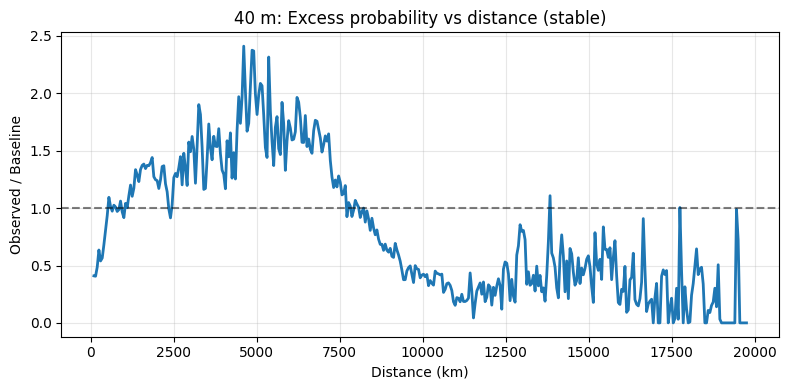

In [129]:
# Use all possible pair distances on 40 m from operator_pairs_df
base_distances_40m = operator_pairs_df['distance'].values

band = '40M'
density = band_kde[band]             # KDE(t,d) for 40m

# observed by distance from KDE
p_obs_d = density.sum(axis=1) * Δt
p_obs_d /= np.trapezoid(p_obs_d, grid_d)


# 1) 1-D baseline ρ(d) on the same grid
def epan(u):
    y = np.zeros_like(u); m = np.abs(u) <= 1
    y[m] = 0.75*(1-u[m]**2); return y


def kde1d_epan_reflect(x, grid, h, a=0.0, b=None):
    x = np.asarray(x, float)
    if b is None: b = grid.max()
    xr = np.concatenate([x, -x + 2*a, -x + 2*b])  # reflect at both ends
    dens = np.zeros_like(grid, float)
    for xi in xr:
        dens += epan((grid - xi)/h) / h
    dens /= len(x)                          # divide by original sample size
    dens /= np.trapezoid(dens, grid)            # renormalise
    return dens

#rho_d = kde1d_epan_reflect(base_distances_40m, grid_d, h=150.0, a=0.0, b=grid_d[-1])


# --- make the baseline more stable near the boundary ---
h_base = 300.0  # wider than before to avoid needle-thin baseline
rho_d = kde1d_epan_reflect(base_distances_40m, grid_d, h=h_base, a=0.0, b=grid_d[-1])

# sanity:
# plt.plot(grid_d, p_obs_d, label='Observed'); plt.plot(grid_d, rho_d, label='Baseline'); plt.legend(); plt.show()

# --- robust ratio ---
# Put a floor under the baseline and/or mask very low-support bins
floor = 1e-3 * rho_d.max()                 # 0.1% of peak baseline
good  = rho_d >= floor                     # only trust bins with enough baseline support
R_d   = np.full_like(rho_d, np.nan)        # prefill with NaN so they don't plot
R_d[good] = p_obs_d[good] / rho_d[good]

# Also trim the last ~2 bandwidths to avoid hard-edge artifacts
edge_trim = int(np.ceil(2 * h_d / (grid_d[1]-grid_d[0])))
mask = np.zeros_like(good, dtype=bool)
mask[edge_trim:len(good)-edge_trim] = True
mask &= good

plt.figure(figsize=(8,4))
plt.plot(grid_d[mask], R_d[mask], lw=2)
plt.axhline(1, color='k', ls='--', alpha=.5)
plt.xlabel('Distance (km)'); plt.ylabel('Observed / Baseline')
plt.title('40 m: Excess probability vs distance (stable)')
plt.grid(True, alpha=.3); plt.tight_layout(); plt.show()



# # 3) ratio vs distance
# eps = 1e-12
# R_d = (p_obs_d+eps)/(rho_d+eps)

# plt.figure(figsize=(8,4))
# plt.plot(grid_d, R_d, lw=2)
# plt.axhline(1, color='k', ls='--', alpha=.5)
# plt.xlabel('Distance (km)'); plt.ylabel('Observed / Baseline')
# plt.title('40 m: Excess probability vs distance')
# plt.grid(True, alpha=.3); plt.tight_layout(); plt.show()


boundary correction near 0

In [130]:
print("base distances min/max:", base_distances_40m.min(), base_distances_40m.max())
print("ρ(d) min/max:", rho_d.min(), rho_d.max())
print("ρ(d) near edge:", rho_d[-5:])                # last few points
print("obs p(d) near edge:", p_obs_d[-5:])


base distances min/max: 0.0 19927.92499701581
ρ(d) min/max: 7.169235203688732e-08 0.00017376698489131578
ρ(d) near edge: [1.55146776e-07 1.19762286e-07 8.61778379e-08 7.47811277e-08
 7.16923520e-08]
obs p(d) near edge: [0.00000000e+00 0.00000000e+00 7.81942384e-07 6.69685590e-07
 0.00000000e+00]


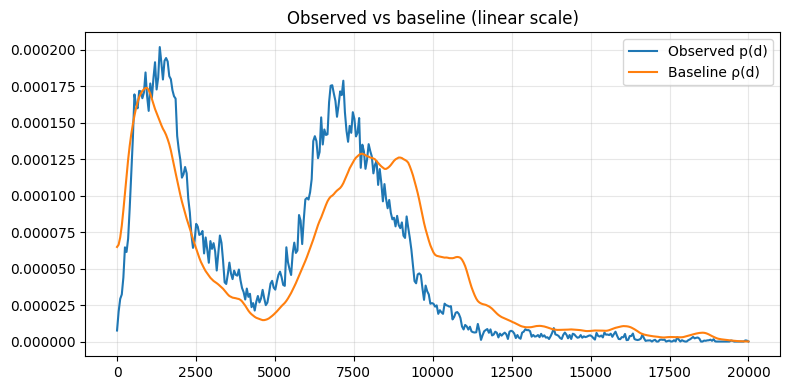

In [131]:
plt.figure(figsize=(8,4))
plt.plot(grid_d, p_obs_d, label='Observed p(d)')
plt.plot(grid_d, rho_d, label='Baseline ρ(d)')
plt.legend(); plt.title('Observed vs baseline (linear scale)')
plt.grid(True, alpha=.3); plt.tight_layout(); plt.show()


In [132]:
import numpy as np
import matplotlib.pyplot as plt
from numpy import trapezoid

# Epanechnikov kernel and 1D KDE with reflection (boundary correction)
def epan(u):
    y = np.zeros_like(u, float)
    m = np.abs(u) <= 1
    y[m] = 0.75 * (1 - u[m]**2)
    return y

def kde1d_epan_reflect(x, grid, h, a=0.0, b=None):
    '''
    1D Epanechnikov kernel density estimation with reflection at boundaries.

    Parameters
    ----------
    x : array_like
        Input data points.
    grid : array_like
        Evaluation grid points.
    h : float
        Bandwidth (kernel width).
    a : float, optional
        Left boundary for reflection (default is 0.0).
    b : float, optional
        Right boundary for reflection (default is None, which uses grid.max()).

    Returns
    -------
    dens : array_like
        Estimated density values at the evaluation grid points.
    '''
    
    x = np.asarray(x, float)
    if b is None: b = grid.max()
    xr = np.concatenate([x, -x + 2*a, -x + 2*b])  # reflect ends
    dens = np.zeros_like(grid, float)
    for xi in xr:
        dens += epan((grid - xi)/h) / h
    dens /= len(x)                      # divide by original sample size
    dens /= trapezoid(dens, grid)       # normalise to integrate to 1
    return dens

# Build a canonical grid per callsign (mode over both sent/recv locators)
def make_canonical_grid_map(pos_band):
    a = pos_band[['sent_call','GRID-LOCATOR']].rename(columns={'sent_call':'call','GRID-LOCATOR':'grid'})
    b = pos_band[['rcvd_call','GRID-LOCATOR_RX']].rename(columns={'rcvd_call':'call','GRID-LOCATOR_RX':'grid'})
    locs = pd.concat([a,b], ignore_index=True).dropna()
    locs['grid'] = locs['grid'].str.strip().str.upper()
    return locs.groupby('call')['grid'].agg(lambda s: s.value_counts().idxmax())

# Sample “all possible pairs” distances quickly (approximation)
def sample_pair_distances(grid_map, max_pairs=100_000, seed=42):
    calls = grid_map.index.to_numpy()
    if len(calls) < 2:
        return np.array([])
    rng = np.random.default_rng(seed)
    i = rng.choice(len(calls), size=max_pairs, replace=True)
    j = rng.choice(len(calls), size=max_pairs, replace=True)
    g1 = grid_map.iloc[i].to_numpy()
    g2 = grid_map.iloc[j].to_numpy()
    # function to compute distance between two Maidenhead locators:
    return np.array([safe_maidenhead_distance(a,b) for a,b in zip(g1,g2)], dtype=float)

# Availability baseline π(t): unique active stations per time bin (sender or receiver)
def availability_baseline(pos_band, grid_t):
    hours = (pos_band['midpoint_solar_time'].dt.hour
             + pos_band['midpoint_solar_time'].dt.minute/60
             + pos_band['midpoint_solar_time'].dt.second/3600).to_numpy()
    # count unique stations per bin
    bins = np.append(grid_t, 24.0)
    
    hist, _ = np.histogram(hours, bins=bins)
    pi = hist.astype(float) + 1e-9
    pi /= trapezoid(pi, grid_t)
    return pi


In [133]:
print(p_obs_d.shape, grid_d.shape)

(400,) (400,)


#### continue

In [141]:
from pytz import utc


utc_grid_df = qso_sampled[['slice', 'sent_call', 'rcvd_call', 'GRID-LOCATOR', 'GRID-LOCATOR_RX']]
sent_utc_grid_df = utc_grid_df[['slice', 'sent_call', 'GRID-LOCATOR']].copy()
sent_utc_grid_df['call_type'] = 'sent_call'
rcvd_utc_grid_df = utc_grid_df[['slice', 'rcvd_call', 'GRID-LOCATOR_RX']].copy()
rcvd_utc_grid_df['call_type'] = 'rcvd_call'
# rename sent_call and rcvd_call to call and gridlocators to grid
sent_utc_grid_df.rename(columns={'sent_call': 'call', 'GRID-LOCATOR': 'grid'}, inplace=True)
rcvd_utc_grid_df.rename(columns={'rcvd_call': 'call', 'GRID-LOCATOR_RX': 'grid'}, inplace=True)

#print(sent_utc_grid_df.head())
#print(rcvd_utc_grid_df.head())

# merge the two tables
utc_grid_merged_df = pd.concat([sent_utc_grid_df, rcvd_utc_grid_df], ignore_index=True)
print(utc_grid_merged_df.head())

print(utc_grid_df.shape)
print(utc_grid_merged_df.shape)

# adjust slice column to extract UTC time only (not the date)
# make sure it's datetime in UTC
utc_grid_merged_df['slice'] = pd.to_datetime(utc_grid_merged_df['slice'], utc=True, errors='coerce')

# 1) string time (HH:MM:SS) if you want to display it
utc_grid_merged_df['utc_time'] = utc_grid_merged_df['slice'].dt.strftime('%H:%M:%S')

# 2) numeric hour in [0, 24) — best for heatmaps/plots
utc_grid_merged_df['utc_hour'] = (
    utc_grid_merged_df['slice'].dt.hour
    + utc_grid_merged_df['slice'].dt.minute/60
    + utc_grid_merged_df['slice'].dt.second/3600
)

# (optional) drop the original datetime if you don’t need it
# utc_grid_merged_df = utc_grid_merged_df.drop(columns=['slice'])

print(utc_grid_merged_df.head())

def maidenhead_grid_to_longitude(grid):
    """Convert Maidenhead grid locator to longitude. using maidenhead package"""
    
    coords = mh.to_location(grid)
    return coords[1]

utc_grid_merged_df = utc_grid_merged_df.dropna(subset=['grid'])  # drop rows with NaN grid locators
utc_grid_merged_df['longitude'] = utc_grid_merged_df['grid'].apply(maidenhead_grid_to_longitude)

print(utc_grid_merged_df.head())
print(utc_grid_merged_df.shape)


print(max(utc_grid_merged_df['longitude']), min(utc_grid_merged_df['longitude']))

                slice    call    grid  call_type
0 2024-11-24 22:00:00  7L4MDM  QM06HN  sent_call
1 2024-11-24 10:00:00    IO4N  JN64GB  sent_call
2 2024-11-24 08:15:00  YO4FPF  KN44HE  sent_call
3 2024-11-24 10:45:00   F4FFZ  IN87LU  sent_call
4 2024-11-23 12:30:00    CQ9A     NaN  sent_call
(120000, 5)
(240000, 4)


                      slice    call    grid  call_type  utc_time  utc_hour
0 2024-11-24 22:00:00+00:00  7L4MDM  QM06HN  sent_call  22:00:00     22.00
1 2024-11-24 10:00:00+00:00    IO4N  JN64GB  sent_call  10:00:00     10.00
2 2024-11-24 08:15:00+00:00  YO4FPF  KN44HE  sent_call  08:15:00      8.25
3 2024-11-24 10:45:00+00:00   F4FFZ  IN87LU  sent_call  10:45:00     10.75
4 2024-11-23 12:30:00+00:00    CQ9A     NaN  sent_call  12:30:00     12.50
                      slice    call    grid  call_type  utc_time  utc_hour  \
0 2024-11-24 22:00:00+00:00  7L4MDM  QM06HN  sent_call  22:00:00     22.00   
1 2024-11-24 10:00:00+00:00    IO4N  JN64GB  sent_call  10:00:00     10.00   
2 2024-11-24 08:15:00+00:00  YO4FPF  KN44HE  sent_call  08:15:00      8.25   
3 2024-11-24 10:45:00+00:00   F4FFZ  IN87LU  sent_call  10:45:00     10.75   
6 2024-11-23 01:45:00+00:00    L33M  FF57NC  sent_call  01:45:00      1.75   

    longitude  
0  140.583333  
1   12.500000  
2   28.583333  
3   -3.083333  
6

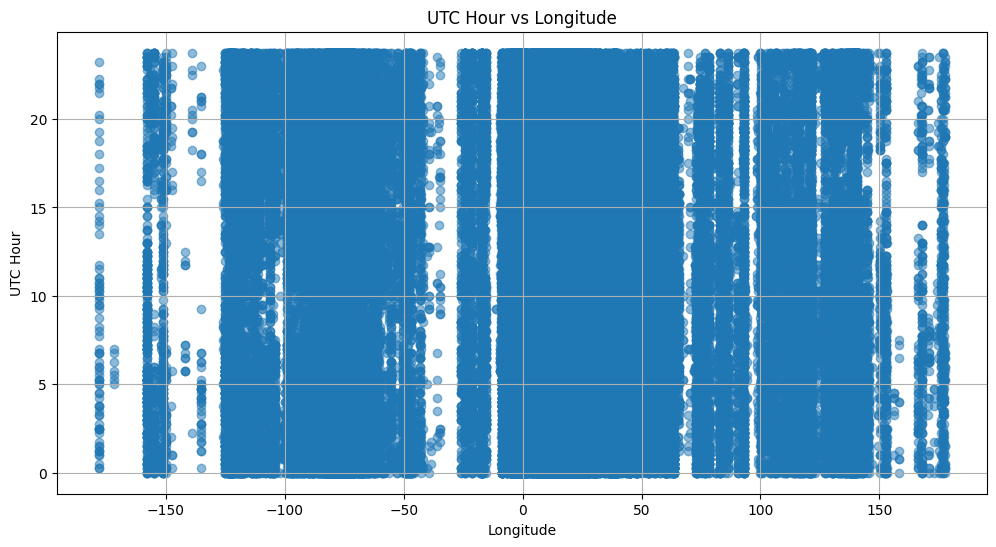

In [142]:
# scatter plot of utc hour(y axis) against longitude(x axis)

plt.figure(figsize=(12, 6))
plt.scatter(utc_grid_merged_df['longitude'], utc_grid_merged_df['utc_hour'], alpha=0.5)
plt.title('UTC Hour vs Longitude')
plt.xlabel('Longitude')
plt.ylabel('UTC Hour')
plt.grid()
plt.show()

# KDE plot

# plt.figure(figsize=(12, 6))
# sns.kdeplot(data=utc_grid_merged_df, x='longitude', y='utc_hour', cmap='Blues', fill=True)
# plt.title('KDE Plot of UTC Hour vs Longitude')
# plt.xlabel('Longitude')
# plt.ylabel('UTC Hour')
# plt.grid()
# plt.show()


C:\Users\neela\AppData\Local\Temp\ipykernel_24936\2011752964.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['utc_bin', 'lon_bin'])


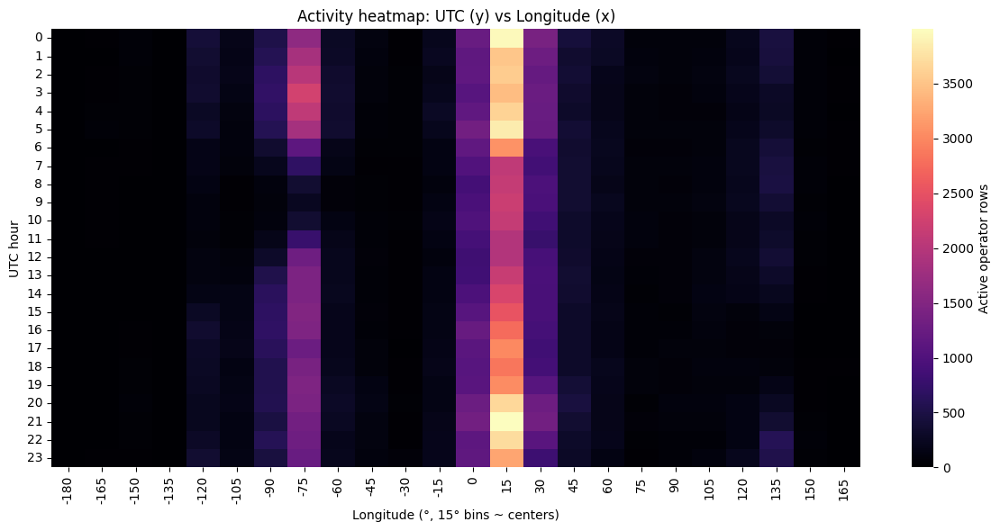

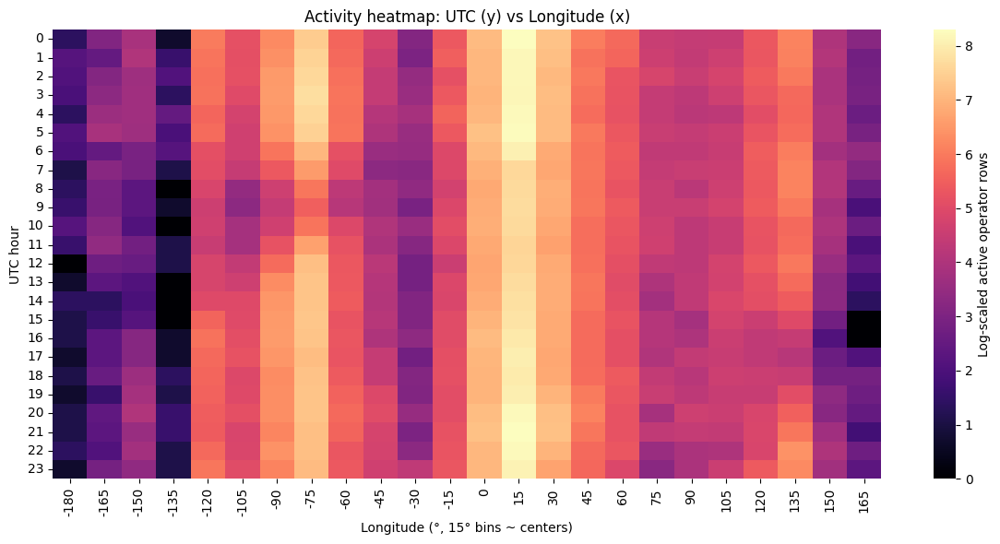

In [143]:
utc_grid_heat = utc_grid_merged_df.copy()

# keep only rows with both utc_hour and longitude
utc_grid_heat = utc_grid_heat.dropna(subset=['utc_hour', 'longitude'])

# ---- 15° longitude bins from -180 to 180 ----
lon_bins = np.arange(-180-7.5, 180 + 7.5, 15)          # [-180,-165),..., [165,180)
utc_grid_heat['lon_bin'] = pd.cut(utc_grid_heat['longitude'],
                       bins=lon_bins,
                       right=False,               # left-closed, right-open
                       include_lowest=True)

# ---- 1-hour UTC bins: [0,1), [1,2), ..., [23,24) ----
t_bins = np.arange(0, 24 + 1, 1)
utc_grid_heat['utc_bin'] = pd.cut(utc_grid_heat['utc_hour'] % 24,
                       bins=t_bins,
                       right=False,
                       include_lowest=True)

# ---- contingency table: counts per (UTC hour bin, longitude bin) ----
heat = (utc_grid_heat
        .groupby(['utc_bin', 'lon_bin'])
        .size()
        .unstack(fill_value=0)
        .sort_index())

# nicer y tick labels: 0..23
heat.index = heat.index.map(lambda iv: int(iv.left))

# optional: shorter x tick labels (bin centers)
def bin_center(iv): 
    try:
        return int((iv.left + iv.right)/2)
    except Exception:
        return iv
heat.columns = heat.columns.map(bin_center)

# ---- plot heatmap ----
plt.figure(figsize=(12, 6))
sns.heatmap(heat, cmap='magma', cbar_kws={'label': 'Active operator rows'})
plt.xlabel('Longitude (°, 15° bins ~ centers)')
plt.ylabel('UTC hour')
plt.yticks(rotation=0)
plt.title('Activity heatmap: UTC (y) vs Longitude (x)')
plt.tight_layout()
plt.show()

# ---- plot log scaled (count) heatmap ----

plt.figure(figsize=(12, 6))
sns.heatmap(np.log1p(heat), cmap='magma', cbar_kws={'label': 'Log-scaled active operator rows'})
plt.xlabel('Longitude (°, 15° bins ~ centers)')
plt.ylabel('UTC hour')
plt.yticks(rotation=0)
plt.title('Activity heatmap: UTC (y) vs Longitude (x)')
plt.tight_layout()
plt.show()



In [144]:

from scipy.stats import chisquare
from statsmodels.stats.multitest import multipletests

# heat: rows = UTC hours (0..23), cols = longitude centers
time_weights = (heat.sum(axis=1).to_numpy() / heat.values.sum())  # global time-of-day profile

def chisq_one_col(obs_counts, expected_mode='uniform', time_weights=None,
                  min_exp=5, agg_hours=2):
    """
    Chi-square GOF for one longitude column.
    expected_mode: 'uniform' or 'global_time'
    If too many expected < min_exp, aggregate hours into agg_hours bins (must divide 24).
    Returns dict with chi2, p, dof, n, k, min_expected, note
    """
    obs = np.asarray(obs_counts, float)
    k = len(obs); n = obs.sum()

    if expected_mode == 'uniform':
        expected = np.full(k, n / k)
    elif expected_mode == 'global_time':
        expected = n * np.asarray(time_weights, float)
    else:
        raise ValueError("expected_mode must be 'uniform' or 'global_time'")

    note = '24×1h'
    if (expected < min_exp).mean() > 0.20:  # >20% bins too small → aggregate
        if 24 % agg_hours != 0:
            raise ValueError("agg_hours must divide 24")
        g = 24 // agg_hours
        obs = obs.reshape(g, agg_hours).sum(axis=1)
        if expected_mode == 'uniform':
            expected = np.full(g, obs.sum() / g)
        else:
            tw = np.asarray(time_weights, float).reshape(g, agg_hours).sum(axis=1)
            expected = obs.sum() * tw
        k = len(obs); n = obs.sum()
        note = f'aggregated to {agg_hours}-hour bins'

    chi2, p = chisquare(f_obs=obs, f_exp=expected)
    dof = k - 1
    v = np.sqrt((chi2 / n) / (k - 1))  # Cramér's V for 1-way
    return dict(chi2=chi2, p=p, dof=dof, n=n, k=k, v=v,
                min_expected=expected.min(), note=note)

# ----- Run per longitude bin under two nulls -----
results_uniform = []
results_timeprof = []

for lon in heat.columns:
    col_counts = heat[lon].to_numpy()

    res_u = chisq_one_col(col_counts, expected_mode='uniform',
                          time_weights=None, min_exp=5, agg_hours=2)
    res_u['lon'] = lon
    results_uniform.append(res_u)

    res_t = chisq_one_col(col_counts, expected_mode='global_time',
                          time_weights=time_weights, min_exp=5, agg_hours=2)
    res_t['lon'] = lon
    results_timeprof.append(res_t)

df_u = pd.DataFrame(results_uniform).set_index('lon').sort_index()
df_t = pd.DataFrame(results_timeprof).set_index('lon').sort_index()

# FDR correction across longitude bins
df_u['p_fdr'] = multipletests(df_u['p'].values, method='fdr_bh')[1]
df_t['p_fdr'] = multipletests(df_t['p'].values, method='fdr_bh')[1]

print("\n=== Chi-square vs UNIFORM per longitude ===")
print(df_u[['chi2','dof','p','p_fdr','v','min_expected','note']].round(4))

print("\n=== Chi-square vs GLOBAL TIME PROFILE per longitude ===")
print(df_t[['chi2','dof','p','p_fdr','v','min_expected','note']].round(4))

# Quick summary counts
alpha = 0.05
print("\nSignificant (FDR<0.05) vs UNIFORM:", (df_u['p_fdr'] < alpha).sum(), "of", len(df_u))
print("Significant (FDR<0.05) vs GLOBAL TIME:", (df_t['p_fdr'] < alpha).sum(), "of", len(df_t))



=== Chi-square vs UNIFORM per longitude ===
           chi2  dof       p   p_fdr       v  min_expected  \
lon                                                          
-180    26.1111   11  0.0062  0.0062  0.1712        6.7500   
-165   164.4962   23  0.0000  0.0000  0.1349       16.3750   
-150   224.9024   23  0.0000  0.0000  0.1221       27.3333   
-135    48.9091   11  0.0000  0.0000  0.2596        5.5000   
-120   965.2987   23  0.0000  0.0000  0.0856      238.5417   
-105   432.1742   23  0.0000  0.0000  0.0807      120.2917   
-90   2032.8792   23  0.0000  0.0000  0.0878      478.0417   
-75   4858.4108   23  0.0000  0.0000  0.0814     1326.7500   
-60    643.4096   23  0.0000  0.0000  0.0721      224.4167   
-45    332.4924   23  0.0000  0.0000  0.0883       77.1667   
-30    132.9095   23  0.0000  0.0000  0.0934       27.6250   
-15    239.3665   23  0.0000  0.0000  0.0509      167.5833   
 0     438.6203   23  0.0000  0.0000  0.0270     1088.4583   
 15   3866.7537   23  0.0

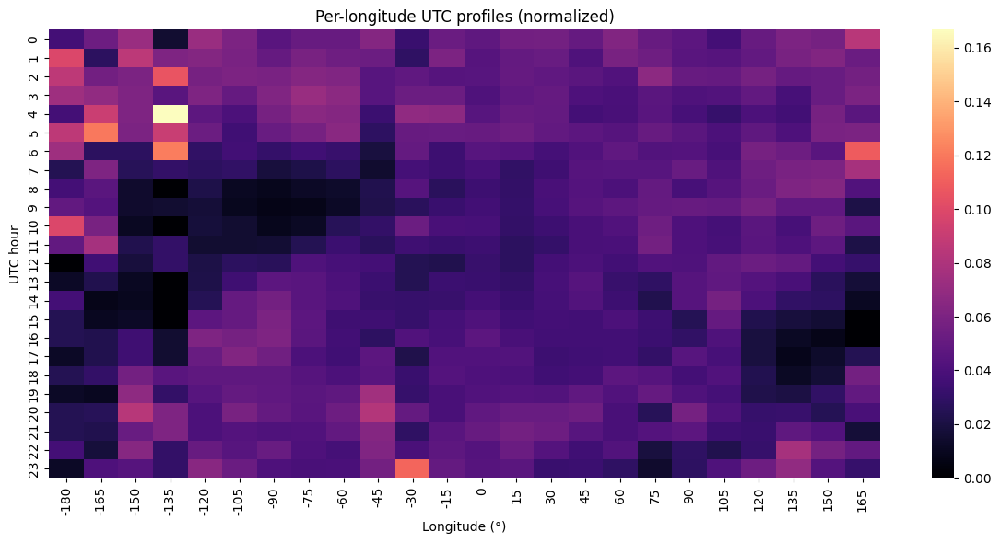

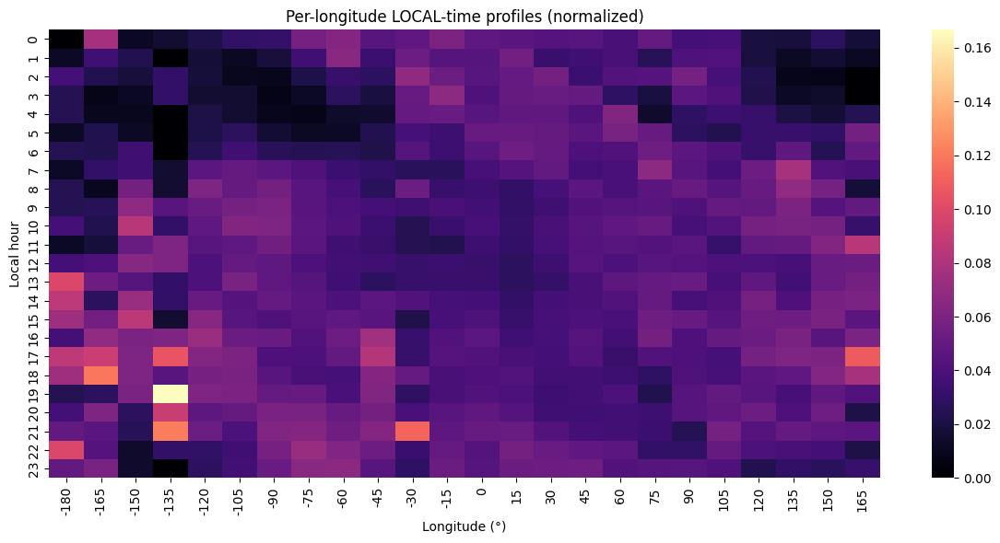

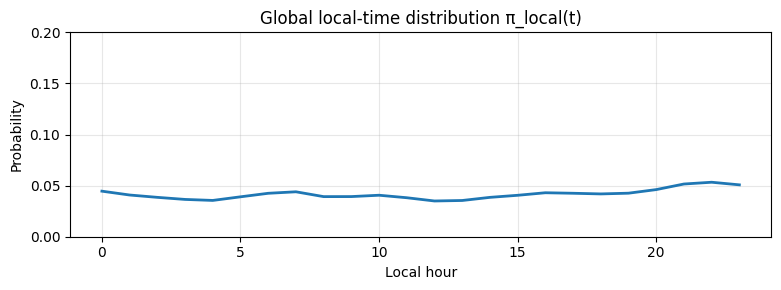


Chi-square vs shifted local-time baseline (per longitude):
           chi2       p  min_expected
lon                                  
-180    37.9241  0.0260        2.8326
-165   150.8509  0.0000       13.7435
-150   257.5728  0.0000       22.9408
-135    61.3611  0.0000        2.3081
-120   985.5147  0.0000      200.2070
-105   469.6341  0.0000      100.9603
-90   1842.8760  0.0000      401.2184
-75   3348.1593  0.0000     1113.5357
-60    435.7182  0.0000      188.3520
-45    262.1135  0.0000       64.7657
-30    114.8337  0.0000       23.1855
-15    252.1214  0.0000      140.6520
 0     373.4771  0.0000      913.5385
 15   3056.1252  0.0000     2476.3773
 30    889.3455  0.0000      870.6645
 45    205.3395  0.0000      293.7535
 60    257.1754  0.0000      163.1731
 75    191.8691  0.0000       63.3319
 90    108.7457  0.0000       61.9680
 105    50.2777  0.0008       80.6074
 120   429.7933  0.0000      140.1274
 135  1473.7485  0.0000      270.5330
 150   170.5903  0.0000     

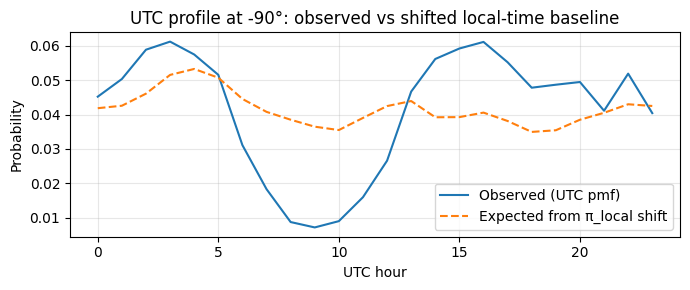

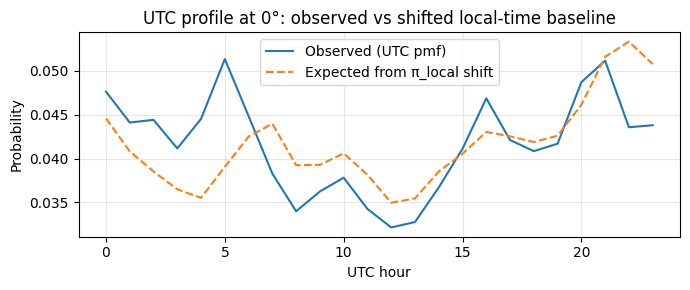

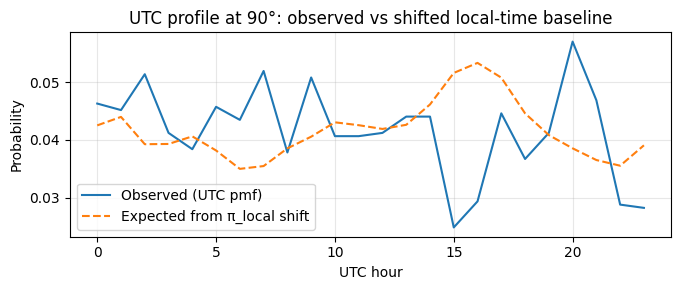

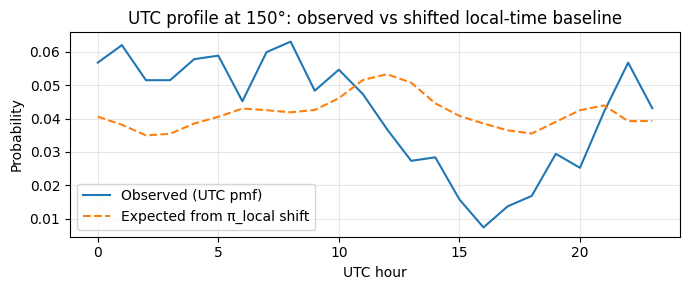

In [145]:

# --- Inputs ---
# heat: 24x24 DataFrame, rows = UTC hours 0..23, cols = longitude centers (…,-180,-165,…,180)

# 1) Visualize per-longitude UTC profiles (each column normalized to sum 1)
M = heat.values.astype(float)                           # shape (24, 24)
col_sums = M.sum(axis=0, keepdims=True).clip(min=1e-12)
P_utc = M / col_sums                                    # per-longitude pmf over UTC
plt.figure(figsize=(12,6))
sns.heatmap(P_utc, cmap='magma', xticklabels=heat.columns, yticklabels=heat.index)
plt.xlabel('Longitude (°)'); plt.ylabel('UTC hour'); plt.title('Per-longitude UTC profiles (normalized)')
plt.tight_layout(); plt.show()

# 2) Convert each longitude column to LOCAL time by circularly shifting rows by L/15 hours
#    With 15° longitude bins and 1h UTC bins, L/15 is an integer shift.
lon_centers = heat.columns.to_numpy()
shifts = (lon_centers / 15.0).astype(int)               # east positive (local = UTC + shift)
A_local = np.empty_like(M)
for j, s in enumerate(shifts):
    A_local[:, j] = np.roll(M[:, j], s)                 # row-roll by +shift -> local-time axis

# Column-normalized local-time profiles
col_sums_local = A_local.sum(axis=0, keepdims=True).clip(min=1e-12)
P_local = A_local / col_sums_local

plt.figure(figsize=(12,6))
sns.heatmap(P_local, cmap='magma', xticklabels=heat.columns, yticklabels=heat.index)
plt.xlabel('Longitude (°)'); plt.ylabel('Local hour'); plt.title('Per-longitude LOCAL-time profiles (normalized)')
plt.tight_layout(); plt.show()

# 3) Estimate the global local-time distribution π_local(t)
pi_local_counts = A_local.sum(axis=1)                   # sum over longitude -> counts by local hour
pi_local = pi_local_counts / pi_local_counts.sum()      # pmf over local hour (length 24)

plt.figure(figsize=(8,3))
plt.plot(heat.index, pi_local, lw=2)
plt.ylim(0, 0.2)
plt.xlabel('Local hour'); plt.ylabel('Probability'); plt.title('Global local-time distribution π_local(t)')
plt.grid(alpha=0.3); plt.tight_layout(); plt.show()

# 4) OPTIONAL: test each longitude column against the SHIFTED local-time baseline
#    Expected UTC profile for column j is total_j * roll(pi_local, -shift_j)
results = []
for j, L in enumerate(lon_centers):
    shift = int(L/15)
    obs = M[:, j]
    n = obs.sum()
    exp = n * np.roll(pi_local, -shift)                 # shift back to UTC
    chi2, p = chisquare(f_obs=obs, f_exp=exp)
    results.append((L, chi2, p, exp.min()))

res_df = pd.DataFrame(results, columns=['lon','chi2','p','min_expected']).set_index('lon').sort_index()
print("\nChi-square vs shifted local-time baseline (per longitude):")
print(res_df.round(4))

# Quick visualization: overlay observed vs expected for a few longitudes
example_lons = [ -90, 0, 90, 150 ]                      # pick any present in heat.columns
for L in example_lons:
    if L in heat.columns:
        j = list(heat.columns).index(L)
        obs = M[:, j]
        exp = obs.sum() * np.roll(pi_local, -int(L/15))
        plt.figure(figsize=(7,3))
        plt.plot(heat.index, obs/obs.sum(), label='Observed (UTC pmf)')
        plt.plot(heat.index, exp/exp.sum(), label='Expected from π_local shift', ls='--')
        plt.title(f'UTC profile at {L}°: observed vs shifted local-time baseline')
        plt.xlabel('UTC hour'); plt.ylabel('Probability'); plt.legend(); plt.grid(alpha=0.3)
        plt.tight_layout(); plt.show()


C:\Users\neela\AppData\Local\Temp\ipykernel_24936\386438366.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(['utc_bin', 'lon_bin'])


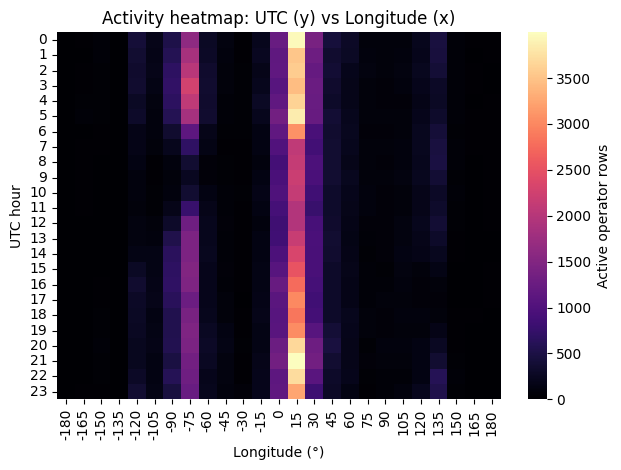

In [146]:


# --- 15° bins centered on multiples of 15 ---
# edges offset by 7.5°, so centers are …, -180, -165, …, -15, 0, 15, …, 180
lon_edges = np.arange(-180 - 7.5, 180 + 7.5 + 1e-9, 15)
utc_grid_heat['lon_bin'] = pd.cut(
    utc_grid_heat['longitude'],
    bins=lon_edges,
    right=False,
    include_lowest=True
)

# --- 1-hour UTC bins (unchanged) ---
t_edges = np.arange(0, 24 + 1, 1)
utc_grid_heat['utc_bin'] = pd.cut(
    (utc_grid_heat['utc_hour'] % 24),
    bins=t_edges,
    right=False,
    include_lowest=True
)

# Contingency table
heat = (utc_grid_heat
        .groupby(['utc_bin', 'lon_bin'])
        .size()
        .unstack(fill_value=0))

# Order by longitude (left edge) and relabel columns by **center** (multiples of 15)
heat = heat.reindex(columns=sorted(heat.columns, key=lambda iv: iv.left))
def center_deg(iv):
    return int(round((iv.left + iv.right) / 2.0))  # will be …,-180,-165,…,0,15,…,180
heat.columns = [center_deg(iv) for iv in heat.columns]

# Y ticks as 0..23
heat.index = heat.index.map(lambda iv: int(iv.left))

# Plot
ax = sns.heatmap(heat, cmap='magma', cbar_kws={'label': 'Active operator rows'})
ax.set_xlabel('Longitude (°)')
ax.set_ylabel('UTC hour')
#ax.set_yticks(range(0, 24, 2))
ax.set_title('Activity heatmap: UTC (y) vs Longitude (x)')

# (optional) pretty labels with signs or E/W
# ax.set_xticklabels([f'{x:+d}' for x in heat.columns], rotation=0)       # +15, -15, etc
# ax.set_xticklabels([f'{abs(x)}°{"E" if x>=0 else "W"}' for x in heat.columns], rotation=0)

plt.tight_layout(); plt.show()


C:\Users\neela\AppData\Local\Temp\ipykernel_24936\1258457834.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  heat = points.groupby([utc_cuts, lon_cuts]).size().unstack(fill_value=0)


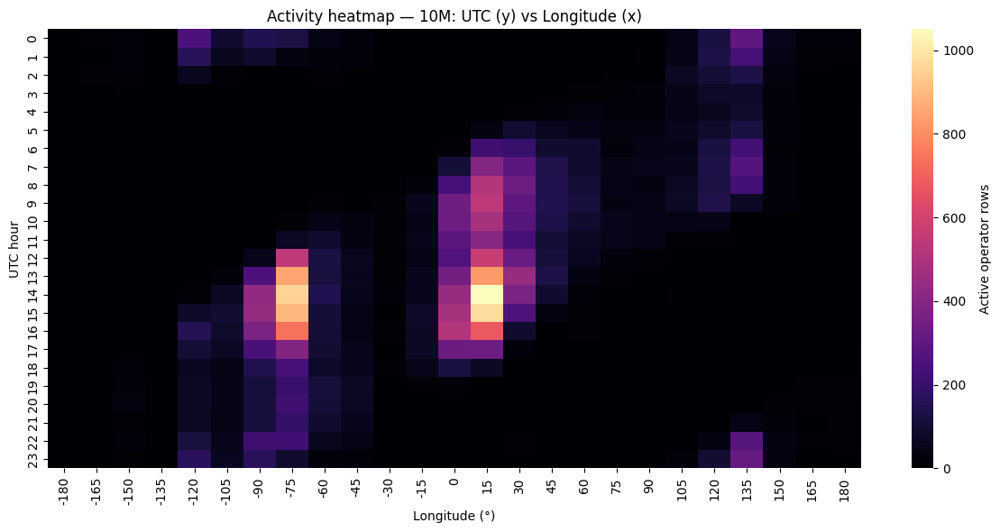

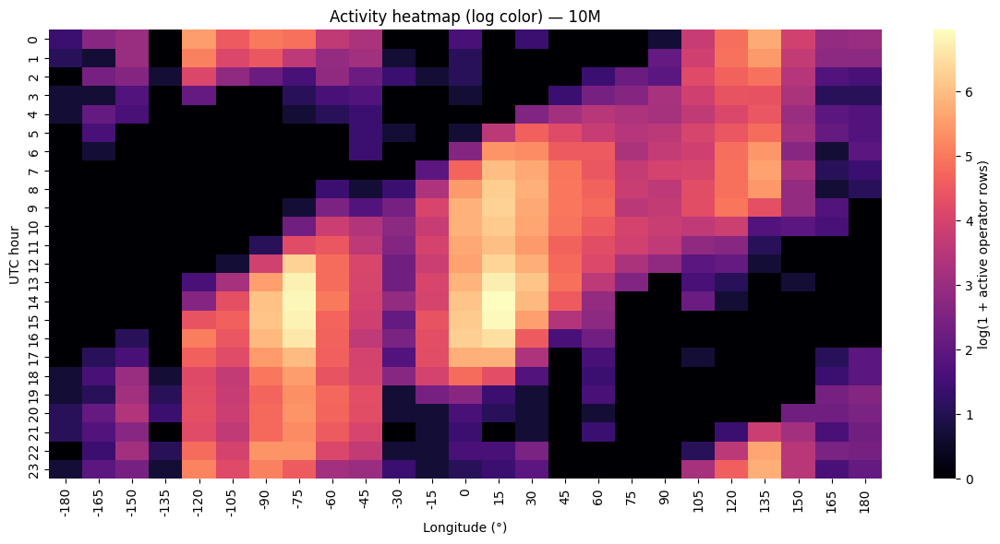

C:\Users\neela\AppData\Local\Temp\ipykernel_24936\1258457834.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  heat = points.groupby([utc_cuts, lon_cuts]).size().unstack(fill_value=0)


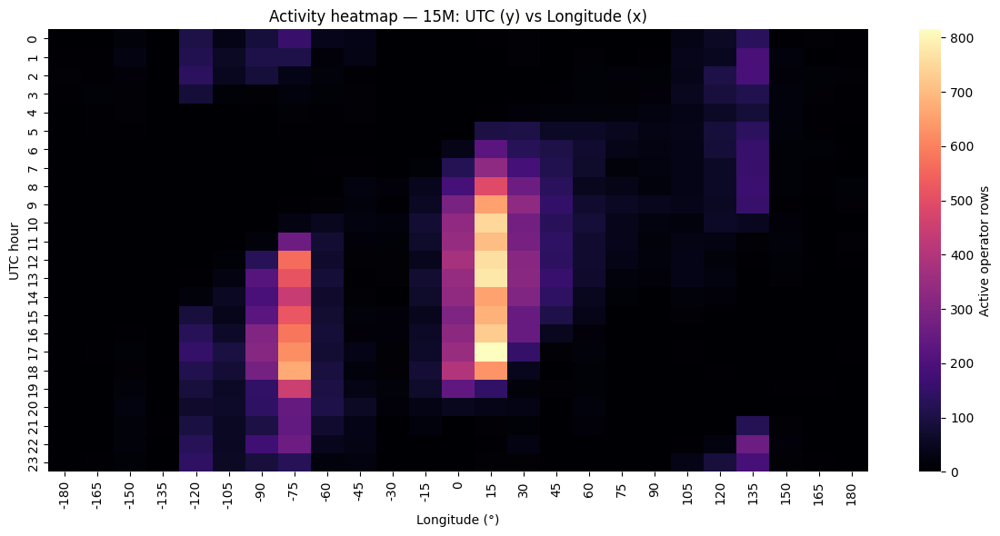

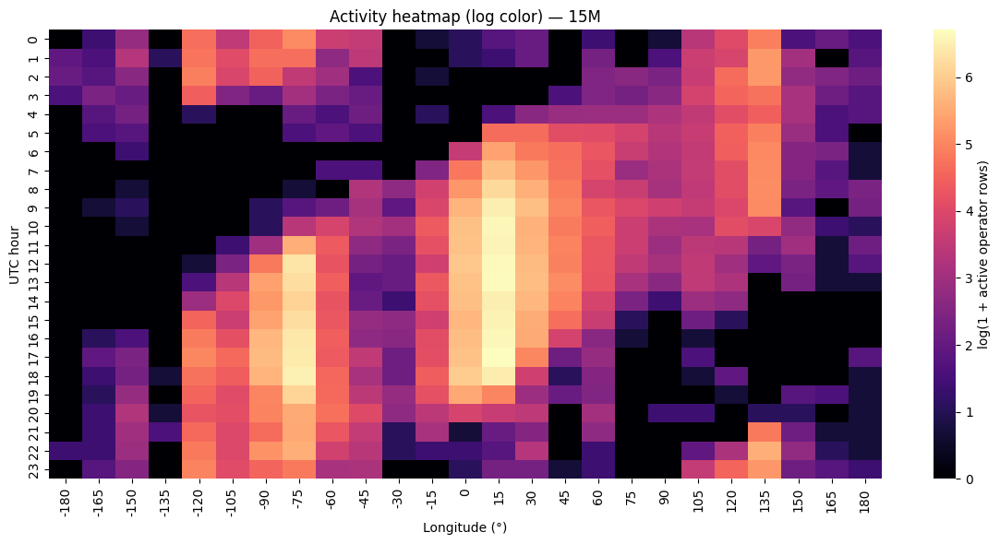

C:\Users\neela\AppData\Local\Temp\ipykernel_24936\1258457834.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  heat = points.groupby([utc_cuts, lon_cuts]).size().unstack(fill_value=0)


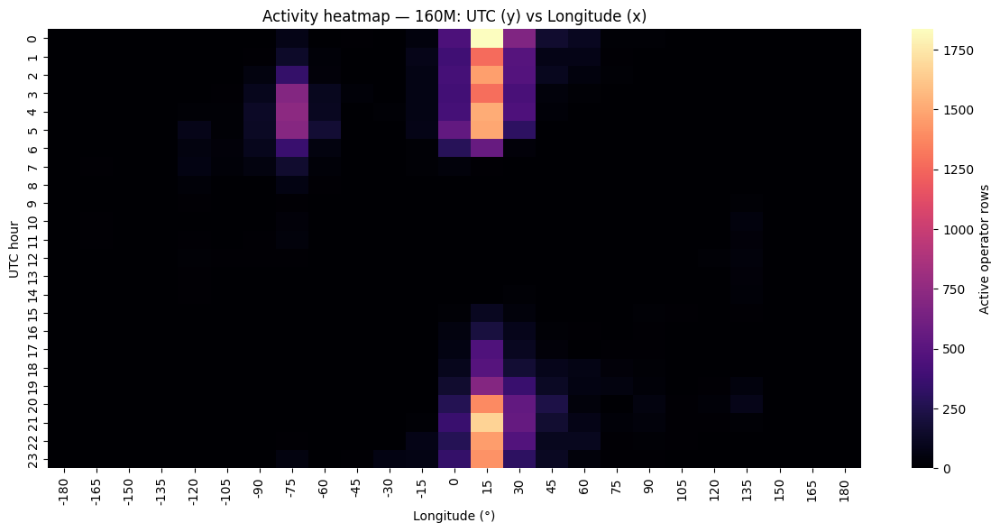

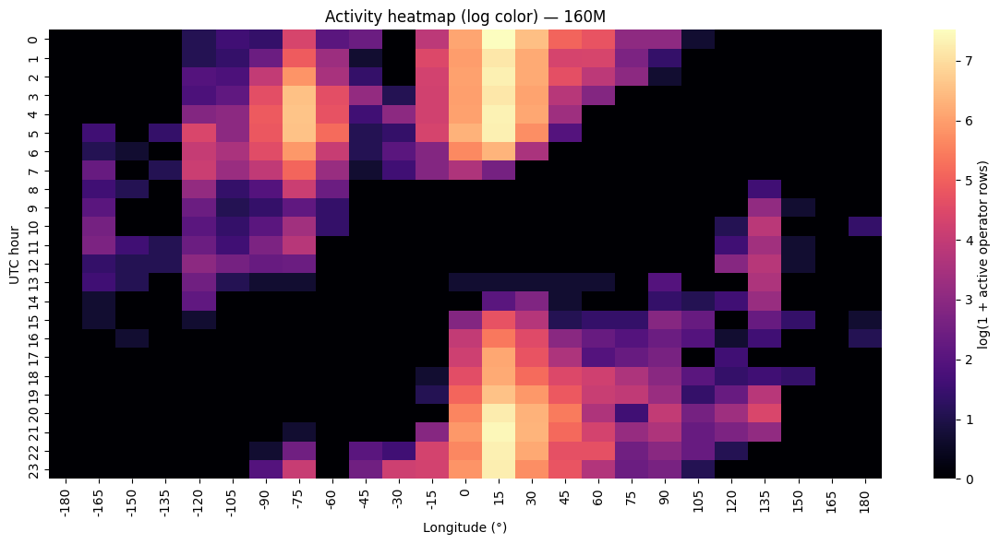

C:\Users\neela\AppData\Local\Temp\ipykernel_24936\1258457834.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  heat = points.groupby([utc_cuts, lon_cuts]).size().unstack(fill_value=0)


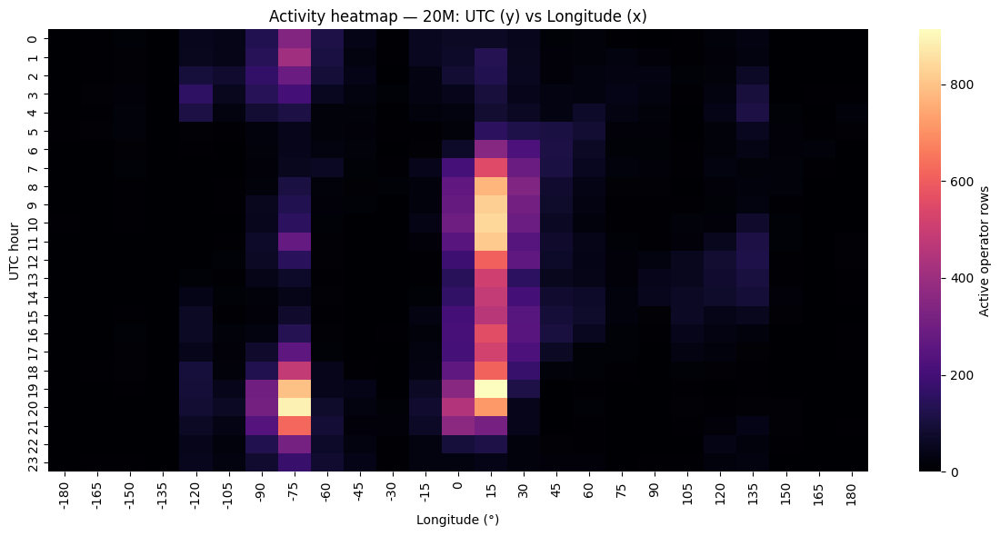

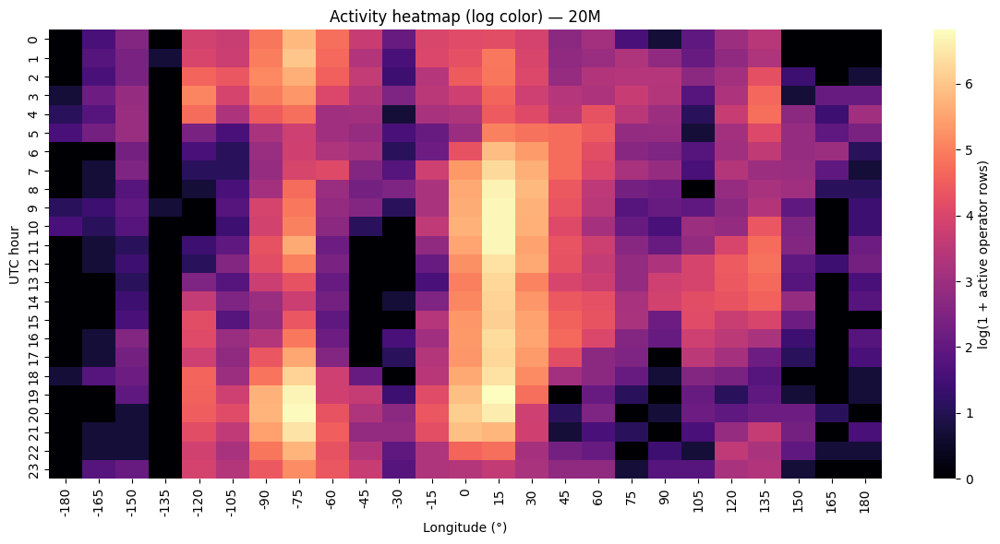

C:\Users\neela\AppData\Local\Temp\ipykernel_24936\1258457834.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  heat = points.groupby([utc_cuts, lon_cuts]).size().unstack(fill_value=0)


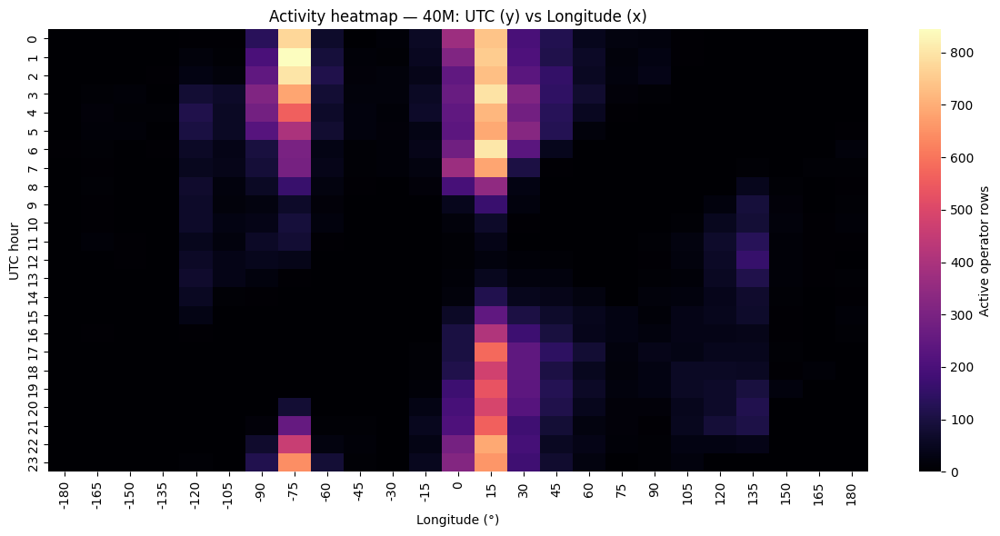

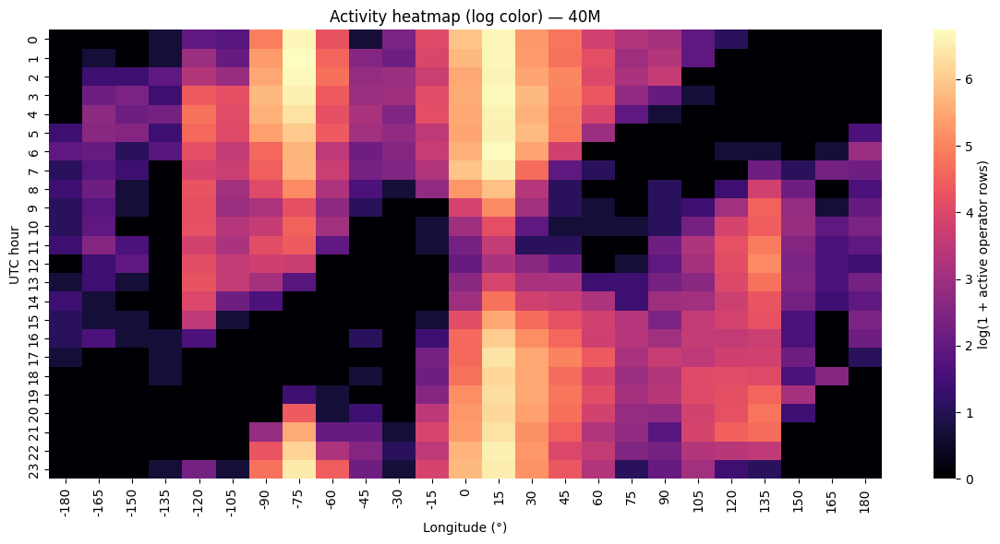

C:\Users\neela\AppData\Local\Temp\ipykernel_24936\1258457834.py:46: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  heat = points.groupby([utc_cuts, lon_cuts]).size().unstack(fill_value=0)


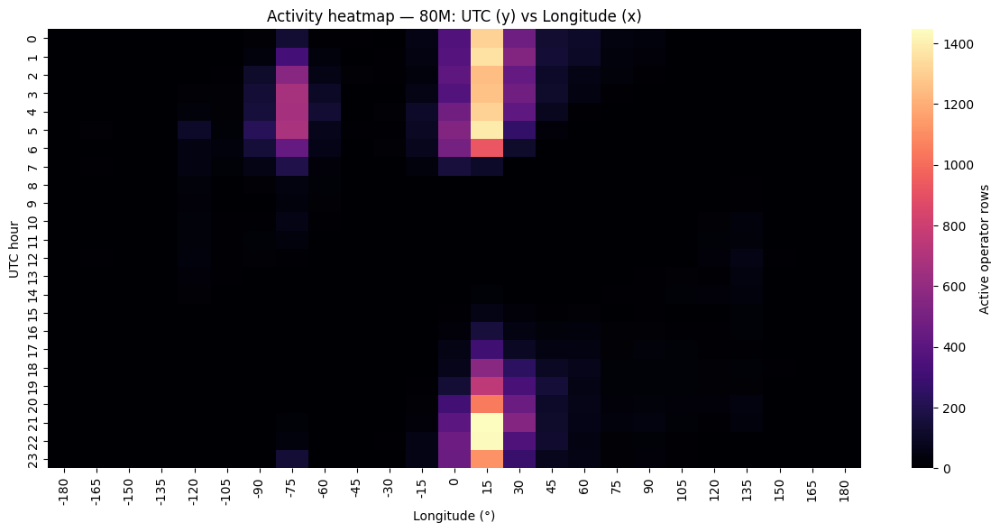

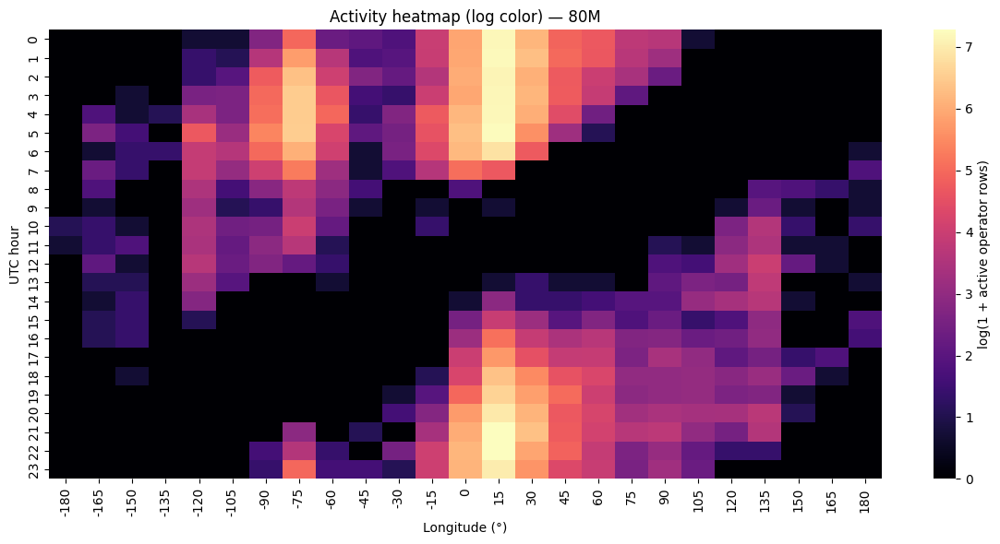

In [147]:
# --- helper: Maidenhead -> longitude (deg) using your mh package ---


# --- helper: build the stacked (TX+RX) table for ONE band ---
def build_utc_lon_points_for_band(qso_band_df):
    utc_grid_df = qso_band_df[['slice','sent_call','rcvd_call','GRID-LOCATOR','GRID-LOCATOR_RX']]

    sent_utc = utc_grid_df[['slice','sent_call','GRID-LOCATOR']].copy()
    sent_utc['call_type'] = 'sent_call'
    rcvd_utc = utc_grid_df[['slice','rcvd_call','GRID-LOCATOR_RX']].copy()
    rcvd_utc['call_type'] = 'rcvd_call'
    sent_utc.rename(columns={'sent_call':'call','GRID-LOCATOR':'grid'}, inplace=True)
    rcvd_utc.rename(columns={'rcvd_call':'call','GRID-LOCATOR_RX':'grid'}, inplace=True)

    merged = pd.concat([sent_utc, rcvd_utc], ignore_index=True)

    # time info
    merged['slice'] = pd.to_datetime(merged['slice'], utc=True, errors='coerce')
    merged['utc_hour'] = (
        merged['slice'].dt.hour
        + merged['slice'].dt.minute/60
        + merged['slice'].dt.second/3600
    )

    # longitude from Maidenhead
    merged = merged.dropna(subset=['grid'])
    merged['longitude'] = merged['grid'].apply(maidenhead_grid_to_longitude)

    # keep only rows with both utc_hour and longitude
    points = merged.dropna(subset=['utc_hour','longitude']).copy()
    # normalize ranges
    points['utc_hour'] = points['utc_hour'] % 24.0
    points['longitude'] = ((points['longitude'] + 180.0) % 360.0) - 180.0
    return points

# --- helper: build contingency matrix (UTC x Longitude) with nice labels ---
def make_heat_matrix(points, lon_step_deg=15, utc_step_hr=1):
    # longitude bins centered on multiples of lon_step (…,-180,-165,…,0,15,…,180)
    half = lon_step_deg/2.0
    lon_edges = np.arange(-180-half, 180+half+1e-9, lon_step_deg)
    t_edges   = np.arange(0, 24+utc_step_hr, utc_step_hr)

    lon_cuts = pd.cut(points['longitude'], bins=lon_edges, right=False, include_lowest=True)
    utc_cuts = pd.cut(points['utc_hour'],   bins=t_edges,  right=False, include_lowest=True)

    heat = points.groupby([utc_cuts, lon_cuts]).size().unstack(fill_value=0)

    # ensure full grid present in case some bins are empty
    lon_idx = pd.IntervalIndex.from_breaks(lon_edges, closed='left')
    utc_idx = pd.IntervalIndex.from_breaks(t_edges,  closed='left')
    heat = heat.reindex(index=utc_idx, columns=lon_idx, fill_value=0)

    # relabel axes: y = 0..23, x = centers (multiples of 15)
    heat.index = [int(iv.left) for iv in heat.index]
    heat.columns = [int(round((iv.left + iv.right)/2.0)) for iv in heat.columns]
    return heat

# ---- loop over bands and plot ----
bands_list = qso_sampled['band'].dropna().unique()

for band_name in bands_list:
    # filter this band
    qso_band_df = qso_sampled[qso_sampled['band'] == band_name]

    # build points table (utc_hour, longitude)
    band_points = build_utc_lon_points_for_band(qso_band_df)

    # contingency matrix (UTC hour x longitude center)
    heat_mat = make_heat_matrix(band_points, lon_step_deg=15, utc_step_hr=1)

    # linear scale heatmap
    plt.figure(figsize=(12, 6))
    ax1 = sns.heatmap(heat_mat, cmap='magma', cbar_kws={'label':'Active operator rows'})
    ax1.set_xlabel('Longitude (°)')
    ax1.set_ylabel('UTC hour')
    #ax1.set_yticks(range(0, 24, 2))
    ax1.set_title(f'Activity heatmap — {band_name}: UTC (y) vs Longitude (x)')
    plt.tight_layout()
    plt.show()

    # log color heatmap (helps with dynamic range)
    plt.figure(figsize=(12, 6))
    ax2 = sns.heatmap(np.log1p(heat_mat), cmap='magma',
                      cbar_kws={'label':'log(1 + active operator rows)'})
    ax2.set_xlabel('Longitude (°)')
    ax2.set_ylabel('UTC hour')
    #ax2.set_yticks(range(0, 24, 2))
    ax2.set_title(f'Activity heatmap (log color) — {band_name}')
    plt.tight_layout()
    plt.show()


In [148]:
print(qso_sampled.columns)

Index(['sent_call', 'rcvd_call', 'pairs', 'band', 'slice', 'Y', 'CALLSIGN',
       'CATEGORY-POWER', 'CATEGORY-OPERATOR', 'CATEGORY-ASSISTED',
       'CATEGORY-TRANSMITTER', 'GRID-LOCATOR', 'LOG_QSO_COUNT', 'CALLSIGN_RX',
       'CATEGORY-POWER_RX', 'CATEGORY-OPERATOR_RX', 'CATEGORY-ASSISTED_RX',
       'CATEGORY-TRANSMITTER_RX', 'GRID-LOCATOR_RX', 'LOG_QSO_COUNT_RX',
       'distance', 'midpoint_solar_time', 'solar_hour'],
      dtype='object')


In [149]:
def maidenhead_to_lat_lon(grid):
    """Convert Maidenhead grid locator to latitude and longitude using the mh package."""
    coords = mh.to_location(grid)
    return coords[0], coords[1]  # (latitude, longitude)

# creating new dataframes from qso_sampled on the basis of band

band_dfs = {band: qso_sampled[['sent_call', 'rcvd_call', 'band', 'GRID-LOCATOR', 'GRID-LOCATOR_RX', 'LOG_QSO_COUNT', 'LOG_QSO_COUNT_RX']][qso_sampled['band'] == band].copy() for band in bands_list}

# spliting sent_call/grid and rcvd_Call/grid into two seperate df and then concating into same table and adding lat/lon

for band in bands_list:
    _df = band_dfs[band]
    sent_call_grid = _df[['band','sent_call', 'GRID-LOCATOR', 'LOG_QSO_COUNT']].rename(columns={'sent_call': 'call', 'GRID-LOCATOR': 'grid', 'LOG_QSO_COUNT': 'log_qso_count'})
    rcvd_call_grid = _df[['band','rcvd_call', 'GRID-LOCATOR_RX', 'LOG_QSO_COUNT_RX']].rename(columns={'rcvd_call': 'call', 'GRID-LOCATOR_RX': 'grid', 'LOG_QSO_COUNT_RX': 'log_qso_count'})
    combined = pd.concat([sent_call_grid, rcvd_call_grid], ignore_index=True)
    combined = combined.dropna(subset=['grid']).drop_duplicates().reset_index(drop=True)
    combined['latitude'], combined['longitude'] = zip(*combined['grid'].apply(maidenhead_to_lat_lon))
    band_dfs[band] = combined

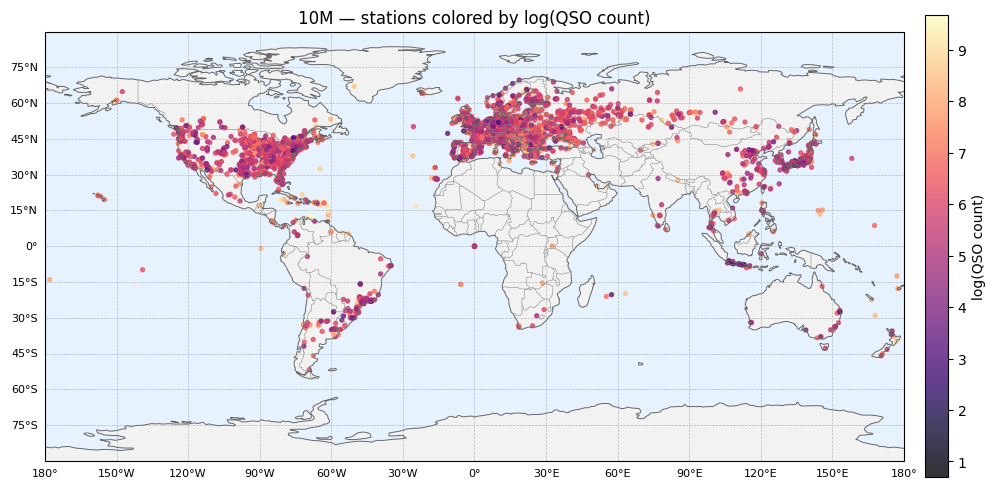

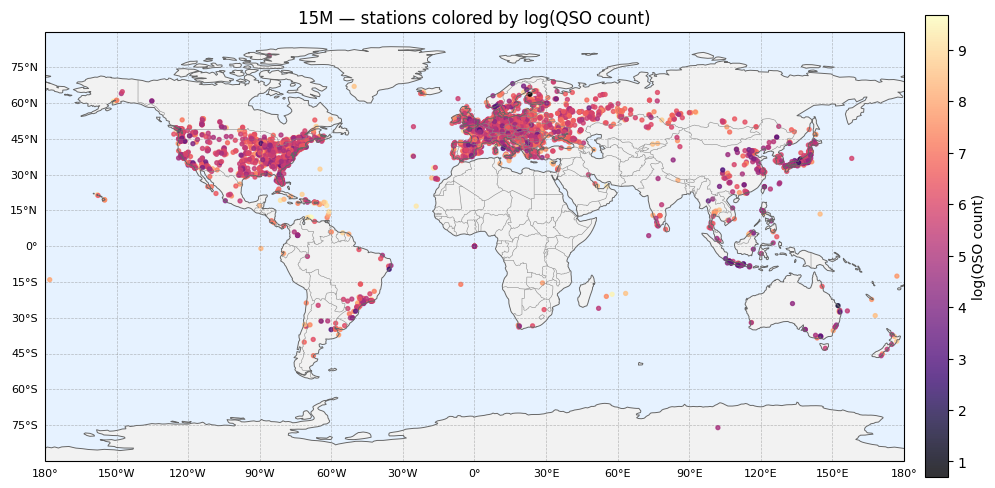

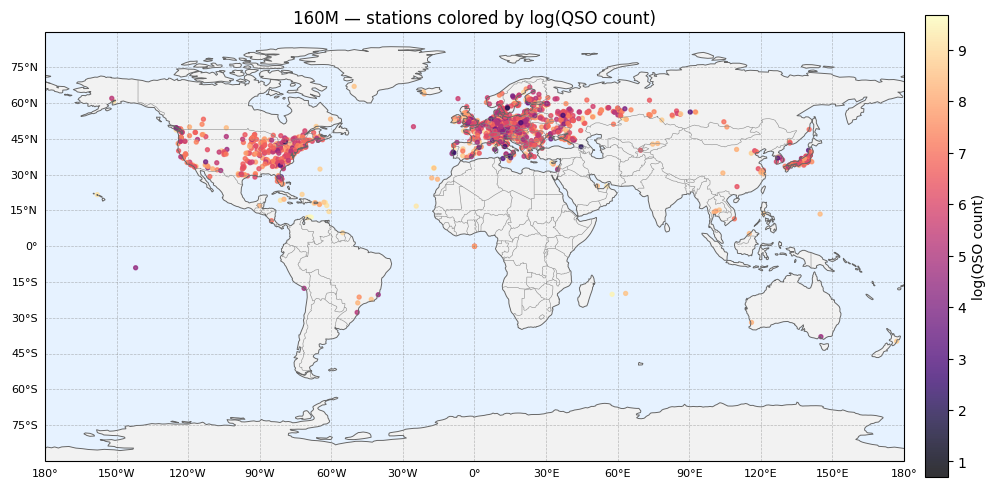

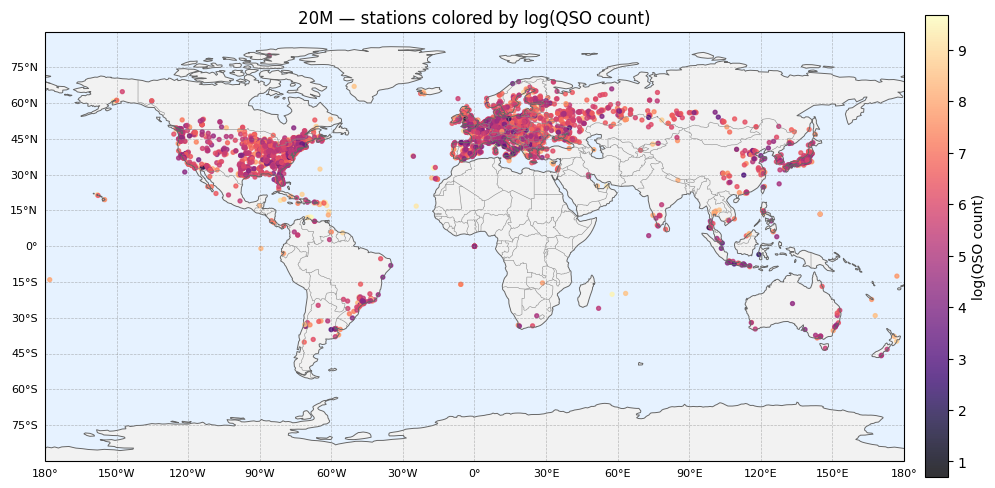

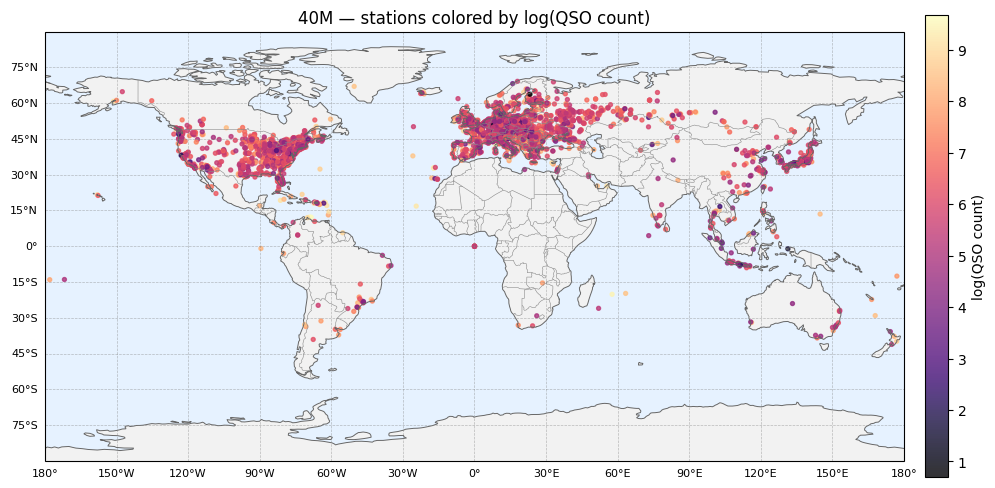

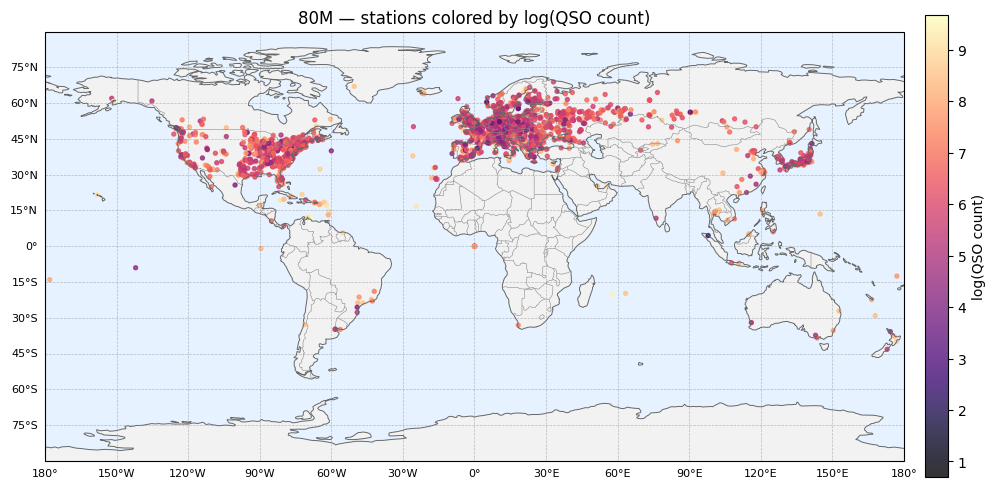

In [151]:
def wrap_lon(series):
    return ((series + 180.0) % 360.0) - 180.0

# ---- OPTIONAL: fix a global color scale across all bands ----
all_logs_list = []
for band_name, band_table in band_dfs.items():
    if 'log_qso_count' in band_table.columns:
        all_logs_list.append(pd.to_numeric(band_table['log_qso_count'], errors='coerce'))
global_vmin = pd.concat(all_logs_list).min()
global_vmax = pd.concat(all_logs_list).max()

for band_name, band_table in band_dfs.items():
    # keep valid rows, wrap longitudes
    pts = band_table.dropna(subset=['latitude','longitude','log_qso_count']).copy()
    if pts.empty:
        continue
    pts['longitude'] = wrap_lon(pts['longitude'])
    pts['log_qso_count'] = pd.to_numeric(pts['log_qso_count'], errors='coerce')
    pts = pts.dropna(subset=['log_qso_count'])

    fig = plt.figure(figsize=(11, 5))
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.set_global()

    # base map
    ax.add_feature(cfeature.LAND, facecolor="#f2f2f2")
    ax.add_feature(cfeature.OCEAN, facecolor="#e6f2ff")
    ax.coastlines(linewidth=0.7, color="#666")
    ax.add_feature(cfeature.BORDERS, linewidth=0.4, edgecolor="#888")

    # graticules with labels
    gl = ax.gridlines(
        draw_labels=True,
        xlocs=np.arange(-180, 181, 30),
        ylocs=np.arange(-90,   91, 15),
        linewidth=0.5, color='gray', alpha=0.5, linestyle='--'
    )
    gl.top_labels = False
    gl.right_labels = False
    gl.xformatter = LongitudeFormatter(number_format='.0f', degree_symbol='°')
    gl.yformatter = LatitudeFormatter(number_format='.0f', degree_symbol='°')
    gl.xlabel_style = {'size': 8}
    gl.ylabel_style = {'size': 8}

    # ---- scatter colored by log_qso_count ----
    sc = ax.scatter(
        pts['longitude'].to_numpy(),
        pts['latitude'].to_numpy(),
        s=8, alpha=0.8,
        c=pts['log_qso_count'].to_numpy(),
        cmap='magma',                # or 'viridis]', 'plasma'
        vmin=global_vmin, vmax=global_vmax,   # comment out to autoscale per band
        transform=ccrs.PlateCarree()
    )
    cbar = plt.colorbar(sc, ax=ax, orientation='vertical', pad=0.02)
    cbar.set_label('log(QSO count)')

    ax.set_title(f'{band_name} — stations colored by log(QSO count)')
    plt.tight_layout()
    plt.show()

### New approach

#### Activity ticks Time

#### new del tau

In [160]:
def grid_to_lon_safe(val):
    """
    Safe lon extractor from a Maidenhead locator.
    Returns np.nan if missing/invalid.
    """
    if pd.isna(val):
        return np.nan
    try:
        s = str(val).strip().upper()
        lat, lon = mh.to_location(s)   # (lat, lon) in degrees
        return float(lon)
    except Exception:
        return np.nan

def wrap_to(x, a=-12.0, b=12.0):
    """Wrap numbers into [a,b) (default hours [-12,12))."""
    w = b - a
    return (x - a) % w + a

# 1) Endpoint longitudes (deg East)
qso_sampled['lon_1'] = qso_sampled['GRID-LOCATOR'].map(grid_to_lon_safe)
qso_sampled['lon_2'] = qso_sampled['GRID-LOCATOR_RX'].map(grid_to_lon_safe)

# 2) Δτ in hours, wrapped to [-12,12)
qso_sampled['delta_tau'] = wrap_to((qso_sampled['lon_2'] - qso_sampled['lon_1']) / 15.0)

# Quick sanity: how many invalid/missing?
print("Missing lon_1:", qso_sampled['lon_1'].isna().mean(), 
      "| Missing lon_2:", qso_sampled['lon_2'].isna().mean())

tau_mid_hours = (
    qso_sampled['midpoint_solar_time'].dt.hour
    + qso_sampled['midpoint_solar_time'].dt.minute/60
    + qso_sampled['midpoint_solar_time'].dt.second/3600
).astype(float)

qso_sampled['tau1_hours'] = (tau_mid_hours - 0.5*qso_sampled['delta_tau']) % 24.0
qso_sampled['tau2_hours'] = (tau_mid_hours + 0.5*qso_sampled['delta_tau']) % 24.0

# Peek
print(qso_sampled[['GRID-LOCATOR','GRID-LOCATOR_RX','lon_1','lon_2','delta_tau']].head())

Missing lon_1: 0.090775 | Missing lon_2: 0.08235
  GRID-LOCATOR GRID-LOCATOR_RX       lon_1      lon_2  delta_tau
0       QM06HN          FN10BS  140.583333 -77.916667   9.433333
1       JN64GB          KM65FA   12.500000  32.416667   1.327778
2       KN44HE          IH74DA   28.583333  -5.750000  -2.288889
3       IN87LU             NaN   -3.083333        NaN        NaN
4          NaN          IO92VA         NaN  -0.250000        NaN


In [165]:
def dtau_bin(dt):
    a = abs(dt)
    if a < 2:   return '|Δτ|<2h'
    if a < 6:   return '2–6h'
    else:       return '6–12h'

qso_sampled['delta_bin'] = qso_sampled['delta_tau'].apply(dtau_bin)

# shares per band to check coverage
share = (qso_sampled.dropna(subset=['delta_bin','band'])
         .groupby(['band','delta_bin']).size()
         .groupby(level=0).apply(lambda s: (s/s.sum()).round(3)))
print("\nShare of QSOs by |Δτ| bin per band:")
print(share.unstack(fill_value=0.0))



Share of QSOs by |Δτ| bin per band:
delta_bin   2–6h  6–12h  |Δτ|<2h
band band                       
10M  10M   0.302  0.514    0.184
15M  15M   0.267  0.502    0.231
160M 160M  0.130  0.206    0.665
20M  20M   0.249  0.454    0.297
40M  40M   0.249  0.438    0.313
80M  80M   0.191  0.253    0.556


In [179]:
def kde2d_epan_reflect(time, dist, grid_t, grid_d, h_t, h_d, a_t=0.0, b_t=24.0, a_d=0.0, b_d=max(grid_d)):
    """
    2D KDE with Epanechnikov product kernel and reflection boundary correction
    on a rectangular domain [a_t, b_t] x [a_d, b_d].

    time, dist: 1D arrays of data
    grid_t, grid_d: 1D grids for evaluation
    h_t, h_d: bandwidths
    a_t,b_t: time domain bounds (default [0,24])
    a_d,b_d: distance domain bounds (default [0, max(grid_d)])
    """
    # epanechnikov kernel (1D)
    def epan(u):
        out = np.zeros_like(u, dtype=float)
        m = (np.abs(u) <= 1.0)
        out[m] = 0.75 * (1.0 - u[m]**2)
        return out

    if b_d is None:
        b_d = float(np.max(grid_d))

    n = len(time)
    T, D = np.meshgrid(grid_t, grid_d)  # shape: (len(grid_d), len(grid_t))
    G = np.zeros_like(T, dtype=float)

    time = np.asarray(time, float)
    dist = np.asarray(dist, float)

    for ti, di in zip(time, dist):
        # reflections for this point in each dimension (lower and upper)
        t_refs = np.array([ti, -ti + 2*a_t, -ti + 2*b_t], dtype=float)
        d_refs = np.array([di, -di + 2*a_d, -di + 2*b_d], dtype=float)

        # all 3x3 combinations (Cartesian product)
        for tr in t_refs:
            Kt = epan((T - tr) / h_t) / h_t
            for dr in d_refs:
                Kd = epan((D - dr) / h_d) / h_d
                G += Kt * Kd

    # average over original sample size
    G /= n

    # optional: renormalize numerically over the grid (helps minor discretization drift)
    integral = np.trapezoid(np.trapezoid(G, grid_t, axis=1), grid_d, axis=0)
    if integral > 0:
        G /= integral

    return G


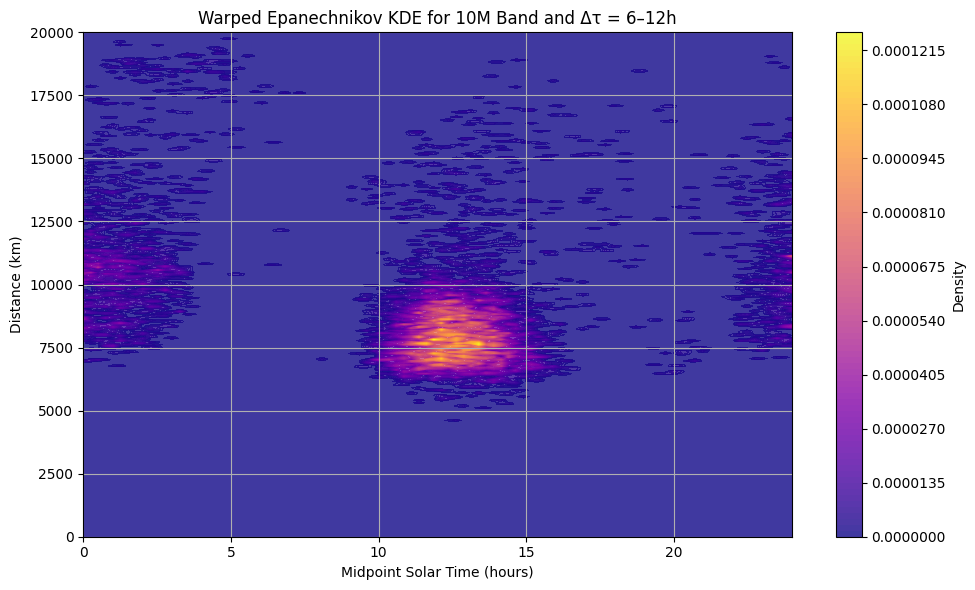

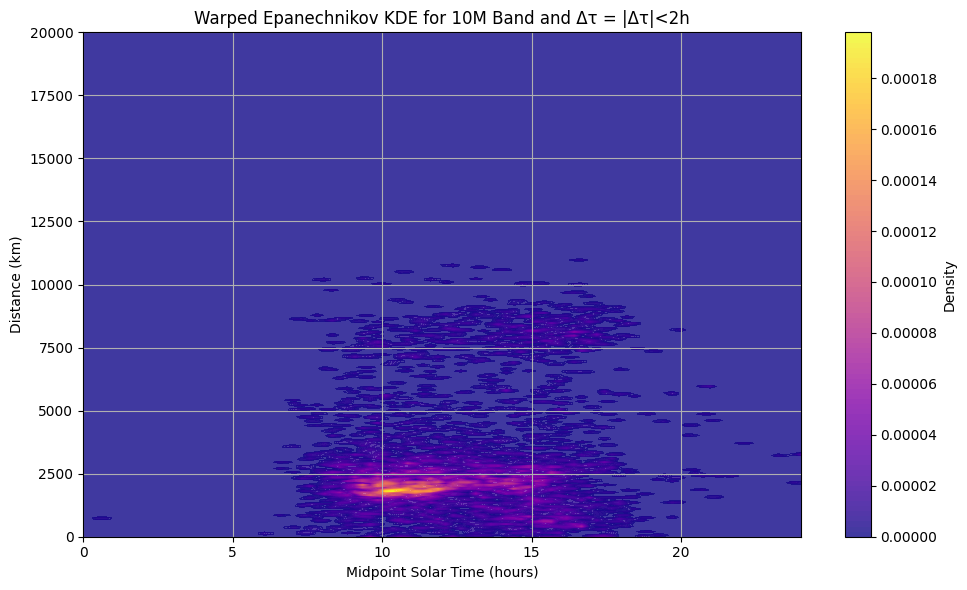

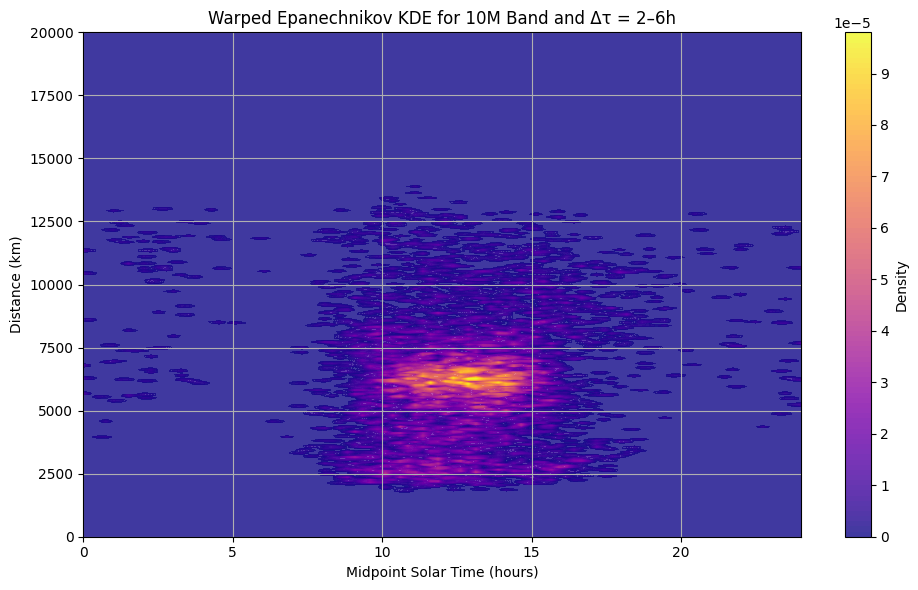

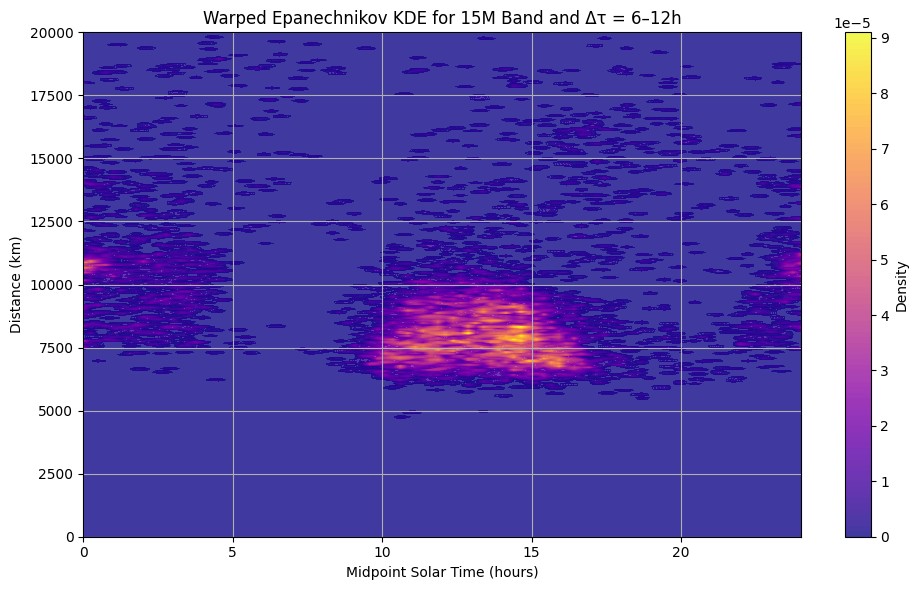

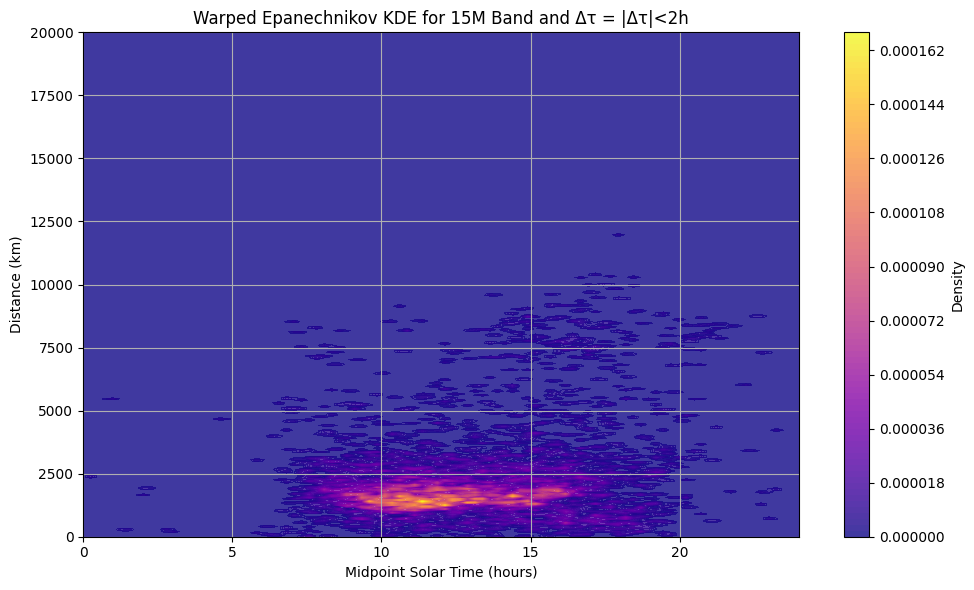

...

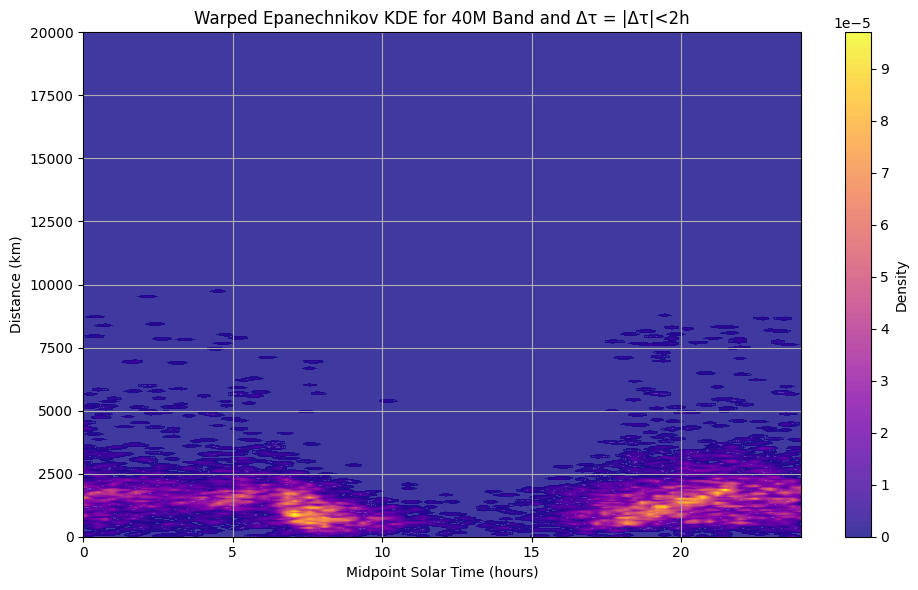

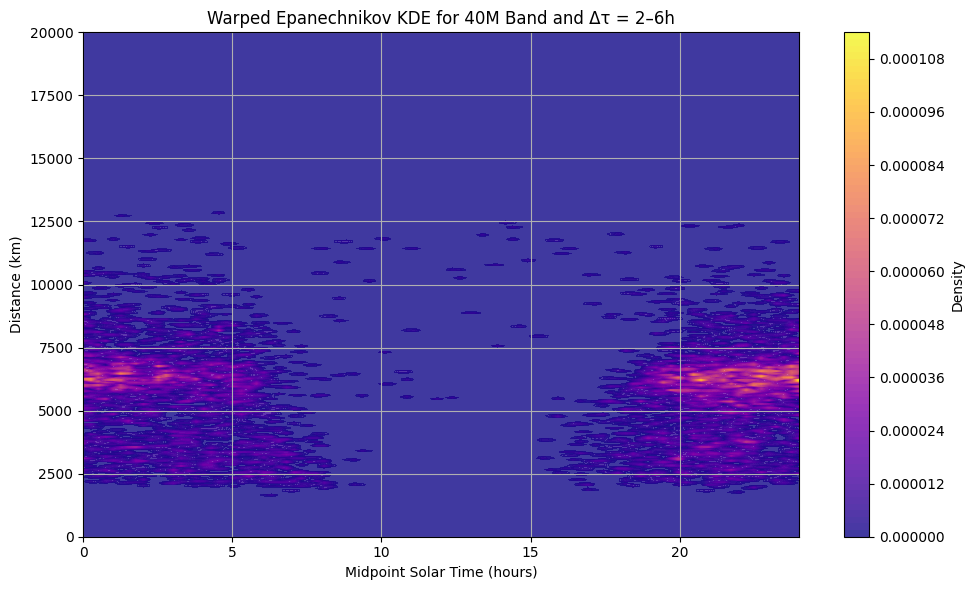

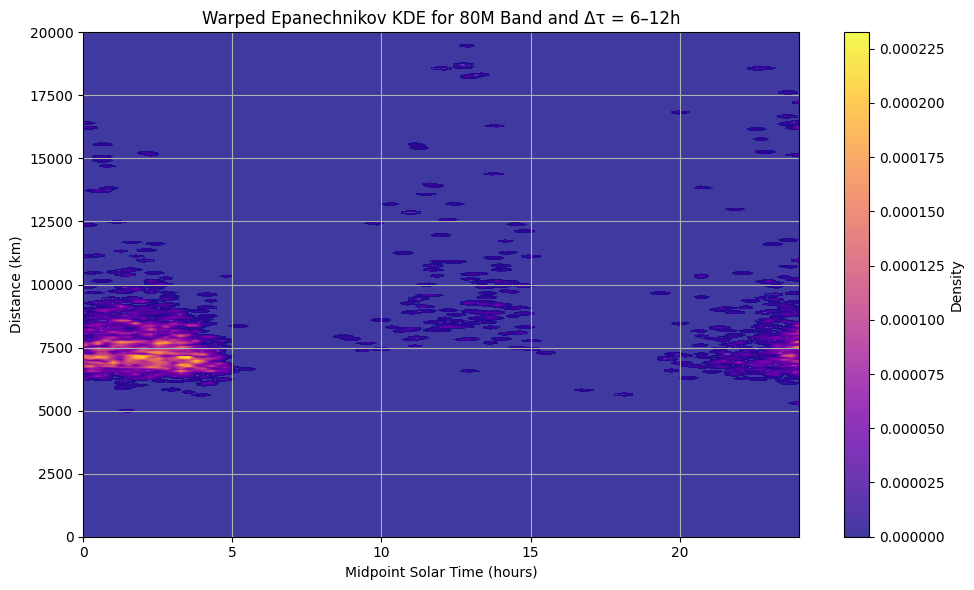

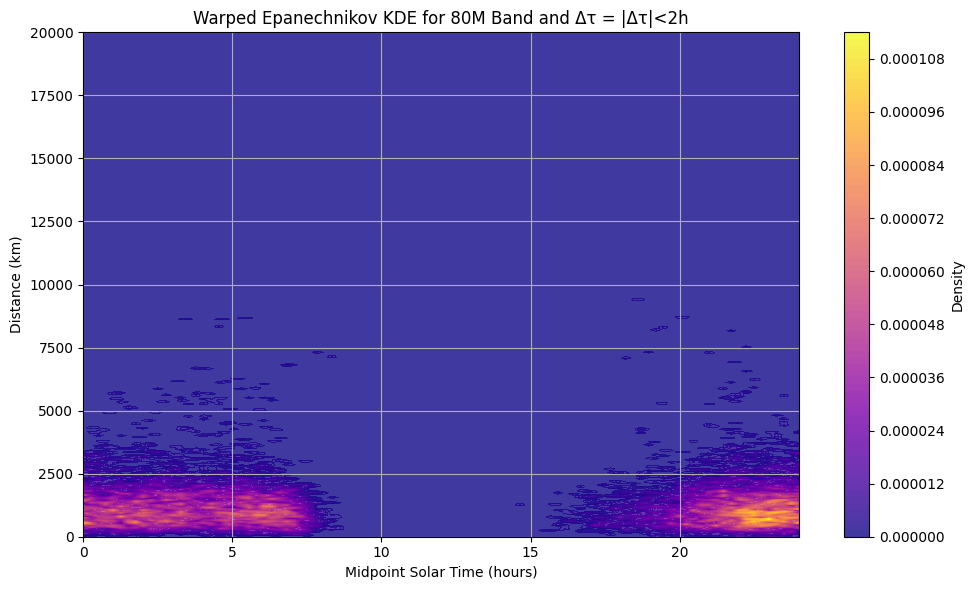

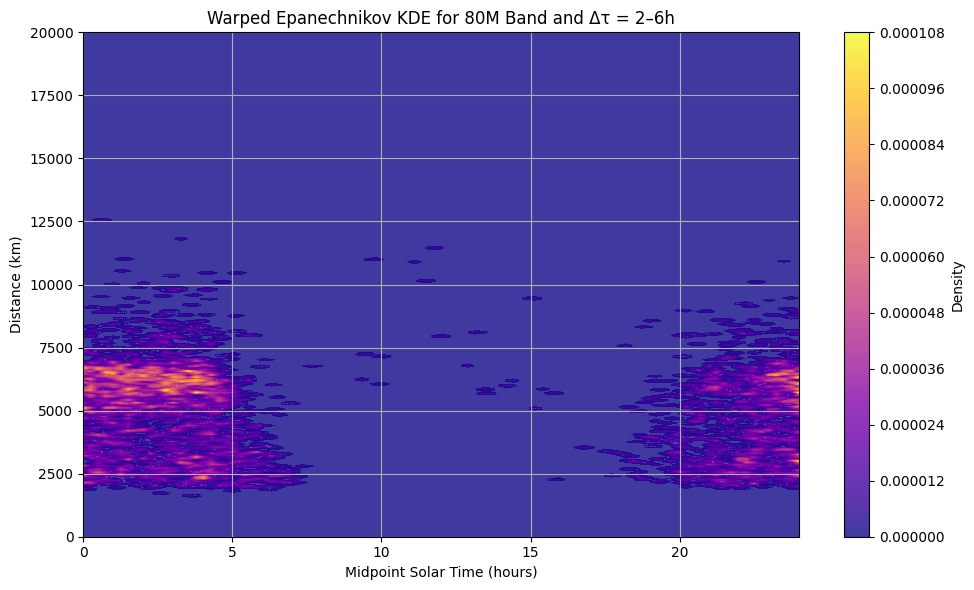

In [180]:
del_tau_bins = qso_sampled['delta_bin'].unique()
# print(del_tau_bins)
bands = qso_sampled['band'].unique()
# bands = ['10M', '20M', '15M', '40M', '80M', '160M']

# cache for kde (band, del_tau)
band_kde_alt = {}

for band in bands:
    for del_tau in del_tau_bins:
        # Filter the DataFrame for the current band and delta_bin
        df_filtered = qso_sampled[(qso_sampled['band'] == band) & (qso_sampled['delta_bin'] == del_tau)]

        time_vec = df_filtered['solar_hour'].to_numpy()
        dist_vec = df_filtered['distance'].to_numpy()

        grid_t = np.linspace(0, 24, 96)  # 24 hours
        grid_d = np.linspace(0, 20000, 400)  # Distance in km

        h_t = 0.25  # Bandwidth for time (15mins)
        h_d = 50  # Bandwidth for distance (50km)

        density = kde2d_epan_reflect(time_vec, dist_vec, grid_t, grid_d, h_t, h_d)
        band_kde_alt[(band, del_tau)] = density

        T, D = np.meshgrid(grid_t, grid_d)
        plt.figure(figsize=(10, 6))
        # use a perceptually-uniform colormap (change 'magma' to 'viridis', 'plasma', 'cividis', etc. if you prefer)
        pcm = plt.contourf(T, D, density, levels=100, cmap='plasma', alpha=0.8)
        plt.xlabel('Midpoint Solar Time (hours)')
        plt.ylabel('Distance (km)')
        plt.title(f'Warped Epanechnikov KDE for {band} Band and Δτ = {del_tau}')
        # plt.title(f'reflective KDE for {band} Band and Δτ = {del_tau}')
        plt.colorbar(pcm, label='Density')
        plt.grid(True)
        plt.tight_layout()
        plt.show()


In [181]:
print(band_kde_alt.keys())

dict_keys([('10M', '6–12h'), ('10M', '|Δτ|<2h'), ('10M', '2–6h'), ('15M', '6–12h'), ('15M', '|Δτ|<2h'), ('15M', '2–6h'), ('160M', '6–12h'), ('160M', '|Δτ|<2h'), ('160M', '2–6h'), ('20M', '6–12h'), ('20M', '|Δτ|<2h'), ('20M', '2–6h'), ('40M', '6–12h'), ('40M', '|Δτ|<2h'), ('40M', '2–6h'), ('80M', '6–12h'), ('80M', '|Δτ|<2h'), ('80M', '2–6h')])


In [182]:
qso_sampled['band'].unique()

array(['10M', '15M', '160M', '20M', '40M', '80M'], dtype=object)

#### 20M band

In [183]:
# Random sampling for 20M band to find a p_20m(d)

current_band = "20M"

current_band_20m_data = qso_sampled[qso_sampled['band'] == current_band]

calls_id_20m = current_band_20m_data['CALLSIGN'].unique().tolist() + current_band_20m_data['CALLSIGN_RX'].unique().tolist()
calls_id_20m = list(set(calls_id_20m))  # unique callsigns

all_p_pairs = list(combinations(calls_id_20m, 2))

sample_size_p = min(100000, len(all_p_pairs))

sample_pairs_p = np.random.choice(len(all_p_pairs), sample_size_p, replace=False)
sample_pairs_p = [all_p_pairs[i] for i in sample_pairs_p]



In [184]:
print(h.columns)

Index(['CALLSIGN', 'CATEGORY-POWER', 'CATEGORY-OPERATOR', 'CATEGORY-ASSISTED',
       'CATEGORY-TRANSMITTER', 'GRID-LOCATOR', 'LOG_QSO_COUNT'],
      dtype='object')


In [185]:
df_p = pd.DataFrame(sample_pairs_p, columns=['CALLSIGN_1', 'CALLSIGN_2'])

h_p = h.copy()
h_p = h_p[['CALLSIGN', 'GRID-LOCATOR']]
h_p = h_p.set_index('CALLSIGN')

df_p['loc_1'] = df_p['CALLSIGN_1'].map(h_p['GRID-LOCATOR'])
df_p['loc_2'] = df_p['CALLSIGN_2'].map(h_p['GRID-LOCATOR'])

df_p['dist'] = df_p.apply(lambda row: safe_maidenhead_distance(row['loc_1'], row['loc_2']), axis=1)

Bandwidth 20M (Scott's Rule): 412.1503082560118
Bandwidth All Bands (Scott's Rule): 361.0520621321435


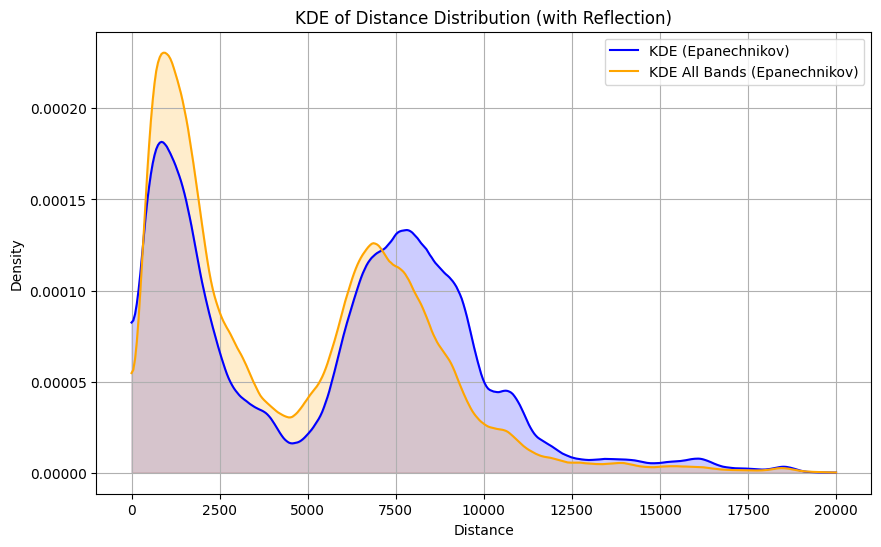

In [186]:
# calculate bandwidth using scott's rule
bandwidth = np.std(df_p['dist']) * (4/3)**(1/5) * len(df_p['dist'])**(-1/5)
print("Bandwidth 20M (Scott's Rule):", bandwidth)
bandwidth_all_band = np.std(qso_sampled['distance']) * (4/3)**(1/5) * len(qso_sampled['distance'])**(-1/5)
print("Bandwidth All Bands (Scott's Rule):", bandwidth_all_band)

#plot kde of distance distribution (with reflection 1D) - density on 20M
density_p = kde1d_epan_reflect(df_p['dist'], grid=grid_d, h=bandwidth)
#plot kde of distance distribution (with reflection 1D) - density on all bands
density_all_band = kde1d_epan_reflect(qso_sampled['distance'], grid=grid_d, h=bandwidth_all_band)

# plot kde
plt.figure(figsize=(10, 6))
plt.plot(grid_d, density_p, label='KDE (Epanechnikov)', color='blue')
plt.plot(grid_d, density_all_band, label='KDE All Bands (Epanechnikov)', color='orange')
plt.fill_between(grid_d, density_p, alpha=0.2, color='blue')
plt.fill_between(grid_d, density_all_band, alpha=0.2, color='orange')
plt.title('KDE of Distance Distribution (with Reflection)')
plt.xlabel('Distance')
plt.ylabel('Density')
plt.legend()
plt.grid()
plt.show()

In [187]:
# describe band_kde_alt, the keys and values
"""
band_kde_alt is a dictionary where:
- Keys are tuples (band, delta_bin) representing the frequency band and the time difference bin.
- Values are 2D numpy arrays representing the estimated probability density function (PDF) of distances for the given band and delta_bin.
"""

'\nband_kde_alt is a dictionary where:\n- Keys are tuples (band, delta_bin) representing the frequency band and the time difference bin.\n- Values are 2D numpy arrays representing the estimated probability density function (PDF) of distances for the given band and delta_bin.\n'

In [188]:
# Radon Nikodym Derivative theta_20M() = observed_kde(d, t_mid, tau_bin)|20M / density_p (d)

bins = qso_sampled['delta_bin'].unique()

theta_20M_ration = {}

for bin in bins:
    observed_kde = band_kde_alt.get((current_band, bin))

    # Safe division: avoid division by zero
    floor = 1e-3 * density_p.max()
    #floor = 1e-6
    density_safe = np.where(density_p < floor, floor, density_p)

    # Reshape density_safe to (400, 1) for broadcasting
    theta_20M = observed_kde / density_safe[:, None]

    theta_20M_ration[bin] = theta_20M


# Radon-Nikodym Derivative θ_b() = observed_kde(d, t_mid, tau_bin)|b / density_all_band (d)

theta_b = {}

for key in band_kde_alt.keys():
    current_band, bin = key
    observed_kde = band_kde_alt.get((current_band, bin))
    floor = 1e-3 * density_all_band.max()
    density_safe = np.where(density_all_band < floor, floor, density_all_band)
    theta_b[key] = observed_kde / density_safe[:, None]


In [189]:
# describe theta_b
"""
theta_b is a dictionary where:
- Keys are tuples (band, delta_bin) representing the frequency band and the time difference bin.
- Values are 2D numpy arrays representing the Radon-Nikodym derivative for the given band and delta_bin.
"""

'\ntheta_b is a dictionary where:\n- Keys are tuples (band, delta_bin) representing the frequency band and the time difference bin.\n- Values are 2D numpy arrays representing the Radon-Nikodym derivative for the given band and delta_bin.\n'

In [190]:
print(theta_b.keys())


dict_keys([('10M', '6–12h'), ('10M', '|Δτ|<2h'), ('10M', '2–6h'), ('15M', '6–12h'), ('15M', '|Δτ|<2h'), ('15M', '2–6h'), ('160M', '6–12h'), ('160M', '|Δτ|<2h'), ('160M', '2–6h'), ('20M', '6–12h'), ('20M', '|Δτ|<2h'), ('20M', '2–6h'), ('40M', '6–12h'), ('40M', '|Δτ|<2h'), ('40M', '2–6h'), ('80M', '6–12h'), ('80M', '|Δτ|<2h'), ('80M', '2–6h')])


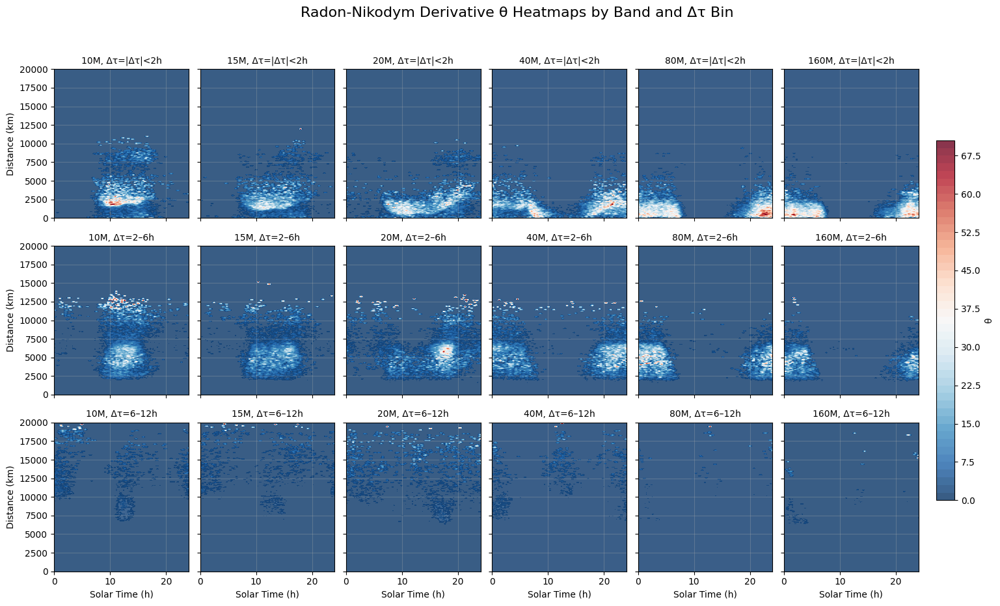

In [191]:
# Plot KDE (theta_b) heatmap on distance vs midpoint solar hour (for each delta_bin and each band)
bins_order = ['|Δτ|<2h','2–6h','6–12h']
bands_order = ['10M', '15M', '20M', '40M', '80M', '160M']

fig, axes = plt.subplots(len(bins_order), len(bands_order), figsize=(16, 9), sharex=True, sharey=True)
fig.suptitle('Radon-Nikodym Derivative θ Heatmaps by Band and Δτ Bin', fontsize=16, y=1.03)
for i, bins in enumerate(bins_order):
    for j, band in enumerate(bands_order):
        key = (band, bins)
        ax = axes[i, j]
        if key in theta_b:
            ratios = theta_b[key]
            T, D = np.meshgrid(grid_t, grid_d)
            pcm = ax.contourf(T, D, ratios, levels=50, cmap='RdBu_r', alpha=0.8)
        ax.set_title(f'{band}, Δτ={bins}', fontsize=10)
        if i == len(bins_order) - 1:
            ax.set_xlabel('Solar Time (h)')
        if j == 0:
            ax.set_ylabel('Distance (km)')
        ax.grid(True, alpha=0.3)
fig.tight_layout()
fig.subplots_adjust(right=0.92)
cbar = fig.colorbar(pcm, ax=axes, orientation='vertical', fraction=0.02, pad=0.02, label='θ')
plt.show()

# for bins in bins_order:
#     if bins not in theta_20M_ration:
#         continue
#     theta_20M = theta_20M_ration[bins]

#     T, D = np.meshgrid(grid_t, grid_d)
#     plt.figure(figsize=(10, 6))
#     pcm = plt.contourf(T, D, theta_20M, levels=100, cmap='plasma', alpha=0.8)

#     plt.xlabel('Midpoint Solar Time (hours)')
#     plt.ylabel('Distance (km)')
#     plt.title(f'Radon-Nikodym Derivative θ_20M for Δτ = {bins}')
#     plt.colorbar(pcm, label='θ_20M')
#     plt.grid(True)
#     plt.tight_layout()
#     plt.show()



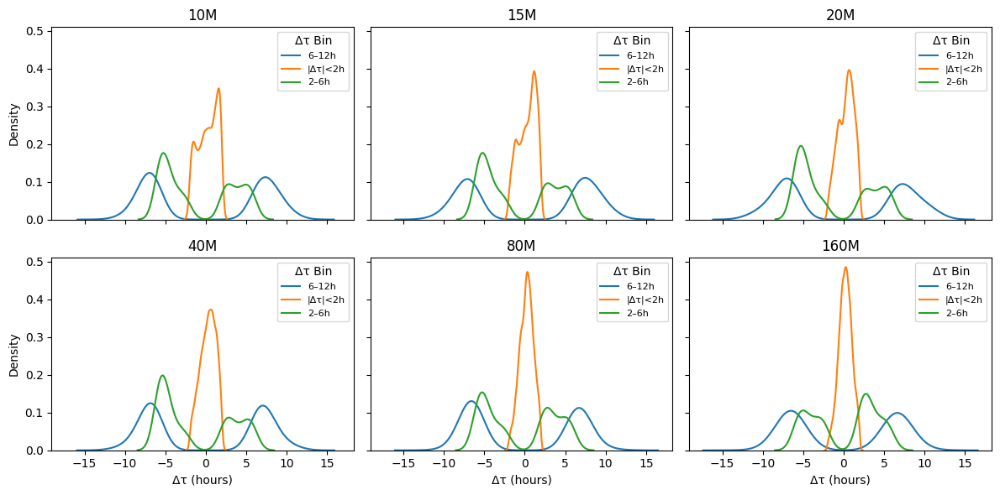

In [192]:
bands = ['10M', '15M', '20M', '40M', '80M', '160M']
bins = qso_sampled['delta_bin'].unique()

fig, axes = plt.subplots(2, 3, figsize=(12, 6), sharex=True, sharey=True)
axes = axes.flatten()

for idx, band in enumerate(bands):
    ax = axes[idx]
    for bin in bins:
        data = qso_sampled[(qso_sampled['delta_bin'] == bin) & (qso_sampled['band'] == band)]['delta_tau'].dropna()
        if len(data) > 0:
            sns.kdeplot(data, bw_adjust=1.0, label=str(bin), ax=ax)
    ax.set_title(f'{band}')
    ax.set_xlabel('Δτ (hours)')
    ax.set_ylabel('Density')
    ax.legend(title='Δτ Bin', fontsize=8)
plt.tight_layout()
plt.show()


#### continued

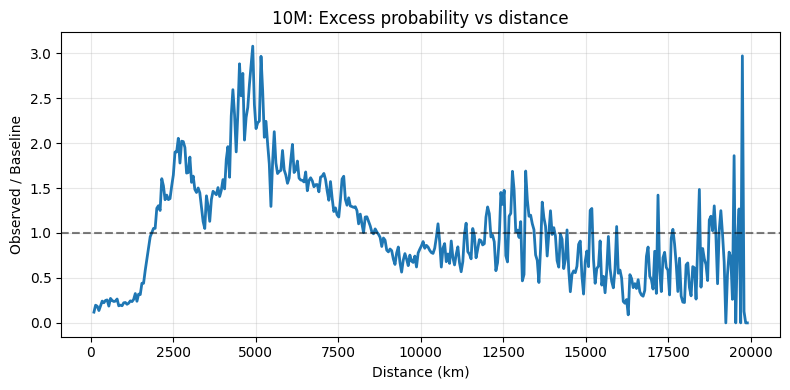

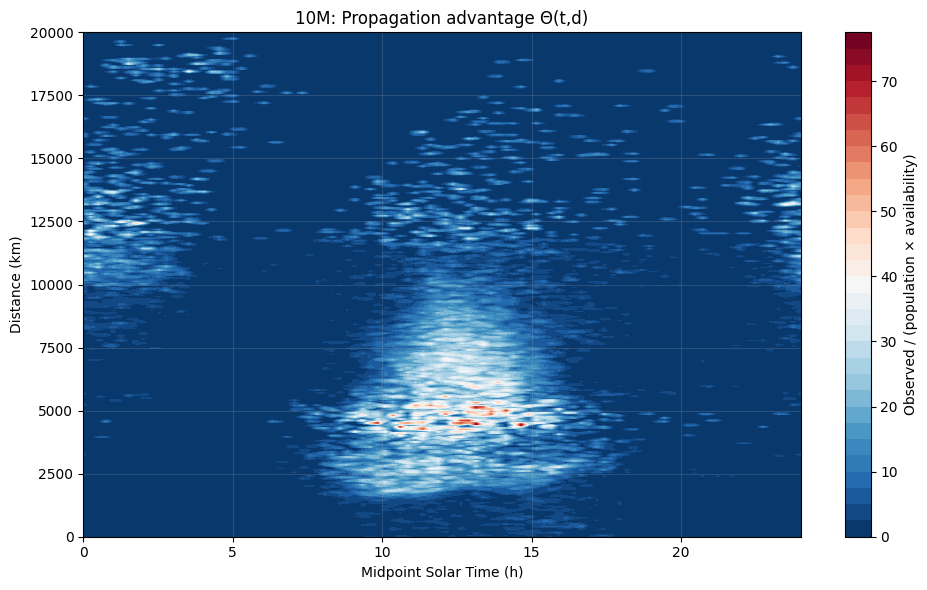

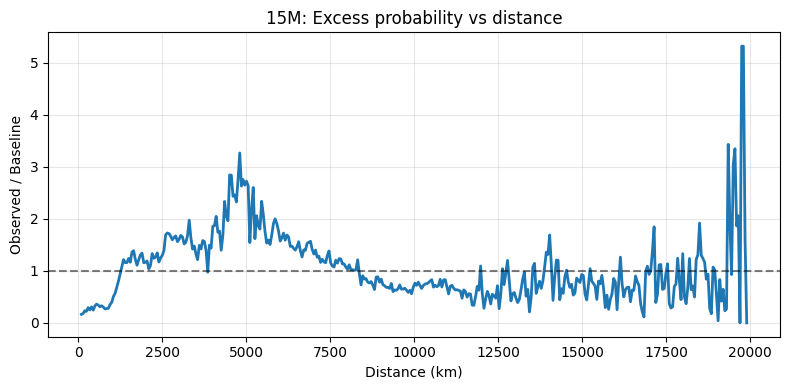

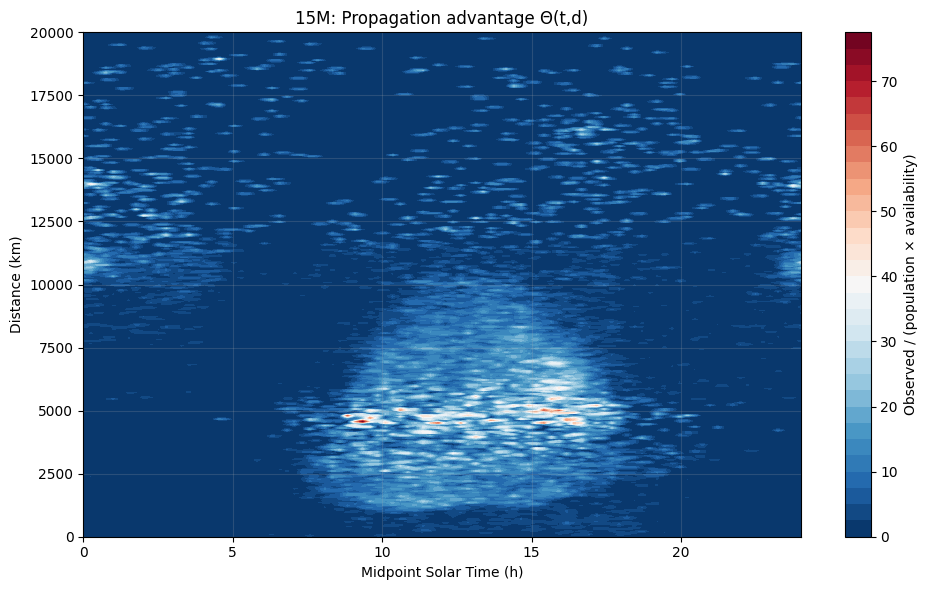

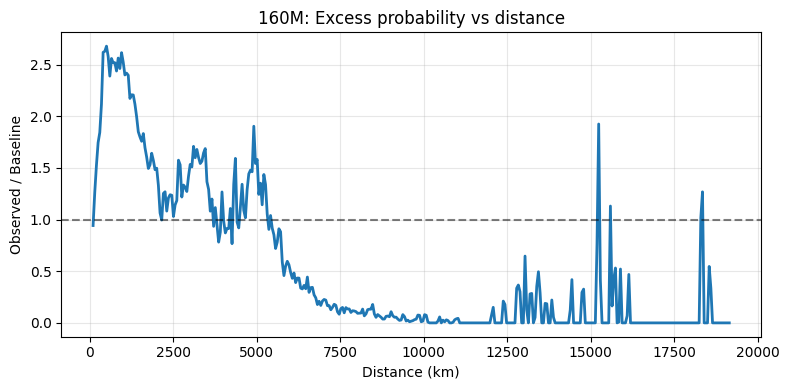

...

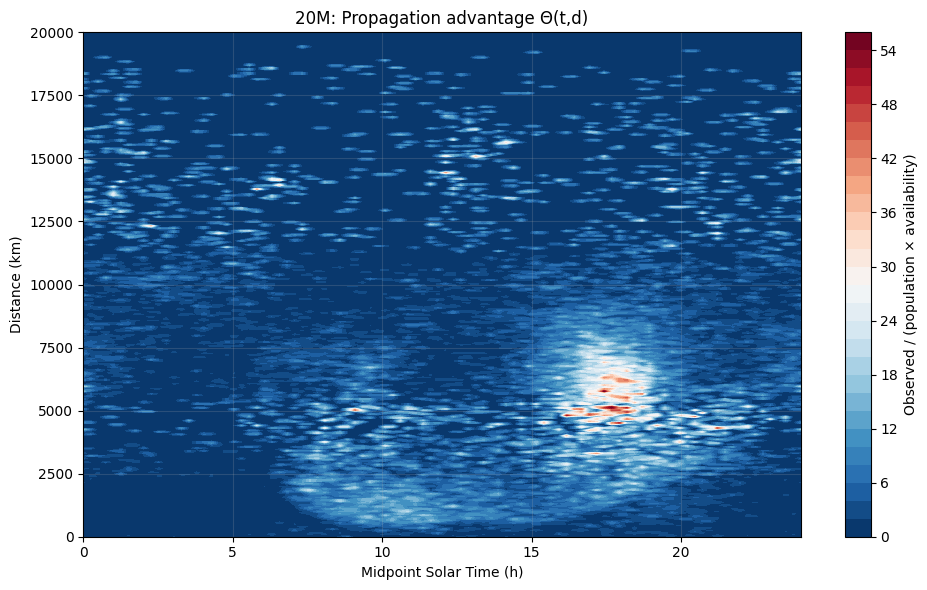

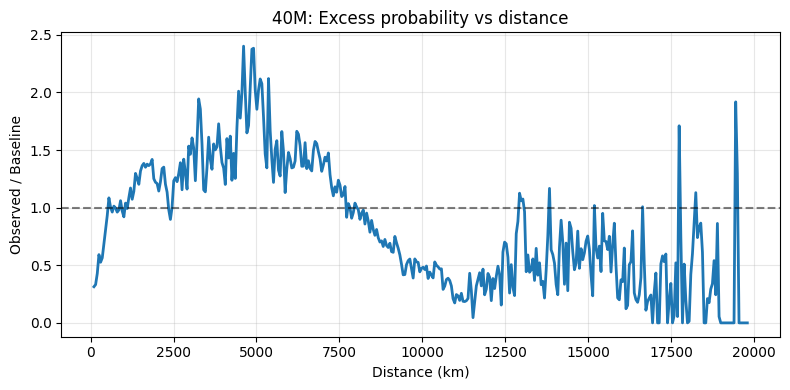

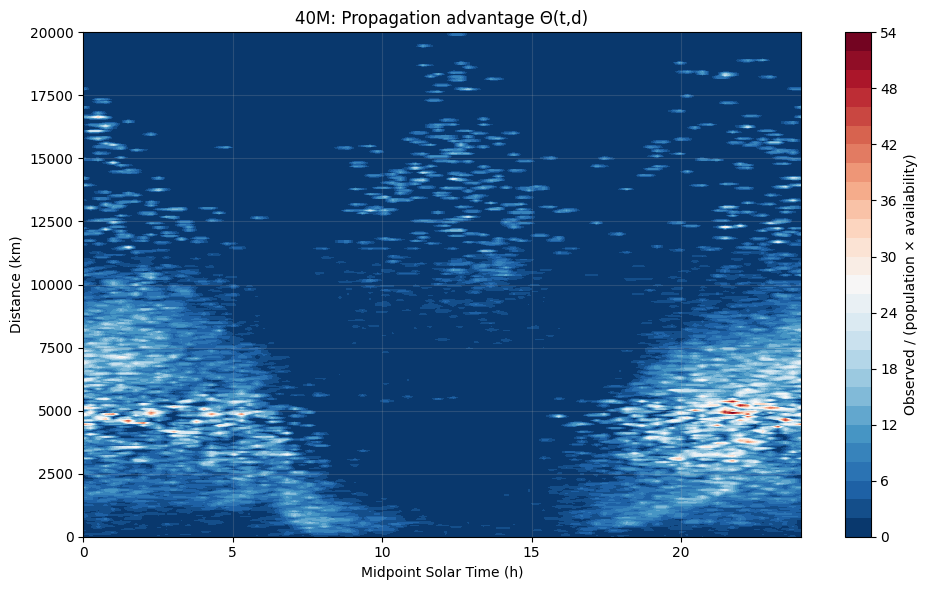

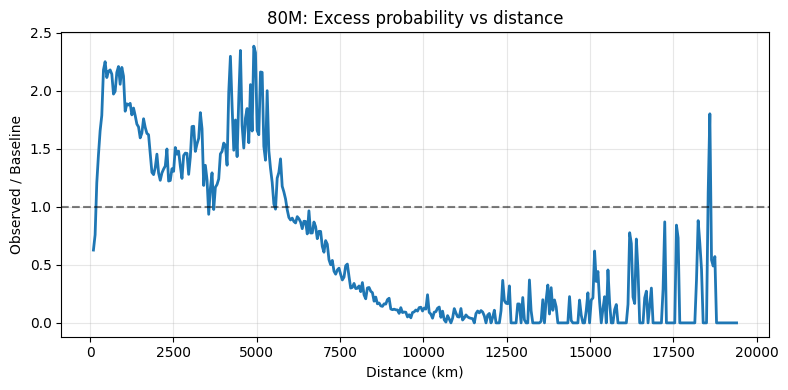

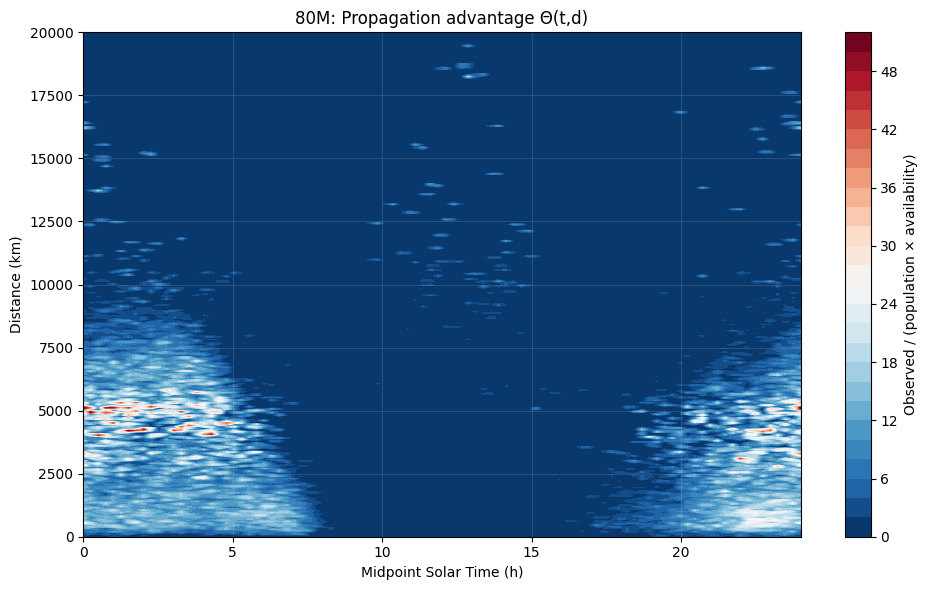

In [193]:
h_base = 500.0                      # wider bandwidth for baseline ρ(d)
floor_frac = 1e-3                   # denominator floor = 0.1% of max baseline

Nd, Nt = len(grid_d), len(grid_t)

def as_d_by_t(arr):
    if arr.shape == (Nd, Nt):      # already (distance, time)
        return arr
    if arr.shape == (Nt, Nd):      # currently (time, distance)
        return arr.T
    raise ValueError(f"Unexpected KDE shape {arr.shape}; expected {(Nd, Nt)} or {(Nt, Nd)}")

for band, density in band_kde.items():
    density = as_d_by_t(density)  # ensure shape is (distance, time)
    # 1) Get distance baseline ρ_b(d) from possible pairs on this band
    pos_b = pos[pos['band'] == band]
    canon = make_canonical_grid_map(pos_b)
    base_d = sample_pair_distances(canon, max_pairs=100_000, seed=0)
    rho_d  = kde1d_epan_reflect(base_d, grid_d, h=h_base, a=0.0, b=grid_d[-1])

    # 2) Observed p_b(d) from the 2D KDE (integrate over time)
    p_obs_d = density.sum(axis=1) * (grid_t[1]-grid_t[0])
    p_obs_d /= trapezoid(p_obs_d, grid_d)

    # 3) Stable distance-ratio R_b(d)
    floor = floor_frac * rho_d.max()
    good  = rho_d >= floor
    edge_trim = int(np.ceil(2 * h_d / (grid_d[1]-grid_d[0])))
    mask = np.zeros_like(good, dtype=bool)
    mask[edge_trim:len(good)-edge_trim] = True
    mask &= good

    R_d = np.full_like(rho_d, np.nan)
    R_d[mask] = p_obs_d[mask] / rho_d[mask]

    # Plot 1-D RN (distance marginal)
    plt.figure(figsize=(8,4))
    plt.plot(grid_d[mask], R_d[mask], lw=2)
    plt.axhline(1, color='k', ls='--', alpha=.5)
    plt.xlabel('Distance (km)'); plt.ylabel('Observed / Baseline')
    plt.title(f'{band}: Excess probability vs distance')
    plt.grid(True, alpha=.3); plt.tight_layout(); plt.show()

    # 4) Full RN: Θ_b(t,d) = λ_b(t,d) / (ρ_b(d) * π_b(t))
    #pi_t = availability_baseline(pos_b, grid_t)        # or uniform
    pi_t = uniform = np.ones_like(grid_t)/len(grid_t)  # uniform availability baseline
    
    baseline_2d = np.outer(rho_d, pi_t)                # shape (Nd, Nt)
    denom = np.maximum(baseline_2d, floor)
    Theta = density / denom

    # ---- Plot 2-D RN (time × distance)
    plt.figure(figsize=(10,6))
    levels = 30
    pcm = plt.contourf(grid_t, grid_d, Theta, levels=levels, cmap='RdBu_r')
    plt.colorbar(pcm, label='Observed / (population × availability)')
    plt.xlabel('Midpoint Solar Time (h)')
    plt.ylabel('Distance (km)')
    plt.title(f'{band}: Propagation advantage Θ(t,d)')  # full Radon–Nikodým view
    plt.grid(True, alpha=.2); plt.tight_layout(); plt.show()


#### Confounder Analysis

Note: you may need to restart the kernel to use updated packages.
Index(['sent_call', 'rcvd_call', 'pairs', 'band', 'slice', 'Y', 'CALLSIGN',
       'CATEGORY-POWER', 'CATEGORY-OPERATOR', 'CATEGORY-ASSISTED',
       'CATEGORY-TRANSMITTER', 'GRID-LOCATOR', 'LOG_QSO_COUNT', 'CALLSIGN_RX',
       'CATEGORY-POWER_RX', 'CATEGORY-OPERATOR_RX', 'CATEGORY-ASSISTED_RX',
       'CATEGORY-TRANSMITTER_RX', 'GRID-LOCATOR_RX', 'LOG_QSO_COUNT_RX',
       'distance', 'midpoint_solar_time'],
      dtype='object')


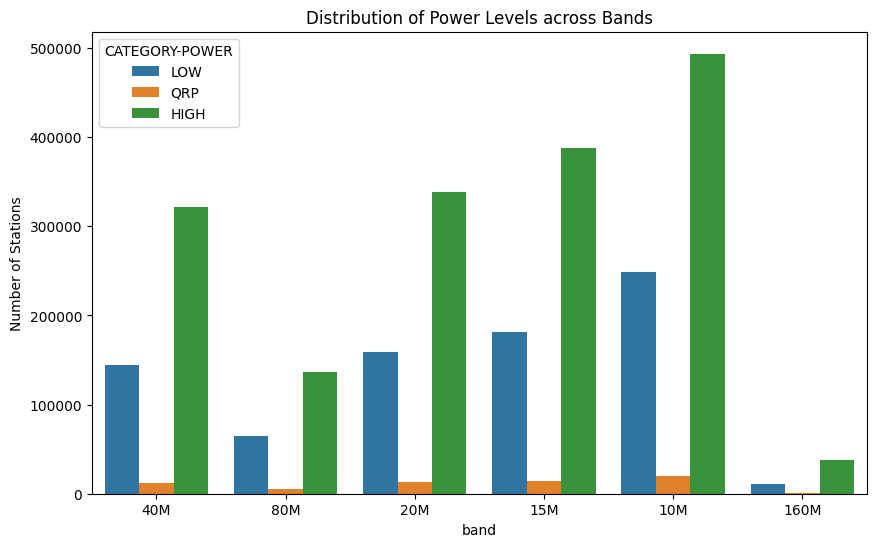

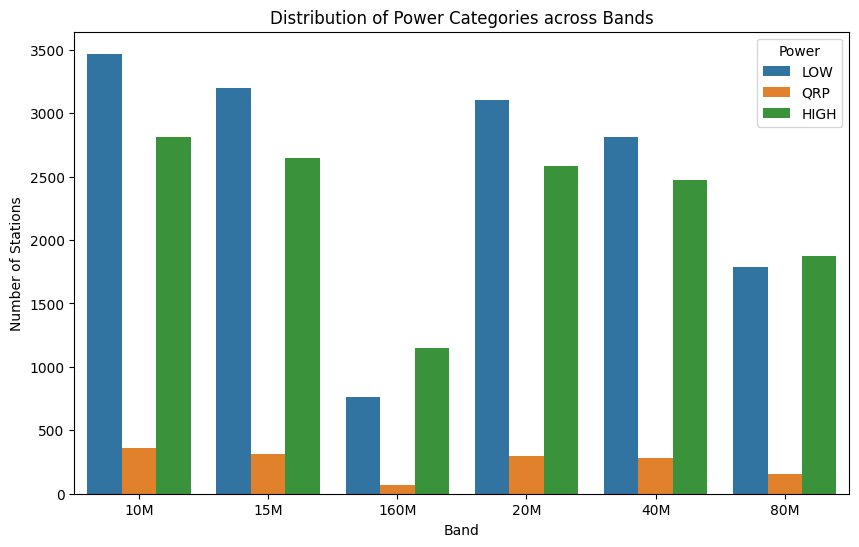

Chi-square: 204.40536956566194
Degrees of freedom: 10
p-value: 1.94418900419333e-38
Chi-square: 204.40536956566194
Degrees of freedom: 10
p-value: 1.94418900419333e-38
Reject the null hypothesis: There is a significant association between band and power category.

=== Confounder analysis: operator vs band ===
Chi-square = 159.1, dof = 5, p = 1.58e-32, Cram├⌐r's V = 0.073
ΓåÆ Significant association between band and operator


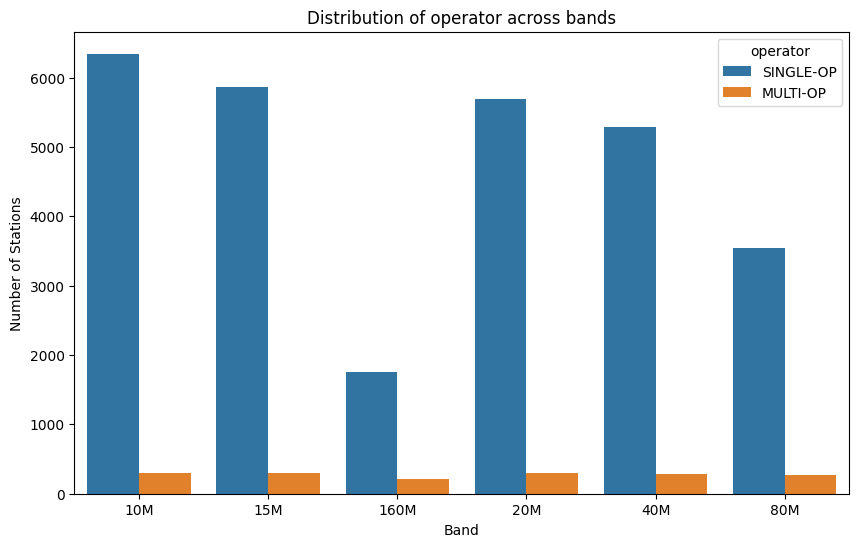


=== Confounder analysis: assisted vs band ===
Chi-square = 73.9, dof = 5, p = 1.58e-14, Cram├⌐r's V = 0.050
ΓåÆ Significant association between band and assisted


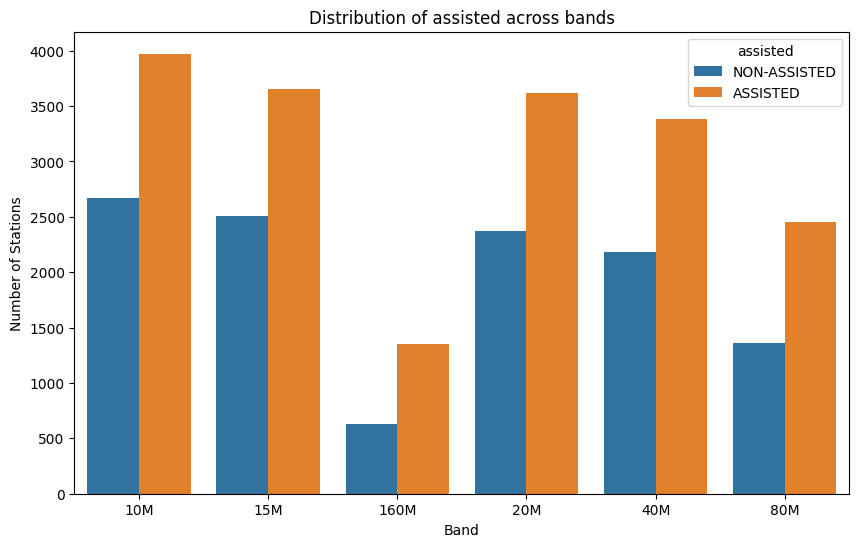


=== Confounder analysis: transmitter vs band ===
Chi-square = 73.7, dof = 10, p = 8.65e-12, Cram├⌐r's V = 0.035
ΓåÆ Significant association between band and transmitter


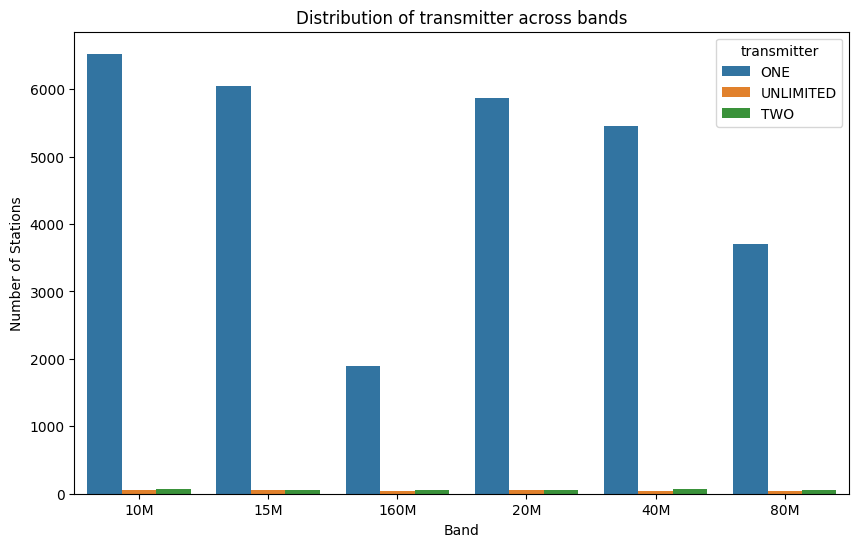

Power vs log_qso_count: H=3421.80, p=0
Power vs log_qso_count: H=3421.80, p=0
Assisted vs log_qso_count: H=1247.03, p=3.67e-273


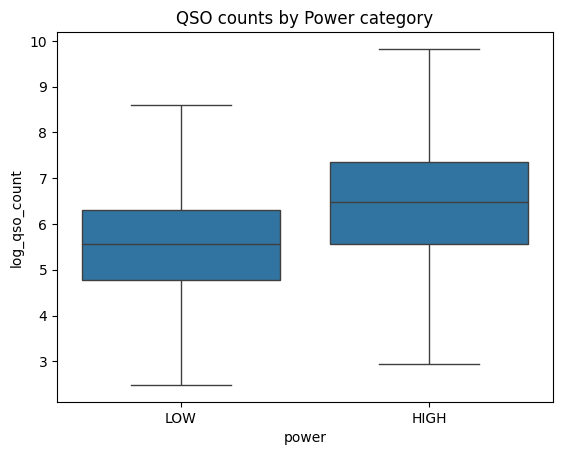

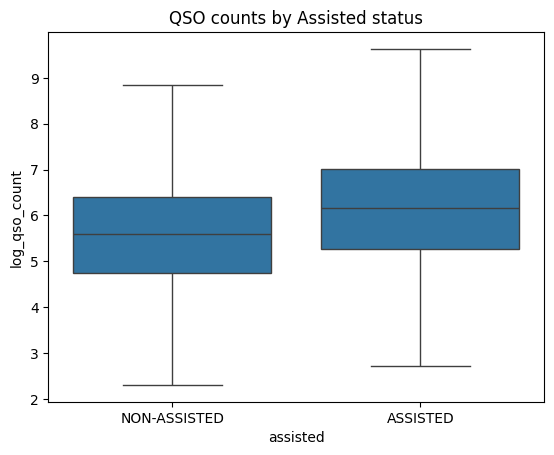

(2591626, 22)
(2591626, 22)
0
(2591626, 22)
(2591626, 22)


In [194]:
# Ensure required packages are installed
%pip install matplotlib seaborn pandas

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

print(pos.columns)

# Check if 'power' column exists in pos
if "power" not in pos.columns:
    # Try using 'CATEGORY-POWER' instead
    plt.figure(figsize=(10,6))
    sns.countplot(data=pos, x="band", hue="CATEGORY-POWER")
    plt.title("Distribution of Power Levels across Bands")
    plt.ylabel("Number of Stations")
    plt.show()
else:
    plt.figure(figsize=(10,6))
    sns.countplot(data=pos, x="band", hue="power")
    plt.title("Distribution of Power Levels across Bands")
    plt.ylabel("Number of Stations")
    plt.show()

# %%
# --- Sender side ---
sender_cols = ["band", "CALLSIGN", "CATEGORY-POWER", "CATEGORY-OPERATOR",
               "CATEGORY-ASSISTED", "CATEGORY-TRANSMITTER", "GRID-LOCATOR", "LOG_QSO_COUNT"]
sender_df = pos[sender_cols].rename(columns={
    "CALLSIGN": "callsign",
    "CATEGORY-POWER": "power",
    "CATEGORY-OPERATOR": "operator",
    "CATEGORY-ASSISTED": "assisted",
    "CATEGORY-TRANSMITTER": "transmitter",
    "GRID-LOCATOR": "locator",
    "LOG_QSO_COUNT": "log_qso_count"
})

# --- Receiver side ---
receiver_cols = ["band", "CALLSIGN_RX", "CATEGORY-POWER_RX", "CATEGORY-OPERATOR_RX",
                 "CATEGORY-ASSISTED_RX", "CATEGORY-TRANSMITTER_RX", "GRID-LOCATOR_RX", "LOG_QSO_COUNT_RX"]
receiver_df = pos[receiver_cols].rename(columns={
    "CALLSIGN_RX": "callsign",
    "CATEGORY-POWER_RX": "power",
    "CATEGORY-OPERATOR_RX": "operator",
    "CATEGORY-ASSISTED_RX": "assisted",
    "CATEGORY-TRANSMITTER_RX": "transmitter",
    "GRID-LOCATOR_RX": "locator",
    "LOG_QSO_COUNT_RX": "log_qso_count"
})

# --- Combine sender + receiver ---
station_band = pd.concat([sender_df, receiver_df], ignore_index=True)

# --- Drop duplicates per (band, callsign) ---
station_band = station_band.drop_duplicates(subset=["band", "callsign"])

# %%
# --- Plot distribution of power categories across bands ---
plt.figure(figsize=(10,6))
sns.countplot(data=station_band, x="band", hue="power",
              order=sorted(station_band["band"].unique()))
plt.title("Distribution of Power Categories across Bands")
plt.ylabel("Number of Stations")
plt.xlabel("Band")
plt.legend(title="Power")
plt.show()

# %%
from scipy.stats import chi2_contingency

ct = pd.crosstab(station_band["band"], station_band["power"])
chi2, p, dof, expected = chi2_contingency(ct)

print("Chi-square:", chi2)
print("Degrees of freedom:", dof)
print("p-value:", p)

# %%
from scipy.stats import chi2_contingency

ct = pd.crosstab(station_band["band"], station_band["power"])
chi2, p, dof, expected = chi2_contingency(ct)

print("Chi-square:", chi2)
print("Degrees of freedom:", dof)
print("p-value:", p)

if p < 0.05:
    print("Reject the null hypothesis: There is a significant association between band and power category.")
else:
    print("Fail to reject the null hypothesis: There is no significant association between band and power category.")

# %%
def confounder_analysis(df, colname, figsize=(10,6)):
    """
    Run chi-square association test + barplot for a confounder column vs band.

    Parameters:
        df (pd.DataFrame): station-band dataframe
        colname (str): column name in df (e.g., 'power', 'operator', 'assisted')
    """
    print(f"\n=== Confounder analysis: {colname} vs band ===")

    # Crosstab + chi-square test
    ct = pd.crosstab(df["band"], df[colname])
    chi2, p, dof, exp = chi2_contingency(ct)

    # Effect size (Cram├⌐r's V)
    n = ct.sum().sum()
    phi2 = chi2 / n
    r, k = ct.shape
    cramer_v = np.sqrt(phi2 / min(r-1, k-1))

    print(f"Chi-square = {chi2:.1f}, dof = {dof}, p = {p:.3g}, Cram├⌐r's V = {cramer_v:.3f}")
    if p < 0.05:
        print("ΓåÆ Significant association between band and", colname)
    else:
        print("ΓåÆ No significant association")

    # Plot
    plt.figure(figsize=figsize)
    sns.countplot(data=df, x="band", hue=colname, order=sorted(df["band"].unique()))
    plt.title(f"Distribution of {colname} across bands")
    plt.ylabel("Number of Stations")
    plt.xlabel("Band")
    plt.legend(title=colname)
    plt.show()

confounder_analysis(station_band, "operator")
confounder_analysis(station_band, "assisted")
confounder_analysis(station_band, "transmitter")

# %%
from scipy.stats import kruskal

# Subset
df_power = station_band[station_band["power"].isin(["HIGH", "LOW"])]

# Groups
groups = [g["log_qso_count"].values for _, g in df_power.groupby("power")]

# Test
stat, p = kruskal(*groups)
print("Power vs log_qso_count: H=%.2f, p=%.3g" % (stat, p))

# %%
from scipy.stats import kruskal

# Subset
df_power = station_band[station_band["power"].isin(["HIGH", "LOW"])]

# Groups
groups = [g["log_qso_count"].values for _, g in df_power.groupby("power")]

# Test
stat, p = kruskal(*groups)
print("Power vs log_qso_count: H=%.2f, p=%.3g" % (stat, p))

df_assist = station_band[station_band["assisted"].isin(["ASSISTED", "NON-ASSISTED"])]
groups = [g["log_qso_count"].values for _, g in df_assist.groupby("assisted")]

stat, p = kruskal(*groups)
print("Assisted vs log_qso_count: H=%.2f, p=%.3g" % (stat, p))

# %%
sns.boxplot(data=df_power, x="power", y="log_qso_count", showfliers=False)
plt.title("QSO counts by Power category")
plt.show()

sns.boxplot(data=df_assist, x="assisted", y="log_qso_count", showfliers=False)
plt.title("QSO counts by Assisted status")
plt.show()

# %%
# list of callsigns with QRP, or multi-op status, more than 1 transmitter(i.e UNLIMITED or TWO)
callsigns_to_remove = station_band[station_band["power"] == "QRP"]["callsign"].tolist() + station_band[station_band["operator"] == "MULTI-OP"]["callsign"].tolist() + station_band[station_band["transmitter"].isin(["UNLIMITED", "TWO"])]["callsign"].tolist()

# %%
# list of callsigns with QRP, or multi-op status, more than 1 transmitter(i.e UNLIMITED or TWO)
callsigns_to_remove = station_band[station_band["power"] == "QRP"]["callsign"].tolist() + station_band[station_band["operator"] == "MULTI-OP"]["callsign"].tolist() + station_band[station_band["transmitter"].isin(["UNLIMITED", "TWO"])]["callsign"].tolist()

#remove duplicates
callsigns_to_remove = list(set(callsigns_to_remove))

# remove from main dataframe
station_band = station_band[~station_band["callsign"].isin(callsigns_to_remove)]

# %%
# list of callsigns with QRP, or multi-op status, more than 1 transmitter(i.e UNLIMITED or TWO)
callsigns_to_remove = station_band[station_band["power"] == "QRP"]["callsign"].tolist() + station_band[station_band["operator"] == "MULTI-OP"]["callsign"].tolist() + station_band[station_band["transmitter"].isin(["UNLIMITED", "TWO"])]["callsign"].tolist()

#remove duplicates
callsigns_to_remove = list(set(callsigns_to_remove))

# remove from main dataframe
station_band = station_band[~station_band["callsign"].isin(callsigns_to_remove)]

# remove QSO log from pos if CALLSIGN or CALLSIGN_RX in callsigns_to_remove
print(pos.shape)
pos_table = pos[~pos["CALLSIGN"].isin(callsigns_to_remove) & ~pos["CALLSIGN_RX"].isin(callsigns_to_remove)]
print(pos_table.shape)

# %%
# list of callsigns with QRP, or multi-op status, more than 1 transmitter(i.e UNLIMITED or TWO)
callsigns_to_remove = station_band[station_band["power"] == "QRP"]["callsign"].tolist() + station_band[station_band["operator"] == "MULTI-OP"]["callsign"].tolist() + station_band[station_band["transmitter"].isin(["UNLIMITED", "TWO"])]["callsign"].tolist()

#remove duplicates
callsigns_to_remove = list(set(callsigns_to_remove))
print(len(callsigns_to_remove))
# remove from main dataframe
station_band = station_band[~station_band["callsign"].isin(callsigns_to_remove)]

# remove QSO log from pos if CALLSIGN or CALLSIGN_RX in callsigns_to_remove
print(pos.shape)
pos_table = pos[~pos["CALLSIGN"].isin(callsigns_to_remove) & ~pos["CALLSIGN_RX"].isin(callsigns_to_remove)]
print(pos_table.shape)


In [195]:

# %%
# --- Sender side ---
sender_cols = ["band", "CALLSIGN", "CATEGORY-POWER", "CATEGORY-OPERATOR",
               "CATEGORY-ASSISTED", "CATEGORY-TRANSMITTER", "GRID-LOCATOR", "LOG_QSO_COUNT"]
sender_df = pos[sender_cols].rename(columns={
    "CALLSIGN": "callsign",
    "CATEGORY-POWER": "power",
    "CATEGORY-OPERATOR": "operator",
    "CATEGORY-ASSISTED": "assisted",
    "CATEGORY-TRANSMITTER": "transmitter",
    "GRID-LOCATOR": "locator",
    
    "LOG_QSO_COUNT": "log_qso_count"
})

# --- Receiver side ---
receiver_cols = ["band", "CALLSIGN_RX", "CATEGORY-POWER_RX", "CATEGORY-OPERATOR_RX",
                 "CATEGORY-ASSISTED_RX", "CATEGORY-TRANSMITTER_RX", "GRID-LOCATOR_RX","LOG_QSO_COUNT_RX"]
receiver_df = pos[receiver_cols].rename(columns={
    "CALLSIGN_RX": "callsign",
    "CATEGORY-POWER_RX": "power",
    "CATEGORY-OPERATOR_RX": "operator",
    "CATEGORY-ASSISTED_RX": "assisted",
    "CATEGORY-TRANSMITTER_RX": "transmitter",
    "GRID-LOCATOR_RX": "locator",
    
    "LOG_QSO_COUNT_RX": "log_qso_count"
})

# --- Combine sender + receiver ---
station_band = pd.concat([sender_df, receiver_df], ignore_index=True)

# --- Drop duplicates per (band, callsign) ---
station_band = station_band.drop_duplicates(subset=["band", "callsign"])

# %%
# list of callsigns with QRP, or multi-op status, more than 1 transmitter(i.e UNLIMITED or TWO)
#callsigns_to_remove = station_band[station_band["power"] == "QRP"]["callsign"].tolist() + station_band[station_band["operator"] == "MULTI-OP"]["callsign"].tolist() + station_band[station_band["transmitter"].isin(["UNLIMITED", "TWO"])]["callsign"].tolist()

#remove duplicates
#callsigns_to_remove = list(set(callsigns_to_remove))
#print(len(callsigns_to_remove))
# remove from main dataframe
#station_band = station_band[~station_band["callsign"].isin(callsigns_to_remove)]

# remove QSO log from pos if CALLSIGN or CALLSIGN_RX in callsigns_to_remove
print(pos.shape)
pos_table = pos[~pos["CALLSIGN"].isin(callsigns_to_remove) & ~pos["CALLSIGN_RX"].isin(callsigns_to_remove)]
print(pos_table.shape)


# =====================================================================


# print column names in station_band
print("Column names in station_band:", station_band.columns)

(2591626, 22)
(2591626, 22)
Column names in station_band: Index(['band', 'callsign', 'power', 'operator', 'assisted', 'transmitter',
       'locator', 'log_qso_count'],
      dtype='object')


In [196]:
# import pandas as pd
# import numpy as np

#remove log_qso_counts from station band copy
station_band_copy = station_band.copy()
station_band_copy = station_band_copy.drop(columns=['log_qso_count'], errors='ignore')


# 0) Start from your copy without legacy log_qso_count
station_band_copy = station_band.drop(columns=['log_qso_count'], errors='ignore').copy()

# (Optional but recommended) normalize keys to avoid join misses due to casing/whitespace
station_band_copy['band'] = station_band_copy['band'].astype(str).str.strip()
station_band_copy['callsign'] = station_band_copy['callsign'].astype(str).str.strip().str.upper()

# 1) Build long-form (band, callsign) from pos for both TX and RX sides
tx = (
    pos[['band', 'CALLSIGN']]
    .rename(columns={'CALLSIGN': 'callsign'})
    .dropna(subset=['band', 'callsign'])
    .assign(side='tx')
)
rx = (
    pos[['band', 'CALLSIGN_RX']]
    .rename(columns={'CALLSIGN_RX': 'callsign'})
    .dropna(subset=['band', 'callsign'])
    .assign(side='rx')
)

# Normalize keys to match station_band_copy
for df_ in (tx, rx):
    df_['band'] = df_['band'].astype(str).str.strip()
    df_['callsign'] = df_['callsign'].astype(str).str.strip().str.upper()

long_pos = pd.concat([tx, rx], ignore_index=True)

# 2) Count QSOs per (band, callsign), optionally keep side-specific counts too
counts_total = (
    long_pos.groupby(['band', 'callsign'], as_index=False)
            .size()
            .rename(columns={'size': 'qso_count'})
)

counts_tx = (
    long_pos[long_pos['side'] == 'tx']
        .groupby(['band', 'callsign'], as_index=False)
        .size()
        .rename(columns={'size': 'qso_count_tx'})
)

counts_rx = (
    long_pos[long_pos['side'] == 'rx']
        .groupby(['band', 'callsign'], as_index=False)
        .size()
        .rename(columns={'size': 'qso_count_rx'})
)

# 3) Merge counts into station_band_copy (left join ensures we keep your station list)
station_band_counts = (
    station_band_copy
      .merge(counts_total, on=['band', 'callsign'], how='left')
      .merge(counts_tx,    on=['band', 'callsign'], how='left')
      .merge(counts_rx,    on=['band', 'callsign'], how='left')
)

# Fill NaNs for stations that appear in headers but not in pos (rare) and ensure ints
for c in ['qso_count', 'qso_count_tx', 'qso_count_rx']:
    if c in station_band_counts:
        station_band_counts[c] = station_band_counts[c].fillna(0).astype(int)

station_band_counts['log_qso_count'] = np.log1p(station_band_counts['qso_count'])
print(station_band_counts.head())

  band callsign power   operator      assisted transmitter locator  qso_count  \
0  40M   2E0CVN   LOW  SINGLE-OP  NON-ASSISTED         ONE  IO80EM        251   
1  80M   2E0CVN   LOW  SINGLE-OP  NON-ASSISTED         ONE  IO80EM         96   
2  20M   2E0CVN   LOW  SINGLE-OP  NON-ASSISTED         ONE  IO80EM        322   
3  15M   2E0CVN   LOW  SINGLE-OP  NON-ASSISTED         ONE  IO80EM        308   
4  10M   2E0CVN   LOW  SINGLE-OP  NON-ASSISTED         ONE  IO80EM        220   

   qso_count_tx  qso_count_rx  log_qso_count  
0           241            10       5.529429  
1            86            10       4.574711  
2           318             4       5.777652  
3           301             7       5.733341  
4           217             3       5.398163  


operator     MULTI-OP     SINGLE-OP
band                               
10M       1842.416330  27833.029447
15M       1839.087361  23921.361278
160M       896.334659   4822.098130
20M       1819.240009  22432.750659
40M       1776.044089  20893.067750
80M       1410.128684  12029.572770


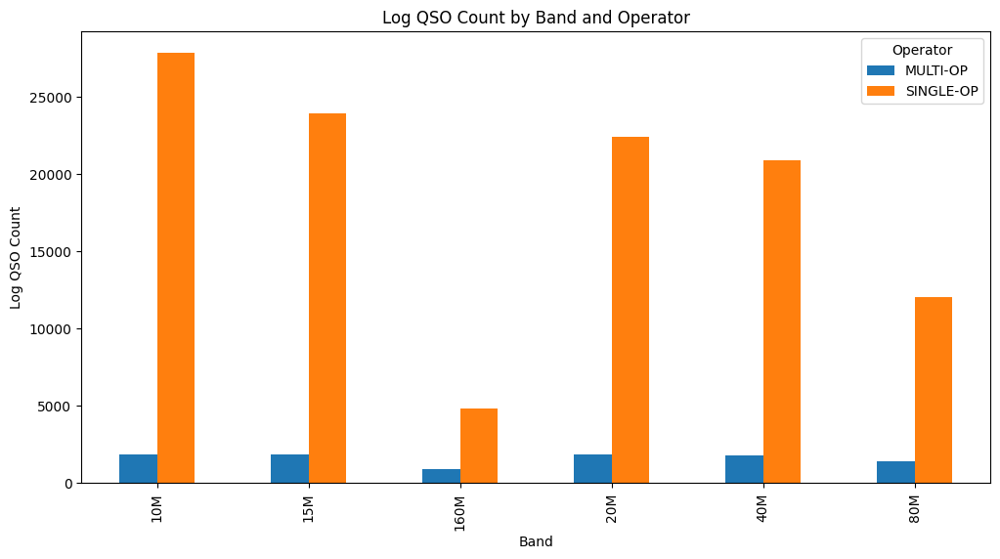

In [201]:
# sum log qso counts by band and operator
qso_counts = station_band_counts.groupby(["band", "operator"])["log_qso_count"].sum().unstack(fill_value=0)
print(qso_counts)

# plot unstacked bar charts
qso_counts.plot(kind="bar", stacked=False, figsize=(12, 6))
plt.title("Log QSO Count by Band and Operator")
plt.xlabel("Band")
plt.ylabel("Log QSO Count")
plt.legend(title="Operator")
plt.show()


In [203]:
# number of rows, per band with log_qso_count == 1
for band in bands_order:
    band_data = station_band_counts[station_band_counts["band"] == band]
    num_rows = band_data[band_data["qso_count"] == 1].shape[0]
    print(f"Number of rows for {band} Band with qso_count == 1: {num_rows}")


# print station_band_counts sorted in ascending order for qso_count
print(station_band_counts.sort_values(by="qso_count", ascending=True).head())

Number of rows for 10M Band with qso_count == 1: 200
Number of rows for 15M Band with qso_count == 1: 299
Number of rows for 20M Band with qso_count == 1: 301
Number of rows for 40M Band with qso_count == 1: 290
Number of rows for 80M Band with qso_count == 1: 285
Number of rows for 160M Band with qso_count == 1: 218
      band callsign power   operator      assisted transmitter locator  \
30120  15M    EU1DC  HIGH  SINGLE-OP      ASSISTED         ONE  KO33TW   
30133  20M   JH1BBT  HIGH  SINGLE-OP      ASSISTED         ONE  PM95JS   
29741  10M   DL7UVO   LOW  SINGLE-OP      ASSISTED         ONE  JO62SN   
30131  20M   JA7OWD  HIGH  SINGLE-OP      ASSISTED         ONE  qm07lp   
30130  15M    RW0CR  HIGH  SINGLE-OP  NON-ASSISTED         ONE    PN78   

       qso_count  qso_count_tx  qso_count_rx  log_qso_count  
30120          1             0             1       0.693147  
30133          1             0             1       0.693147  
29741          1             0             1      

In [204]:
test_station_band_counts = station_band_counts[station_band_counts["qso_count"] == 1]

# callsign and their number of rows in test_station_band_counts
callsign_counts = test_station_band_counts["callsign"].value_counts()
print(callsign_counts)

callsigns_to_remove = callsign_counts[callsign_counts > 1].index
print(len(callsigns_to_remove))

mask__ = station_band_counts["callsign"].isin(callsigns_to_remove) & (station_band_counts["qso_count"] == 1)
clean_station_band_counts = station_band_counts.loc[~mask__].copy()

callsign
EA5KM     4
DL6KWU    3
A65D      3
EU3A      3
M1T       3
         ..
S54O      1
OM3DX     1
K2SD      1
HB9FBS    1
7N2JLJ    1
Name: count, Length: 1351, dtype: int64
212


In [207]:
print(clean_station_band_counts[clean_station_band_counts['assisted']=='NON-ASSISTED'].shape)

(11529, 11)


In [211]:
print(clean_station_band_counts['operator'].unique())

['SINGLE-OP' 'MULTI-OP']


In [216]:
# import pandas as pd
# import numpy as np



# 1) Normalize + keep only the two buckets
df = pos.copy()
df['band'] = df['band'].astype(str).str.strip().str.upper()
df = df[df['CATEGORY-ASSISTED'].isin(['ASSISTED','NON-ASSISTED'])]

# 2) Contingency table (counts)
contingency = pd.crosstab(df['band'], df['CATEGORY-ASSISTED']).reindex(
    columns=['ASSISTED', 'NON-ASSISTED'], fill_value=0)

# Keep your preferred band order if available
if 'bands_order' in globals():
    contingency = contingency.reindex(bands_order, fill_value=0)

# 3) (Optional) add totals
contingency_with_totals = contingency.copy()
contingency_with_totals['TOTAL'] = contingency.sum(axis=1)
contingency_with_totals.loc['TOTAL'] = contingency_with_totals.sum()

print(contingency_with_totals)

# 4) (Optional) percentage views
row_pct = contingency.div(contingency.sum(axis=1), axis=0).round(3)   # within-band %
col_pct = contingency.div(contingency.sum(axis=0), axis=1).round(3)   # within-status %
overall_pct = (contingency / contingency.values.sum()).round(4)       # of all QSOs

# Example: inspect
print(row_pct)
# print(col_pct)
# print(overall_pct)


CATEGORY-ASSISTED  ASSISTED  NON-ASSISTED    TOTAL
band                                              
10M                  523789        238742   762531
15M                  406049        177965   584014
20M                  371868        138134   510002
40M                  354202        124139   478341
80M                  155655         50449   206104
160M                  39586         11048    50634
TOTAL               1851149        740477  2591626
CATEGORY-ASSISTED  ASSISTED  NON-ASSISTED
band                                     
10M                   0.687         0.313
15M                   0.695         0.305
20M                   0.729         0.271
40M                   0.740         0.260
80M                   0.755         0.245
160M                  0.782         0.218


In [217]:
# import numpy as np
# import pandas as pd
# from scipy.stats import chi2_contingency

# 1) Use the contingency table without totals
obs = contingency_with_totals.loc[
    contingency_with_totals.index != 'TOTAL',
    ['ASSISTED', 'NON-ASSISTED']
].copy()

# 2) Chi-square test of homogeneity
chi2, p, dof, expected = chi2_contingency(obs.values)

print(f"Chi-square homogeneity test: χ²={chi2:.2f}, dof={dof}, p={p:.4g}")

# 3) Expected counts as a DataFrame aligned to obs
expected_df = pd.DataFrame(expected, index=obs.index, columns=obs.columns)
print("\nExpected counts (under H0):")
print(expected_df.round(1))

# 4) Residual diagnostics
#    Pearson residuals: (O - E) / sqrt(E)
pearson_resid = (obs - expected_df) / np.sqrt(expected_df)

#    Adjusted (Haberman) residuals account for row/col margins
n = obs.values.sum()
row_prop = obs.sum(axis=1).values[:, None] / n
col_prop = obs.sum(axis=0).values[None, :] / n
adj_denom = np.sqrt(expected_df * (1 - row_prop) * (1 - col_prop))
adj_resid = (obs - expected_df) / adj_denom

print("\nPearson residuals:")
print(pearson_resid.round(2))

print("\nAdjusted residuals:")
print(adj_resid.round(2))

# 5) Effect size: Cramér’s V
r, c = obs.shape
cramers_v = (chi2 / (n * (min(r - 1, c - 1)))) ** 0.5
print(f"\nCramér’s V: {cramers_v:.3f}")


Chi-square homogeneity test: χ²=8819.08, dof=5, p=0

Expected counts (under H0):
CATEGORY-ASSISTED  ASSISTED  NON-ASSISTED
band                                     
10M                544661.3      217869.7
15M                417150.1      166863.9
20M                364284.7      145717.3
40M                341669.8      136671.2
80M                147216.2       58887.8
160M                36166.9       14467.1

Pearson residuals:
CATEGORY-ASSISTED  ASSISTED  NON-ASSISTED
band                                     
10M                  -28.28         44.72
15M                  -17.19         27.18
20M                   12.56        -19.87
40M                   21.44        -33.90
80M                   21.99        -34.78
160M                  17.98        -28.43

Adjusted residuals:
CATEGORY-ASSISTED  ASSISTED  NON-ASSISTED
band                                     
10M                  -62.98         62.98
15M                  -36.53         36.53
20M                   26.23        -26

In [219]:
# print(A.head())
# print(B.head())

In [221]:
# drop qrp contacts from station band and pos (stored in a new table called pos_table)
station_band = station_band[station_band['band'] != 'QRP']
pos_table = pos[(pos['CATEGORY-POWER'].ne('QRP')) & (pos['CATEGORY-POWER_RX'].ne('QRP'))]



In [223]:
print(pos.head())

  sent_call rcvd_call            pairs band      slice  Y CALLSIGN  \
0    2E0CVN     HA1AG  (2E0CVN, HA1AG)  40M 2024-11-23  1   2E0CVN   
1    2E0CVN     OM0WR  (2E0CVN, OM0WR)  40M 2024-11-23  1   2E0CVN   
2    2E0CVN     VY2TT  (2E0CVN, VY2TT)  40M 2024-11-23  1   2E0CVN   
3    2E0CVN      S56M   (2E0CVN, S56M)  40M 2024-11-23  1   2E0CVN   
4    2E0CVN      DM4X   (2E0CVN, DM4X)  40M 2024-11-23  1   2E0CVN   

  CATEGORY-POWER CATEGORY-OPERATOR CATEGORY-ASSISTED  ... LOG_QSO_COUNT  \
0            LOW         SINGLE-OP      NON-ASSISTED  ...      7.115582   
1            LOW         SINGLE-OP      NON-ASSISTED  ...      7.115582   
2            LOW         SINGLE-OP      NON-ASSISTED  ...      7.115582   
3            LOW         SINGLE-OP      NON-ASSISTED  ...      7.115582   
4            LOW         SINGLE-OP      NON-ASSISTED  ...      7.115582   

  CALLSIGN_RX  CATEGORY-POWER_RX CATEGORY-OPERATOR_RX CATEGORY-ASSISTED_RX  \
0       HA1AG               HIGH            SINGLE

In [224]:
print(counts_total.head())
print(counts_total.shape)
print(counts_tx.head())
print(counts_tx.shape)
print(counts_rx.head())
print(counts_rx.shape)

  band callsign  qso_count
0  10M   2E0CVN        220
1  10M   2E0EBM          6
2  10M   2E0FFT          5
3  10M   2E0JLZ         44
4  10M    3B8HK         32
(30145, 3)
  band callsign  qso_count_tx
0  10M   2E0CVN           217
1  10M   2E0EBM             6
2  10M   2E0FFT             5
3  10M   2E0JLZ            44
4  10M    3B8HK            32
(27792, 3)
  band callsign  qso_count_rx
0  10M   2E0CVN             3
1  10M     3B8M            94
2  10M    3B9KW            49
3  10M    3D2SP            66
4  10M     3D2Y            56
(29240, 3)


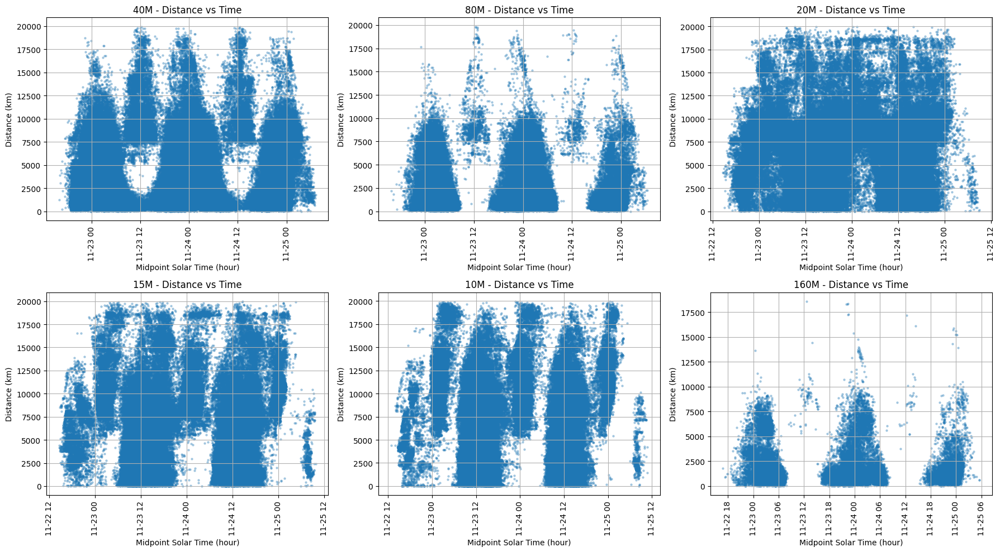

In [225]:
bands = pos['band'].unique()
fig, axes = plt.subplots(2, 3, figsize=(18, 10), sharex=False, sharey=False)
axes = axes.flatten()

for idx, band in enumerate(bands):
    ax = axes[idx]
    df_band = pos[(pos['band'] == band) & (pos['distance'].notnull()) & (pos['midpoint_solar_time'].notnull())]
    ax.scatter(df_band['midpoint_solar_time'], df_band['distance'], alpha=0.3, s=5)
    ax.set_title(f'{band} - Distance vs Time')
    ax.set_xlabel('Midpoint Solar Time (hour)')
    ax.set_ylabel('Distance (km)')
    ax.grid(True)
    ax.tick_params(axis='x', rotation=90)

# Hide unused subplots if bands < 6
for ax in axes[len(bands):]:
    ax.axis('off')

plt.tight_layout()
plt.show()

Text(0.5, 1.0, 'Participants by Power Category')

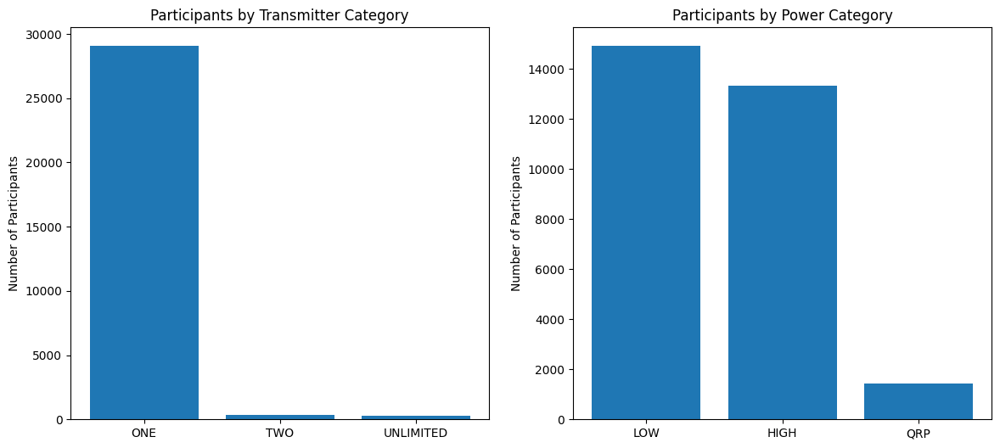

In [228]:
# plot the bar charts for number of participants for different transmitters categories and power (in one plot) with percentages
# use clean_station_band_counts

def add_labels(x, y, y_value):
    for i in range(len(x)):
        plt.text(i, y[i], y_value[i], ha='center', va='bottom')

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

c = clean_station_band_counts['transmitter'].value_counts()
total_c = c.sum()
percentages_c = c / total_c * 100

ax1.bar(c.index, c.values)
ax1.set_ylabel('Number of Participants')
ax1.set_title('Participants by Transmitter Category')
# add_labels(range(len(c.index)), c.values, percentages_c.values)

#ax1.bar(c.index, c.values / total_c * 100)
# ax1.set_ylabel('Percentage of Participants')
# ax1.set_title('Participants by Transmitter Category (Percentage)')

cp = clean_station_band_counts['power'].value_counts()
total_cp = cp.sum()
percentages_cp = cp / total_cp * 100

ax2.bar(cp.index, cp.values)
ax2.set_ylabel('Number of Participants')
ax2.set_title('Participants by Power Category')
# add_labels(range(len(cp.index)), cp.values, percentages_cp.values)

# ax2.bar(cp.index, cp.values / total_cp * 100)
# ax2.set_ylabel('Percentage of Participants')
# ax2.set_title('Participants by Power Category (Percentage)')


In [229]:
# import pandas as pd
# import numpy as np

# 0) Start from your copy without legacy log_qso_count
station_band_copy = station_band.drop(columns=['log_qso_count'], errors='ignore').copy()

# (Optional but recommended) normalize keys to avoid join misses due to casing/whitespace
station_band_copy['band'] = station_band_copy['band'].astype(str).str.strip()
station_band_copy['callsign'] = station_band_copy['callsign'].astype(str).str.strip().str.upper()

# 1) Build long-form (band, callsign) from pos for both TX and RX sides
tx = (
    pos[['band', 'CALLSIGN']]
    .rename(columns={'CALLSIGN': 'callsign'})
    .dropna(subset=['band', 'callsign'])
    .assign(side='tx')
)
rx = (
    pos[['band', 'CALLSIGN_RX']]
    .rename(columns={'CALLSIGN_RX': 'callsign'})
    .dropna(subset=['band', 'callsign'])
    .assign(side='rx')
)

# Normalize keys to match station_band_copy
for df_ in (tx, rx):
    df_['band'] = df_['band'].astype(str).str.strip()
    df_['callsign'] = df_['callsign'].astype(str).str.strip().str.upper()

long_pos = pd.concat([tx, rx], ignore_index=True)

# 2) Count QSOs per (band, callsign), optionally keep side-specific counts too
counts_total = (
    long_pos.groupby(['band', 'callsign'], as_index=False)
            .size()
            .rename(columns={'size': 'qso_count'})
)

counts_tx = (
    long_pos[long_pos['side'] == 'tx']
        .groupby(['band', 'callsign'], as_index=False)
        .size()
        .rename(columns={'size': 'qso_count_tx'})
)

counts_rx = (
    long_pos[long_pos['side'] == 'rx']
        .groupby(['band', 'callsign'], as_index=False)
        .size()
        .rename(columns={'size': 'qso_count_rx'})
)

# 3) Merge counts into station_band_copy (left join ensures we keep your station list)
station_band_counts = (
    station_band_copy
      .merge(counts_total, on=['band', 'callsign'], how='left')
      .merge(counts_tx,    on=['band', 'callsign'], how='left')
      .merge(counts_rx,    on=['band', 'callsign'], how='left')
)

# Fill NaNs for stations that appear in headers but not in pos (rare) and ensure ints
for c in ['qso_count', 'qso_count_tx', 'qso_count_rx']:
    if c in station_band_counts:
        station_band_counts[c] = station_band_counts[c].fillna(0).astype(int)



In [230]:
# pearsons chi squared test to see association between power and band 
from scipy.stats import chi2_contingency
# build contingency table 

ct = pd.crosstab(clean_station_band_counts['band'], clean_station_band_counts['power'])

print(ct)

# pearson's chi squared test, H0 is Band and Power are independent, H1 Band and Power are associated (i.e some Bands have certain power operators)

chi2, p, dof, expected = chi2_contingency(ct)
print("p value is ", p)
# effect cramers v

n = ct.values.sum()
phi2 = chi2/n
r, k = ct.shape
cramers_v = np.sqrt(phi2 / min(k-1 , r-1))

print("cramers v is ",cramers_v )

# standardized residuals

residuals = (ct - expected)/np.sqrt(expected)
residuals = pd.DataFrame(residuals, index = ct.index, columns=ct.columns)
print(residuals)


power  HIGH   LOW  QRP
band                  
10M    2789  3443  357
15M    2596  3146  307
160M   1132   735   70
20M    2540  3062  290
40M    2436  2769  269
80M    1845  1758  147
p value is  7.215338190661516e-40
cramers v is  0.05964514619319896
power      HIGH       LOW       QRP
band                               
10M   -3.142274  2.320962  2.094193
15M   -2.328371  1.954779  0.795547
160M   8.876673 -7.627217 -2.470337
20M   -2.076791  1.886111  0.250862
40M   -0.465200  0.372943  0.215634
80M    3.907977 -2.892315 -2.585881


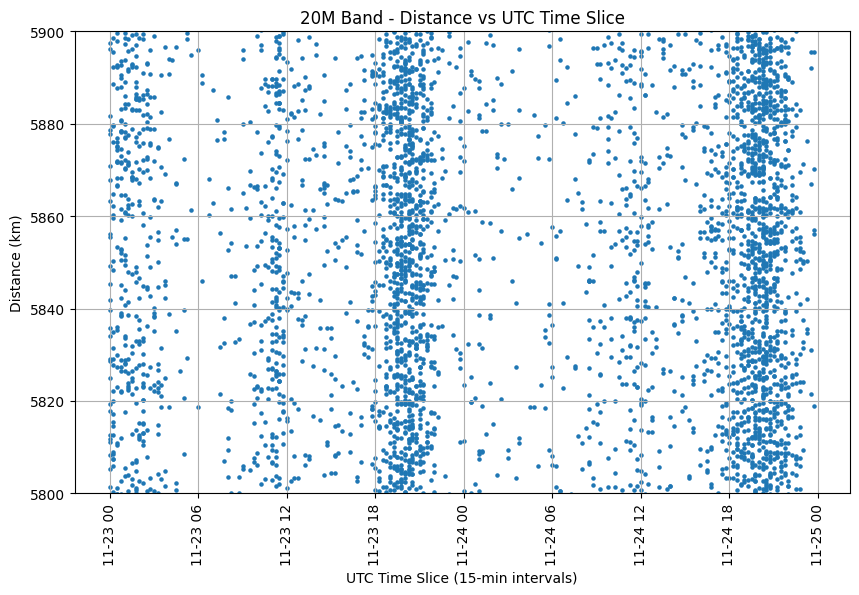

In [233]:
# 20m band scatter plot, distance vs UTC time (slice columns in pos)
plt.figure(figsize=(10, 6))
df_20m = pos[(pos['band'] == '20M') & (pos['distance'].notnull()) & (pos['slice'].notnull())]
plt.scatter(df_20m['slice'], df_20m['distance'], alpha=1, s=5)
plt.title('20M Band - Distance vs UTC Time Slice')
plt.xlabel('UTC Time Slice (15-min intervals)')
plt.ylabel('Distance (km)')
plt.ylim(5800, 5900)
plt.grid(True)
plt.xticks(rotation=90)
plt.show()





In [235]:
qso_sampled.columns

Index(['sent_call', 'rcvd_call', 'pairs', 'band', 'slice', 'Y', 'CALLSIGN',
       'CATEGORY-POWER', 'CATEGORY-OPERATOR', 'CATEGORY-ASSISTED',
       'CATEGORY-TRANSMITTER', 'GRID-LOCATOR', 'LOG_QSO_COUNT', 'CALLSIGN_RX',
       'CATEGORY-POWER_RX', 'CATEGORY-OPERATOR_RX', 'CATEGORY-ASSISTED_RX',
       'CATEGORY-TRANSMITTER_RX', 'GRID-LOCATOR_RX', 'LOG_QSO_COUNT_RX',
       'distance', 'midpoint_solar_time', 'solar_hour', 'lon_1', 'lon_2',
       'delta_tau', 'tau1_hours', 'tau2_hours', 'delta_bin', 'lat_1', 'lat_2'],
      dtype='object')

       sent_call rcvd_call            pairs band               slice  Y  \
8          4Z5ML     HA5AQ   (4Z5ML, HA5AQ)  10M 2024-11-23 08:15:00  1   
20         G1SCT     LZ1RW   (G1SCT, LZ1RW)  10M 2024-11-24 12:30:00  1   
58          K5WA    VE3GMZ   (K5WA, VE3GMZ)  10M 2024-11-23 16:15:00  1   
67         F4FFZ    SV2AEL  (F4FFZ, SV2AEL)  10M 2024-11-24 14:15:00  1   
100       SP9ATE     EI2KA  (EI2KA, SP9ATE)  10M 2024-11-24 15:00:00  1   
...          ...       ...              ...  ...                 ... ..   
119795      LZ4T      R1NW     (LZ4T, R1NW)  80M 2024-11-24 18:45:00  1   
119826     EU6RO      TM4Q    (EU6RO, TM4Q)  80M 2024-11-23 22:45:00  1   
119875      9A1A      R4BZ     (9A1A, R4BZ)  80M 2024-11-24 20:45:00  1   
119893     KL7KY    VE7XFA  (KL7KY, VE7XFA)  80M 2024-11-23 05:00:00  1   
119988      II4B      R3OM     (II4B, R3OM)  80M 2024-11-23 04:15:00  1   

       CALLSIGN CATEGORY-POWER CATEGORY-OPERATOR CATEGORY-ASSISTED  ...  \
8         4Z5ML         

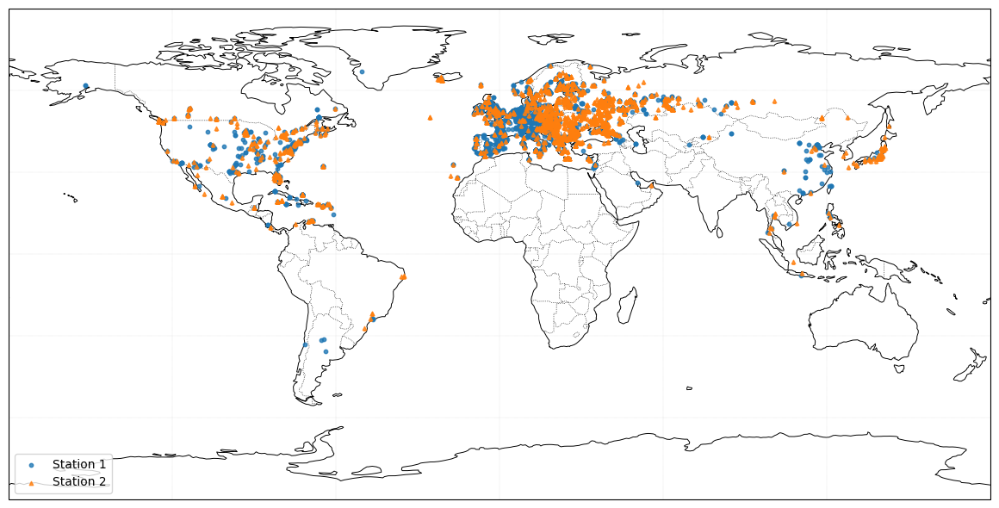

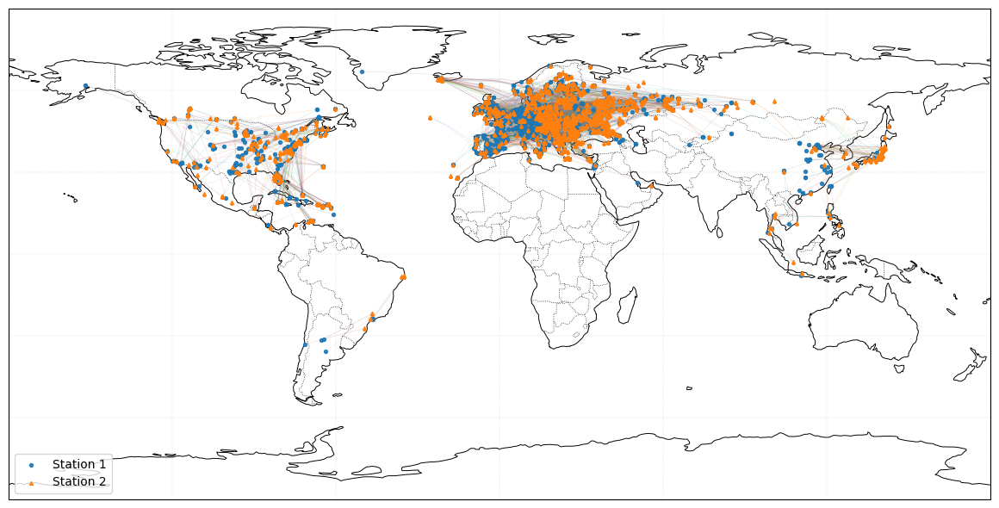

In [236]:
qso_sampled_US_UK = qso_sampled[(qso_sampled['distance'] <= 2250) & (qso_sampled['distance'] >= 2050)]
print(qso_sampled_US_UK)
# plot all callsigns in qso_sampled_US_UK on map


len(qso_sampled)
# # plot histogram of distance in qso_sampled
# plt.figure(figsize=(10, 6))
# plt.hist(qso_sampled['distance'], bins=50, color='blue', alpha=0.7)
# plt.title('Histogram of Distances in Sampled QSOs')
# plt.xlabel('Distance (km)')
# plt.ylabel('Frequency')
# plt.grid(True)
# plt.show()


# # plot histogram of distance in qso_sampled_US_UK
# plt.figure(figsize=(10, 6))
# plt.hist(qso_sampled_US_UK['distance'], bins=50, color='blue', alpha=0.7)
# plt.title('Histogram of Distances in Sampled QSOs (US-UK Focus)')
# plt.xlabel('Distance (km)')
# plt.ylabel('Frequency')
# plt.grid(True)
# plt.show()

cols = ['lat_1','lon_1','lat_2','lon_2']
df = qso_sampled_US_UK.loc[~qso_sampled_US_UK[cols].isna().any(axis=1)].copy()

fig = plt.figure(figsize=(12,6))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_global()
ax.add_feature(cfeature.COASTLINE, linewidth=0.7)
ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=0.5)
ax.gridlines(draw_labels=False, linewidth=0.25, linestyle=':')

# Plot station 1 (e.g., sender) and station 2 (e.g., receiver)
ax.scatter(df['lon_1'], df['lat_1'],
           s=10, alpha=0.8, transform=ccrs.PlateCarree(),
           label='Station 1', zorder=3)

ax.scatter(df['lon_2'], df['lat_2'],
           s=10, alpha=0.8, marker='^', transform=ccrs.PlateCarree(),
           label='Station 2', zorder=3)

ax.legend(loc='lower left', frameon=True)
plt.tight_layout()
plt.show()


import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Keep rows with all four coordinates present
cols = ['lat_1','lon_1','lat_2','lon_2']
df = qso_sampled_US_UK.loc[~qso_sampled_US_UK[cols].isna().any(axis=1)].copy()

fig = plt.figure(figsize=(12,6))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_global()
ax.add_feature(cfeature.COASTLINE, linewidth=0.7)
ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=0.5)
ax.gridlines(draw_labels=False, linewidth=0.25, linestyle=':')

# Plot endpoints
ax.scatter(df['lon_1'], df['lat_1'], s=8, alpha=0.9,
           transform=ccrs.PlateCarree(), label='Station 1', zorder=3)
ax.scatter(df['lon_2'], df['lat_2'], s=8, alpha=0.9, marker='^',
           transform=ccrs.PlateCarree(), label='Station 2', zorder=3)

# Draw great-circle paths between each pair
# (transform=ccrs.Geodetic() tells Cartopy to interpolate along a great circle)
for r in df.itertuples(index=False):
    ax.plot([r.lon_1, r.lon_2], [r.lat_1, r.lat_2],
            transform=ccrs.Geodetic(),
            linewidth=0.3, alpha=0.25, zorder=2)

ax.legend(loc='lower left', frameon=True)
plt.tight_layout()
plt.show()


In [237]:
!pip install sklearn

  Using cached sklearn-0.0.post12.tar.gz (2.6 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'error'


  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> [15 lines of output]
      The 'sklearn' PyPI package is deprecated, use 'scikit-learn'
      rather than 'sklearn' for pip commands.
      
      Here is how to fix this error in the main use cases:
      - use 'pip install scikit-learn' rather than 'pip install sklearn'
      - replace 'sklearn' by 'scikit-learn' in your pip requirements files
        (requirements.txt, setup.py, setup.cfg, Pipfile, etc ...)
      - if the 'sklearn' package is used by one of your dependencies,
        it would be great if you take some time to track which package uses
        'sklearn' instead of 'scikit-learn' and report it to their issue tracker
      - as a last resort, set the environment variable
        SKLEARN_ALLOW_DEPRECATED_SKLEARN_PACKAGE_INSTALL=True to avoid this error
      
      More information is available at
      https://github.com/scikit-learn/sklearn-pypi-packag

cluster
0    3852
1     182
2     592
Name: count, dtype: int64


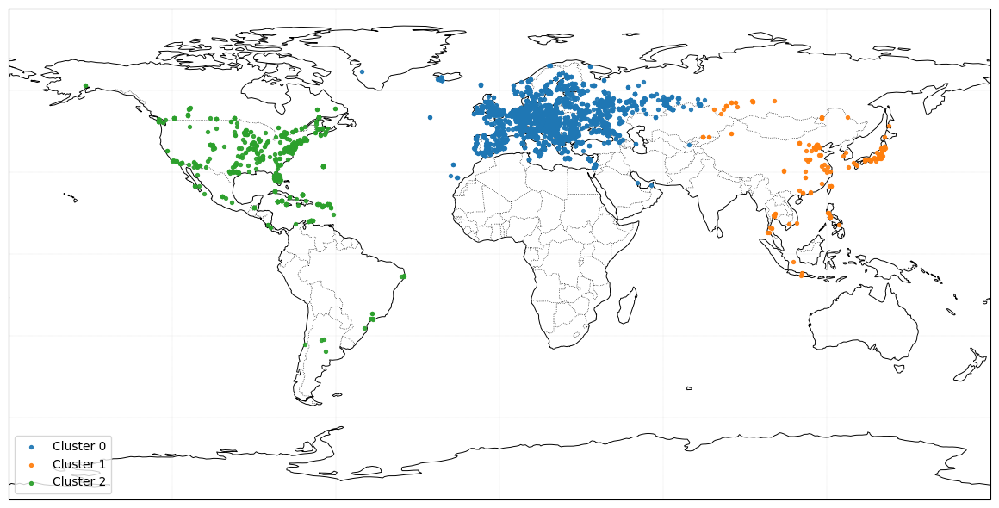

In [238]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

import builtins  # add this near the top

def kmeans_numpy(X, k, n_init=10, max_iter=300, random_state=42):
    rng_master = np.random.default_rng(random_state)
    best_inertia = np.inf
    best_labels = None
    best_centers = None

    n_init = int(n_init)
    max_iter = int(max_iter)

    for _ in builtins.range(n_init):
        rng = np.random.default_rng(rng_master.integers(1<<32))
        centers = X[rng.choice(len(X), size=k, replace=False)].copy()

        for _ in builtins.range(max_iter):
            dists = np.linalg.norm(X[:, None, :] - centers[None, :, :], axis=2)
            labels = dists.argmin(axis=1)
            new_centers = np.zeros_like(centers)
            for j in builtins.range(k):
                mask = (labels == j)
                new_centers[j] = X[mask].mean(axis=0) if np.any(mask) else X[rng.integers(0, len(X))]
            if np.allclose(new_centers, centers):
                centers = new_centers
                break
            centers = new_centers

        inertia = ((X - centers[labels])**2).sum()
        if inertia < best_inertia:
            best_inertia = inertia
            best_labels = labels.copy()
            best_centers = centers.copy()

    return best_labels, best_centers


# 1) Gather all endpoints (both stations), drop missing
cols = ['lat_1','lon_1','lat_2','lon_2']
df = qso_sampled_US_UK.loc[~qso_sampled_US_UK[cols].isna().any(axis=1)].copy()

pts1 = df[['lat_1','lon_1']].rename(columns={'lat_1':'lat','lon_1':'lon'})
pts2 = df[['lat_2','lon_2']].rename(columns={'lat_2':'lat','lon_2':'lon'})
pts  = pd.concat([pts1, pts2], ignore_index=True)

# 2) lat/lon -> unit-sphere coordinates (better for global clustering)
lat_rad = np.deg2rad(pts['lat'].to_numpy())
lon_rad = np.deg2rad(pts['lon'].to_numpy())
x = np.cos(lat_rad) * np.cos(lon_rad)
y = np.cos(lat_rad) * np.sin(lon_rad)
z = np.sin(lat_rad)
X_sphere = np.column_stack([x, y, z])

# 3) K-means (k=3) on unit sphere
k = 3
labels, _ = kmeans_numpy(X_sphere, k=k, n_init=10, max_iter=300, random_state=42)
pts['cluster'] = labels
print(pts['cluster'].value_counts().sort_index())

# 4) Plot clusters
fig = plt.figure(figsize=(12,6))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_global()
ax.add_feature(cfeature.COASTLINE, linewidth=0.7)
ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=0.5)
ax.gridlines(draw_labels=False, linewidth=0.25, linestyle=':')

for c in range(k):
    sub = pts[pts['cluster'] == c]
    ax.scatter(sub['lon'], sub['lat'], s=8, alpha=0.9,
               transform=ccrs.PlateCarree(), label=f'Cluster {c}', zorder=3)

ax.legend(loc='lower left', frameon=True)
plt.tight_layout()
plt.show()



In [239]:
# for each CALLSIGN and CALLSIGN_RX in qso_sampled_US_UK, refer to header table to get releavnt Location column

callsigns = pd.concat([qso_sampled_US_UK['CALLSIGN'], qso_sampled_US_UK['CALLSIGN_RX']]).unique()
callsigns = [c.strip().upper() for c in callsigns if isinstance(c, str) and c.strip()]
callsign_info = header_df[header_df['CALLSIGN'].str.upper().isin(callsigns)][['CALLSIGN', 'LOCATION']]

#check if na in LOCATION
callsign_info = callsign_info.dropna(subset=['LOCATION'])

# make location and location_rx columns in qso_sampled_US_UK, from CALLSIGN and CALLSIGN_RX using callsign_info
callsign_info_dict = callsign_info.set_index('CALLSIGN')['LOCATION'].to_dict()
qso_sampled_US_UK['LOCATION'] = qso_sampled_US_UK['CALLSIGN'].str.upper().map(callsign_info_dict)
qso_sampled_US_UK['LOCATION_RX'] = qso_sampled_US_UK['CALLSIGN_RX'].str.upper().map(callsign_info_dict)
# drop na in LOCATION and LOCATION_RX
qso_sampled_US_UK = qso_sampled_US_UK.dropna(subset=['LOCATION', 'LOCATION_RX'])
print(qso_sampled_US_UK[['CALLSIGN', 'LOCATION', 'CALLSIGN_RX', 'LOCATION_RX']].head(10))

# new columns - location and location_rx pair
qso_sampled_US_UK['loc_pair'] = qso_sampled_US_UK['LOCATION'] + ' <-> ' + qso_sampled_US_UK['LOCATION_RX']
print(qso_sampled_US_UK['loc_pair'].value_counts().head(10))


print(qso_sampled_US_UK[qso_sampled_US_UK['loc_pair'] == "DX <-> DX"].head())

    CALLSIGN LOCATION CALLSIGN_RX LOCATION_RX
8      4Z5ML       DX       HA5AQ          DX
20     G1SCT       DX       LZ1RW          DX
58      K5WA      STX      VE3GMZ          ON
67     F4FFZ       DX      SV2AEL          DX
100   SP9ATE       DX       EI2KA          DX
142     IB9T       DX       US7IB          DX
164     EI3Z       DX        ES9C          DX
259     9A1A       DX       RX3VF          DX
316   PY2DPM       DX       PY7RP          DX
358     RM4N       DX        SN2B          DX
loc_pair
DX <-> DX     2024
CO <-> ON       11
VA <-> DX       10
EPA <-> DX       8
SFL <-> DX       8
DX <-> VA        8
WCF <-> DX       7
AZ <-> BC        7
NFL <-> DX       7
MDC <-> DX       7
Name: count, dtype: int64
    sent_call rcvd_call            pairs band               slice  Y CALLSIGN  \
8       4Z5ML     HA5AQ   (4Z5ML, HA5AQ)  10M 2024-11-23 08:15:00  1    4Z5ML   
20      G1SCT     LZ1RW   (G1SCT, LZ1RW)  10M 2024-11-24 12:30:00  1    G1SCT   
67      F4FFZ    SV2AEL  (

C:\Users\neela\AppData\Local\Temp\ipykernel_24936\773867598.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  qso_sampled_US_UK['LOCATION'] = qso_sampled_US_UK['CALLSIGN'].str.upper().map(callsign_info_dict)
C:\Users\neela\AppData\Local\Temp\ipykernel_24936\773867598.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  qso_sampled_US_UK['LOCATION_RX'] = qso_sampled_US_UK['CALLSIGN_RX'].str.upper().map(callsign_info_dict)


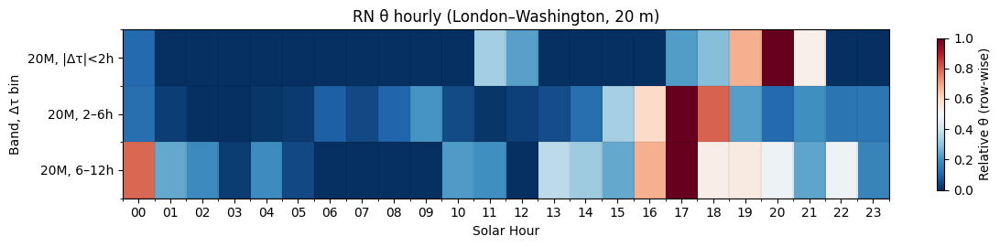

In [240]:
# import numpy as np
# import matplotlib.pyplot as plt

def _hour_bins_from_grid_t(grid_t):
    """
    Given a 1D time grid (e.g., length 96 for 15-min steps in [0,24)),
    return a list of boolean masks selecting columns for each hour [h, h+1).
    """
    hour_masks = []
    for h in range(24):
        m = (grid_t >= h) & (grid_t < h + 1)
        # Edge case: if grid includes 24.0 exactly, shove into hour 23
        if h == 23:
            m = m | (grid_t == 24)
        hour_masks.append(m)
    return hour_masks

def _row_mask_for_distance(grid_d, distance_km, window_km=None):
    """
    Return a boolean mask over distance grid rows.
    If window_km is None, picks the single nearest row.
    Otherwise selects rows within ±window_km of the target distance.
    """
    grid_d = np.asarray(grid_d, float)
    if window_km is None:
        idx = int(np.argmin(np.abs(grid_d - distance_km)))
        m = np.zeros_like(grid_d, dtype=bool)
        m[idx] = True
        return m
    else:
        return (grid_d >= (distance_km - window_km)) & (grid_d <= (distance_km + window_km))

def _hourly_means_for_theta(theta_grid, grid_t, grid_d, distance_km, window_km=None):
    """
    theta_grid: 2D array shaped (len(grid_d), len(grid_t)) for a specific (band, Δτ).
    Returns a length-24 vector of hourly means at the target distance.
    """
    row_m = _row_mask_for_distance(grid_d, distance_km, window_km)
    hour_masks = _hour_bins_from_grid_t(grid_t)
    vals = np.full(24, np.nan, dtype=float)
    # Slice once on rows
    sub = theta_grid[row_m, :]  # shape: (R, T)
    for h, m in enumerate(hour_masks):
        # average across selected rows and cols; ignore NaNs if present
        if np.any(m) and sub.size > 0:
            block = sub[:, m]
            # If block is empty after mask, keep NaN
            if block.size:
                vals[h] = np.nanmean(block)
    return vals

def _normalize_1d(x, mode="minmax"):
    """
    Normalize a 1D vector for relative coloring within its row.
    mode: "minmax" (default), "zscore", or None
    Returns normalized values plus (min, max) used for minmax.
    """
    if mode is None:
        return x, (np.nanmin(x), np.nanmax(x))
    x = np.asarray(x, float)
    if mode == "zscore":
        mu = np.nanmean(x)
        sd = np.nanstd(x)
        if sd == 0 or np.isnan(sd):
            return np.zeros_like(x), (mu, sd)
        return (x - mu) / sd, (mu, sd)
    # default: minmax
    lo = np.nanmin(x)
    hi = np.nanmax(x)
    if not np.isfinite(lo) or not np.isfinite(hi) or hi == lo:
        return np.zeros_like(x), (lo, hi)
    return (x - lo) / (hi - lo), (lo, hi)

def plot_hourly_strip_for_path(
    theta_b,
    grid_t,
    grid_d,
    bands=("20M",),
    tau_bins=("|Δτ|<2h", "2–6h", "6–12h"),
    distance_km=5891.0,
    window_km=250.0,
    normalize_row="minmax",   # "minmax", "zscore", or None
    global_norm=False,        # if True, use one color scale for all rows (ignores normalize_row)
    figsize=(12, 3.5),
    cmap="RdBu_r",            # can change, or leave default matplotlib colormap by setting None
    title=None
):
    """
    Build a matrix with one row per (band, tau_bin) and 24 columns (hours).
    Each cell is the hourly mean θ at ~distance_km.
    """
    # Collect rows
    row_labels = []
    rows = []
    for b in bands:
        for tb in tau_bins:
            key = (b, tb)
            if key not in theta_b:
                continue
            theta_grid = theta_b[key]  # shape (len(grid_d), len(grid_t))
            hourly = _hourly_means_for_theta(theta_grid, grid_t, grid_d, distance_km, window_km)
            rows.append(hourly)
            row_labels.append(f"{b}, {tb}")

    if not rows:
        raise ValueError("No matching (band, Δτ) keys found in theta_b for the requested inputs.")

    M = np.vstack(rows)  # shape: (R, 24)

    # Normalization
    if global_norm:
        # one scale across all rows
        M_plot = M.copy()
        # If you want “relative to each other” within the *path* but across all rows,
        # do a global minmax:
        finite = np.isfinite(M_plot)
        if not np.any(finite):
            M_plot[:] = 0.0
        else:
            lo = np.nanmin(M_plot[finite])
            hi = np.nanmax(M_plot[finite])
            if hi == lo:
                M_plot[finite] = 0.0
            else:
                M_plot[finite] = (M_plot[finite] - lo) / (hi - lo)
    else:
        # normalize each row independently (typical for “relative to itself” coloring)
        M_plot = np.zeros_like(M)
        for i in range(M.shape[0]):
            M_plot[i], _ = _normalize_1d(M[i], mode=normalize_row)

    # Plot
    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(M_plot, aspect="auto", interpolation="nearest")
    if cmap is not None:
        im.set_cmap(cmap)

    # Ticks/labels
    ax.set_xticks(range(24))
    ax.set_xticklabels([f"{h:02d}" for h in range(24)], rotation=0)
    ax.set_yticks(range(len(row_labels)))
    ax.set_yticklabels(row_labels)
    ax.set_xlabel("Solar Hour")
    ax.set_ylabel("Band, Δτ bin")
    if title is None:
        title = f"Hourly θ at ~{distance_km:.0f} km (window ±{window_km:.0f} km)"
    ax.set_title(title)

    cbar = plt.colorbar(im, ax=ax, shrink=0.9)
    cbar.set_label("Relative θ (row-wise)" if not global_norm else "Relative θ (global)")

    # Grid lines to mimic “24 boxes”
    ax.set_xticks(np.arange(-0.5, 24, 1), minor=True)
    ax.set_yticks(np.arange(-0.5, M_plot.shape[0], 1), minor=True)
    ax.grid(which="minor", color="k", linewidth=0.3, alpha=0.25)
    plt.tight_layout()
    return fig, ax
# Choose the band(s) and Δτ-bin(s) you want to show
bands = ("20M",)
tau_bins = ("|Δτ|<2h", "2–6h", "6–12h")

fig, ax = plot_hourly_strip_for_path(
    theta_b=theta_b,
    grid_t=grid_t,
    grid_d=grid_d,
    bands=bands,
    tau_bins=tau_bins,
    distance_km=5891.0,    # London ↔ Washington DC
    window_km=250.0,       # average a small swath around that path length
    normalize_row="minmax",# color each row relative to itself
    global_norm=False,     # set True to compare rows on one common color scale
    figsize=(12, 2.8),
    cmap="RdBu_r",
    title="RN θ hourly (London–Washington, 20 m)"
)


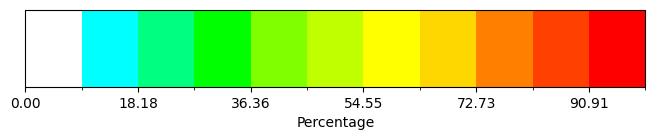

In [241]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.colorbar as mcolorbar
import numpy as np

# Define colors
colors = [
    "#FFFFFF",  # 0%  white
    "#00FFFF",  # 10% cyan
    "#00FF80",  # 20% greenish-cyan
    "#00FF00",  # 30% bright green (harlequin)
    "#80FF00",  # 40% light green
    "#BFFF00",  # 50% lime
    "#FFFF00",  # 60% yellow
    "#FFD700",  # 70% golden yellow
    "#FF8000",  # 80% orange
    "#FF4000",  # 90% strong orange-red
    "#FF0000"   # 100% red
]

# Define colormap + norm
cmap = mcolors.ListedColormap(colors)
bounds = np.linspace(0, 100, 12)  # 11 bins
norm = mcolors.BoundaryNorm(bounds, cmap.N)

# Show colorbar
fig, ax = plt.subplots(figsize=(8, 1))
cb = mcolorbar.ColorbarBase(ax, cmap=cmap, norm=norm,
                            boundaries=bounds, orientation="horizontal")
cb.set_label("Percentage")
plt.show()


[[0.12328001 0.03114481 0.00165502 0.         0.01462089 0.02162003
  0.09111648 0.0485383  0.10364472 0.2048055  0.0530608  0.01362426
  0.03390451 0.05610108 0.12446905 0.33268122 0.59569399 1.
  0.79666231 0.22351661 0.11324028 0.19246116 0.13423047 0.1368591 ]]
[0.12328001 0.03114481 0.00165502 0.         0.01462089 0.02162003
 0.09111648 0.0485383  0.10364472 0.2048055  0.0530608  0.01362426
 0.03390451 0.05610108 0.12446905 0.33268122 0.59569399 1.
 0.79666231 0.22351661 0.11324028 0.19246116 0.13423047 0.1368591 ]
0.13423046622140658 0.13685909903492535
[0.13423047 0.1368591  0.12328001 0.03114481 0.00165502 0.
 0.01462089 0.02162003 0.09111648 0.0485383  0.10364472 0.2048055
 0.0530608  0.01362426 0.03390451 0.05610108 0.12446905 0.33268122
 0.59569399 1.         0.79666231 0.22351661 0.11324028 0.19246116]


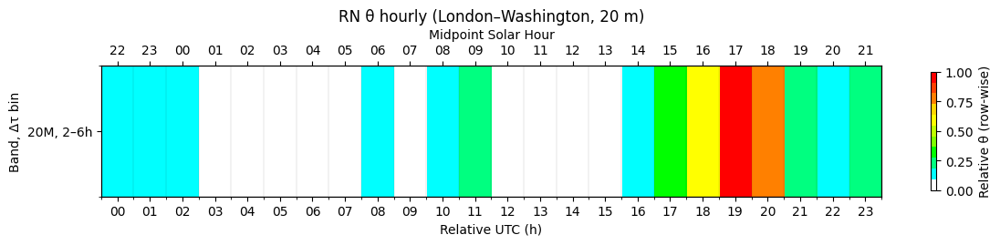

In [242]:
# import numpy as np
# import matplotlib.pyplot as plt
from matplotlib.ticker import FixedLocator

def _hour_bins_from_grid_t(grid_t):
    hour_masks = []
    for h in range(24):
        m = (grid_t >= h) & (grid_t < h + 1)
        if h == 23:
            m = m | (grid_t == 24)
        hour_masks.append(m)
    return hour_masks

def _row_mask_for_distance(grid_d, distance_km, window_km=None):
    grid_d = np.asarray(grid_d, float)
    if window_km is None:
        idx = int(np.argmin(np.abs(grid_d - distance_km)))
        m = np.zeros_like(grid_d, dtype=bool)
        m[idx] = True
        return m
    else:
        return (grid_d >= (distance_km - window_km)) & (grid_d <= (distance_km + window_km))

def _hourly_means_for_theta(theta_grid, grid_t, grid_d, distance_km, window_km=None):
    row_m = _row_mask_for_distance(grid_d, distance_km, window_km)
    hour_masks = _hour_bins_from_grid_t(grid_t)
    vals = np.full(24, np.nan, dtype=float)
    sub = theta_grid[row_m, :]  # (R, T)
    for h, m in enumerate(hour_masks):
        if np.any(m) and sub.size > 0:
            block = sub[:, m]
            if block.size:
                vals[h] = np.nanmean(block)
    return vals

def _normalize_1d(x, mode="minmax"):
    if mode is None:
        return x, (np.nanmin(x), np.nanmax(x))
    x = np.asarray(x, float)
    if mode == "zscore":
        mu = np.nanmean(x)
        sd = np.nanstd(x)
        if sd == 0 or np.isnan(sd):
            return np.zeros_like(x), (mu, sd)
        return (x - mu) / sd, (mu, sd)
    lo = np.nanmin(x); hi = np.nanmax(x)
    if not np.isfinite(lo) or not np.isfinite(hi) or hi == lo:
        return np.zeros_like(x), (lo, hi)
    return (x - lo) / (hi - lo), (lo, hi)

def _solar_to_utc(x, offset_hours):
    return (np.asarray(x, float) + offset_hours) % 24.0

def _utc_to_solar(x, offset_hours):
    return (np.asarray(x, float) - offset_hours) % 24.0

def plot_hourly_strip_for_path(
    theta_b,
    grid_t,
    grid_d,
    bands=("20M",),
    tau_bins=("|Δτ|<2h", "2–6h", "6–12h"),
    distance_km=5891.0,
    window_km=250.0,
    normalize_row="minmax",
    global_norm=False,
    figsize=(12, 3.5),
    cmap="jet",          # now just jet or turbo
    title=None,
    utc_offset=None,     # e.g. -2 for London↔Washington
    top_tick_step=2,
    number_of_bins = None
):
    row_labels, rows = [], []
    for b in bands:
        for tb in tau_bins:
            key = (b, tb)
            if key not in theta_b:
                continue
            theta_grid = theta_b[key]
            hourly = _hourly_means_for_theta(theta_grid, grid_t, grid_d, distance_km, window_km)
            rows.append(hourly); row_labels.append(f"{b}, {tb}")

    if not rows:
        raise ValueError("No matching (band, Δτ) keys found in theta_b for the requested inputs.")

    M = np.vstack(rows)

    # Normalization
    if global_norm:
        M_plot = M.copy()
        finite = np.isfinite(M_plot)
        if not np.any(finite):
            M_plot[:] = 0.0
        else:
            lo = np.nanmin(M_plot[finite]); hi = np.nanmax(M_plot[finite])
            M_plot[finite] = 0.0 if hi == lo else (M_plot[finite] - lo) / (hi - lo)
        cbar_label = "Relative θ (global)"
    else:
        M_plot = np.zeros_like(M)
        for i in range(M.shape[0]):
            M_plot[i], _ = _normalize_1d(M[i], mode=normalize_row)
        cbar_label = "Relative θ (row-wise)"
    print(M_plot)

    if number_of_bins != None:
        if number_of_bins ==1:
            temp = M_plot[0]
            print(temp)
            print(temp[-2], temp[-1])
            temp_rearr = np.concatenate((temp[-2:], temp[:-2]))
            print(temp_rearr)
            M_plot[0] = temp_rearr
    # Plot
    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(M_plot, aspect="auto", interpolation="nearest", cmap=cmap)

    ax.set_xticks(range(24))
    ax.set_xticklabels([f"{h:02d}" for h in range(24)], rotation=0)
    ax.set_yticks(range(len(row_labels)))
    ax.set_yticklabels(row_labels)
    ax.set_xlabel("Relative UTC (h)")
    ax.set_ylabel("Band, Δτ bin")
    if title is None:
        title = f"Hourly θ at ~{distance_km:.0f} km (window ±{window_km:.0f} km)"
    ax.set_title(title)

    cbar = plt.colorbar(im, ax=ax, shrink=0.9)
    cbar.set_label(cbar_label)

    ax.set_xticks(np.arange(-0.5, 24, 1), minor=True)
    ax.set_yticks(np.arange(-0.5, M_plot.shape[0], 1), minor=True)
    ax.grid(which="minor", color="k", linewidth=0.3, alpha=0.25)

    # Top UTC axis
    if utc_offset is not None:
        # Mirror bottom axis on top
        ax_top = ax.twiny()
        # Keep the same data limits and tick positions as the bottom axis
        ax_top.set_xlim(ax.get_xlim())
        bottom_ticks = ax.get_xticks()  # these are 0..23
        ax_top.xaxis.set_major_locator(FixedLocator(bottom_ticks))

        # Relabel ticks as UTC = (solar + offset) % 24
        utc_labels = [f"{int((t + utc_offset) % 24):02d}" for t in bottom_ticks]
        ax_top.set_xticklabels(utc_labels)
        ax_top.set_xlabel("Midpoint Solar Hour")

    plt.tight_layout()
    return fig, ax

# Example usage
bands = ("20M",)
tau_bins = ("|Δτ|<2h", "2–6h", "6–12h")
tau_bin = ["2–6h"]
fig, ax = plot_hourly_strip_for_path(
    theta_b=theta_b,
    grid_t=grid_t,
    grid_d=grid_d,
    bands=bands,
    tau_bins=tau_bin,
    distance_km=5891.0,
    window_km=250.0,
    normalize_row="minmax",
    global_norm=False,
    figsize=(12, 2.8),
    cmap=mcolors.ListedColormap(colors),       # or "jet"
    title="RN θ hourly (London–Washington, 20 m)",
    utc_offset=-2,      # midpoint UTC shift
    top_tick_step=2,
    number_of_bins=1
)


[[0.01326894 0.         0.00448044 0.00364412 0.00279089 0.
  0.         0.0197331  0.02665376 0.24995847 0.47528752 0.86176986
  0.84554488 1.         0.73749871 0.26638328 0.06475843 0.02150788
  0.00571924 0.00742339 0.         0.00641043 0.         0.00685076]
 [0.         0.01740304 0.         0.00999985 0.         0.
  0.00580588 0.03325335 0.0757038  0.44187249 0.54985114 0.48039669
  0.46117487 0.72906859 0.60705436 1.         0.82041708 0.26570644
  0.03212732 0.01330874 0.00154241 0.01548759 0.00964982 0.        ]
 [0.12328001 0.03114481 0.00165502 0.         0.01462089 0.02162003
  0.09111648 0.0485383  0.10364472 0.2048055  0.0530608  0.01362426
  0.03390451 0.05610108 0.12446905 0.33268122 0.59569399 1.
  0.79666231 0.22351661 0.11324028 0.19246116 0.13423047 0.1368591 ]
 [0.60095186 0.64230685 0.46319596 0.34865589 0.3137996  0.47223819
  0.07446683 0.00752318 0.00106683 0.         0.00978447 0.
  0.         0.         0.         0.         0.         0.0538749
  0.326143

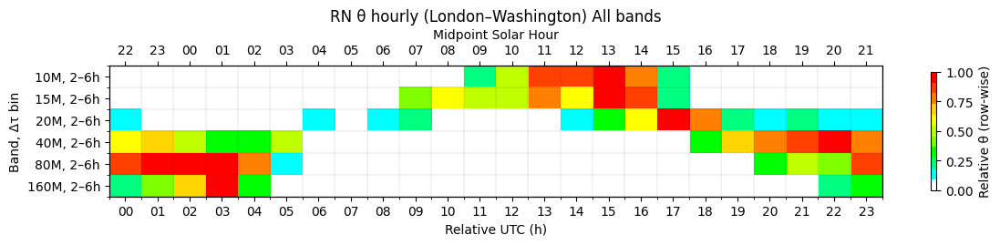

In [243]:

# Example usage
bands = bands_order
tau_bins = ("|Δτ|<2h", "2–6h", "6–12h")
tau_bin = ["2–6h"]
fig, ax = plot_hourly_strip_for_path(
    theta_b=theta_b,
    grid_t=grid_t,
    grid_d=grid_d,
    bands=bands,
    tau_bins=tau_bin,
    distance_km=5891.0,
    window_km=250.0,
    normalize_row="minmax",
    global_norm=False,
    figsize=(12, 2.8),
    cmap=mcolors.ListedColormap(colors),       # or "jet"
    title="RN θ hourly (London–Washington) All bands",
    utc_offset=-2,      # midpoint UTC shift
    top_tick_step=2,
    number_of_bins=1
)



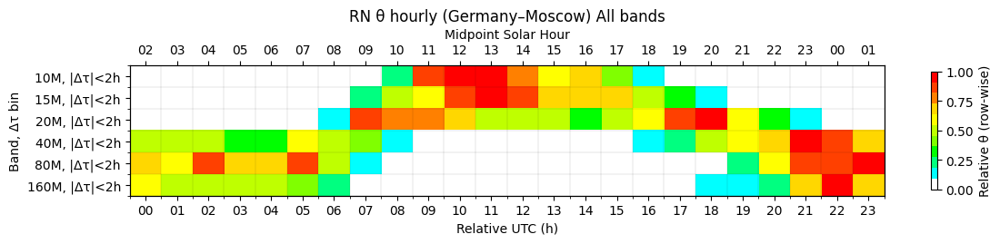

In [244]:
def plot_hourly_strip_for_path(
    theta_b,
    grid_t,
    grid_d,
    bands=("20M",),
    tau_bins=("|Δτ|<2h", "2–6h", "6–12h"),
    distance_km=5891.0,
    window_km=250.0,
    normalize_row="minmax",
    global_norm=False,
    figsize=(12, 3.5),
    cmap="jet",          # now just jet or turbo
    title=None,
    utc_offset=None,     # e.g. -2 for London↔Washington
    top_tick_step=2,
    number_of_bins = None
):
    row_labels, rows = [], []
    for b in bands:
        for tb in tau_bins:
            key = (b, tb)
            if key not in theta_b:
                continue
            theta_grid = theta_b[key]
            hourly = _hourly_means_for_theta(theta_grid, grid_t, grid_d, distance_km, window_km)
            rows.append(hourly); row_labels.append(f"{b}, {tb}")

    if not rows:
        raise ValueError("No matching (band, Δτ) keys found in theta_b for the requested inputs.")

    M = np.vstack(rows)

    # Normalization
    if global_norm:
        M_plot = M.copy()
        finite = np.isfinite(M_plot)
        if not np.any(finite):
            M_plot[:] = 0.0
        else:
            lo = np.nanmin(M_plot[finite]); hi = np.nanmax(M_plot[finite])
            M_plot[finite] = 0.0 if hi == lo else (M_plot[finite] - lo) / (hi - lo)
        cbar_label = "Relative θ (global)"
    else:
        M_plot = np.zeros_like(M)
        for i in range(M.shape[0]):
            M_plot[i], _ = _normalize_1d(M[i], mode=normalize_row)
        cbar_label = "Relative θ (row-wise)"
    # print(M_plot)

    # if number_of_bins != None:
    #     if number_of_bins ==1:
    #         temp = M_plot[0]
    #         print(temp)
    #         print(temp[-2], temp[-1])
    #         temp_rearr = np.concatenate((temp[2:], temp[:2]))
    #         print(temp_rearr)
    #         M_plot[0] = temp_rearr
    # Plot
    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(M_plot, aspect="auto", interpolation="nearest", cmap=cmap)

    ax.set_xticks(range(24))
    ax.set_xticklabels([f"{h:02d}" for h in range(24)], rotation=0)
    ax.set_yticks(range(len(row_labels)))
    ax.set_yticklabels(row_labels)
    ax.set_xlabel("Relative UTC (h)")
    ax.set_ylabel("Band, Δτ bin")
    if title is None:
        title = f"Hourly θ at ~{distance_km:.0f} km (window ±{window_km:.0f} km)"
    ax.set_title(title)

    cbar = plt.colorbar(im, ax=ax, shrink=0.9)
    cbar.set_label(cbar_label)

    ax.set_xticks(np.arange(-0.5, 24, 1), minor=True)
    ax.set_yticks(np.arange(-0.5, M_plot.shape[0], 1), minor=True)
    ax.grid(which="minor", color="k", linewidth=0.3, alpha=0.25)

    # Top UTC axis
    if utc_offset is not None:
        # Mirror bottom axis on top
        ax_top = ax.twiny()
        # Keep the same data limits and tick positions as the bottom axis
        ax_top.set_xlim(ax.get_xlim())
        bottom_ticks = ax.get_xticks()  # these are 0..23
        ax_top.xaxis.set_major_locator(FixedLocator(bottom_ticks))

        # Relabel ticks as UTC = (solar + offset) % 24
        utc_labels = [f"{int((t + utc_offset) % 24):02d}" for t in bottom_ticks]
        ax_top.set_xticklabels(utc_labels)
        ax_top.set_xlabel("Midpoint Solar Hour")

    plt.tight_layout()
    return fig, ax

# Example usage
bands = bands_order
tau_bins = ("|Δτ|<2h", "2–6h", "6–12h")
tau_bin = ["|Δτ|<2h"]
fig, ax = plot_hourly_strip_for_path(
    theta_b=theta_b,
    grid_t=grid_t,
    grid_d=grid_d,
    bands=bands,
    tau_bins=tau_bin,
    distance_km=2150.0,
    window_km=250.0,
    normalize_row="minmax",
    global_norm=False,
    figsize=(12, 2.8),
    cmap=mcolors.ListedColormap(colors),       # or "jet"
    title="RN θ hourly (Germany–Moscow) All bands",
    utc_offset=2,      # midpoint UTC shift
    top_tick_step=2,
    number_of_bins=1
)


In [245]:
# import numpy as np
# import matplotlib.pyplot as plt
# from matplotlib.ticker import FixedLocator

def _circular_shift_columns(M, shift_hours):
    """
    Circularly shift columns to the RIGHT by shift_hours.
    If shift_hours is fractional, do a linear interpolation between
    the integer shift k and k+1 (still rightward).
    """
    if shift_hours is None or shift_hours == 0:
        return M

    k = int(np.floor(shift_hours))
    frac = float(shift_hours - k)

    Mk = np.roll(M, shift=k, axis=1)              # integer part
    if frac == 0.0:
        return Mk

    Mk1 = np.roll(Mk, shift=1, axis=1)            # one more to the right
    return (1.0 - frac) * Mk + frac * Mk1

def plot_hourly_strip_for_path(
    theta_b,
    grid_t,
    grid_d,
    bands=("20M",),
    tau_bins=("|Δτ|<2h", "2–6h", "6–12h"),
    distance_km=5891.0,
    window_km=250.0,
    normalize_row="minmax",
    global_norm=False,
    figsize=(12, 3.5),
    cmap="jet",              # or "turbo"
    title=None,
    utc_offset=0,            # +2 means UTC is 2h AHEAD of solar (UTC = solar + 2)
    top_tick_step=2,
    number_of_bins=None
):
    """
    Bottom axis = UTC hours (0..23). Top axis = midpoint solar hours.
    We first compute hourly θ on solar hours, then circularly shift columns
    by +utc_offset so that column u now shows UTC hour u.
    """
    row_labels, rows = [], []


    for b in bands:
        for tb in tau_bins:
            key = (b, tb)
            if key not in theta_b:
                continue
            theta_grid = theta_b[key]
            hourly = _hourly_means_for_theta(theta_grid, grid_t, grid_d, distance_km, window_km)
            rows.append(hourly); row_labels.append(f"{b}, {tb}")

    if not rows:
        raise ValueError("No matching (band, Δτ) keys found in theta_b for the requested inputs.")

    M = np.vstack(rows)  # shape (R, 24) — indexed by SOLAR hour initially

    # Normalize (row-wise or global)
    if global_norm:
        M_plot = M.copy()
        finite = np.isfinite(M_plot)
        if not np.any(finite):
            M_plot[:] = 0.0
        else:
            lo = np.nanmin(M_plot[finite]); hi = np.nanmax(M_plot[finite])
            M_plot[finite] = 0.0 if hi == lo else (M_plot[finite] - lo) / (hi - lo)
        cbar_label = "Relative θ (global)"
    else:
        M_plot = np.zeros_like(M)
        for i in range(M.shape[0]):
            M_plot[i], _ = _normalize_1d(M[i], mode=normalize_row)
        cbar_label = "Relative θ (row-wise)"

    # Align boxes to UTC on the BOTTOM axis:
    # We computed columns for SOLAR hours j. Since UTC = SOLAR + utc_offset,
    # the value for UTC=u should come from SOLAR=(u - utc_offset), which is
    # achieved by shifting columns RIGHT by +utc_offset.
    M_plot = _circular_shift_columns(M_plot, utc_offset)

    # Plot
    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(M_plot, aspect="auto", interpolation="nearest", cmap=cmap)

    # Bottom = UTC
    ax.set_xticks(range(24))
    ax.set_xticklabels([f"{(h+1):02d}" for h in range(24)], rotation=0)
    ax.set_xlabel("Relative UTC (h)")

    ax.set_yticks(range(len(row_labels)))
    ax.set_yticklabels(row_labels)
    ax.set_ylabel("Band, Δτ bin")

    if title is None:
        title = f"Hourly θ at ~{distance_km:.0f} km (window ±{window_km:.0f} km)"
    ax.set_title(title)

    cbar = plt.colorbar(im, ax=ax, shrink=0.9)
    cbar.set_label(cbar_label)

    # Grid lines for 24 boxes
    ax.set_xticks(np.arange(-0.5, 24, 1), minor=True)
    ax.set_yticks(np.arange(-0.5, M_plot.shape[0], 1), minor=True)
    ax.grid(which="minor", color="k", linewidth=0.3, alpha=0.25)

    # Top = midpoint solar hour labels (mirror ticks, relabel with UTC→Solar mapping)
    ax_top = ax.twiny()
    ax_top.set_xlim(ax.get_xlim())
    bottom_ticks = ax.get_xticks()
    ax_top.xaxis.set_major_locator(FixedLocator(bottom_ticks))
    # SOLAR = (UTC - utc_offset) mod 24
    solar_labels = [f"{int((t - utc_offset) % 24 + 1):02d}" for t in bottom_ticks]
    ax_top.set_xticklabels(solar_labels)
    ax_top.set_xlabel("Midpoint Solar Hour")

    plt.tight_layout()
    return fig, ax


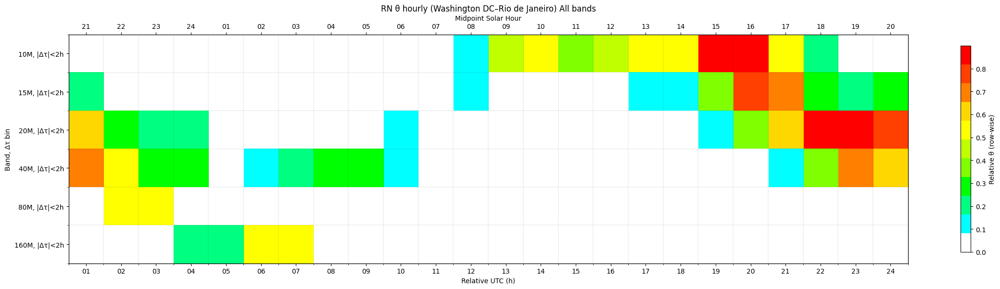

In [246]:
# Example usage
bands = bands_order
tau_bins = ("|Δτ|<2h", "2–6h", "6–12h")
tau_bin = ["|Δτ|<2h"]
fig, ax = plot_hourly_strip_for_path(
    theta_b=theta_b,
    grid_t=grid_t,
    grid_d=grid_d,
    bands=bands,
    tau_bins=tau_bin,
    distance_km=7653.0,
    window_km=250.0,
    normalize_row="minmax",
    global_norm=False,
    figsize=(5.36*4 + 2, 3.06*2),
    cmap=mcolors.ListedColormap(colors),       # or "jet"
    title="RN θ hourly (Washington DC–Rio de Janeiro) All bands",
    utc_offset=+3.5,      # midpoint UTC shift
    top_tick_step=2,
    number_of_bins=1
)


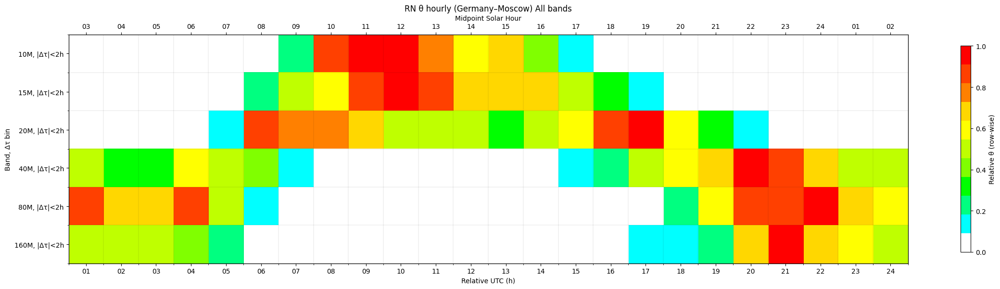

In [247]:
# Example usage
bands = bands_order
tau_bins = ("|Δτ|<2h", "2–6h", "6–12h")
tau_bin = ["|Δτ|<2h"]
fig, ax = plot_hourly_strip_for_path(
    theta_b=theta_b,
    grid_t=grid_t,
    grid_d=grid_d,
    bands=bands,
    tau_bins=tau_bin,
    distance_km=2150.0,
    window_km=250.0,
    normalize_row="minmax",
    global_norm=False,
    figsize=(5.36*4 + 2, 3.06*2),
    cmap=mcolors.ListedColormap(colors),       # or "jet"
    title="RN θ hourly (Germany–Moscow) All bands",
    utc_offset=-2,      # midpoint UTC shift
    top_tick_step=2,
    number_of_bins=1
)


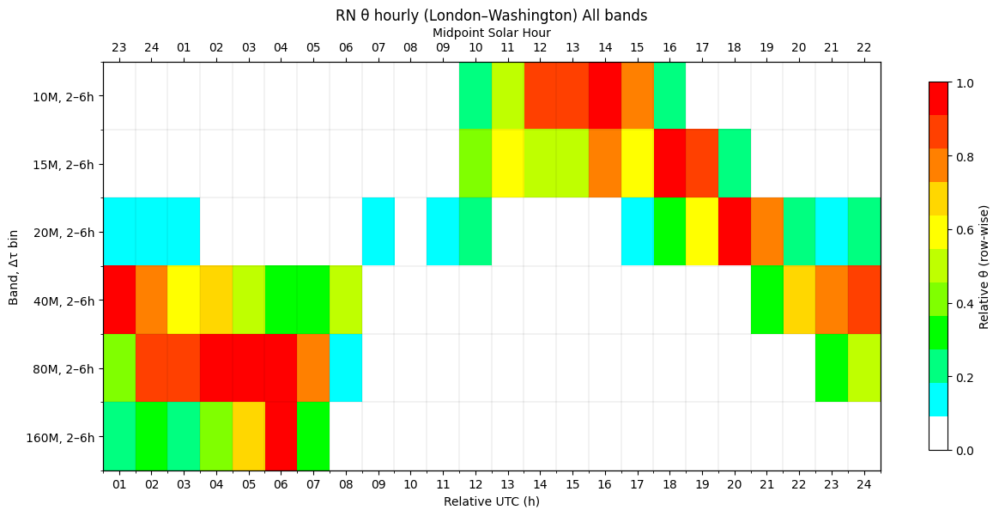

In [248]:
# Example usage
bands = bands_order
tau_bins = ("|Δτ|<2h", "2–6h", "6–12h")
tau_bin = ["2–6h"]
fig, ax = plot_hourly_strip_for_path(
    theta_b=theta_b,
    grid_t=grid_t,
    grid_d=grid_d,
    bands=bands,
    tau_bins=tau_bin,
    distance_km=5891.0,
    window_km=250.0,
    normalize_row="minmax",
    global_norm=False,
    figsize=(5.36*2 + 2, 3.06*2),
    cmap=mcolors.ListedColormap(colors),       # or "jet"
    title="RN θ hourly (London–Washington) All bands",
    utc_offset=+2,      # midpoint UTC shift
    top_tick_step=2,
    number_of_bins=1
)



In [249]:
colors = [
    "#FFFFFF",  # 0%  white
    "#00FFFF",  # 10% cyan
    "#00FF80",  # 20% greenish-cyan
    "#00FF00",  # 30% bright green (harlequin)
    "#80FF00",  # 40% light green
    "#BFFF00",  # 50% lime
    "#FFFF00",  # 60% yellow
    "#FFD700",  # 70% golden yellow
    "#FF8000",  # 80% orange
    "#FF4000",  # 90% strong orange-red
    "#FF0000"   # 100% red
]


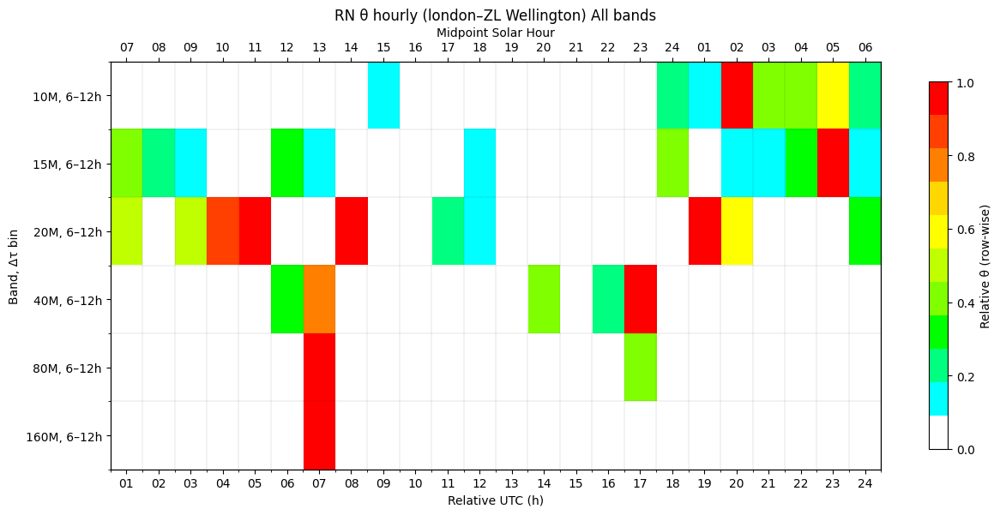

In [250]:


# Example usage
bands = bands_order
tau_bins = ("|Δτ|<2h", "2–6h", "6–12h")
tau_bin = ["6–12h"]
fig, ax = plot_hourly_strip_for_path(
    theta_b=theta_b,
    grid_t=grid_t,
    grid_d=grid_d,
    bands=bands,
    tau_bins=tau_bin,
    distance_km=18809.0,
    window_km=250.0,
    normalize_row="minmax",
    global_norm=False,
    figsize=(5.36*2 + 2, 3.06*2),
    cmap=mcolors.ListedColormap(colors),       # or "jet"
    title="RN θ hourly (london–ZL Wellington) All bands",
    utc_offset=-6,      # midpoint UTC shift
    top_tick_step=2,
    number_of_bins=1
)

       sent_call rcvd_call           pairs band               slice  Y  \
30         LY2XW     VE9WH  (LY2XW, VE9WH)  10M 2024-11-23 15:15:00  1   
38          K9RS      PC6R    (K9RS, PC6R)  10M 2024-11-23 15:30:00  1   
150         CF2I     LY2SA   (CF2I, LY2SA)  10M 2024-11-23 14:15:00  1   
246         K6XX      NP3A    (K6XX, NP3A)  10M 2024-11-24 20:45:00  1   
255         K3WW    PA3HEN  (K3WW, PA3HEN)  10M 2024-11-23 13:30:00  1   
...          ...       ...             ...  ...                 ... ..   
119889      K9YC      KP2B    (K9YC, KP2B)  80M 2024-11-23 05:45:00  1   
119916       G6T      WY3A     (G6T, WY3A)  80M 2024-11-23 03:15:00  1   
119917      DM2M      K7GM    (DM2M, K7GM)  80M 2024-11-24 00:15:00  1   
119926      DP6A      NM2A    (DP6A, NM2A)  80M 2024-11-24 02:00:00  1   
119934      CF2I     OM5JA   (CF2I, OM5JA)  80M 2024-11-23 02:15:00  1   

       CALLSIGN CATEGORY-POWER CATEGORY-OPERATOR CATEGORY-ASSISTED  ...  \
30        LY2XW           HIGH      

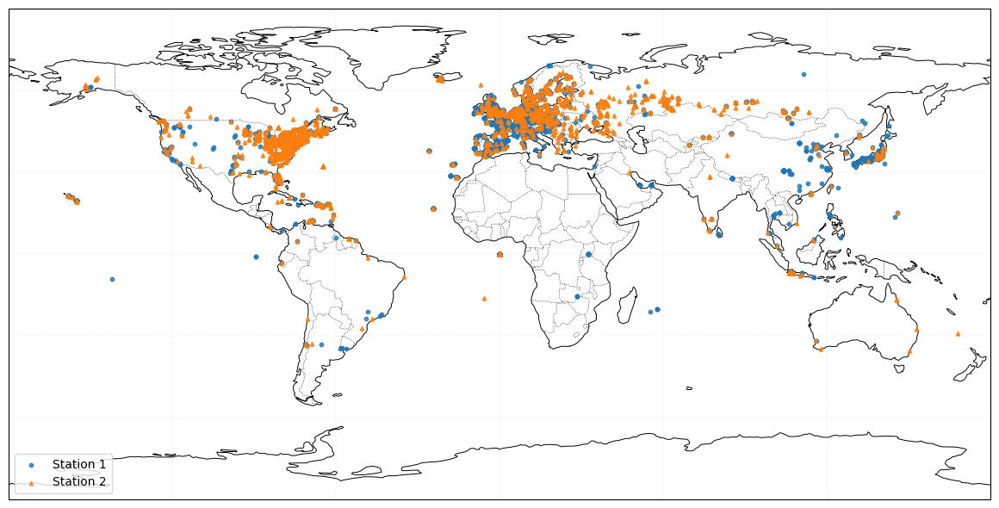

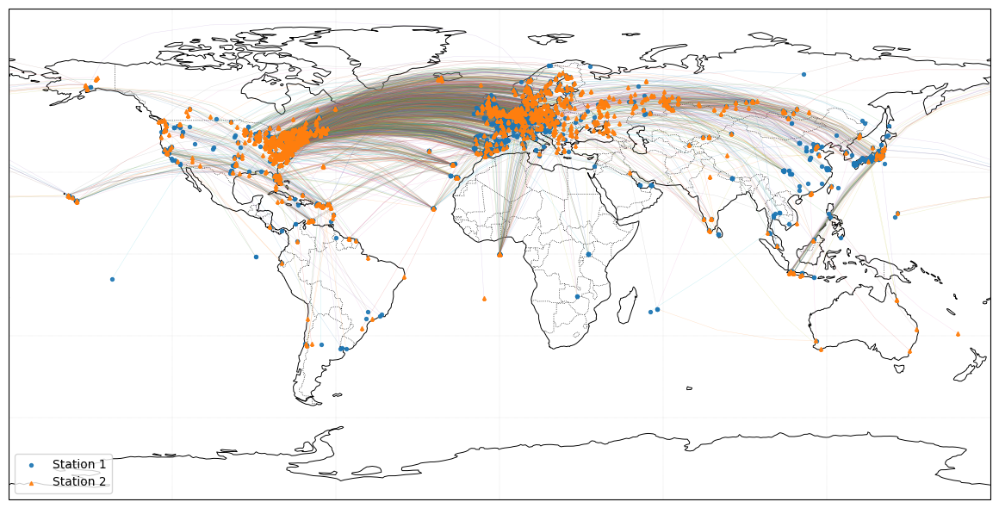

In [262]:
qso_sampled_US_UK = qso_sampled[(qso_sampled['distance'] <= 5891+250) & (qso_sampled['distance'] >= 5891-250)]
print(qso_sampled_US_UK)
# plot all callsigns in qso_sampled_US_UK on map


len(qso_sampled)
# # plot histogram of distance in qso_sampled
# plt.figure(figsize=(10, 6))
# plt.hist(qso_sampled['distance'], bins=50, color='blue', alpha=0.7)
# plt.title('Histogram of Distances in Sampled QSOs')
# plt.xlabel('Distance (km)')
# plt.ylabel('Frequency')
# plt.grid(True)
# plt.show()


# # plot histogram of distance in qso_sampled_US_UK
# plt.figure(figsize=(10, 6))
# plt.hist(qso_sampled_US_UK['distance'], bins=50, color='blue', alpha=0.7)
# plt.title('Histogram of Distances in Sampled QSOs (US-UK Focus)')
# plt.xlabel('Distance (km)')
# plt.ylabel('Frequency')
# plt.grid(True)
# plt.show()

cols = ['lat_1','lon_1','lat_2','lon_2']
df = qso_sampled_US_UK.loc[~qso_sampled_US_UK[cols].isna().any(axis=1)].copy()

fig = plt.figure(figsize=(12,6))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_global()
ax.add_feature(cfeature.COASTLINE, linewidth=0.7)
ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=0.5)
ax.gridlines(draw_labels=False, linewidth=0.25, linestyle=':')

# Plot station 1 (e.g., sender) and station 2 (e.g., receiver)
ax.scatter(df['lon_1'], df['lat_1'],
           s=10, alpha=0.8, transform=ccrs.PlateCarree(),
           label='Station 1', zorder=3)

ax.scatter(df['lon_2'], df['lat_2'],
           s=10, alpha=0.8, marker='^', transform=ccrs.PlateCarree(),
           label='Station 2', zorder=3)

ax.legend(loc='lower left', frameon=True)
plt.tight_layout()
plt.show()


import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Keep rows with all four coordinates present
cols = ['lat_1','lon_1','lat_2','lon_2']
df = qso_sampled_US_UK.loc[~qso_sampled_US_UK[cols].isna().any(axis=1)].copy()

fig = plt.figure(figsize=(12,6))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_global()
ax.add_feature(cfeature.COASTLINE, linewidth=0.7)
ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=0.5)
ax.gridlines(draw_labels=False, linewidth=0.25, linestyle=':')

# Plot endpoints
ax.scatter(df['lon_1'], df['lat_1'], s=8, alpha=0.9,
           transform=ccrs.PlateCarree(), label='Station 1', zorder=3)
ax.scatter(df['lon_2'], df['lat_2'], s=8, alpha=0.9, marker='^',
           transform=ccrs.PlateCarree(), label='Station 2', zorder=3)

# Draw great-circle paths between each pair
# (transform=ccrs.Geodetic() tells Cartopy to interpolate along a great circle)
for r in df.itertuples(index=False):
    ax.plot([r.lon_1, r.lon_2], [r.lat_1, r.lat_2],
            transform=ccrs.Geodetic(),
            linewidth=0.3, alpha=0.25, zorder=2)

ax.legend(loc='lower left', frameon=True)
plt.tight_layout()
plt.show()


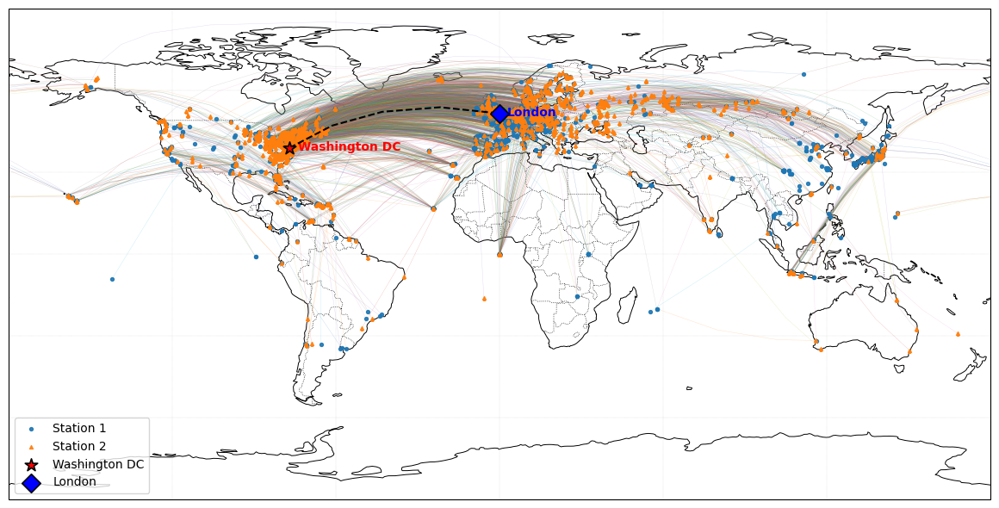

In [266]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Keep rows with all four coordinates present
cols = ['lat_1','lon_1','lat_2','lon_2']
df = qso_sampled_US_UK.loc[~qso_sampled_US_UK[cols].isna().any(axis=1)].copy()

fig = plt.figure(figsize=(12,6))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_global()
ax.add_feature(cfeature.COASTLINE, linewidth=0.7)
ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=0.5)
ax.gridlines(draw_labels=False, linewidth=0.25, linestyle=':')

# Plot endpoints
ax.scatter(df['lon_1'], df['lat_1'], s=8, alpha=0.9,
           transform=ccrs.PlateCarree(), label='Station 1', zorder=3)
ax.scatter(df['lon_2'], df['lat_2'], s=8, alpha=0.9, marker='^',
           transform=ccrs.PlateCarree(), label='Station 2', zorder=3)

# Draw great-circle paths between each pair
for r in df.itertuples(index=False):
    ax.plot([r.lon_1, r.lon_2], [r.lat_1, r.lat_2],
            transform=ccrs.Geodetic(),
            linewidth=0.3, alpha=0.25, zorder=2)


# Washington DC and London coordinates
washington = (38.9072, -77.0369)  # lat, lon
london = (51.5074, -0.1278)       # lat, lon

# Plot them with larger, unique markers
ax.scatter(washington[1], washington[0], color='red', s=120, marker='*',
           edgecolor='black', linewidth=1.2,
           transform=ccrs.PlateCarree(), label='Washington DC', zorder=5)

ax.scatter(london[1], london[0], color='blue', s=120, marker='D',
           edgecolor='black', linewidth=1.2,
           transform=ccrs.PlateCarree(), label='London', zorder=5)

# Add text labels offset slightly
ax.text(washington[1]+3, washington[0]-1, "Washington DC",
        transform=ccrs.PlateCarree(), fontsize=10, fontweight='bold', color='red')
ax.text(london[1]+3, london[0]-1, "London",
        transform=ccrs.PlateCarree(), fontsize=10, fontweight='bold', color='blue')

# Draw bold great-circle path between London and Washington
ax.plot([washington[1], london[1]], [washington[0], london[0]],
        transform=ccrs.Geodetic(),
        color='black', linewidth=1.5, linestyle='--', zorder=4)

ax.legend(loc='lower left', frameon=True)
plt.tight_layout()
plt.show()


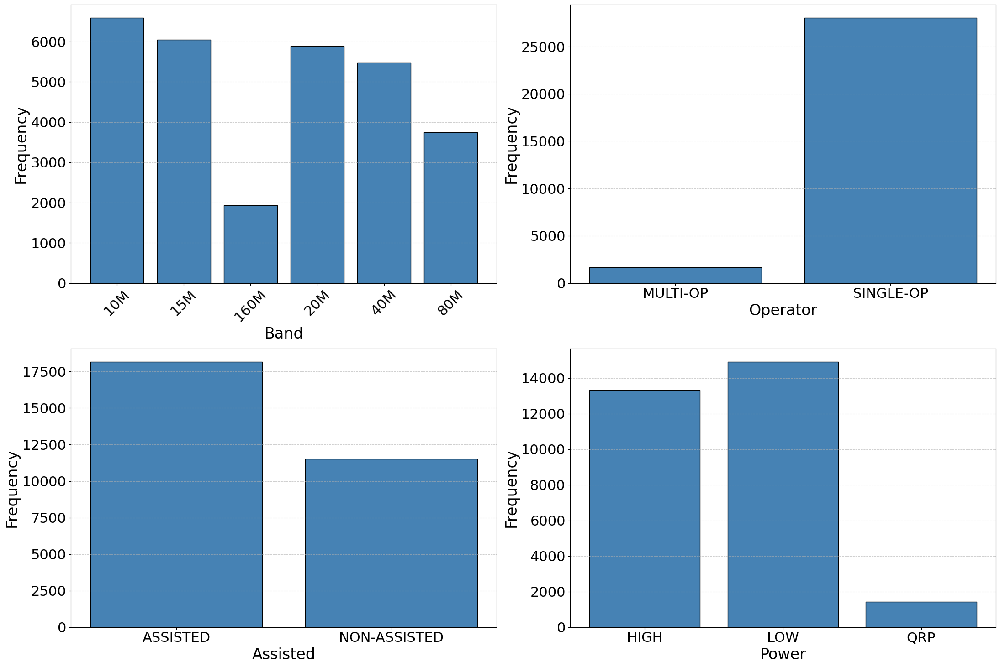

In [252]:

import matplotlib.pyplot as plt

fig, axes = plt.subplots(2, 2, figsize=(22, 16), sharey=False)

# Common settings
label_fontsize = 24
tick_fontsize = 22
title_fontsize = 20
bar_color = "steelblue"   # neutral academic tone

# Bar chart: CATEGORY-BAND
band_counts = clean_station_band_counts['band'].value_counts().sort_index()
axes[0, 0].bar(band_counts.index, band_counts.values, edgecolor='black', color=bar_color)
axes[0, 0].set_xlabel('Band', fontsize=label_fontsize)
axes[0, 0].set_ylabel('Frequency', fontsize=label_fontsize)
axes[0, 0].tick_params(axis='x', labelsize=tick_fontsize, rotation=45)
axes[0, 0].tick_params(axis='y', labelsize=tick_fontsize)
# axes[0, 0].set_title('Distribution by Band', fontsize=title_fontsize)
axes[0, 0].grid(axis='y', linestyle='--', alpha=0.6)

# Bar chart: CATEGORY-OPERATOR
operator_counts = clean_station_band_counts['operator'].value_counts().sort_index()
axes[0, 1].bar(operator_counts.index, operator_counts.values, edgecolor='black', color=bar_color)
axes[0, 1].set_xlabel('Operator', fontsize=label_fontsize)
axes[0, 1].set_ylabel('Frequency', fontsize=label_fontsize)
axes[0, 1].tick_params(axis='x', labelsize=tick_fontsize)
axes[0, 1].tick_params(axis='y', labelsize=tick_fontsize)
# axes[0, 1].set_title('Operator Category', fontsize=title_fontsize)
axes[0, 1].grid(axis='y', linestyle='--', alpha=0.6)

# Bar chart: CATEGORY-ASSISTED
assisted_counts = clean_station_band_counts['assisted'].value_counts().sort_index()
axes[1, 0].bar(assisted_counts.index, assisted_counts.values, edgecolor='black', color=bar_color)
axes[1, 0].set_xlabel('Assisted', fontsize=label_fontsize)
axes[1, 0].set_ylabel('Frequency', fontsize=label_fontsize)
axes[1, 0].tick_params(axis='x', labelsize=tick_fontsize)
axes[1, 0].tick_params(axis='y', labelsize=tick_fontsize)
# axes[1, 0].set_title('Assisted vs Non-Assisted', fontsize=title_fontsize)
axes[1, 0].grid(axis='y', linestyle='--', alpha=0.6)

# Bar chart: CATEGORY-POWER
power_counts = clean_station_band_counts['power'].value_counts().sort_index()
axes[1, 1].bar(power_counts.index, power_counts.values, edgecolor='black', color=bar_color)
axes[1, 1].set_xlabel('Power', fontsize=label_fontsize)
axes[1, 1].set_ylabel('Frequency', fontsize=label_fontsize)
axes[1, 1].tick_params(axis='x', labelsize=tick_fontsize)
axes[1, 1].tick_params(axis='y', labelsize=tick_fontsize)
# axes[1, 1].set_title('Power Levels', fontsize=title_fontsize)
axes[1, 1].grid(axis='y', linestyle='--', alpha=0.6)

# # Bar chart: CATEGORY-TRANSMITTER
# transmitter_counts = clean_station_band_counts['transmitter'].value_counts().sort_index()
# axes[1, 1].bar(transmitter_counts.index, transmitter_counts.values, edgecolor='black', color=bar_color)
# axes[1, 1].set_xlabel('Transmitter', fontsize=label_fontsize)
# axes[1, 1].set_ylabel('Frequency', fontsize=label_fontsize)
# axes[1, 1].tick_params(axis='x', labelsize=tick_fontsize, rotation=20)
# axes[1, 1].tick_params(axis='y', labelsize=tick_fontsize)
# axes[1, 1].set_title('Transmitter Usage', fontsize=title_fontsize)
# axes[1, 1].grid(axis='y', linestyle='--', alpha=0.6)

# Hide unused subplot
# fig.delaxes(axes[1, 2])

# Super title
# fig.suptitle('Participant Frequency under Selected Categories', fontsize=26, weight='bold')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

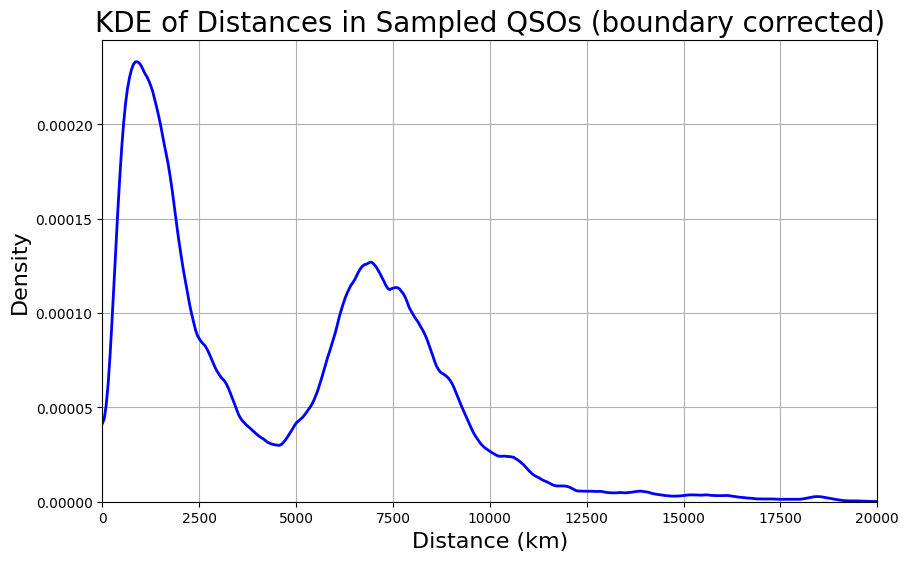

In [253]:
def calculate_bandwidth(data):
    return 3.5 * data.std() * (len(data) ** (-1/3))
bandwidth_d = calculate_bandwidth(qso_sampled['distance'])
dens = kde1d_epan_reflect(
    qso_sampled['distance'],
    grid=grid_d,
    h=bandwidth_d,
    
    a = 0.0,
    b = 20000
)
# plot distance kde distribution on grid_d

plt.figure(figsize=(10, 6))
plt.plot(grid_d, dens, color='blue', lw=2) 
plt.title('KDE of Distances in Sampled QSOs (boundary corrected)', fontsize=20)
plt.xlabel('Distance (km)', fontsize=16)
plt.ylabel('Density', fontsize=16)
plt.grid(True)
plt.xlim(0, 20000)
plt.ylim(0, None)
plt.show()


In [255]:
# import pandas as pd
# import numpy as np
import re

# --- helpers ---------------------------------------------------------------
def _norm_tx(x):
    """Uppercase, trim, unify hyphens; return '' for NaN."""
    s = '' if pd.isna(x) else str(x).strip().upper()
    s = re.sub(r'[\u2010-\u2015\-]+', '-', s)  # unify hyphens
    return s

def _is_multi_tx_value(x):
    """
    True if transmitter field indicates more than ONE.
    Matches: 'TWO', 'UNLIMITED', '2', '3', 'TWO-TRANSMITTER', etc.
    """
    s = _norm_tx(x)
    if s in ('', 'ONE', 'SINGLE', '1'):
        return False
    # numeric code like '2' or '3'
    m = re.search(r'\d+', s)
    if m is not None and int(m.group()) > 1:
        return True
    # textual codes
    return s.startswith('TWO') or s.startswith('UNLIMITED') or s.startswith('UNLIM')

# --- flag multi-transmitter QSOs (either endpoint) ------------------------
df = pos.copy()
df['band'] = df['band'].astype(str).str.strip().str.upper()

mtx_left  = df['CATEGORY-TRANSMITTER'].apply(_is_multi_tx_value)
mtx_right = df['CATEGORY-TRANSMITTER_RX'].apply(_is_multi_tx_value)
df['is_multi_tx'] = mtx_left | mtx_right

# --- aggregate to Table 4.1 -----------------------------------------------
band_order = ['10M','15M','20M','40M','80M','160M']
summary = (df.groupby('band', dropna=False)
             .agg(**{
                 'QSOs (all)': ('band','size'),
                 'QSOs multi transmitter': ('is_multi_tx','sum')
             })
             .assign(**{
                 'Share (%)': lambda t: 100 * t['QSOs multi transmitter'] / t['QSOs (all)']
             })
             .reindex(band_order)
          )

# optional: drop bands with all-NaN rows (if any missing in your data)
summary = summary.dropna(how='all')

# --- pretty print & LaTeX --------------------------------------------------
# formatted copy for LaTeX (thousand separators, 1 decimal share)
fmt = summary.copy()
fmt['QSOs (all)'] = fmt['QSOs (all)'].map('{:,}'.format)
fmt['QSOs multi transmitter'] = fmt['QSOs multi transmitter'].map('{:,}'.format)
fmt['Share (%)'] = fmt['Share (%)'].map(lambda x: f'{x:.1f}')

# LaTeX table (booktabs, same cols you showed)
latex = (
    '\\begin{table}[h]\n'
    '\\centering\n'
    '\\caption{QSOs from multi transmitter operation by band. Counts and shares relative to all QSOs on the band.}\n'
    '\\label{tab:tx-summary}\n'
    '\\begin{tabular}{@{}lrrr@{}}\\toprule\n'
    'Band & QSOs (all) & QSOs multi transmitter & Share (\\%) \\\\\\midrule\n' +
    '\n'.join(f'{idx} & {row["QSOs (all)"]} & {row["QSOs multi transmitter"]} & {row["Share (%)"]}'
             for idx, row in fmt.iterrows()) +
    '\\\\\n\\bottomrule\n\\end{tabular}\n\\end{table}\n'
)
print(latex)

# --- if you want to filter multi-transmitter QSOs out for the rest of EDA --
pos_no_multi_tx = df.loc[~df['is_multi_tx']].copy()


\begin{table}[h]
\centering
\caption{QSOs from multi transmitter operation by band. Counts and shares relative to all QSOs on the band.}
\label{tab:tx-summary}
\begin{tabular}{@{}lrrr@{}}\toprule
Band & QSOs (all) & QSOs multi transmitter & Share (\%) \\\midrule
10M & 762,531 & 124,885 & 16.4
15M & 584,014 & 128,027 & 21.9
20M & 510,002 & 124,763 & 24.5
40M & 478,341 & 117,226 & 24.5
80M & 206,104 & 54,745 & 26.6
160M & 50,634 & 16,945 & 33.5\\
\bottomrule
\end{tabular}
\end{table}



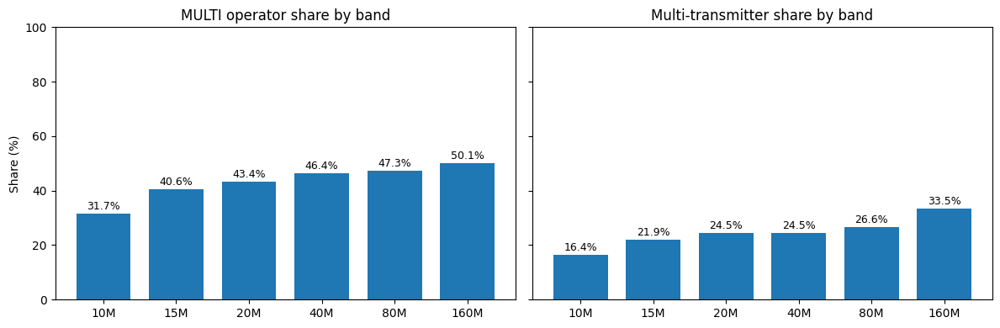

In [256]:
# import os
# import re
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt

# --- helpers ---------------------------------------------------------------
def is_multi_tx_series(s):
    """Vectorised flag: transmitter field indicates more than ONE."""
    s = s.fillna('').astype(str).str.strip().str.upper()
    s = s.str.replace(r'[\u2010-\u2015\-]+', '-', regex=True)
    # numeric tokens like '2', '3', 'TX-2'
    num = pd.to_numeric(s.str.extract(r'(\d+)')[0], errors='coerce')
    numeric_multi = num > 1
    # textual markers
    text_multi = s.str.contains(r'\bTWO\b|\bUNLIMITED\b|\bUNLIM', regex=True)
    # explicit oneish values
    oneish = s.isin(['', 'ONE', 'SINGLE', '1'])
    return numeric_multi.fillna(False) | (text_multi & ~oneish)

# --- prepare flags ---------------------------------------------------------
df = pos.copy()
df['band'] = df['band'].astype(str).str.strip().str.upper()

# MULTI operator if either endpoint category contains 'MULTI'
op_multi_left  = df['CATEGORY-OPERATOR'].fillna('').str.upper().str.contains('MULTI')
op_multi_right = df['CATEGORY-OPERATOR_RX'].fillna('').str.upper().str.contains('MULTI')
df['is_multi_op'] = op_multi_left | op_multi_right

# Multi-transmitter if either endpoint indicates > ONE transmitter
mtx_left  = is_multi_tx_series(df['CATEGORY-TRANSMITTER'])
mtx_right = is_multi_tx_series(df['CATEGORY-TRANSMITTER_RX'])
df['is_multi_tx'] = mtx_left | mtx_right

# Band order (fallback to sorted unique if your global 'bands_order' is missing)
band_order = ['10M','15M','20M','40M','80M','160M']
present = [b for b in band_order if b in df['band'].unique()]
if not present:
    present = sorted(df['band'].dropna().unique())

# Summaries
summary = (df.groupby('band')
             .agg(qsos=('band','size'),
                  qsos_multi_op=('is_multi_op','sum'),
                  qsos_multi_tx=('is_multi_tx','sum'))
             .reindex(present))
summary['share_multi_op'] = 100 * summary['qsos_multi_op'] / summary['qsos']
summary['share_multi_tx'] = 100 * summary['qsos_multi_tx'] / summary['qsos']

# --- plot ---------------------------------------------------------------
os.makedirs('figures', exist_ok=True)

fig, axes = plt.subplots(1, 2, figsize=(12, 4), sharey=True)
x = np.arange(len(summary))
width = 0.75

# Left: MULTI operator share
axes[0].bar(x, summary['share_multi_op'].values, width)
axes[0].set_xticks(x, summary.index)
axes[0].set_ylabel('Share (%)')
axes[0].set_ylim(0, 100)
axes[0].set_title('MULTI operator share by band')
for i, v in enumerate(summary['share_multi_op'].values):
    axes[0].text(i, v + 0.6, f'{v:.1f}%', ha='center', va='bottom', fontsize=9)

# Right: Multi-transmitter share
axes[1].bar(x, summary['share_multi_tx'].values, width)
axes[1].set_xticks(x, summary.index)
axes[1].set_title('Multi-transmitter share by band')
for i, v in enumerate(summary['share_multi_tx'].values):
    axes[1].text(i, v + 0.6, f'{v:.1f}%', ha='center', va='bottom', fontsize=9)

#fig.suptitle('Share of QSOs from multi operation and multi transmitter, by band', y=1.02)
fig.tight_layout()

plt.savefig('figures/tx_share_by_band.pdf', bbox_inches='tight')
plt.savefig('figures/tx_share_by_band.png', dpi=200, bbox_inches='tight')
plt.show()

# If you want the exact numbers in your notebook too:
# print(summary[['qsos','qsos_multi_op','share_multi_op','qsos_multi_tx','share_multi_tx']])


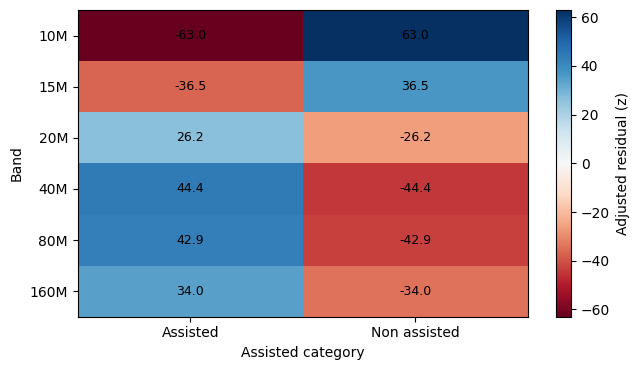

In [257]:
# import os
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt

# --- build observed table (exclude TOTAL row, enforce band order) ---
bands_order = ['10M','15M','20M','40M','80M','160M']

obs = (contingency_with_totals
       .loc[contingency_with_totals.index != 'TOTAL', ['ASSISTED','NON-ASSISTED']]
       .reindex(bands_order))

# --- expected counts under independence (no scipy needed) ---
n = obs.values.sum()
row_sums = obs.sum(axis=1).to_numpy()[:, None]   # shape (r,1)
col_sums = obs.sum(axis=0).to_numpy()[None, :]   # shape (1,c)
expected = (row_sums @ col_sums) / n
expected_df = pd.DataFrame(expected, index=obs.index, columns=obs.columns)

# --- adjusted residuals (Haberman) ---
row_prop = row_sums / n
col_prop = col_sums / n
adj_denom = np.sqrt(expected * (1 - row_prop) * (1 - col_prop))
adj_resid = (obs.values - expected) / adj_denom
adj_df = pd.DataFrame(adj_resid, index=obs.index, columns=obs.columns)

# --- plot heatmap ---
os.makedirs('figures', exist_ok=True)
fig, ax = plt.subplots(figsize=(6.6, 3.8))

max_abs = np.nanmax(np.abs(adj_df.values))
im = ax.imshow(adj_df.values, aspect='auto', cmap='RdBu', vmin=-max_abs, vmax= max_abs)

ax.set_xticks(range(adj_df.shape[1]))
ax.set_xticklabels(['Assisted', 'Non assisted'])
ax.set_yticks(range(adj_df.shape[0]))
ax.set_yticklabels(adj_df.index)

ax.set_xlabel('Assisted category')
ax.set_ylabel('Band')
# ax.set_title('Adjusted residuals: band × assisted')

# annotate cells
for i in range(adj_df.shape[0]):
    for j in range(adj_df.shape[1]):
        ax.text(j, i, f'{adj_df.iloc[i, j]:.1f}', ha='center', va='center', fontsize=9)

cbar = fig.colorbar(im, ax=ax)
cbar.set_label('Adjusted residual (z)')  # red = over representation, blue = under representation

fig.tight_layout()
plt.savefig('figures/assist_residuals_heatmap.pdf', bbox_inches='tight')
plt.savefig('figures/assist_residuals_heatmap.png', dpi=200, bbox_inches='tight')
plt.show()


In [258]:
# import numpy as np
# import pandas as pd
# from scipy.stats import chi2_contingency

# 1) Use the contingency table without totals
obs = contingency_with_totals.loc[
    contingency_with_totals.index != 'TOTAL',
    ['ASSISTED', 'NON-ASSISTED']
].copy()

# 2) Chi-square test of homogeneity
chi2, p, dof, expected = chi2_contingency(obs.values)

print(f"Chi-square homogeneity test: χ²={chi2:.2f}, dof={dof}, p={p:.4g}")

# 3) Expected counts as a DataFrame aligned to obs
expected_df = pd.DataFrame(expected, index=obs.index, columns=obs.columns)
print("\nExpected counts (under H0):")
print(expected_df.round(1))

# 4) Residual diagnostics
#    Pearson residuals: (O - E) / sqrt(E)
pearson_resid = (obs - expected_df) / np.sqrt(expected_df)

#    Adjusted (Haberman) residuals account for row/col margins
n = obs.values.sum()
row_prop = obs.sum(axis=1).values[:, None] / n
col_prop = obs.sum(axis=0).values[None, :] / n
adj_denom = np.sqrt(expected_df * (1 - row_prop) * (1 - col_prop))
adj_resid = (obs - expected_df) / adj_denom

print("\nPearson residuals:")
print(pearson_resid.round(2))

print("\nAdjusted residuals:")
print(adj_resid.round(2))

# 5) Effect size: Cramér’s V
r, c = obs.shape
cramers_v = (chi2 / (n * (min(r - 1, c - 1)))) ** 0.5
print(f"\nCramér’s V: {cramers_v:.3f}")


Chi-square homogeneity test: χ²=8819.08, dof=5, p=0

Expected counts (under H0):
CATEGORY-ASSISTED  ASSISTED  NON-ASSISTED
band                                     
10M                544661.3      217869.7
15M                417150.1      166863.9
20M                364284.7      145717.3
40M                341669.8      136671.2
80M                147216.2       58887.8
160M                36166.9       14467.1

Pearson residuals:
CATEGORY-ASSISTED  ASSISTED  NON-ASSISTED
band                                     
10M                  -28.28         44.72
15M                  -17.19         27.18
20M                   12.56        -19.87
40M                   21.44        -33.90
80M                   21.99        -34.78
160M                  17.98        -28.43

Adjusted residuals:
CATEGORY-ASSISTED  ASSISTED  NON-ASSISTED
band                                     
10M                  -62.98         62.98
15M                  -36.53         36.53
20M                   26.23        -26

In [260]:
# 1) Normalize + keep only the two buckets
df = pos.copy()
df['band'] = df['band'].astype(str).str.strip().str.upper()
df = df[df['CATEGORY-ASSISTED'].isin(['ASSISTED','NON-ASSISTED']) | df['CATEGORY-ASSISTED_RX'].isin(['ASSISTED','NON-ASSISTED'])].copy()

# 2) Contingency table (counts)
contingency = pd.crosstab(df['band'], df['CATEGORY-ASSISTED']).reindex(
    columns=['ASSISTED', 'NON-ASSISTED'], fill_value=0)

# Keep your preferred band order if available
if 'bands_order' in globals():
    contingency = contingency.reindex(bands_order, fill_value=0)

# 3) (Optional) add totals
contingency_with_totals = contingency.copy()
contingency_with_totals['TOTAL'] = contingency.sum(axis=1)
contingency_with_totals.loc['TOTAL'] = contingency_with_totals.sum()

print(contingency_with_totals)

# 4) (Optional) percentage views
row_pct = contingency.div(contingency.sum(axis=1), axis=0).round(3)   # within-band %
col_pct = contingency.div(contingency.sum(axis=0), axis=1).round(3)   # within-status %
overall_pct = (contingency / contingency.values.sum()).round(4)       # of all QSOs

# Example: inspect
print(row_pct)
# print(col_pct)
# print(overall_pct)

# import numpy as np
# import pandas as pd
# from scipy.stats import chi2_contingency

# 1) Use the contingency table without totals
obs = contingency_with_totals.loc[
    contingency_with_totals.index != 'TOTAL',
    ['ASSISTED', 'NON-ASSISTED']
].copy()

# 2) Chi-square test of homogeneity
chi2, p, dof, expected = chi2_contingency(obs.values)

print(f"Chi-square homogeneity test: χ²={chi2:.2f}, dof={dof}, p={p:.4g}")

# 3) Expected counts as a DataFrame aligned to obs
expected_df = pd.DataFrame(expected, index=obs.index, columns=obs.columns)
print("\nExpected counts (under H0):")
print(expected_df.round(1))

# 4) Residual diagnostics
#    Pearson residuals: (O - E) / sqrt(E)
pearson_resid = (obs - expected_df) / np.sqrt(expected_df)

#    Adjusted (Haberman) residuals account for row/col margins
n = obs.values.sum()
row_prop = obs.sum(axis=1).values[:, None] / n
col_prop = obs.sum(axis=0).values[None, :] / n
adj_denom = np.sqrt(expected_df * (1 - row_prop) * (1 - col_prop))
adj_resid = (obs - expected_df) / adj_denom

print("\nPearson residuals:")
print(pearson_resid.round(2))

print("\nAdjusted residuals:")
print(adj_resid.round(2))

# 5) Effect size: Cramér’s V
r, c = obs.shape
cramers_v = (chi2 / (n * (min(r - 1, c - 1)))) ** 0.5
print(f"\nCramér’s V: {cramers_v:.3f}")


CATEGORY-ASSISTED  ASSISTED  NON-ASSISTED    TOTAL
band                                              
10M                  523789        238742   762531
15M                  406049        177965   584014
20M                  371868        138134   510002
40M                  354202        124139   478341
80M                  155655         50449   206104
160M                  39586         11048    50634
TOTAL               1851149        740477  2591626
CATEGORY-ASSISTED  ASSISTED  NON-ASSISTED
band                                     
10M                   0.687         0.313
15M                   0.695         0.305
20M                   0.729         0.271
40M                   0.740         0.260
80M                   0.755         0.245
160M                  0.782         0.218
Chi-square homogeneity test: χ²=8819.08, dof=5, p=0

Expected counts (under H0):
CATEGORY-ASSISTED  ASSISTED  NON-ASSISTED
band                                     
10M                544661.3      217869.

In [ ]:
# import pandas as pd
# import numpy as np

def _norm_assisted(s):
    s = s.astype(str).str.strip().str.upper()
    s = s.str.replace(r'[\u2010-\u2015\-]+', '-', regex=True)
    return s.replace({
        'UNASSISTED':'NON-ASSISTED','NONASSISTED':'NON-ASSISTED',
        'NONE':'NON-ASSISTED','NO-ASSISTED':'NON-ASSISTED'
    })

df = pos.copy()
df['band'] = df['band'].astype(str).str.strip().str.upper()
s = _norm_assisted(df['CATEGORY-ASSISTED'])
r = _norm_assisted(df['CATEGORY-ASSISTED_RX'])

# QSO involvement label
qso_assist = np.where((s == 'ASSISTED') | (r == 'ASSISTED'), 'ASSISTED', 'NON-ASSISTED')
cont_qso = pd.crosstab(df['band'], qso_assist).reindex(
    index=(bands_order if 'bands_order' in globals() else None),
    columns=['ASSISTED','NON-ASSISTED'], fill_value=0
)

cont_qso_with_totals = cont_qso.copy()
cont_qso_with_totals['TOTAL'] = cont_qso.sum(axis=1)
cont_qso_with_totals.loc['TOTAL'] = cont_qso_with_totals.sum()

print(cont_qso_with_totals)

# 1) Use the contingency table without totals
obs = cont_qso_with_totals.loc[
    cont_qso_with_totals.index != 'TOTAL',
    ['ASSISTED', 'NON-ASSISTED']
].copy()

# 2) Chi-square test of homogeneity
chi2, p, dof, expected = chi2_contingency(obs.values)

print(f"Chi-square homogeneity test: χ²={chi2:.2f}, dof={dof}, p={p:.4g}")

# 3) Expected counts as a DataFrame aligned to obs
expected_df = pd.DataFrame(expected, index=obs.index, columns=obs.columns)
print("\nExpected counts (under H0):")
print(expected_df.round(1))

# 4) Residual diagnostics
#    Pearson residuals: (O - E) / sqrt(E)
pearson_resid = (obs - expected_df) / np.sqrt(expected_df)

#    Adjusted (Haberman) residuals account for row/col margins
n = obs.values.sum()
row_prop = obs.sum(axis=1).values[:, None] / n
col_prop = obs.sum(axis=0).values[None, :] / n
adj_denom = np.sqrt(expected_df * (1 - row_prop) * (1 - col_prop))
adj_resid = (obs - expected_df) / adj_denom

print("\nPearson residuals:")
print(pearson_resid.round(2))

print("\nAdjusted residuals:")
print(adj_resid.round(2))

# 5) Effect size: Cramér’s V
r, c = obs.shape
cramers_v = (chi2 / (n * (min(r - 1, c - 1)))) ** 0.5
print(f"\nCramér’s V: {cramers_v:.3f}")


# import os
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt

# --- build observed table (exclude TOTAL row, enforce band order) ---
bands_order = ['10M','15M','20M','40M','80M','160M']

obs = (cont_qso_with_totals
       .loc[cont_qso_with_totals.index != 'TOTAL', ['ASSISTED','NON-ASSISTED']]
       .reindex(bands_order))

# --- expected counts under independence (no scipy needed) ---
n = obs.values.sum()
row_sums = obs.sum(axis=1).to_numpy()[:, None]   # shape (r,1)
col_sums = obs.sum(axis=0).to_numpy()[None, :]   # shape (1,c)
expected = (row_sums @ col_sums) / n
expected_df = pd.DataFrame(expected, index=obs.index, columns=obs.columns)

# --- adjusted residuals (Haberman) ---
row_prop = row_sums / n
col_prop = col_sums / n
adj_denom = np.sqrt(expected * (1 - row_prop) * (1 - col_prop))
adj_resid = (obs.values - expected) / adj_denom
adj_df = pd.DataFrame(adj_resid, index=obs.index, columns=obs.columns)

# --- plot heatmap ---
os.makedirs('figures', exist_ok=True)
fig, ax = plt.subplots(figsize=(6.6, 3.8))

max_abs = np.nanmax(np.abs(adj_df.values))
im = ax.imshow(adj_df.values, aspect='auto', cmap='RdBu', vmin=-max_abs, vmax= max_abs)

ax.set_xticks(range(adj_df.shape[1]))
ax.set_xticklabels(['Assisted', 'Non assisted'])
ax.set_yticks(range(adj_df.shape[0]))
ax.set_yticklabels(adj_df.index)

ax.set_xlabel('Assisted category')
ax.set_ylabel('Band')
# ax.set_title('Adjusted residuals: band × assisted')

# annotate cells
for i in range(adj_df.shape[0]):
    for j in range(adj_df.shape[1]):
        ax.text(j, i, f'{adj_df.iloc[i, j]:.1f}', ha='center', va='center', fontsize=9)

cbar = fig.colorbar(im, ax=ax)
cbar.set_label('Adjusted residual (z)')  # red = over representation, blue = under representation

fig.tight_layout()
plt.savefig('figures/assist_residuals_heatmap.pdf', bbox_inches='tight')
plt.savefig('figures/assist_residuals_heatmap.png', dpi=200, bbox_inches='tight')
plt.show()


col_0  ASSISTED  NON-ASSISTED    TOTAL
band                                  
10M      689795         72736   762531
15M      531582         52432   584014
20M      475006         34996   510002
40M      446478         31863   478341
80M      192976         13128   206104
160M      48274          2360    50634
TOTAL   2384111        207515  2591626
Chi-square homogeneity test: χ²=6780.12, dof=5, p=0

Expected counts (under H0):
col_0  ASSISTED  NON-ASSISTED
band                         
10M    701474.1       61056.9
15M    537251.2       46762.8
20M    469165.4       40836.6
40M    440039.6       38301.4
80M    189601.0       16503.0
160M    46579.7        4054.3

Pearson residuals:
col_0  ASSISTED  NON-ASSISTED
band                         
10M      -13.94         47.27
15M       -7.73         26.22
20M        8.53        -28.90
40M        9.71        -32.90
80M        7.75        -26.27
160M       7.85        -26.61

Adjusted residuals:
col_0  ASSISTED  NON-ASSISTED
band             

NameError: name 'cont' is not defined

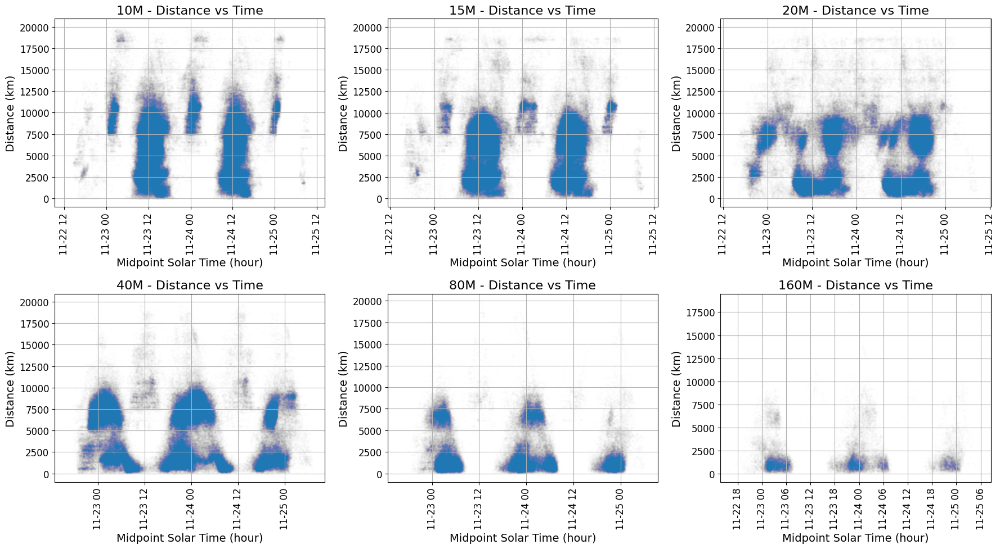

In [ ]:
import matplotlib.pyplot as plt

plt.rcParams.update({
    "font.size": 14,        # base font size
    "axes.titlesize": 16,   # subplot titles
    "axes.labelsize": 14,   # x/y labels
    "xtick.labelsize": 12,  # tick labels
    "ytick.labelsize": 12
})

fig, axes = plt.subplots(2, 3, figsize=(18, 10), sharex=False, sharey=False)
axes = axes.flatten()

for idx, band in enumerate(bands_order):
    ax = axes[idx]
    df_band = pos[(pos['band'] == band) & 
                  (pos['distance'].notnull()) & 
                  (pos['midpoint_solar_time'].notnull())]
    ax.scatter(df_band['midpoint_solar_time'], df_band['distance'],
               alpha=0.005, s=5)
    ax.set_title(f'{band} - Distance vs Time')
    ax.set_xlabel('Midpoint Solar Time (hour)')
    ax.set_ylabel('Distance (km)')
    ax.grid(True)
    ax.tick_params(axis='x', rotation=90)

# Hide unused subplots if bands < 6
for ax in axes[len(bands_order):]:
    ax.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
# import pandas as pd
# import numpy as np

# --- helpers ----------------------------------------------------------------
def _norm_power(s):
    s = s.astype(str).str.strip().str.upper()
    s = s.str.replace(r'[\u2010-\u2015\-]+', '-', regex=True)  # unify hyphens
    s = (s.replace({
        'HIGH POWER': 'HIGH',
        'LOW POWER': 'LOW',
        'QRP-LOW': 'QRP',
        'QRP/LOW': 'QRP',
        'QRPP': 'QRP',
    }))
    # keep only known buckets; others -> NaN
    s = s.where(s.isin(['HIGH', 'LOW', 'QRP']), other=np.nan)
    return s

# --- build long endpoint view (one row per station appearance) --------------
df = pos.copy()
df['band'] = df['band'].astype(str).str.strip().str.upper()

tx = (df[['band', 'CALLSIGN', 'CATEGORY-POWER']]
      .rename(columns={'CALLSIGN': 'callsign', 'CATEGORY-POWER': 'power'}))
rx = (df[['band', 'CALLSIGN_RX', 'CATEGORY-POWER_RX']]
      .rename(columns={'CALLSIGN_RX': 'callsign', 'CATEGORY-POWER_RX': 'power'}))

long_ = pd.concat([tx, rx], ignore_index=True)
long_['callsign'] = long_['callsign'].astype(str).str.strip().str.upper()
long_['power'] = _norm_power(long_['power'])

# keep only HIGH/LOW (exclude QRP, NaN)
long_ = long_[long_['power'].isin(['HIGH', 'LOW'])].dropna(subset=['band','callsign'])

# --- per-station totals on each band ---------------------------------------
per_station = (long_.groupby(['band','callsign','power'], as_index=False)
                      .size()
                      .rename(columns={'size': 'qso_count'}))
per_station['log_contacts'] = np.log1p(per_station['qso_count'])

# --- band × power summaries: median and IQR of log(1+contacts) --------------
def _q1(x): return x.quantile(0.25)
def _q3(x): return x.quantile(0.75)

summ = (per_station.groupby(['band','power'])['log_contacts']
        .agg(median='median', q1=_q1, q3=_q3)
        .assign(iqr=lambda d: d['q3'] - d['q1'])
        .drop(columns=['q1','q3'])
        .reset_index())

# --- reshape into desired table: [Median (LOW), IQR (LOW), Median (HIGH), IQR (HIGH)] ---
tab = (summ.pivot(index='band', columns='power', values=['median','iqr'])
            .reindex(index=(bands_order if 'bands_order' in globals() else ['10M','15M','20M','40M','80M','160M'])))

# ensure columns exist even if a bucket missing
for lvl1, lvl2 in [('median','LOW'),('iqr','LOW'),('median','HIGH'),('iqr','HIGH')]:
    if (lvl1,lvl2) not in tab.columns:
        tab[(lvl1,lvl2)] = np.nan
tab = tab[[('median','LOW'),('iqr','LOW'),('median','HIGH'),('iqr','HIGH')]]

# pretty formatting
fmt = tab.copy()
fmt.columns = ['Median (LOW)', 'IQR (LOW)', 'Median (HIGH)', 'IQR (HIGH)']
fmt = fmt.applymap(lambda x: '' if pd.isna(x) else f'{x:.2f}')

print(fmt)  # quick look

# --- LaTeX table body -------------------------------------------------------
latex = (
    '\\begin{table}[h]\n'
    '\\centering\n'
    '\\caption{Per station contact totals by power and band. Medians and interquartile ranges of $\\log(1+\\text{contacts})$.}\n'
    '\\label{tab:power-sumstats}\n'
    '\\begin{tabular}{@{}lrrrr@{}}\\toprule\n'
    'Band & Median (LOW) & IQR (LOW) & Median (HIGH) & IQR (HIGH) \\\\\\midrule\n' +
    '\n'.join(f'{idx} & {row["Median (LOW)"]} & {row["IQR (LOW)"]} & {row["Median (HIGH)"]} & {row["IQR (HIGH)"]}'
             for idx, row in fmt.iterrows()) +
    '\\\\\n\\bottomrule\n\\end{tabular}\n\\end{table}\n'
)
print(latex)


     Median (LOW) IQR (LOW) Median (HIGH) IQR (HIGH)
band                                                
10M          4.28      1.81          5.14       1.96
15M          4.03      1.82          4.85       2.12
20M          3.91      2.00          4.68       2.22
40M          3.95      1.89          4.68       2.12
80M          3.30      2.37          3.89       2.37
160M         2.48      2.22          3.18       2.33
\begin{table}[h]
\centering
\caption{Per station contact totals by power and band. Medians and interquartile ranges of $\log(1+\text{contacts})$.}
\label{tab:power-sumstats}
\begin{tabular}{@{}lrrrr@{}}\toprule
Band & Median (LOW) & IQR (LOW) & Median (HIGH) & IQR (HIGH) \\\midrule
10M & 4.28 & 1.81 & 5.14 & 1.96
15M & 4.03 & 1.82 & 4.85 & 2.12
20M & 3.91 & 2.00 & 4.68 & 2.22
40M & 3.95 & 1.89 & 4.68 & 2.12
80M & 3.30 & 2.37 & 3.89 & 2.37
160M & 2.48 & 2.22 & 3.18 & 2.33\\
\bottomrule
\end{tabular}
\end{table}



C:\Users\neela\AppData\Local\Temp\ipykernel_6544\283591653.py:64: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  fmt = fmt.applymap(lambda x: '' if pd.isna(x) else f'{x:.2f}')


col_0   SINGLE  MULTI    TOTAL
band                          
10M     748150  14381   762531
15M     566329  17685   584014
20M     492349  17653   510002
40M     460293  18048   478341
80M     195386  10718   206104
160M     46797   3837    50634
TOTAL  2509304  82322  2591626
Chi-square homogeneity test: χ²=10793.14, dof=5, p=0

Expected counts (under H0):
col_0    SINGLE    MULTI
band                    
10M    738309.5  24221.5
15M    565463.0  18551.0
20M    493802.0  16200.0
40M    463146.7  15194.3
80M    199557.2   6546.8
160M    49025.6   1608.4

Pearson residuals:
col_0  SINGLE  MULTI
band                
10M     11.45 -63.23
15M      1.15  -6.36
20M     -2.07  11.42
40M     -4.19  23.15
80M     -9.34  51.55
160M   -10.07  55.57

Adjusted residuals:
col_0  SINGLE  MULTI
band                
10M     76.49 -76.49
15M      7.34  -7.34
20M    -12.94  12.94
40M    -26.05  26.05
80M    -54.61  54.61
160M   -57.03  57.03

Cramér’s V: 0.065


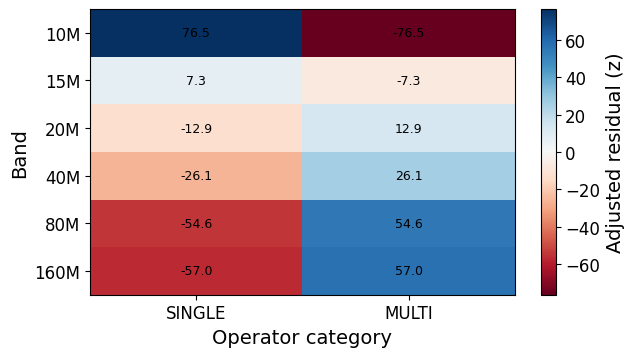

In [ ]:
# import pandas as pd
# import numpy as np

# def _norm_assisted(s):
#     s = s.astype(str).str.strip().str.upper()
#     s = s.str.replace(r'[\u2010-\u2015\-]+', '-', regex=True)
#     return s.replace({
#         'UNASSISTED':'NON-ASSISTED','NONASSISTED':'NON-ASSISTED',
#         'NONE':'NON-ASSISTED','NO-ASSISTED':'NON-ASSISTED'
#     })

df = pos.copy()
df['band'] = df['band'].astype(str).str.strip().str.upper()
s = df['CATEGORY-OPERATOR']
r = df['CATEGORY-OPERATOR_RX']

# QSO involvement label
qso_assist = np.where((s == 'SINGLE-OP') | (r == 'SINGLE-OP'), 'SINGLE', 'MULTI')
cont_qso = pd.crosstab(df['band'], qso_assist).reindex(
    index=(bands_order if 'bands_order' in globals() else None),
    columns=['SINGLE','MULTI'], fill_value=0
)

cont_qso_with_totals = cont_qso.copy()
cont_qso_with_totals['TOTAL'] = cont_qso.sum(axis=1)
cont_qso_with_totals.loc['TOTAL'] = cont_qso_with_totals.sum()

print(cont_qso_with_totals)

# 1) Use the contingency table without totals
obs = cont_qso_with_totals.loc[
    cont_qso_with_totals.index != 'TOTAL',
    ['SINGLE', 'MULTI']
].copy()

# 2) Chi-square test of homogeneity
chi2, p, dof, expected = chi2_contingency(obs.values)

print(f"Chi-square homogeneity test: χ²={chi2:.2f}, dof={dof}, p={p:.4g}")

# 3) Expected counts as a DataFrame aligned to obs
expected_df = pd.DataFrame(expected, index=obs.index, columns=obs.columns)
print("\nExpected counts (under H0):")
print(expected_df.round(1))

# 4) Residual diagnostics
#    Pearson residuals: (O - E) / sqrt(E)
pearson_resid = (obs - expected_df) / np.sqrt(expected_df)

#    Adjusted (Haberman) residuals account for row/col margins
n = obs.values.sum()
row_prop = obs.sum(axis=1).values[:, None] / n
col_prop = obs.sum(axis=0).values[None, :] / n
adj_denom = np.sqrt(expected_df * (1 - row_prop) * (1 - col_prop))
adj_resid = (obs - expected_df) / adj_denom

print("\nPearson residuals:")
print(pearson_resid.round(2))

print("\nAdjusted residuals:")
print(adj_resid.round(2))

# 5) Effect size: Cramér’s V
r, c = obs.shape
cramers_v = (chi2 / (n * (min(r - 1, c - 1)))) ** 0.5
print(f"\nCramér’s V: {cramers_v:.3f}")


# import os
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt

# --- build observed table (exclude TOTAL row, enforce band order) ---
bands_order = ['10M','15M','20M','40M','80M','160M']

obs = (cont_qso_with_totals
       .loc[cont_qso_with_totals.index != 'TOTAL', ['SINGLE','MULTI']]
       .reindex(bands_order))

# --- expected counts under independence (no scipy needed) ---
n = obs.values.sum()
row_sums = obs.sum(axis=1).to_numpy()[:, None]   # shape (r,1)
col_sums = obs.sum(axis=0).to_numpy()[None, :]   # shape (1,c)
expected = (row_sums @ col_sums) / n
expected_df = pd.DataFrame(expected, index=obs.index, columns=obs.columns)

# --- adjusted residuals (Haberman) ---
row_prop = row_sums / n
col_prop = col_sums / n
adj_denom = np.sqrt(expected * (1 - row_prop) * (1 - col_prop))
adj_resid = (obs.values - expected) / adj_denom
adj_df = pd.DataFrame(adj_resid, index=obs.index, columns=obs.columns)

# --- plot heatmap ---
os.makedirs('figures', exist_ok=True)
fig, ax = plt.subplots(figsize=(6.6, 3.8))

max_abs = np.nanmax(np.abs(adj_df.values))
im = ax.imshow(adj_df.values, aspect='auto', cmap='RdBu', vmin=-max_abs, vmax= max_abs)

ax.set_xticks(range(adj_df.shape[1]))
ax.set_xticklabels(['SINGLE', 'MULTI'])
ax.set_yticks(range(adj_df.shape[0]))
ax.set_yticklabels(adj_df.index)

ax.set_xlabel('Operator category')
ax.set_ylabel('Band')
# ax.set_title('Adjusted residuals: band × assisted')

# annotate cells
for i in range(adj_df.shape[0]):
    for j in range(adj_df.shape[1]):
        ax.text(j, i, f'{adj_df.iloc[i, j]:.1f}', ha='center', va='center', fontsize=9)

cbar = fig.colorbar(im, ax=ax)
cbar.set_label('Adjusted residual (z)')  # red = over representation, blue = under representation

fig.tight_layout()
plt.savefig('figures/op_residuals_heatmap.pdf', bbox_inches='tight')
plt.savefig('figures/op_residuals_heatmap.png', dpi=200, bbox_inches='tight')
plt.show()


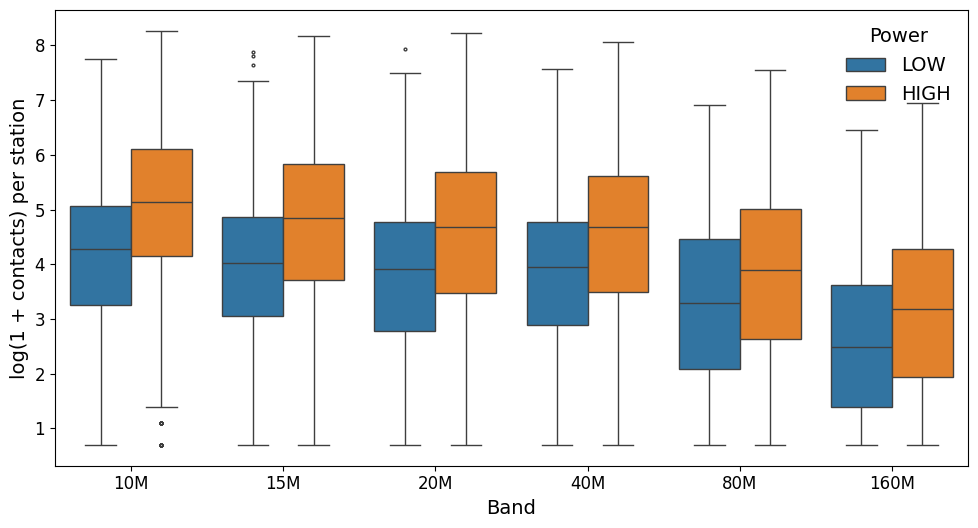

In [ ]:
# import os
# import re
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns

# --- helper to normalise power labels --------------------------------------
def _norm_power(s):
    s = s.astype(str).str.strip().str.upper()
    s = s.str.replace(r'[\u2010-\u2015\-]+', '-', regex=True)
    s = s.replace({
        'HIGH POWER': 'HIGH',
        'LOW POWER': 'LOW',
        'QRP-LOW': 'QRP',
        'QRP/LOW': 'QRP',
        'QRPP': 'QRP',
    })
    return s.where(s.isin(['HIGH','LOW','QRP']), other=np.nan)

# --- build long endpoint view (sender + receiver appearances) --------------
df = pos.copy()
df['band'] = df['band'].astype(str).str.strip().str.upper()

tx = (df[['band','CALLSIGN','CATEGORY-POWER']]
      .rename(columns={'CALLSIGN':'callsign','CATEGORY-POWER':'power'}))
rx = (df[['band','CALLSIGN_RX','CATEGORY-POWER_RX']]
      .rename(columns={'CALLSIGN_RX':'callsign','CATEGORY-POWER_RX':'power'}))

long_ = pd.concat([tx, rx], ignore_index=True)
long_['callsign'] = long_['callsign'].astype(str).str.strip().str.upper()
long_['power'] = _norm_power(long_['power'])

# keep only HIGH and LOW (drop QRP/NaN)
long_ = long_.loc[long_['power'].isin(['HIGH','LOW'])].dropna(subset=['band','callsign'])

# --- per-station totals on each band ---------------------------------------
per_station = (long_.groupby(['band','callsign','power'], as_index=False)
                      .size()
                      .rename(columns={'size':'qso_count'}))
per_station['log_contacts'] = np.log1p(per_station['qso_count'])

# --- band order (optional) --------------------------------------------------
if 'bands_order' in globals():
    per_station['band'] = pd.Categorical(per_station['band'], categories=bands_order, ordered=True)

# --- plot: grouped box plots by band (hue=power) ---------------------------
os.makedirs('figures', exist_ok=True)

plt.figure(figsize=(10, 5.5))
sns.boxplot(
    data=per_station,
    x='band', y='log_contacts',
    hue='power', hue_order=['LOW','HIGH'],
    dodge=True, fliersize=2, linewidth=1
)
plt.xlabel('Band')
plt.ylabel('log(1 + contacts) per station')
plt.legend(title='Power', frameon=False)
plt.tight_layout()
plt.savefig('figures/power_box_by_band.pdf', bbox_inches='tight')
plt.savefig('figures/power_box_by_band.png', dpi=200, bbox_inches='tight')
plt.show()


Missing lon_1: 0.08713516547480459 | Missing lon_2: 0.08706968235489772
  band callsign power   operator      assisted transmitter locator  qso_count  \
0  40M   2E0CVN   LOW  SINGLE-OP  NON-ASSISTED         ONE  IO80EM        204   
1  80M   2E0CVN   LOW  SINGLE-OP  NON-ASSISTED         ONE  IO80EM         70   
2  20M   2E0CVN   LOW  SINGLE-OP  NON-ASSISTED         ONE  IO80EM        276   
3  15M   2E0CVN   LOW  SINGLE-OP  NON-ASSISTED         ONE  IO80EM        255   
4  10M   2E0CVN   LOW  SINGLE-OP  NON-ASSISTED         ONE  IO80EM        190   

   qso_count_tx  qso_count_rx  log_qso_count  
0           197             7       5.323010  
1            62             8       4.262680  
2           272             4       5.624018  
3           249             6       5.545177  
4           188             2       5.252273  
callsign
E74A      4
EA5KM     4
SP2I      4
SN3A      3
DM3AW     3
         ..
AA0FO     1
9V1HY     1
7M4CTM    1
7M4CLF    1
7M1MCY    1
Name: count, Lengt

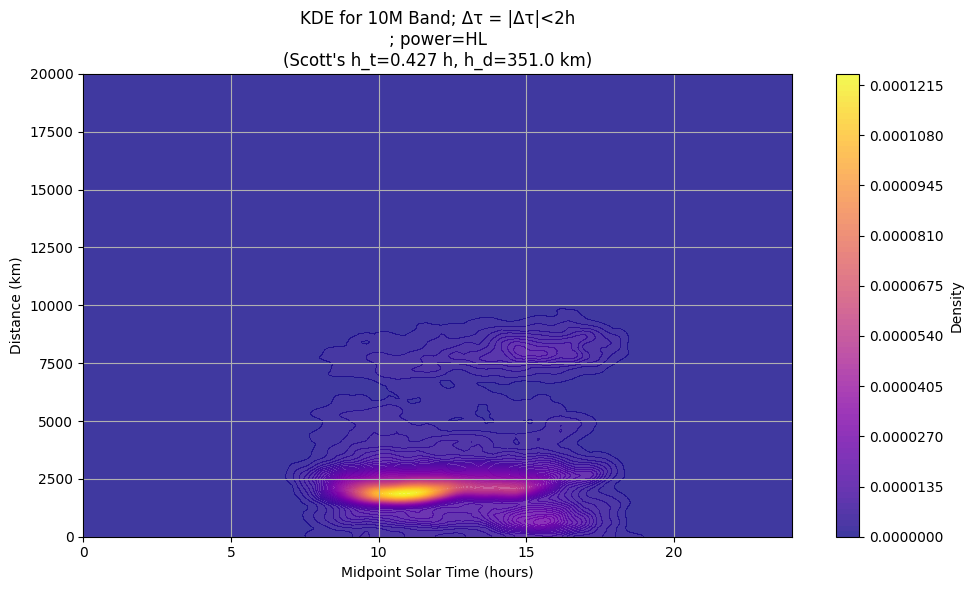

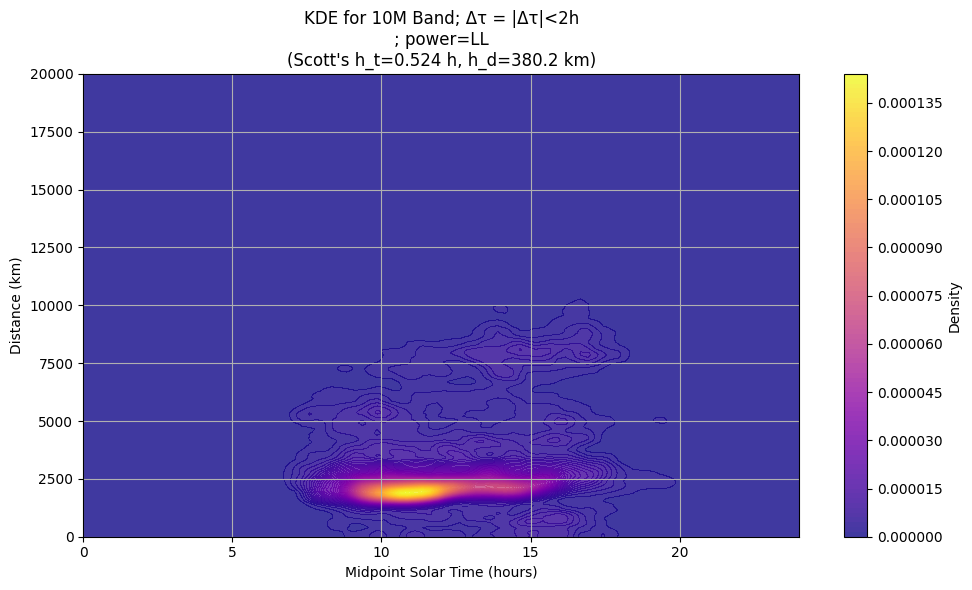

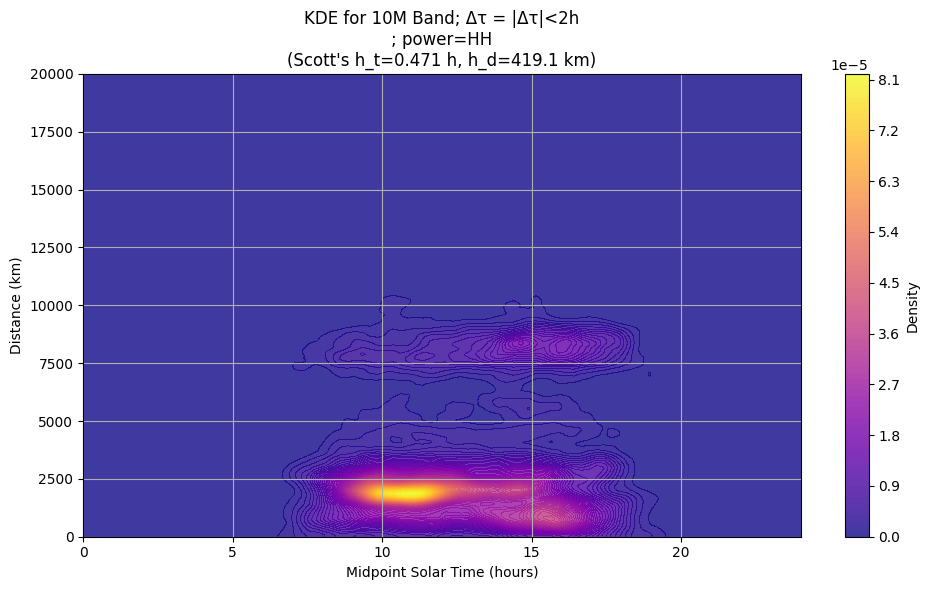

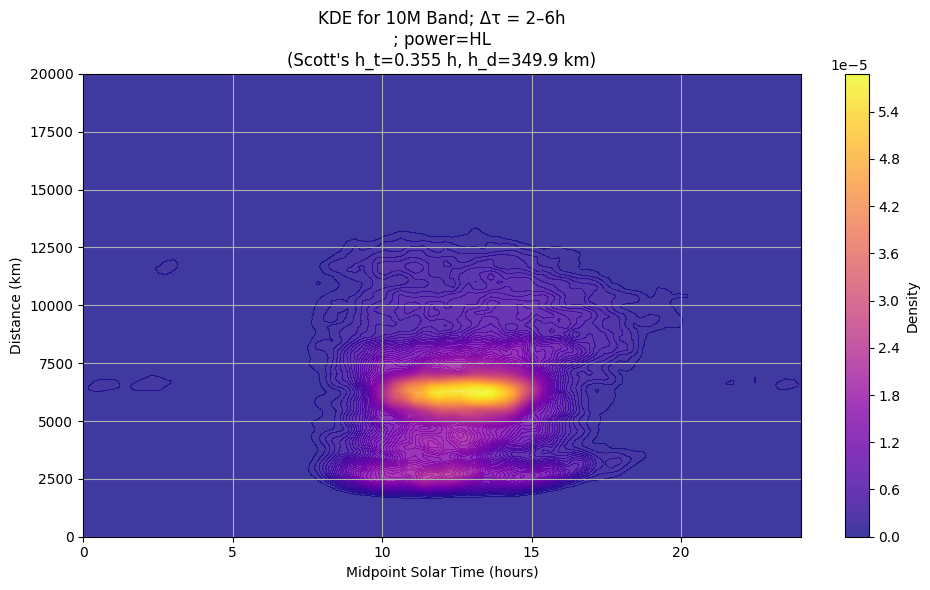

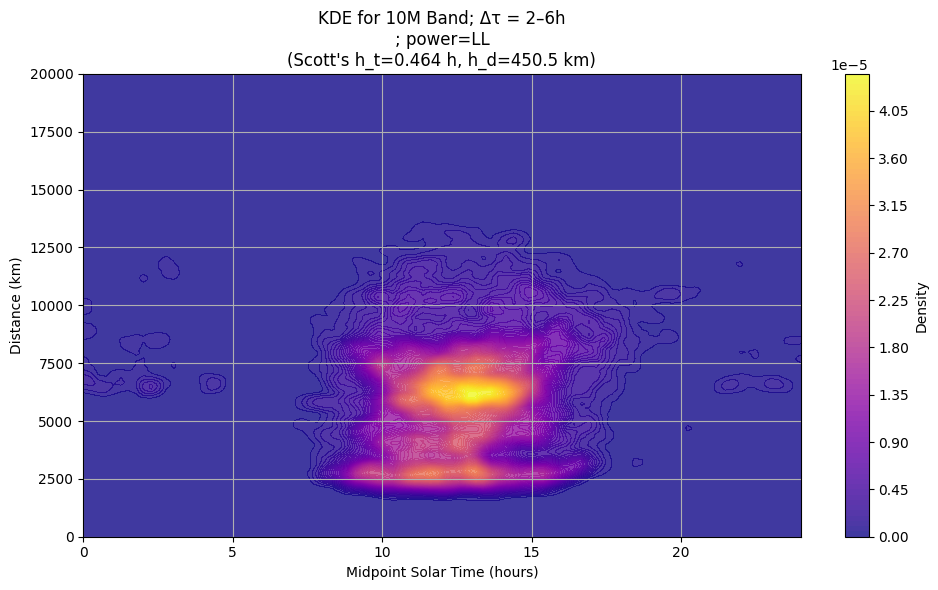

...

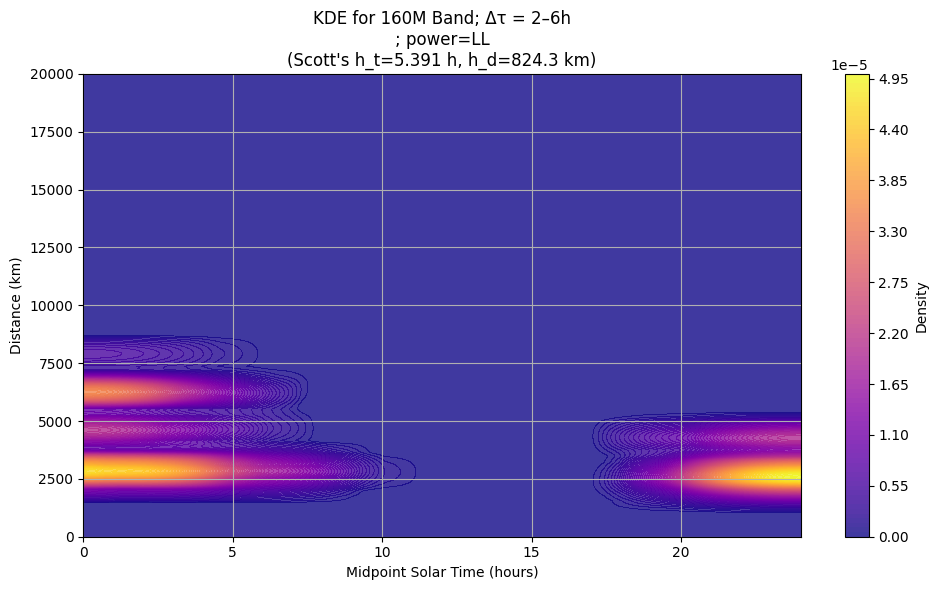

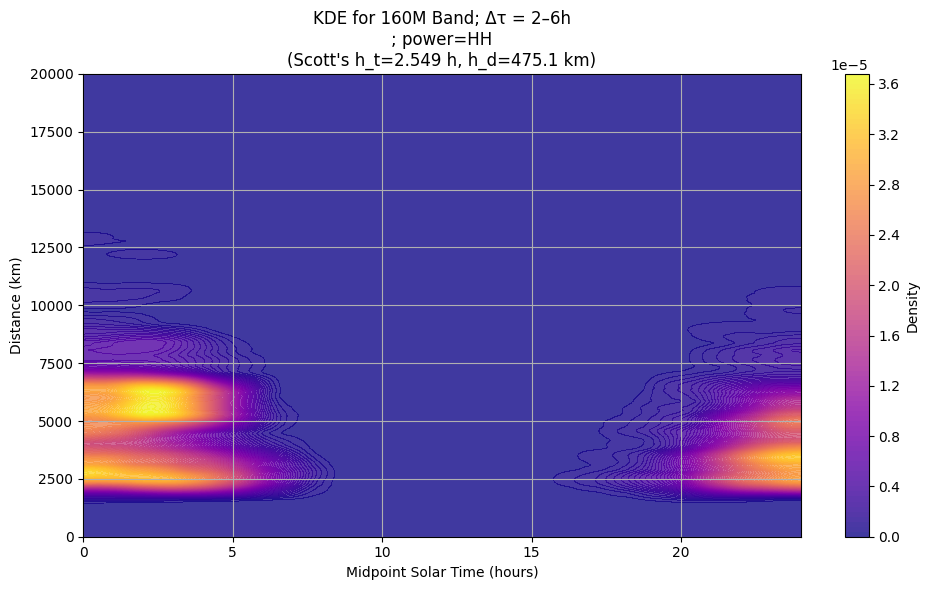

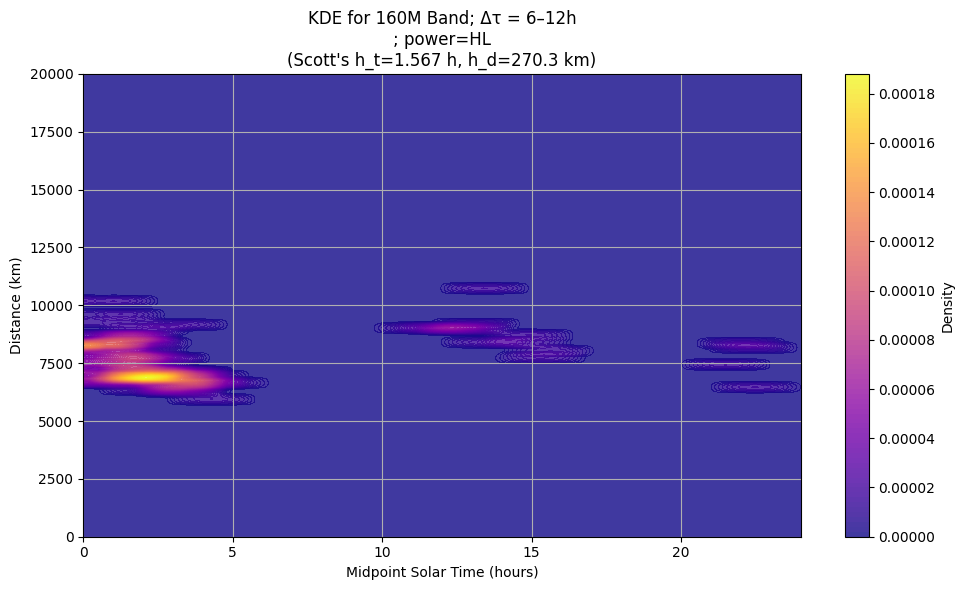

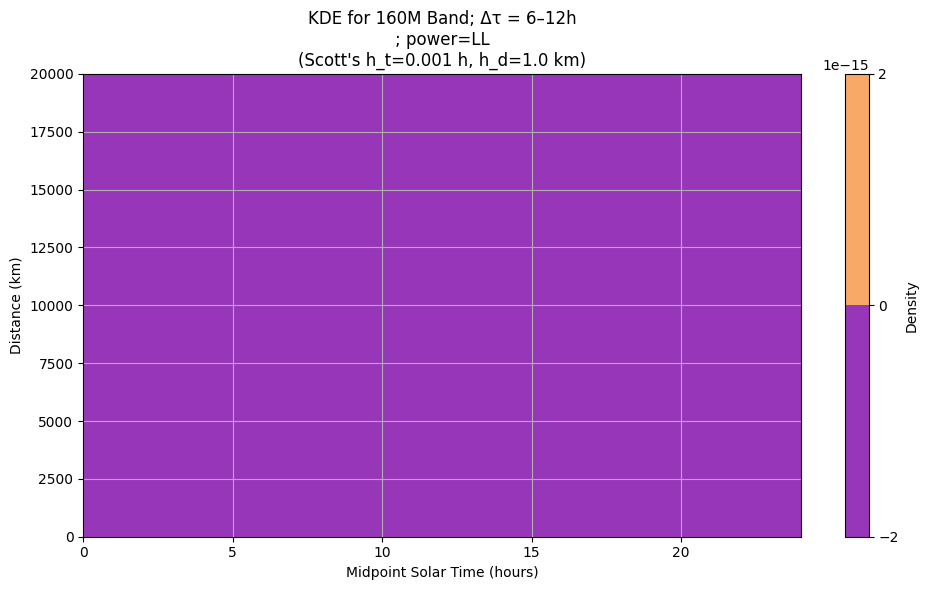

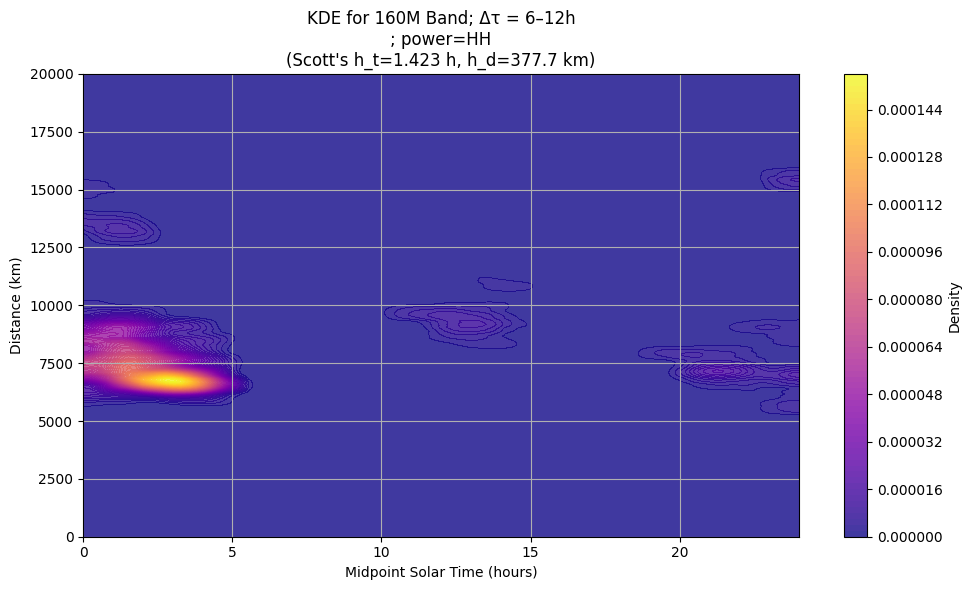

In [ ]:
# drop rows with TWO or UNLIMITED in TRANSMITTER (either TX or RX),
# or QRP in POWER (either TX or RX)
mask = (
    pos['CATEGORY-TRANSMITTER'].isin(['TWO', 'UNLIMITED']) |
    pos['CATEGORY-TRANSMITTER_RX'].isin(['TWO', 'UNLIMITED']) |
    pos['CATEGORY-POWER'].isin(['QRP']) |
    pos['CATEGORY-POWER_RX'].isin(['QRP'])
)

pos_clean = pos[~mask].copy()

if 'solar_hour' not in pos_clean.columns:
    pos_clean['solar_hour'] = (pos_clean['midpoint_solar_time'].dt.hour
                                 + pos_clean['midpoint_solar_time'].dt.minute/60
                                 + pos_clean['midpoint_solar_time'].dt.second/3600)
    
def grid_to_lon_safe(val):
    """
    Safe lon extractor from a Maidenhead locator.
    Returns np.nan if missing/invalid.
    """
    if pd.isna(val):
        return np.nan
    try:
        s = str(val).strip().upper()
        lat, lon = mh.to_location(s)   # (lat, lon) in degrees
        return float(lon)
    except Exception:
        return np.nan


def wrap_to(x, a=-12.0, b=12.0):
    """Wrap numbers into [a,b) (default hours [-12,12))."""
    w = b - a
    return (x - a) % w + a

# 1) Endpoint longitudes (deg East)
pos_clean['lon_1'] = pos_clean['GRID-LOCATOR'].map(grid_to_lon_safe)
pos_clean['lon_2'] = pos_clean['GRID-LOCATOR_RX'].map(grid_to_lon_safe)

# 2) Δτ in hours, wrapped to [-12,12)
pos_clean['delta_tau'] = wrap_to((pos_clean['lon_2'] - pos_clean['lon_1']) / 15.0)

# Quick sanity: how many invalid/missing?
print("Missing lon_1:", pos_clean['lon_1'].isna().mean(), 
      "| Missing lon_2:", pos_clean['lon_2'].isna().mean())

tau_mid_hours = (
    pos_clean['midpoint_solar_time'].dt.hour
    + pos_clean['midpoint_solar_time'].dt.minute/60
    + pos_clean['midpoint_solar_time'].dt.second/3600
).astype(float)

pos_clean['tau1_hours'] = (tau_mid_hours - 0.5*pos_clean['delta_tau']) % 24.0
pos_clean['tau2_hours'] = (tau_mid_hours + 0.5*pos_clean['delta_tau']) % 24.0

def dtau_bin(dt):
    a = abs(dt)
    if a < 2:   return '|Δτ|<2h'
    if a < 6:   return '2–6h'
    else:       return '6–12h'

pos_clean['delta_bin'] = pos_clean['delta_tau'].apply(dtau_bin)

def power_bin(a, b):
    if (a == 'HIGH') and (b == 'HIGH'):
        return 'HH'
    elif (a == 'LOW') and (b == 'LOW'):
        return 'LL'
    elif (a == 'HIGH') and (b == 'LOW'):
        return 'HL'
    elif (a == 'LOW') and (b == 'HIGH'):
        return 'HL'
    else:
        return np.nan
    
pos_clean['power_bin'] = pos_clean.apply(
    lambda row: power_bin(row['CATEGORY-POWER'], row['CATEGORY-POWER_RX']), axis=1
)


# %% 
# --- Sender side ---
sender_cols_v2 = ["band", "CALLSIGN", "CATEGORY-POWER", "CATEGORY-OPERATOR",
                  "CATEGORY-ASSISTED", "CATEGORY-TRANSMITTER", "GRID-LOCATOR", "LOG_QSO_COUNT"]
sender_df_v2 = pos_clean[sender_cols_v2].rename(columns={
    "CALLSIGN": "callsign",
    "CATEGORY-POWER": "power",
    "CATEGORY-OPERATOR": "operator",
    "CATEGORY-ASSISTED": "assisted",
    "CATEGORY-TRANSMITTER": "transmitter",
    "GRID-LOCATOR": "locator",
    "LOG_QSO_COUNT": "log_qso_count"
})

# --- Receiver side ---
receiver_cols_v2 = ["band", "CALLSIGN_RX", "CATEGORY-POWER_RX", "CATEGORY-OPERATOR_RX",
                    "CATEGORY-ASSISTED_RX", "CATEGORY-TRANSMITTER_RX", "GRID-LOCATOR_RX","LOG_QSO_COUNT_RX"]
receiver_df_v2 = pos_clean[receiver_cols_v2].rename(columns={
    "CALLSIGN_RX": "callsign",
    "CATEGORY-POWER_RX": "power",
    "CATEGORY-OPERATOR_RX": "operator",
    "CATEGORY-ASSISTED_RX": "assisted",
    "CATEGORY-TRANSMITTER_RX": "transmitter",
    "GRID-LOCATOR_RX": "locator",
    "LOG_QSO_COUNT_RX": "log_qso_count"
})

# --- Combine sender + receiver ---
station_band_v2 = pd.concat([sender_df_v2, receiver_df_v2], ignore_index=True)

# --- Drop duplicates per (band, callsign) ---
station_band_v2 = station_band_v2.drop_duplicates(subset=["band", "callsign"])

# =====================================================================

# remove log_qso_counts from station_band copy
station_band_copy_v2 = station_band_v2.drop(columns=['log_qso_count'], errors='ignore').copy()

# normalize keys
station_band_copy_v2['band'] = station_band_copy_v2['band'].astype(str).str.strip()
station_band_copy_v2['callsign'] = station_band_copy_v2['callsign'].astype(str).str.strip().str.upper()

# --- Build long-form (band, callsign) from pos_clean for both TX and RX ---
tx_v2 = (
    pos_clean[['band', 'CALLSIGN']]
    .rename(columns={'CALLSIGN': 'callsign'})
    .dropna(subset=['band', 'callsign'])
    .assign(side='tx')
)
rx_v2 = (
    pos_clean[['band', 'CALLSIGN_RX']]
    .rename(columns={'CALLSIGN_RX': 'callsign'})
    .dropna(subset=['band', 'callsign'])
    .assign(side='rx')
)

# normalize keys to match station_band_copy_v2
for df_ in (tx_v2, rx_v2):
    df_['band'] = df_['band'].astype(str).str.strip()
    df_['callsign'] = df_['callsign'].astype(str).str.strip().str.upper()

long_pos_v2 = pd.concat([tx_v2, rx_v2], ignore_index=True)

# --- Count QSOs per (band, callsign) ---
counts_total_v2 = (
    long_pos_v2.groupby(['band', 'callsign'], as_index=False)
               .size()
               .rename(columns={'size': 'qso_count'})
)

counts_tx_v2 = (
    long_pos_v2[long_pos_v2['side'] == 'tx']
        .groupby(['band', 'callsign'], as_index=False)
        .size()
        .rename(columns={'size': 'qso_count_tx'})
)

counts_rx_v2 = (
    long_pos_v2[long_pos_v2['side'] == 'rx']
        .groupby(['band', 'callsign'], as_index=False)
        .size()
        .rename(columns={'size': 'qso_count_rx'})
)

# --- Merge counts into station_band_copy_v2 ---
station_band_counts_v2 = (
    station_band_copy_v2
      .merge(counts_total_v2, on=['band', 'callsign'], how='left')
      .merge(counts_tx_v2,    on=['band', 'callsign'], how='left')
      .merge(counts_rx_v2,    on=['band', 'callsign'], how='left')
)

# fill NaNs and ensure ints
for c in ['qso_count', 'qso_count_tx', 'qso_count_rx']:
    if c in station_band_counts_v2:
        station_band_counts_v2[c] = station_band_counts_v2[c].fillna(0).astype(int)

station_band_counts_v2['log_qso_count'] = np.log1p(station_band_counts_v2['qso_count'])
print(station_band_counts_v2.head())

# --- Debug subset ---
test_station_band_counts_v2 = station_band_counts_v2[station_band_counts_v2["qso_count"] == 1]

callsign_counts_v2 = test_station_band_counts_v2["callsign"].value_counts()
print(callsign_counts_v2)

callsigns_to_remove_v2 = callsign_counts_v2[callsign_counts_v2 > 1].index
print(len(callsigns_to_remove_v2))

mask_v2 = station_band_counts_v2["callsign"].isin(callsigns_to_remove_v2) & (station_band_counts_v2["qso_count"] == 1)
clean_station_band_counts_v2 = station_band_counts_v2.loc[~mask_v2].copy()


grid_t = np.linspace(0, 24, 96)
grid_d = np.linspace(0, 20000, 400)

def kde2d_epan_reflect(time, dist, grid_t, grid_d, h_t, h_d, a_t=0.0, b_t=24.0, a_d=0.0, b_d=max(grid_d)):
    """
    2D KDE with Epanechnikov product kernel and reflection boundary correction
    on a rectangular domain [a_t, b_t] x [a_d, b_d].

    time, dist: 1D arrays of data
    grid_t, grid_d: 1D grids for evaluation
    h_t, h_d: bandwidths
    a_t,b_t: time domain bounds (default [0,24])
    a_d,b_d: distance domain bounds (default [0, max(grid_d)])
    """
    # epanechnikov kernel (1D)
    def epan(u):
        out = np.zeros_like(u, dtype=float)
        m = (np.abs(u) <= 1.0)
        out[m] = 0.75 * (1.0 - u[m]**2)
        return out

    if b_d is None:
        b_d = float(np.max(grid_d))

    n = len(time)
    T, D = np.meshgrid(grid_t, grid_d)  # shape: (len(grid_d), len(grid_t))
    G = np.zeros_like(T, dtype=float)

    time = np.asarray(time, float)
    dist = np.asarray(dist, float)

    for ti, di in zip(time, dist):
        # reflections for this point in each dimension (lower and upper)
        t_refs = np.array([ti, -ti + 2*a_t, -ti + 2*b_t], dtype=float)
        d_refs = np.array([di, -di + 2*a_d, -di + 2*b_d], dtype=float)

        # all 3x3 combinations (Cartesian product)
        for tr in t_refs:
            Kt = epan((T - tr) / h_t) / h_t
            for dr in d_refs:
                Kd = epan((D - dr) / h_d) / h_d
                G += Kt * Kd

    # average over original sample size
    G /= n

    # optional: renormalize numerically over the grid (helps minor discretization drift)
    integral = np.trapezoid(np.trapezoid(G, grid_t, axis=1), grid_d, axis=0)
    if integral > 0:
        G /= integral

    return G

bands_order = ['10M','15M','20M','40M','80M','160M']
del_tau_bins = ['|Δτ|<2h', '2–6h', '6–12h']

powers = pos_clean['power_bin'].unique()
band_kde_alt_v2 = {}
for band in bands_order:
    for del_tau in del_tau_bins:
        for power in powers:
            df_filtered = pos_clean[(pos_clean['band'] == band) & (pos_clean['delta_bin'] == del_tau) & (pos_clean['power_bin'] == power)]

            time_vec = df_filtered['solar_hour'].to_numpy()
            dist_vec = df_filtered['distance'].to_numpy()

            # Skip if too few points
            n = len(df_filtered)
            if n < 5:
                continue

            # Scott's rule in 2D → n^(-1/6)
            factor = n ** (-1.0 / 6.0)

            # --- choose scale: plain std OR robust std ---
            # Plain std:
            sig_t = df_filtered['solar_hour'].std(ddof=1)
            sig_d = df_filtered['distance'].std(ddof=1)

            # Robust alternative (comment stds above and uncomment below if you prefer):
            # q_t = df_filtered['solar_hour'].quantile([0.25, 0.75])
            # q_d = df_filtered['distance'].quantile([0.25, 0.75])
            # iqr_t = float(q_t.iloc[1] - q_t.iloc[0])
            # iqr_d = float(q_d.iloc[1] - q_d.iloc[0])
            # sig_t = min(sig_t, iqr_t / 1.349) if np.isfinite(sig_t) else (iqr_t / 1.349)
            # sig_d = min(sig_d, iqr_d / 1.349) if np.isfinite(sig_d) else (iqr_d / 1.349)

            # Bandwidths (cap to sensible minimums to avoid zero)
            h_t = max(1e-3, sig_t * factor)   # hours
            h_d = max(1.0,  sig_d * factor)   # km

            # Grids
            grid_t = np.linspace(0, 24, 96)
            grid_d = np.linspace(0, 20000, 400)

            density = kde2d_epan_reflect(time_vec, dist_vec, grid_t, grid_d, h_t, h_d)
            band_kde_alt_v2[(band, del_tau, power)] = density

            T, D = np.meshgrid(grid_t, grid_d)
            plt.figure(figsize=(10, 6))
            pcm = plt.contourf(T, D, density, levels=100, cmap='plasma', alpha=0.8)
            plt.xlabel('Midpoint Solar Time (hours)')
            plt.ylabel('Distance (km)')
            plt.title(f'KDE for {band} Band; Δτ = {del_tau}\n; power={power}\n'
                    f"(Scott's h_t={h_t:.3f} h, h_d={h_d:.1f} km)")
            plt.colorbar(pcm, label='Density')
            plt.grid(True)
            plt.tight_layout()
            plt.show()


In [ ]:
def kde1d_epan_reflect(x, grid, h, a=0.0, b=None):
    x = np.asarray(x, float)
    if b is None:
        b = grid.max()        # safe to evaluate here
    xr = np.concatenate([x, -x + 2*a, -x + 2*b])  # reflect at both ends
    dens = np.zeros_like(grid, float)
    for xi in xr:
        dens += epan((grid - xi)/h) / h
    dens /= len(x)                          # divide by original sample size
    dens /= np.trapezoid(dens, grid)        # renormalise
    return dens

def epan(u):
        out = np.zeros_like(u, dtype=float)
        m = (np.abs(u) <= 1.0)
        out[m] = 0.75 * (1.0 - u[m]**2)
        return out

def sample_by_band(df, n_samples = 20000, seed = 42):
    """
    Return a dataframe with up to `n_per_band` rows for every distinct `band`.
    Keeps the sample balanced so each band is equally represented.

    Args:
        df (_type_): _description_
        n_samples (int, optional): _description_. Defaults to 20000.
        seed (int, optional): _description_. Defaults to 42.
    """
    
    rng = np.random.default_rng(seed)
    grouped = df.groupby('band', group_keys=False)
    
    def _sample(group):
        if len(group) > n_samples:
            return group.sample(n=n_samples, random_state=rng)
        else:
            return group
        
    sampled = grouped.apply(_sample)
    return sampled.reset_index(drop=True)

sampled_df = sample_by_band(pos_clean, n_samples=20000, seed=42)

def calculate_bandwidth(data):
    return 3.5 * data.std() * (len(data) ** (-1/3))
bandwidth_d = calculate_bandwidth(sampled_df['distance'])
dens = kde1d_epan_reflect(
    sampled_df['distance'],
    grid=grid_d,
    h=bandwidth_d,
    
    a = 0.0,
    b = 20000
)





C:\Users\neela\AppData\Local\Temp\ipykernel_24936\3099664898.py:39: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled = grouped.apply(_sample)


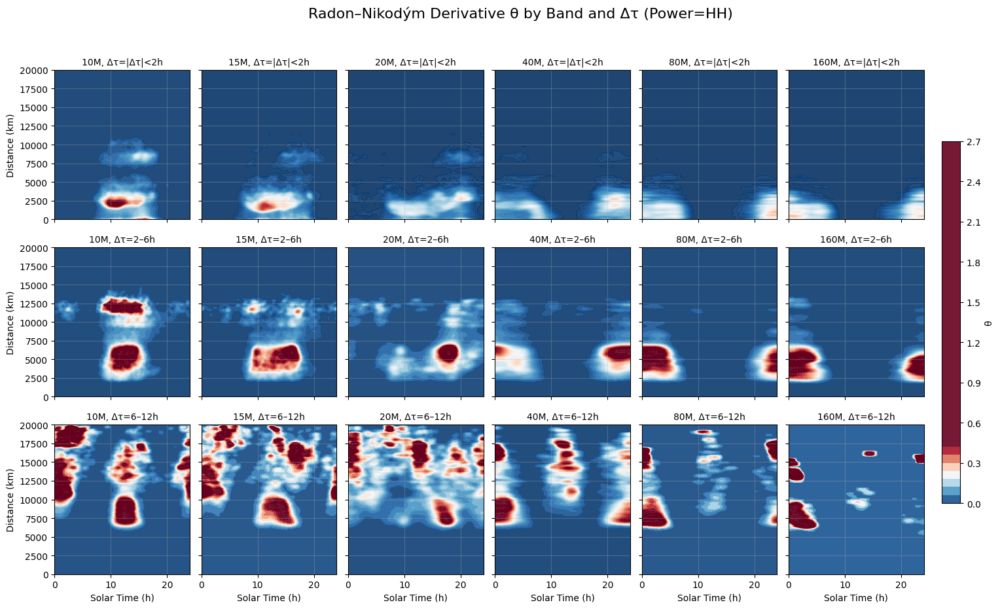

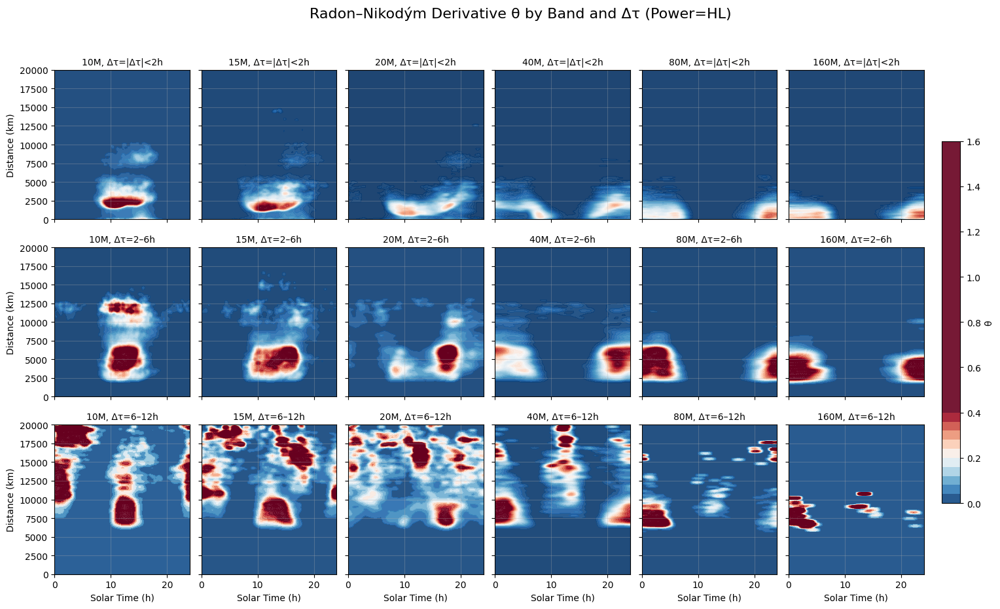

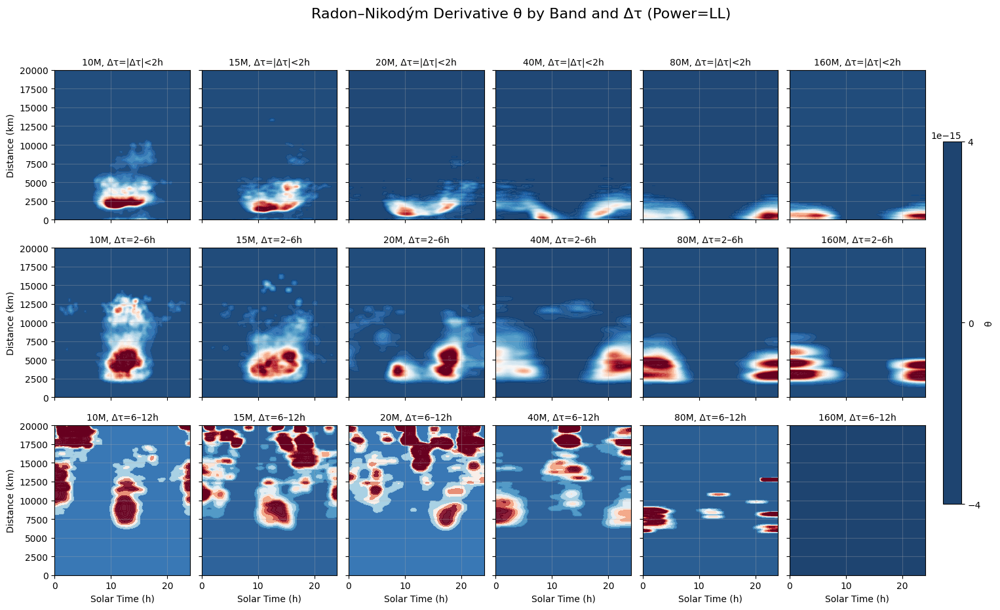

In [ ]:
# ---------- Build θ surfaces per power bin (baseline is the SAME for all) ----------
# Assumes you already have: band_kde_alt_v2[(band, dtau_bin, power_bin)] -> density
# and grid_t, grid_d, density_all_band

bins_order  = ['|Δτ|<2h', '2–6h', '6–12h']
bands_order = ['10M', '15M', '20M', '40M', '80M', '160M']

# Make baseline safe for division (distance-marginal, broadcast across time)
_floor = 1e-3 * float(np.nanmax(dens))
density_safe = np.where(dens < _floor, _floor, dens)  # shape: (len(grid_d),)
density_safe = density_safe[:, None]  # broadcast across time

# Organize θ by power -> {(band, bin) : theta_array}
theta_by_power = {}
available_powers = sorted(p for p in pd.unique(pos_clean['power_bin']) if pd.notna(p))

for p in available_powers:
    theta_by_power[p] = {}
    for b in bands_order:
        for dt in bins_order:
            key = (b, dt, p)
            dens = band_kde_alt_v2.get(key)
            if dens is None:
                continue
            theta = dens / density_safe             # broadcast over time dimension
            theta_by_power[p][(b, dt)] = theta

# ---------- Helper: plot a 3x6 panel for one power bin ----------
import itertools

def plot_theta_panel(theta_map, power_label, cmap='RdBu_r'):
    # collect vmin/vmax across all panels for consistent colour scale
    vals = []
    for k, arr in theta_map.items():
        if arr is not None:
            vals.append(arr[np.isfinite(arr)])
    if len(vals) == 0:
        print(f"No θ surfaces to plot for power='{power_label}'.")
        return
    allv = np.concatenate(vals)
    # use robust limits (avoid outliers blowing the scale)
    vmin = np.nanpercentile(allv, 2)
    vmax = np.nanpercentile(allv, 98)

    fig, axes = plt.subplots(len(bins_order), len(bands_order), figsize=(16, 9),
                             sharex=True, sharey=True)
    fig.suptitle(f'Radon–Nikodým Derivative θ by Band and Δτ (Power={power_label})',
                 fontsize=16, y=1.03)

    last_pcm = None
    T, D = np.meshgrid(grid_t, grid_d)

    for i, dt in enumerate(bins_order):
        for j, b in enumerate(bands_order):
            ax = axes[i, j]
            arr = theta_map.get((b, dt))
            if arr is not None:
                last_pcm = ax.contourf(T, D, arr, levels=50, cmap=cmap, vmin=vmin, vmax=vmax, alpha=0.9)
            ax.set_title(f'{b}, Δτ={dt}', fontsize=10)
            if i == len(bins_order) - 1:
                ax.set_xlabel('Solar Time (h)')
            if j == 0:
                ax.set_ylabel('Distance (km)')
            ax.grid(True, alpha=0.3)

    fig.tight_layout()
    fig.subplots_adjust(right=0.92)
    if last_pcm is not None:
        cbar = fig.colorbar(last_pcm, ax=axes, orientation='vertical', fraction=0.02, pad=0.02)
        cbar.set_label('θ')
    plt.show()

# ---------- Produce the three figures (HH, HL, LL), if present ----------
# Order them nicely if those labels exist
preferred_order = [lab for lab in ['HH', 'HL', 'LL'] if lab in theta_by_power]
others = [p for p in available_powers if p not in preferred_order]
for p in itertools.chain(preferred_order, others):
    plot_theta_panel(theta_by_power[p], p)


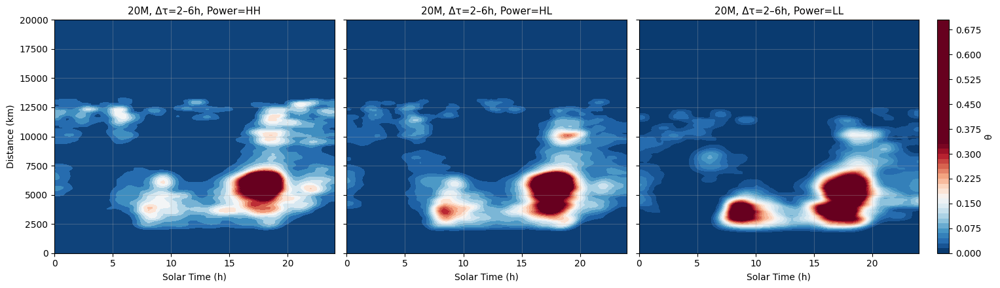

In [267]:
# --- Triptych: one band + one Δτ bin across power bins ---
import numpy as np
import matplotlib.pyplot as plt

def plot_band_dtau_across_power(theta_by_power,
                                band='10M',
                                dtau_bin='2–6h',
                                powers=('HH','HL','LL'),
                                cmap='RdBu_r'):
    # keep only powers that actually exist
    powers = [p for p in powers if p in theta_by_power]
    if not powers:
        print("No matching power strata in theta_by_power.")
        return

    # collect arrays and compute a shared vmin/vmax (robust)
    arrays = []
    for p in powers:
        arr = theta_by_power[p].get((band, dtau_bin))
        if arr is not None:
            arrays.append(arr[np.isfinite(arr)])
    if not arrays:
        print(f"No θ arrays for band={band}, Δτ={dtau_bin}.")
        return

   

    all_vals = np.concatenate(arrays)
    vmin = np.nanpercentile(all_vals, 2)
    vmax = np.nanpercentile(all_vals, 98)

    T, D = np.meshgrid(grid_t, grid_d)
    fig, axes = plt.subplots(1, len(powers), figsize=(15, 4.5), sharex=True, sharey=True)
    if len(powers) == 1:
        axes = [axes]

    last = None
    for ax, p in zip(axes, powers):
        Z = theta_by_power[p].get((band, dtau_bin))
        if Z is not None:
            last = ax.contourf(T, D, Z, levels=50, cmap=cmap, vmin=vmin, vmax=vmax)
        ax.set_title(f'{band}, Δτ={dtau_bin}, Power={p}', fontsize=11)
        ax.set_xlabel('Solar Time (h)')
        ax.grid(True, alpha=0.3)
    axes[0].set_ylabel('Distance (km)')

    fig.tight_layout()
    if last is not None:
        cbar = fig.colorbar(last, ax=axes, orientation='vertical', fraction=0.035, pad=0.02)
        cbar.set_label('θ')
    plt.show()

# call it:
plot_band_dtau_across_power(theta_by_power, band='20M', dtau_bin='2–6h', powers=('HH','HL','LL'))
